<a href="https://colab.research.google.com/github/grecalde17gh/Tesis-IA---Portafolio-de-inversiones/blob/main/Portafolio_de_inversiones_v11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Proyecto FINAL | Gustavo Recalde**

# **Portafolio de inversiones con modelos de Inteligencia Artificial**


# **INTRODUCCIÓN**

Este proyecto tiene como objetivo principal optimizar un portafolio de inversión utilizando redes neuronales LSTM y técnicas de Procesamiento de Lenguaje Natural (PLN). Se enfoca en combinar datos financieros históricos, análisis técnico (como medias móviles) y análisis de sentimientos extraídos de noticias relacionadas con el mercado.

## Tipos de datos utilizados:
1. **Datos financieros**: Precios históricos de acciones descargados desde Yahoo Finance.
2. **Indicadores técnicos**: Medias móviles calculadas para diferentes ventanas temporales (10, 30 y 60 días).
3. **Análisis de sentimientos**: Sentimientos derivados de noticias sobre las empresas.

## Resultados esperados:
- Predicción precisa de los precios de las acciones utilizando modelos LSTM.
- Optimización del portafolio basado en el Ratio de Sharpe, maximizando la relación entre retorno y riesgo.
- Evaluación de cómo el análisis de sentimientos impacta en la predicción y optimización.


## **Dependencias y Librerías**

Este proyecto utiliza varias librerías clave. A continuación, se describe su propósito:

- **pytorch-lightning**: Simplifica la implementación y entrenamiento de modelos LSTM, reduciendo la necesidad de codificación manual de las fases de entrenamiento.
- **vaderSentiment**: Realiza análisis de sentimientos en textos, optimizado para texto corto e informal.
- **yfinance**: Extrae datos históricos de precios de acciones directamente desde Yahoo Finance.
- **numpy y pandas**: Para la manipulación y análisis de datos.
- **matplotlib**: Para la visualización de datos y resultados.
- **scipy.optimize**: Realiza optimización matemática, útil para la construcción del portafolio.
- **transformers**: Biblioteca para modelos de PLN avanzados (por ejemplo, análisis de texto).

Estas dependencias son instaladas automáticamente al ejecutar la celda correspondiente.

## Configuración Inicial

La reproducibilidad es un aspecto clave en proyectos de aprendizaje profundo. Configurar una semilla fija asegura que los resultados del modelo puedan ser replicados en futuras ejecuciones, independientemente de la aleatoriedad inherente al entrenamiento.

### Función de las librerías clave:
- **torch**: Biblioteca base para construir y entrenar redes neuronales.
- **pandas y numpy**: Procesamiento y transformación de datos para su ingreso al modelo.
- **scipy.optimize**: Realiza la optimización del portafolio basado en métricas de rendimiento financiero.



In [1]:
!pip install pytorch-lightning
!pip install vaderSentiment
!pip install praw
!pip install asyncpraw
!pip install requests beautifulsoup4 lxml transformers
!pip install torch transformers tokenizers

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 20.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 926.4/926.4 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.3/189.3 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.4/196.4 kB 7.4 MB/s eta 0:00:00


### Librerias

In [2]:
# Importar librerías y configurar la semilla
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
import yfinance as yf
import torch
import torch.nn as nn
import pytorch_lightning as pl
from torch.utils.data import DataLoader, TensorDataset
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from scipy.optimize import minimize
import os

# Configuración de la semilla para reproducibilidad
np.random.seed(4)
torch.manual_seed(4)


## **Recolección y Procesamiento de Datos**

1. **Selección de Tickers**: Se seleccionaron múltiples tickers de empresas tecnológicas de alto impacto en el mercado. Esto asegura un portafolio diversificado.
2. **Medias Móviles**:
   - **MA_10**: Media móvil de 10 días.
   - **MA_30**: Media móvil de 30 días.
   - **MA_60**: Media móvil de 60 días.
   Estas medias ayudan a suavizar las fluctuaciones diarias del precio, revelando tendencias a corto, mediano y largo plazo.
3. **Eliminación de datos faltantes (`dropna`)**: Es necesario para evitar inconsistencias durante el entrenamiento del modelo.


In [21]:
import matplotlib.pyplot as plt
import yfinance as yf

# Lista de tickers
tickers = [
    'AAPL', 'MSFT', 'NVDA', 'AVGO', 'ORCL', 'AMD', 'CSCO', 'ACN', 'ADBE',
    'TXN', 'IBM', 'QCOM', 'INTU', 'AMAT', 'MU', 'LRCX', 'NOW', 'PANW', 'SNPS',
    'CDNS', 'ANET', 'FTNT', 'KLAC', 'APH', 'TEL', 'MCHP', 'NXPI', 'ON', 'MPWR',
    'ADI', 'KEYS', 'CDW', 'ANSS', 'PAYC', 'GDDY', 'TYL', 'SSNC','JKHY', 'EPAM',
    'GLW', 'HPQ', 'DXC', 'IT', 'LDOS', 'AKAM', 'NTAP', 'VRSN', 'FFIV', 'XRX',
    'JNPR', 'CSGP', 'TRMB', 'GRMN', 'ZBRA', 'BR','VRSN', 'PTC', 'CTSH', 'HPE',
    'JNPR', 'MSI', 'TDY', 'WDC', 'STX'
]

# Descargar datos de Yahoo Finance para cada ticker
def download_stock_data(ticker):
    data = yf.download(ticker, start='2019-06-01', end='2024-07-31')
    data['MA_10'] = data['Adj Close'].rolling(window=10).mean()
    data['MA_30'] = data['Adj Close'].rolling(window=30).mean()
    data['MA_60'] = data['Adj Close'].rolling(window=60).mean()
    data.dropna(inplace=True)  # Eliminar filas con valores NaN debido al cálculo de medias móviles
    return data

# Descargar y almacenar datos para cada ticker
stock_data = {}
for ticker in tickers:
    stock_data[ticker] = download_stock_data(ticker)
    print(f"Datos para {ticker} descargados.")

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para AAPL descargados.
Datos para MSFT descargados.
Datos para NVDA descargados.
Datos para AVGO descargados.



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ORCL descargados.
Datos para AMD descargados.
Datos para CSCO descargados.
Datos para ACN descargados.
Datos para ADBE descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para TXN descargados.
Datos para IBM descargados.
Datos para QCOM descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para INTU descargados.
Datos para AMAT descargados.
Datos para MU descargados.
Datos para LRCX descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para NOW descargados.
Datos para PANW descargados.
Datos para SNPS descargados.
Datos para CDNS descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ANET descargados.
Datos para FTNT descargados.
Datos para KLAC descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para APH descargados.
Datos para TEL descargados.
Datos para MCHP descargados.



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para NXPI descargados.
Datos para ON descargados.
Datos para MPWR descargados.
Datos para ADI descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para KEYS descargados.
Datos para CDW descargados.
Datos para ANSS descargados.
Datos para PAYC descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para GDDY descargados.
Datos para TYL descargados.
Datos para SSNC descargados.
Datos para JKHY descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para EPAM descargados.
Datos para GLW descargados.
Datos para HPQ descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para DXC descargados.
Datos para IT descargados.
Datos para LDOS descargados.
Datos para AKAM descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para NTAP descargados.
Datos para VRSN descargados.
Datos para FFIV descargados.
Datos para XRX descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para JNPR descargados.
Datos para CSGP descargados.
Datos para TRMB descargados.



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para GRMN descargados.
Datos para ZBRA descargados.
Datos para BR descargados.
Datos para VRSN descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para PTC descargados.
Datos para CTSH descargados.
Datos para HPE descargados.



[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para JNPR descargados.
Datos para MSI descargados.
Datos para TDY descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

Datos para WDC descargados.
Datos para STX descargados.


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AAPL descargados.
Datos para MSFT descargados.
Datos para NVDA descargados.
Datos para AVGO descargados.


[*********************100%***********************]  1 of 1 completed


Datos para ORCL descargados.
Datos para AMD descargados.


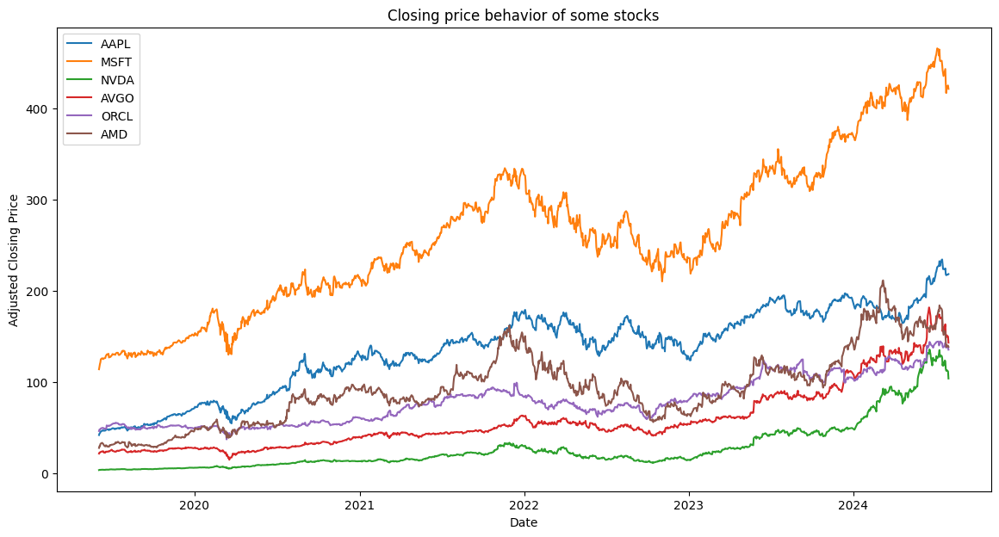

In [17]:
import matplotlib.pyplot as plt
import yfinance as yf

# Lista de tickers
tickers0 = ['AAPL', 'MSFT', 'NVDA', 'AVGO', 'ORCL', 'AMD']

# Descargar datos de Yahoo Finance para cada ticker
def download_stock_data0(ticker):
    data = yf.download(ticker, start='2019-06-01', end='2024-07-31')
    data.dropna(inplace=True)  # Eliminar filas con valores NaN debido al cálculo de medias móviles
    return data

# Descargar y almacenar datos para cada ticker
stock_data0 = {}
for ticker in tickers0:
    stock_data0[ticker] = download_stock_data0(ticker)
    print(f"Datos para {ticker} descargados.")

# Graficar el comportamiento del precio de cierre ajustado de todas las acciones
plt.figure(figsize=(14, 7))
for ticker in tickers0:
    plt.plot(stock_data0[ticker].index, stock_data0[ticker]['Adj Close'], label=ticker)
plt.xlabel('Date')
plt.ylabel('Adjusted Closing Price')
plt.title('Closing price behavior of some stocks')
plt.legend()

# Guardar el gráfico en formato SVG
plt.savefig("stock_prices.svg", format="svg")

# Mostrar el gráfico
plt.show()

## Funciones Auxiliares

Se definieron varias funciones auxiliares para soportar el análisis y la visualización:

- **`graficar_predicciones`**: Crea gráficos que comparan los valores reales y predichos de las acciones.
- **Callback de pérdida (`LossLogger`)**: Registra la pérdida en cada época de entrenamiento.
- **`plot_loss`**: Muestra cómo evoluciona la pérdida a lo largo del entrenamiento.

Estas funciones facilitan la evaluación visual de los resultados del modelo.


In [22]:
# Función para graficar las predicciones con fechas en el eje x
def graficar_predicciones(real, prediccion, dates, ticker):
    plt.figure(figsize=(12, 6))
    plt.plot(dates, real, color='red', label='Real value of the share')
    plt.plot(dates[len(dates) - len(prediccion):], prediccion, color='blue', label='Action prediction')
    plt.xlabel('Date')
    plt.ylabel('Share value')
    plt.legend()
    plt.title(f'Predictions for {ticker}')
    plt.xticks(rotation=45)
    plt.show()

# Callback para registrar la pérdida durante el entrenamiento
class LossLogger(pl.Callback):
    def on_train_epoch_end(self, trainer, pl_module):
        logs = trainer.logged_metrics
        epoch = trainer.current_epoch
        loss = logs['train_loss_epoch'].item()
        if not hasattr(self, 'losses'):
            self.losses = []
        self.losses.append((epoch, loss))

# Función para graficar la pérdida durante el entrenamiento
def plot_loss(callback, ticker):
    epochs, losses = zip(*callback.losses)
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, losses, label='Training Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title(f'Loss during training for {ticker}')
    plt.legend()
    plt.show()

# Modelo 1: LSTM Usando Solo Datos Financieros

Este modelo utiliza únicamente datos financieros históricos como entrada. La arquitectura del modelo incluye:
- Una capa LSTM que captura patrones temporales en los precios de las acciones.
- Una capa totalmente conectada para generar las predicciones finales.

**Datos de entrada**:
- Precios ajustados diarios y medias móviles.

**Objetivo del modelo**:
- Predecir el precio de cierre ajustado para las acciones seleccionadas.


In [23]:
# Definir el modelo LSTM en PyTorch Lightning

class LSTMModel(pl.LightningModule):
    def __init__(self, input_size=4, hidden_layer_size=100, output_size=1, lr=0.001):
        super(LSTMModel, self).__init__()
        self.hidden_layer_size = hidden_layer_size
        self.lstm = nn.LSTM(input_size, hidden_layer_size, batch_first=True)
        self.linear = nn.Linear(hidden_layer_size, output_size)
        self.lr = lr
        self.criterion = nn.MSELoss()

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        predictions = self.linear(lstm_out[:, -1])
        return predictions

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.criterion(y_hat, y)
        self.log('train_loss_epoch', loss, prog_bar=True, on_epoch=True, on_step=False)
        return loss

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=self.lr)


## Entrenamiento del Modelo

### División de datos:
- **Entrenamiento**: 80% de los datos históricos.
- **Validación**: 20% restante para evaluar el desempeño del modelo.

### Métricas de evaluación:
- **RMSE** (Raíz del error cuadrático medio).
- **MAE** (Error absoluto medio).
- **R²** (Coeficiente de determinación).

Estas métricas cuantifican qué tan bien el modelo predice los precios de las acciones.


Processing AAPL...
Model loaded for AAPL.


<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))


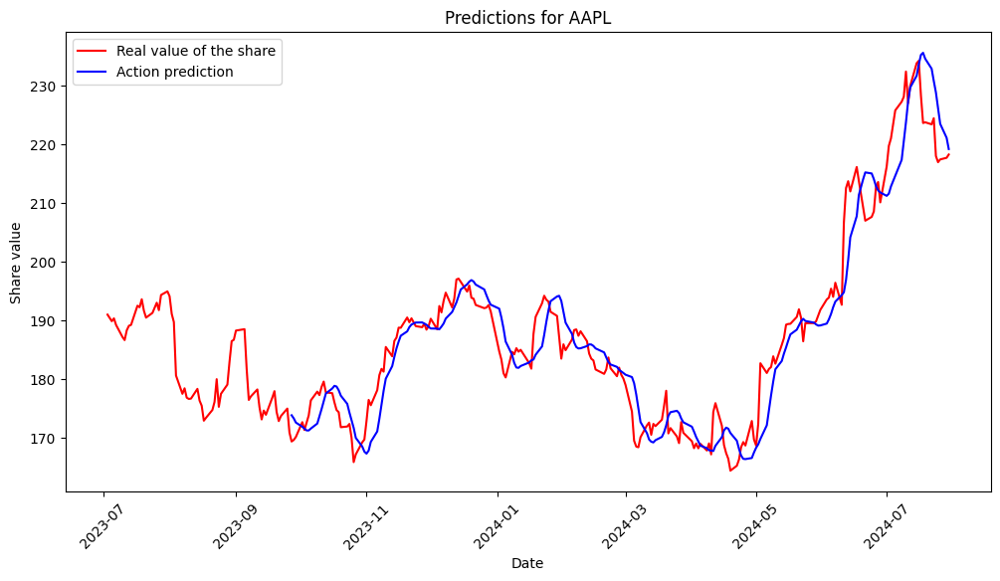

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for AAPL: 22.656652783629404
Normalized Mean Squared Error (Normalized MSE) for AAPL: 0.0006521301090747067
Mean Absolute Error (MAE) for AAPL: 3.7024360488984835
R^2 Score for AAPL: 0.9174047019207926
Processing MSFT...
Model loaded for MSFT.


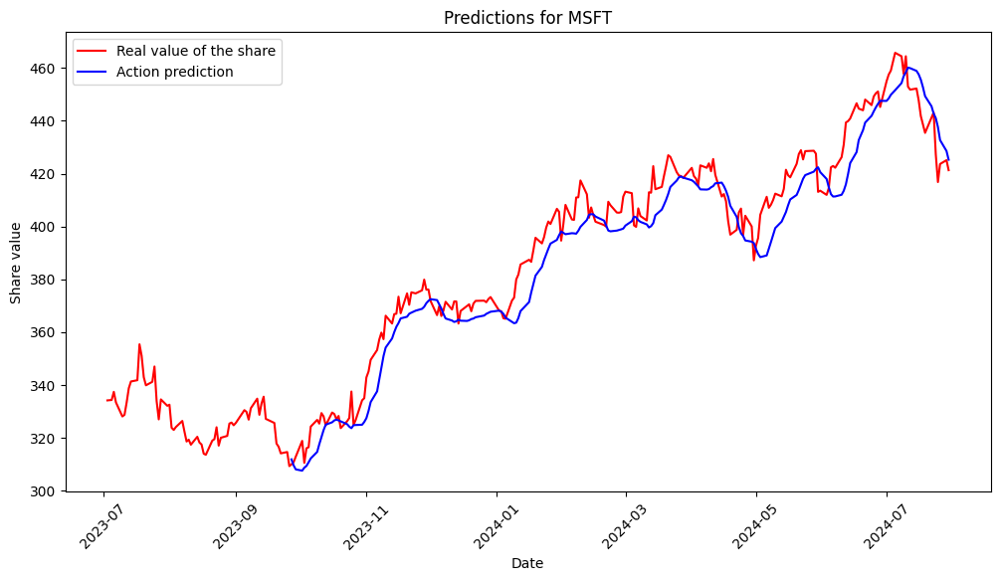

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for MSFT: 88.4604109910552
Normalized Mean Squared Error (Normalized MSE) for MSFT: 0.0006100619146265967
Mean Absolute Error (MAE) for MSFT: 7.873954444397887
R^2 Score for MSFT: 0.9357752863491415
Processing NVDA...
Model loaded for NVDA.


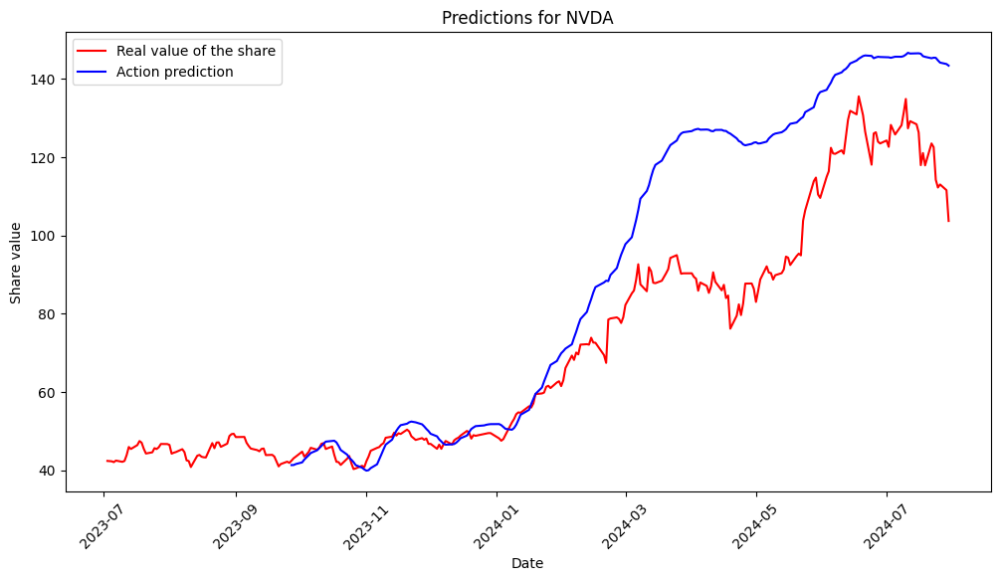

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for NVDA: 455.80903569318934
Normalized Mean Squared Error (Normalized MSE) for NVDA: 0.09181645066256708
Mean Absolute Error (MAE) for NVDA: 15.877179223289161
R^2 Score for NVDA: 0.45406703238684964
Processing AVGO...
Model loaded for AVGO.


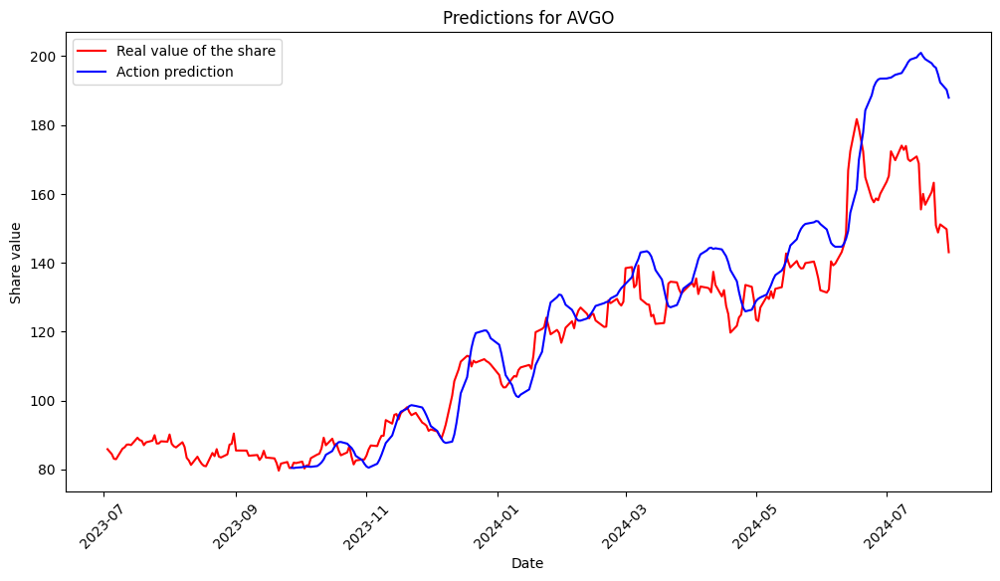

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for AVGO: 200.43133640322637
Normalized Mean Squared Error (Normalized MSE) for AVGO: 0.01541886069852569
Mean Absolute Error (MAE) for AVGO: 9.488339734369868
R^2 Score for AVGO: 0.6877470585974492
Processing ORCL...
Model loaded for ORCL.


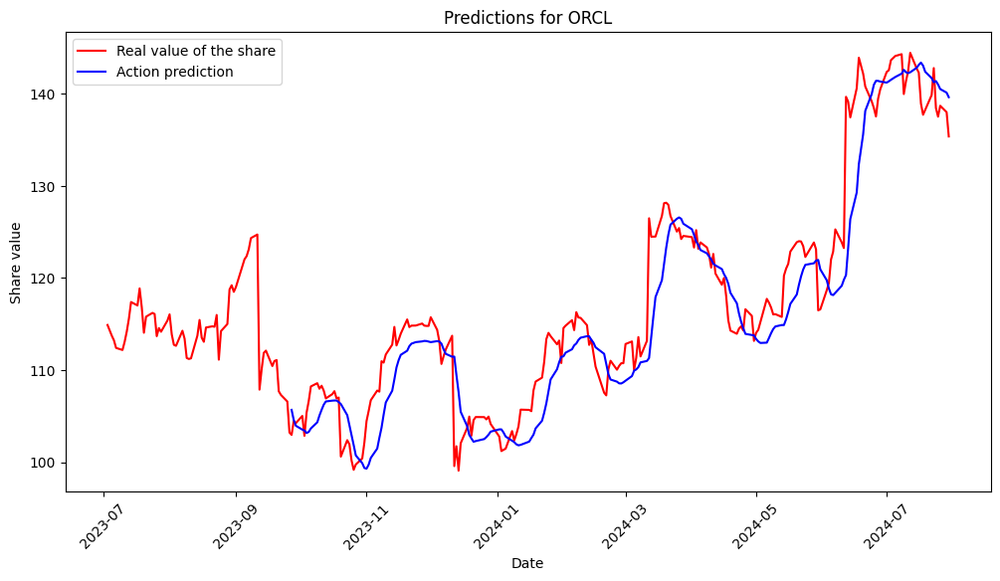

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for ORCL: 17.276154052753327
Normalized Mean Squared Error (Normalized MSE) for ORCL: 0.0012685989743580586
Mean Absolute Error (MAE) for ORCL: 3.043556372942902
R^2 Score for ORCL: 0.8827226640059828
Processing AMD...
Model loaded for AMD.


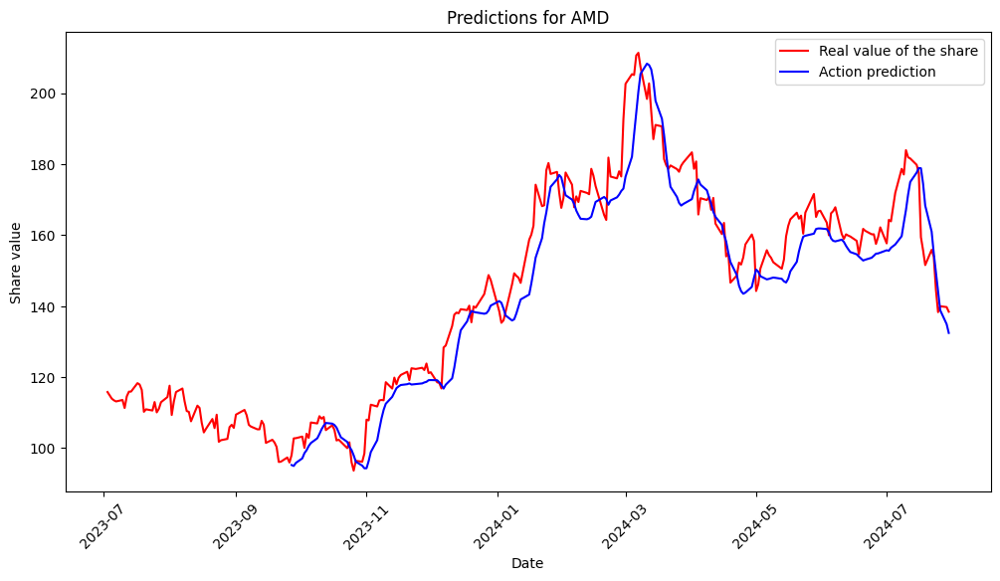

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for AMD: 68.40349860633843
Normalized Mean Squared Error (Normalized MSE) for AMD: 0.0033964605103585983
Mean Absolute Error (MAE) for AMD: 6.616344027827627
R^2 Score for AMD: 0.9110646887471745
Processing CSCO...
Model loaded for CSCO.


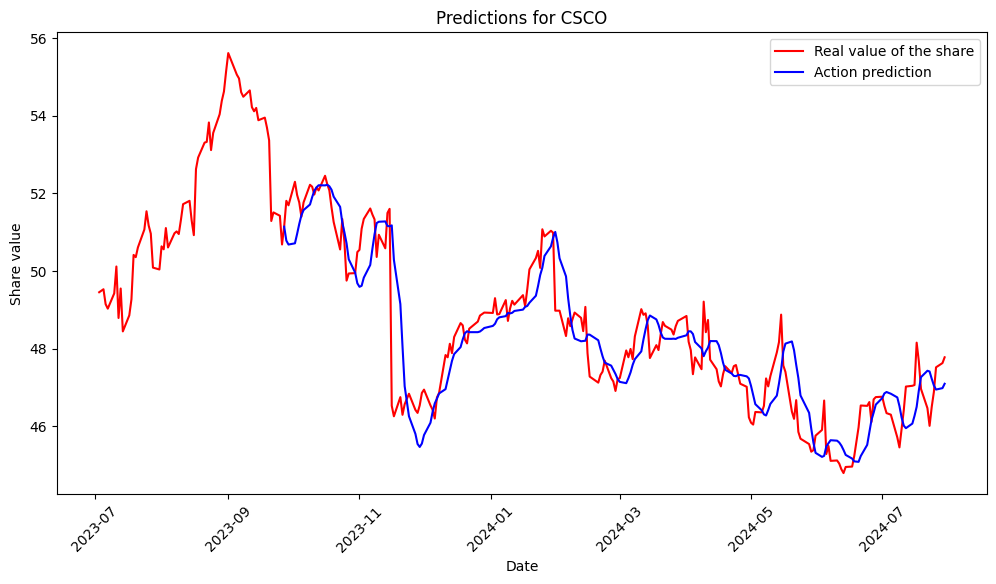

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for CSCO: 0.7371733141891172
Normalized Mean Squared Error (Normalized MSE) for CSCO: 0.0003069974587425854
Mean Absolute Error (MAE) for CSCO: 0.6342524582187581
R^2 Score for CSCO: 0.7986095663296278
Processing ACN...
Model loaded for ACN.


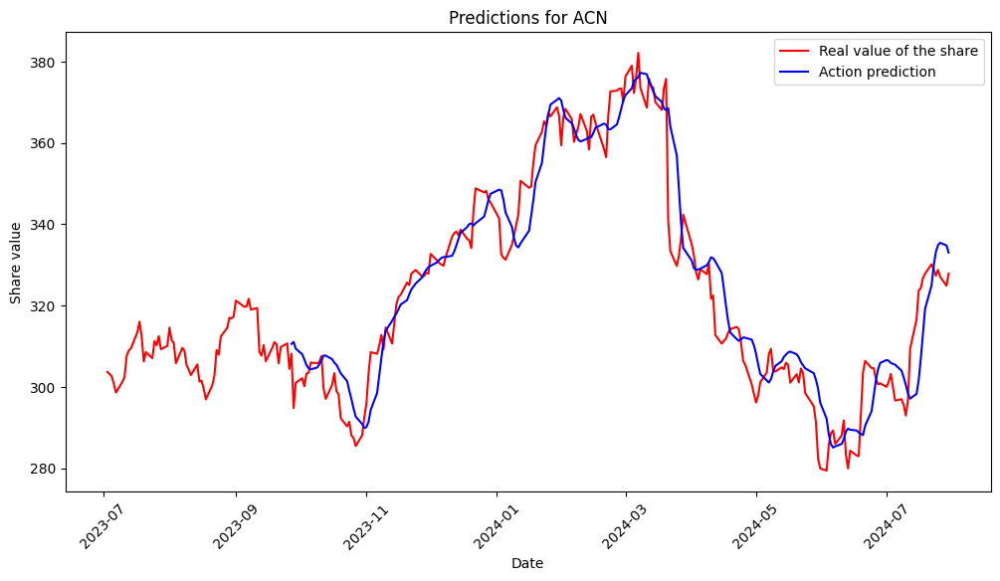

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for ACN: 62.82617212849686
Normalized Mean Squared Error (Normalized MSE) for ACN: 0.0006080173775025482
Mean Absolute Error (MAE) for ACN: 5.955770608082346
R^2 Score for ACN: 0.9174940539671153
Processing ADBE...
Model loaded for ADBE.


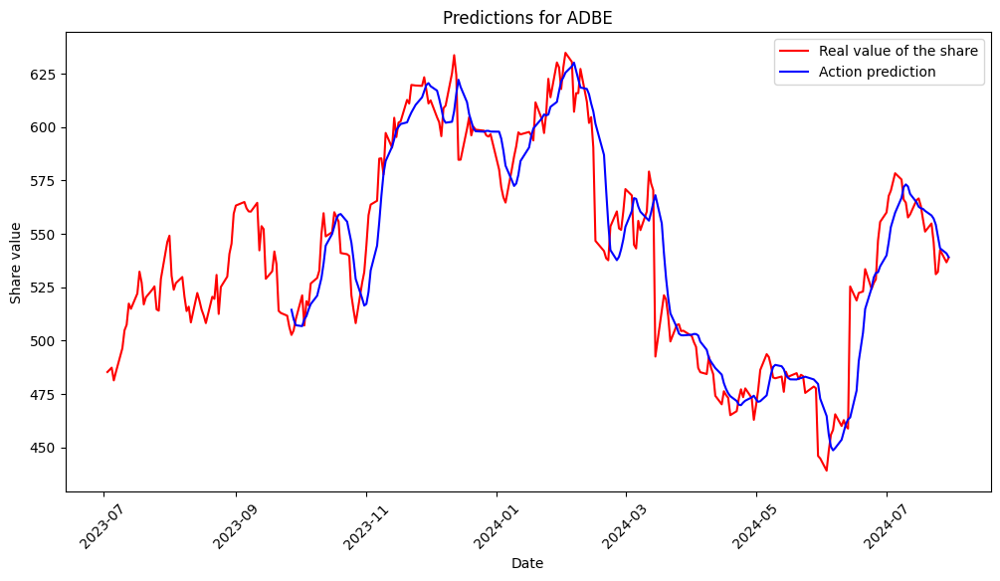

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for ADBE: 256.2128512974434
Normalized Mean Squared Error (Normalized MSE) for ADBE: 0.0008762251948521912
Mean Absolute Error (MAE) for ADBE: 11.472274310381888
R^2 Score for ADBE: 0.9044844701485075
Processing TXN...
Model loaded for TXN.


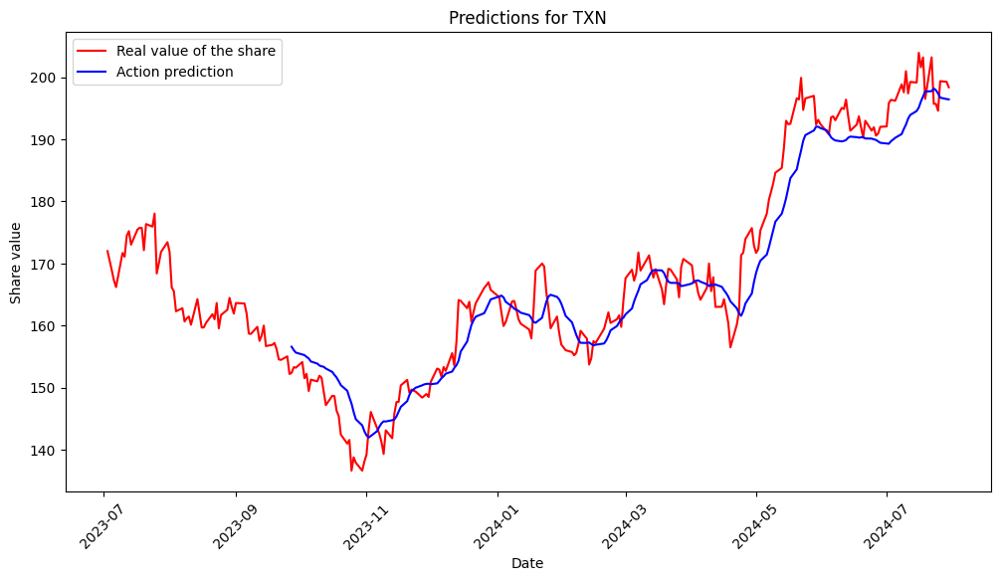

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for TXN: 21.650349020984184
Normalized Mean Squared Error (Normalized MSE) for TXN: 0.0007726102554206813
Mean Absolute Error (MAE) for TXN: 3.730122543424455
R^2 Score for TXN: 0.9345492683661513
Processing IBM...
Model loaded for IBM.


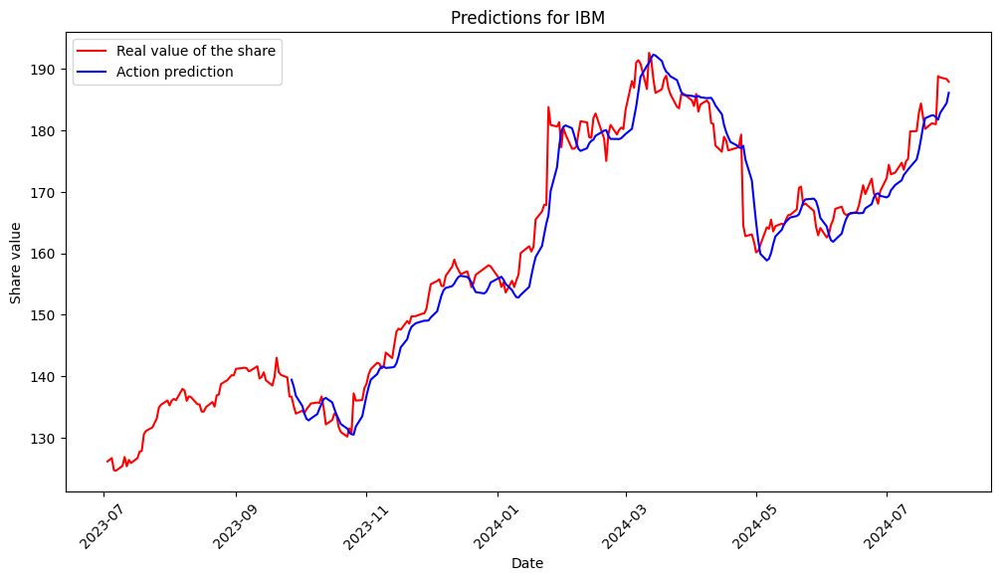

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for IBM: 13.506247358920849
Normalized Mean Squared Error (Normalized MSE) for IBM: 0.000537616949073902
Mean Absolute Error (MAE) for IBM: 2.7658257447118086
R^2 Score for IBM: 0.9527685154156647
Processing QCOM...
Model loaded for QCOM.


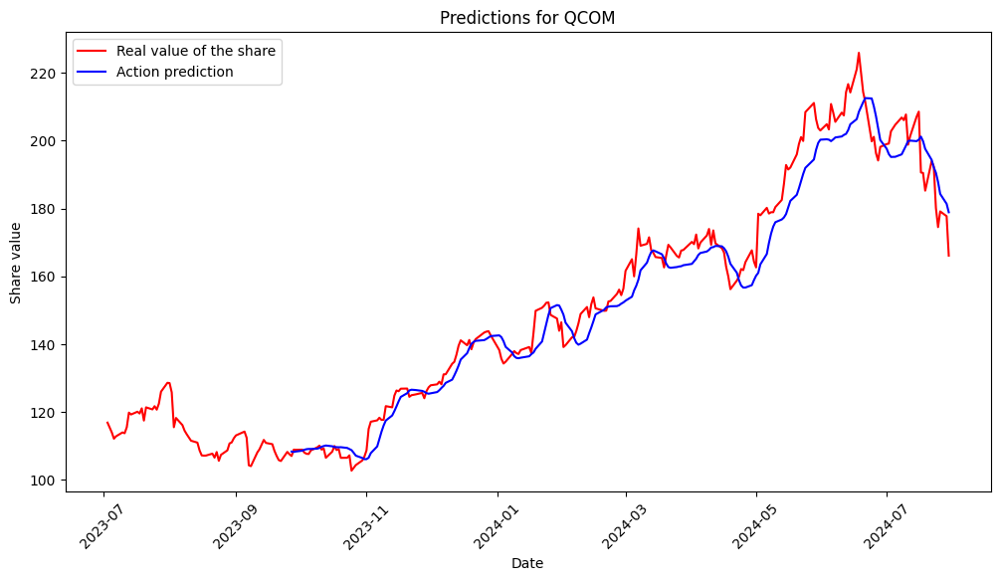

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for QCOM: 42.619967434813105
Normalized Mean Squared Error (Normalized MSE) for QCOM: 0.0019582483933370883
Mean Absolute Error (MAE) for QCOM: 5.07049780996355
R^2 Score for QCOM: 0.9589154294676595
Processing INTU...
Model loaded for INTU.


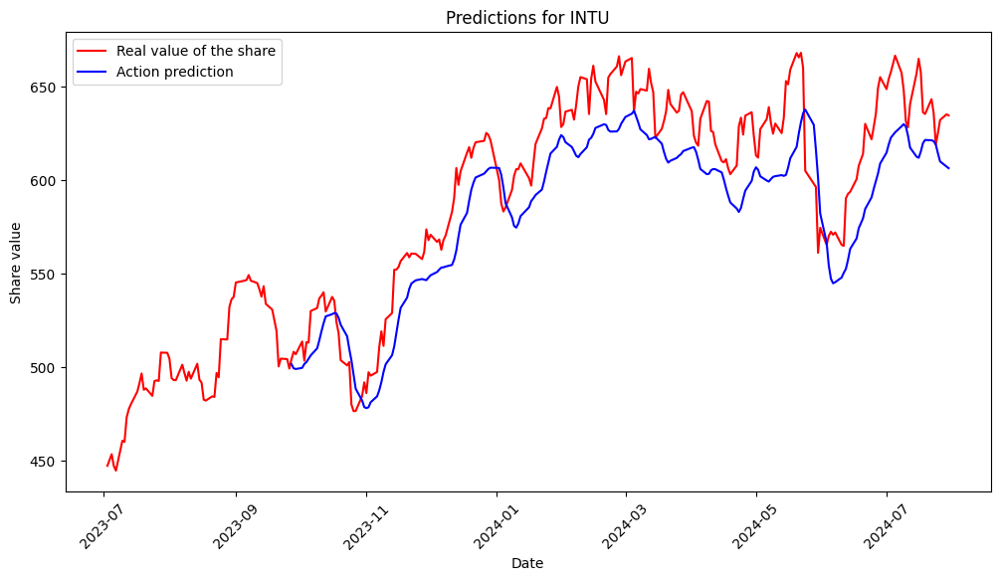

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for INTU: 671.8346465625792
Normalized Mean Squared Error (Normalized MSE) for INTU: 0.0019915435086183906
Mean Absolute Error (MAE) for INTU: 23.021593821222208
R^2 Score for INTU: 0.7291504096922392
Processing AMAT...
Model loaded for AMAT.


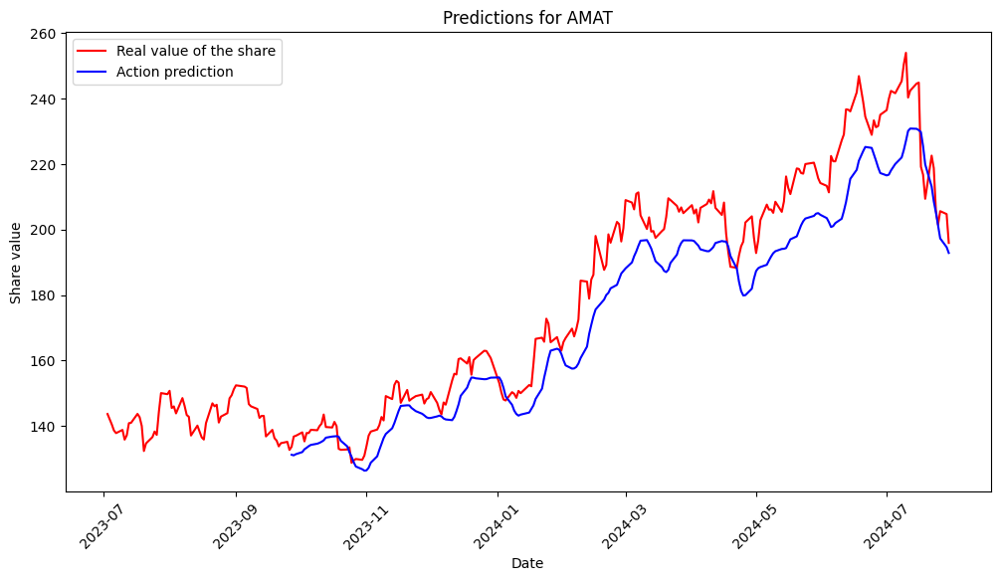

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for AMAT: 154.26542895081576
Normalized Mean Squared Error (Normalized MSE) for AMAT: 0.005030781767016224
Mean Absolute Error (MAE) for AMAT: 10.552975411987616
R^2 Score for AMAT: 0.8686665778230103
Processing MU...
Model loaded for MU.


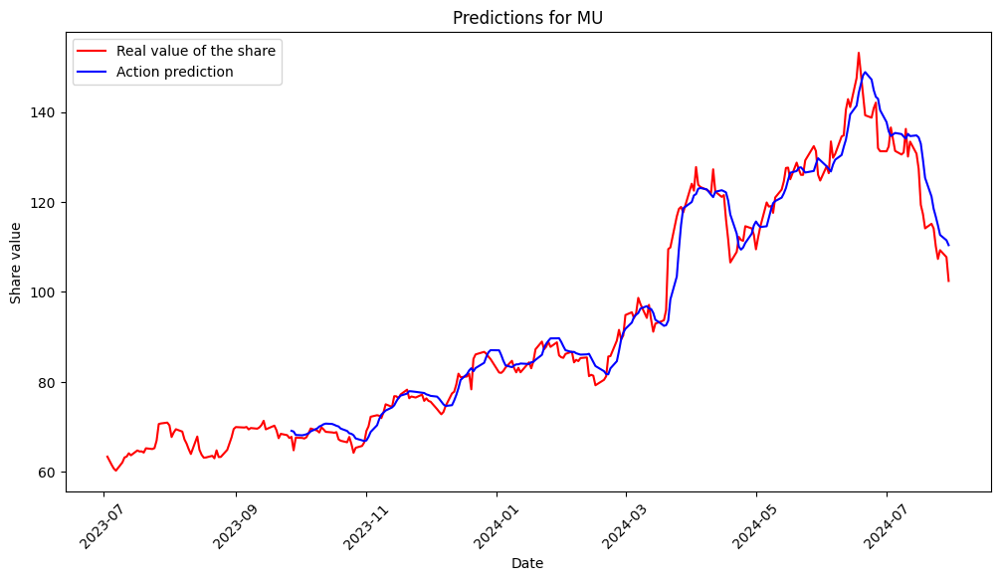

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for MU: 16.077173283575174
Normalized Mean Squared Error (Normalized MSE) for MU: 0.0019120044542266514
Mean Absolute Error (MAE) for MU: 2.8531716764202173
R^2 Score for MU: 0.9718643776549463
Processing LRCX...
Model loaded for LRCX.


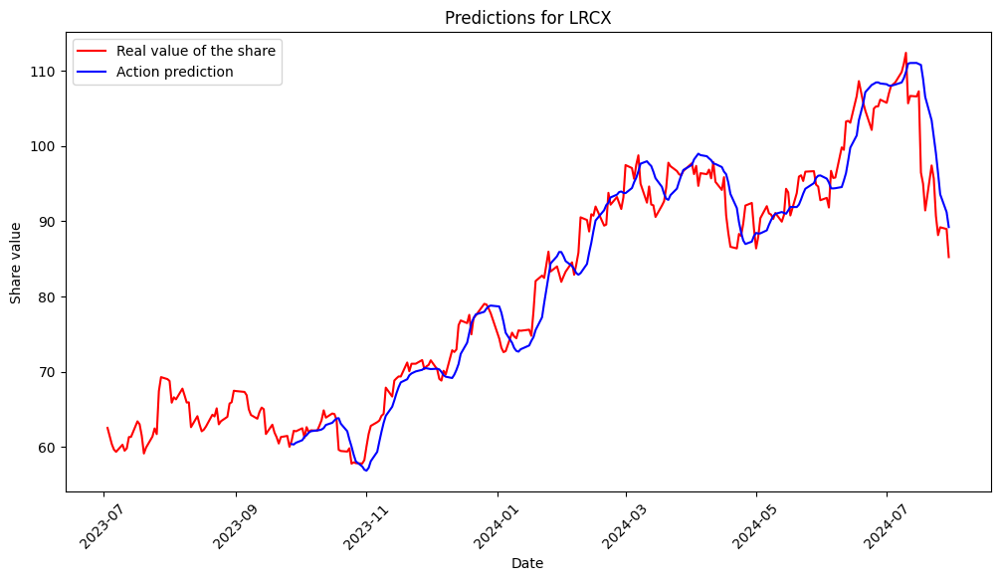

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for LRCX: 11.902259343784321
Normalized Mean Squared Error (Normalized MSE) for LRCX: 0.0018549760047302678
Mean Absolute Error (MAE) for LRCX: 2.5842709501398304
R^2 Score for LRCX: 0.941315147591638
Processing NOW...
Model loaded for NOW.


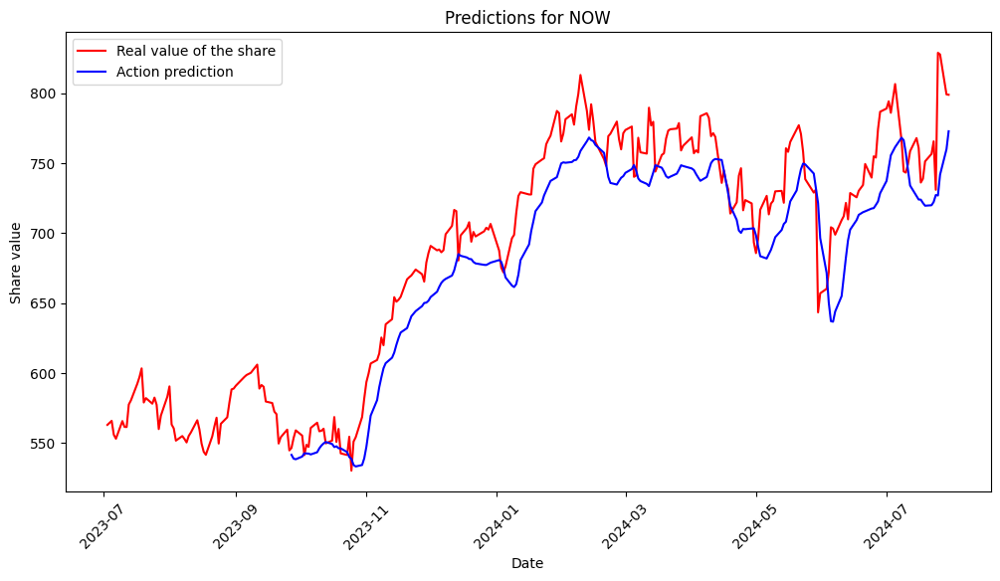

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for NOW: 974.9454441051555
Normalized Mean Squared Error (Normalized MSE) for NOW: 0.002108689529716846
Mean Absolute Error (MAE) for NOW: 26.57530903152935
R^2 Score for NOW: 0.8147015131682211
Processing PANW...
Model loaded for PANW.


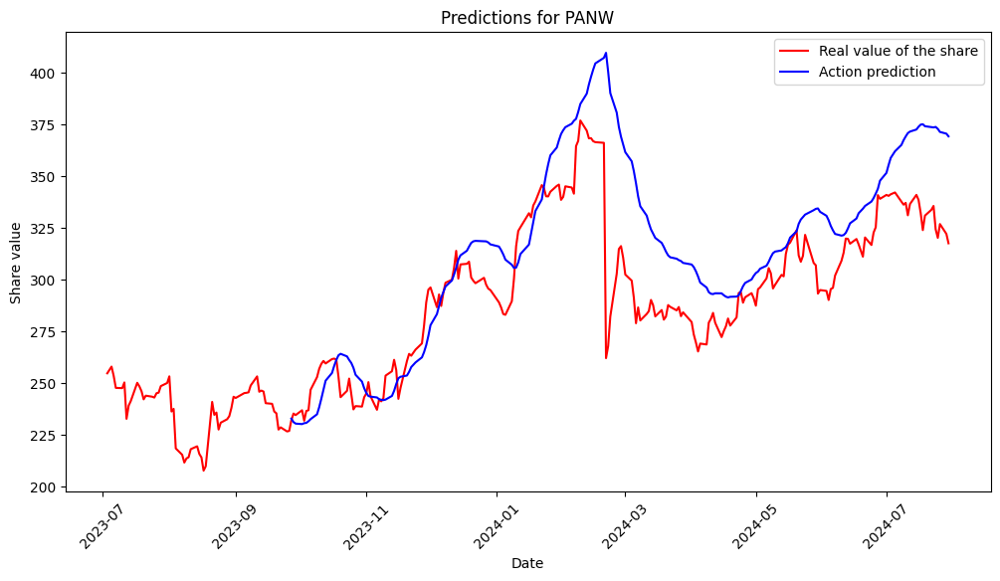

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for PANW: 862.4312885799515
Normalized Mean Squared Error (Normalized MSE) for PANW: 0.010728148433645146
Mean Absolute Error (MAE) for PANW: 21.270814042989308
R^2 Score for PANW: 0.24102036204656552
Processing SNPS...
Model loaded for SNPS.


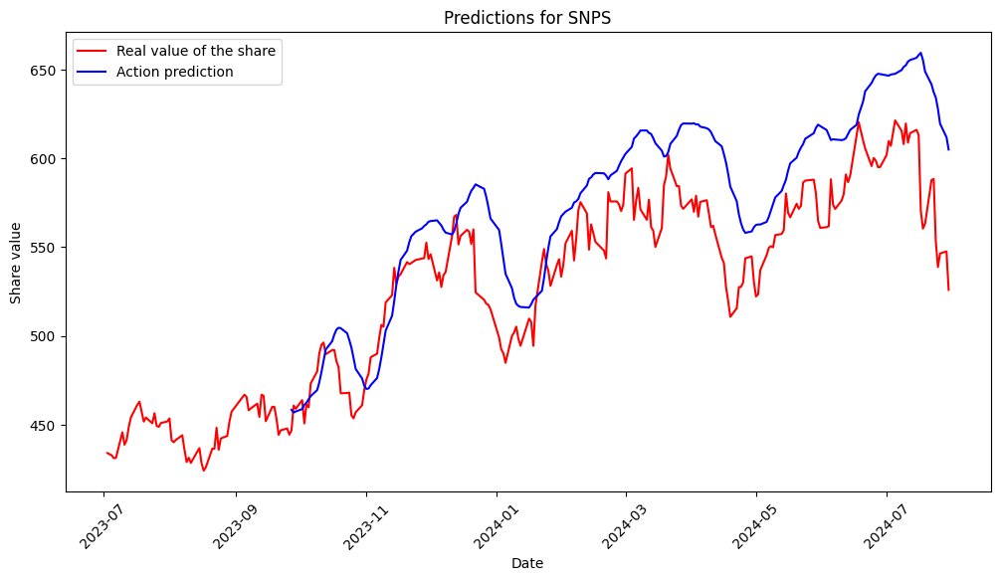

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for SNPS: 1313.2732516479798
Normalized Mean Squared Error (Normalized MSE) for SNPS: 0.0047885169247984605
Mean Absolute Error (MAE) for SNPS: 30.319956108985153
R^2 Score for SNPS: 0.21909864464061335
Processing CDNS...
Model loaded for CDNS.


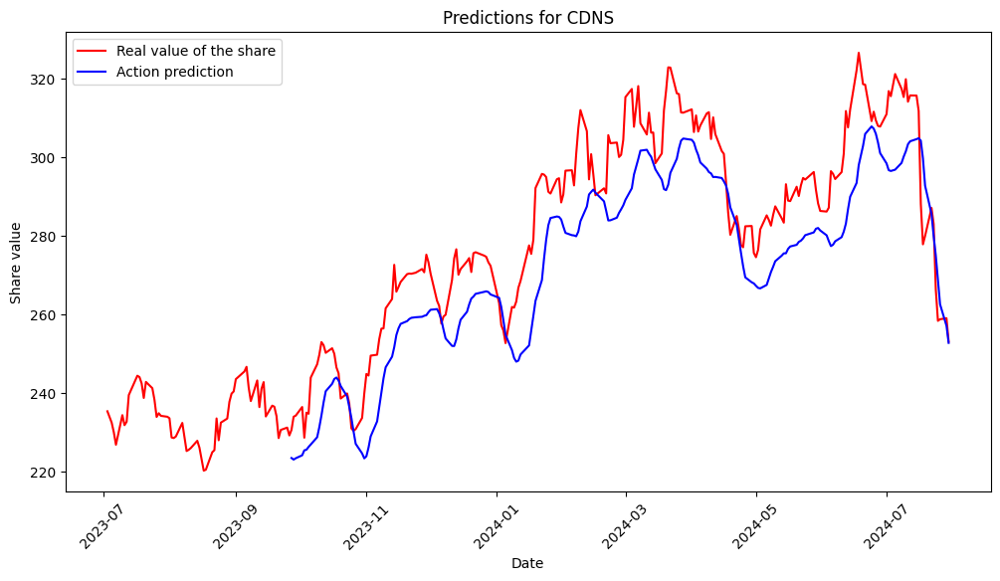

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for CDNS: 193.03075326765196
Normalized Mean Squared Error (Normalized MSE) for CDNS: 0.002598680869327645
Mean Absolute Error (MAE) for CDNS: 12.008112444376572
R^2 Score for CDNS: 0.6789083587420295
Processing ANET...
Model loaded for ANET.


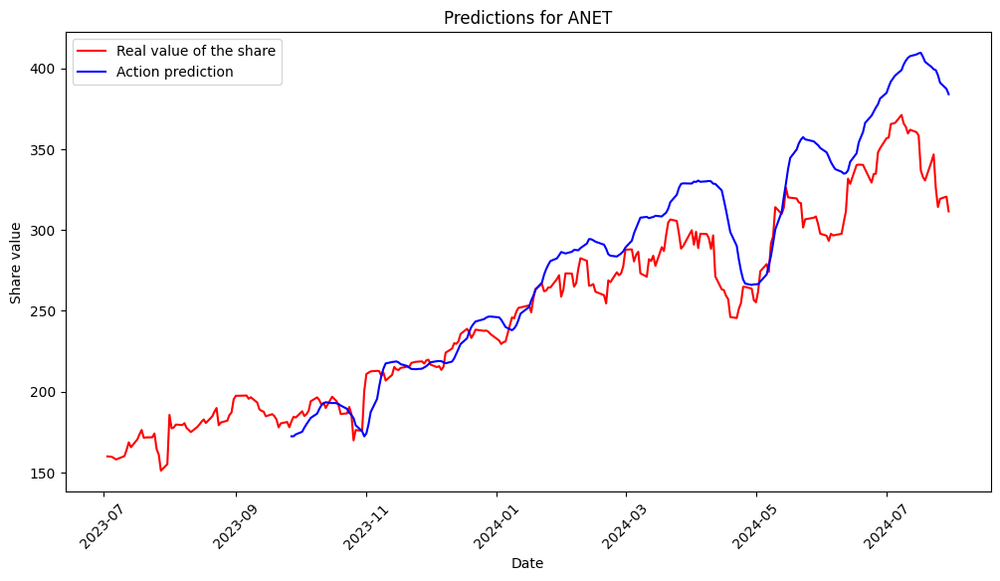

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for ANET: 806.3545090944996
Normalized Mean Squared Error (Normalized MSE) for ANET: 0.013223048133101063
Mean Absolute Error (MAE) for ANET: 21.06807040508762
R^2 Score for ANET: 0.6662720329779311
Processing FTNT...
Model loaded for FTNT.


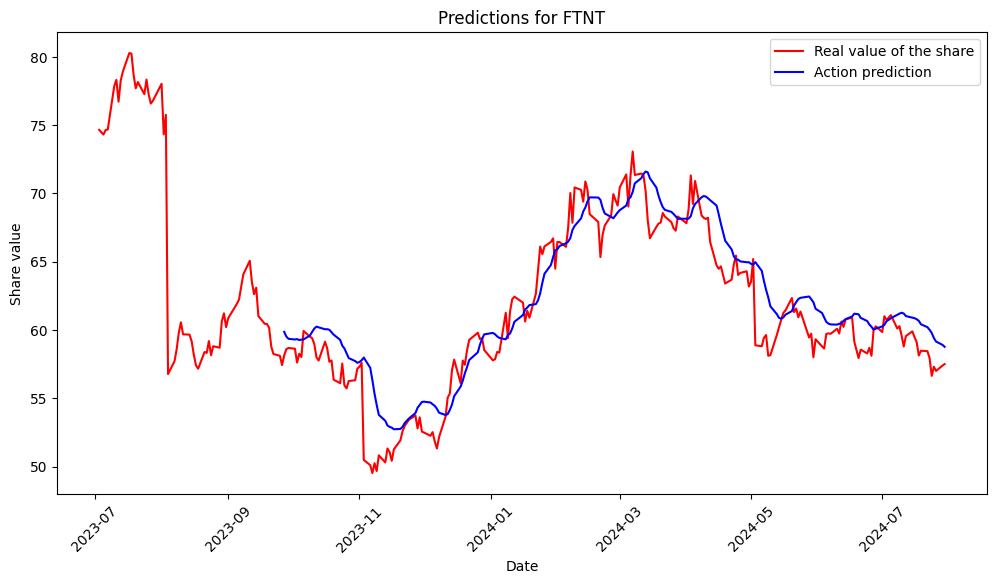

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for FTNT: 4.541226505209596
Normalized Mean Squared Error (Normalized MSE) for FTNT: 0.0011720216736558012
Mean Absolute Error (MAE) for FTNT: 1.6639095326447773
R^2 Score for FTNT: 0.8537158690688774
Processing KLAC...
Model loaded for KLAC.


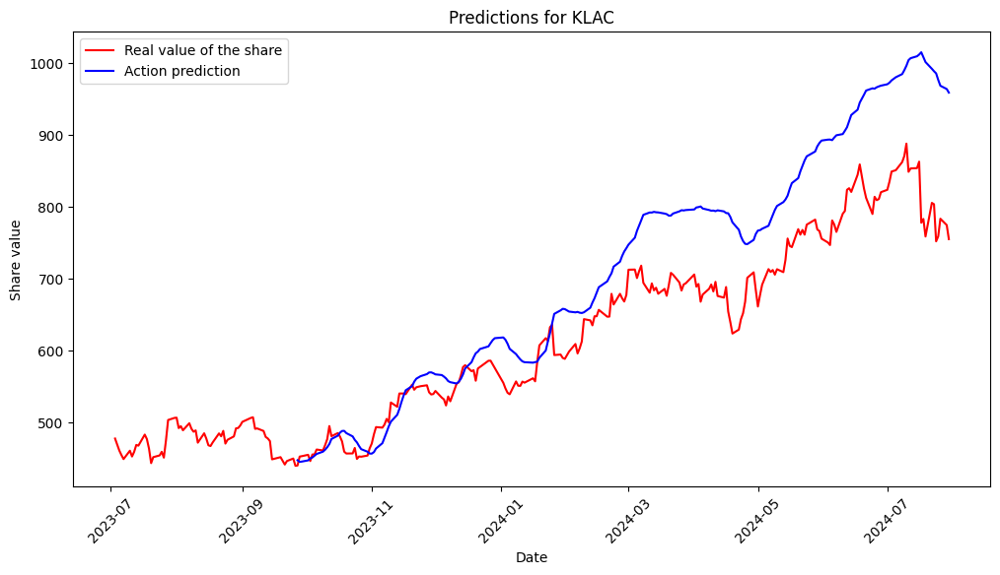

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for KLAC: 8133.625160344002
Normalized Mean Squared Error (Normalized MSE) for KLAC: 0.022045706102349932
Mean Absolute Error (MAE) for KLAC: 70.57686664344104
R^2 Score for KLAC: 0.403282274108296
Processing APH...
Model loaded for APH.


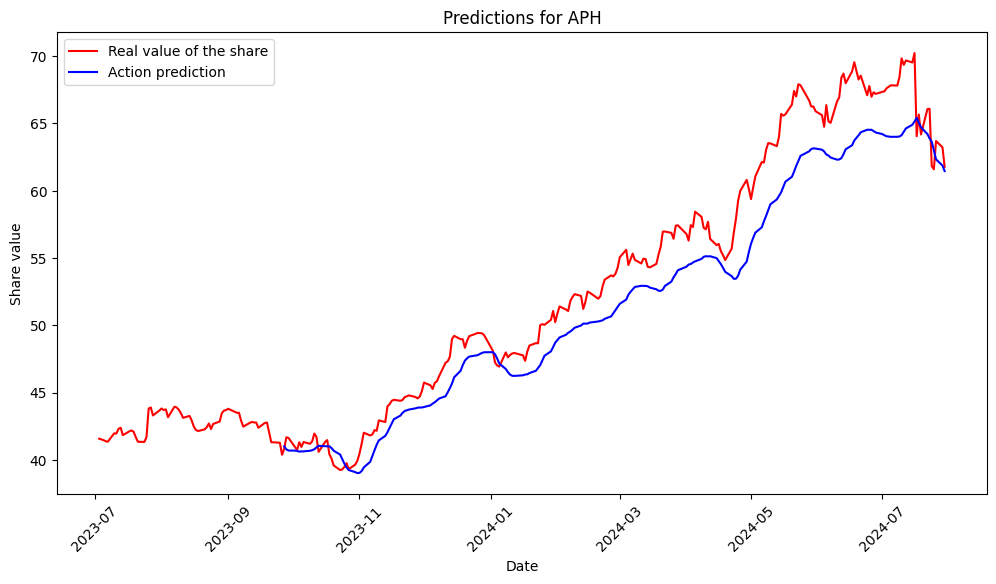

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for APH: 8.087824366278213
Normalized Mean Squared Error (Normalized MSE) for APH: 0.003042774570158926
Mean Absolute Error (MAE) for APH: 2.404490755449005
R^2 Score for APH: 0.9056326089546116
Processing TEL...
Model loaded for TEL.


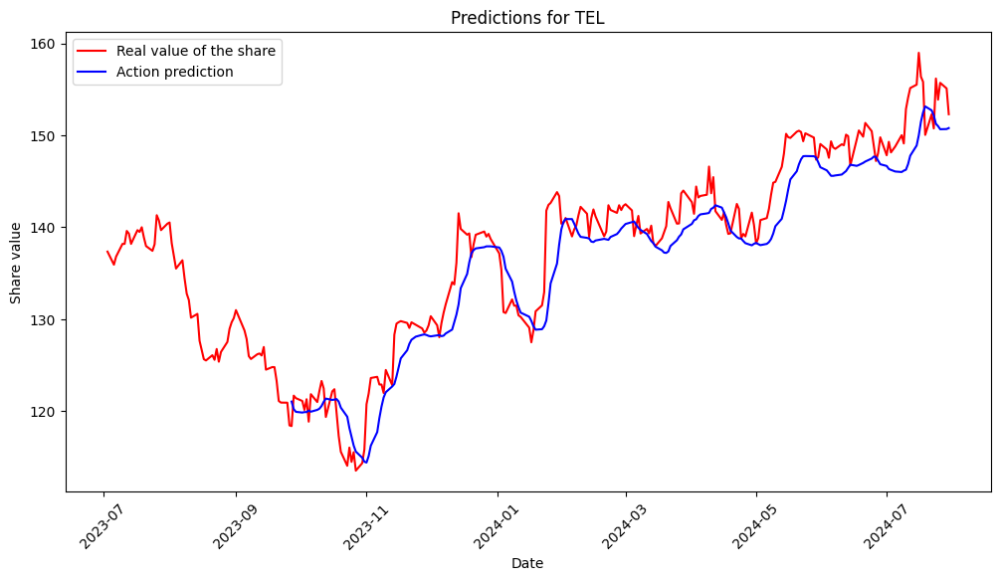

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for TEL: 11.97414738281193
Normalized Mean Squared Error (Normalized MSE) for TEL: 0.0006395239468053127
Mean Absolute Error (MAE) for TEL: 2.7031838910868795
R^2 Score for TEL: 0.89263001565923
Processing MCHP...
Model loaded for MCHP.


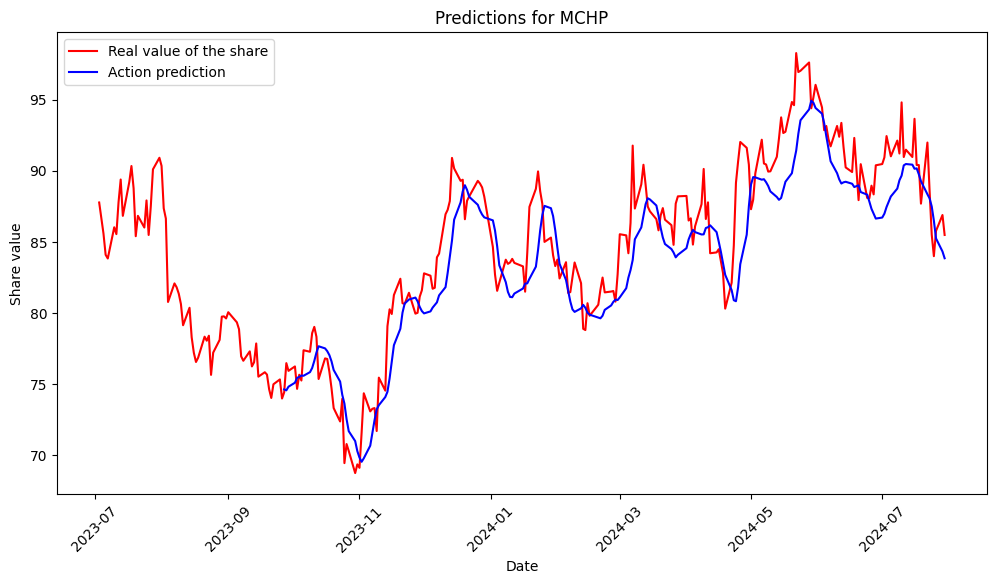

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for MCHP: 7.591371714305424
Normalized Mean Squared Error (Normalized MSE) for MCHP: 0.0010690905377952703
Mean Absolute Error (MAE) for MCHP: 2.18780253168836
R^2 Score for MCHP: 0.812395548979348
Processing NXPI...
Model loaded for NXPI.


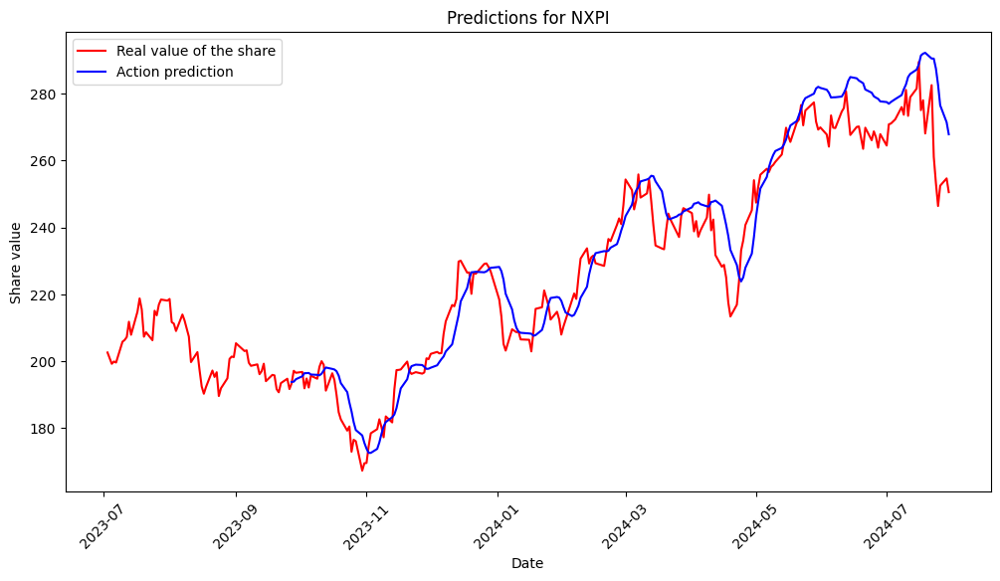

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for NXPI: 88.35425396713629
Normalized Mean Squared Error (Normalized MSE) for NXPI: 0.0017461759534538222
Mean Absolute Error (MAE) for NXPI: 7.090984023675894
R^2 Score for NXPI: 0.9059805519488481
Processing ON...
Model loaded for ON.


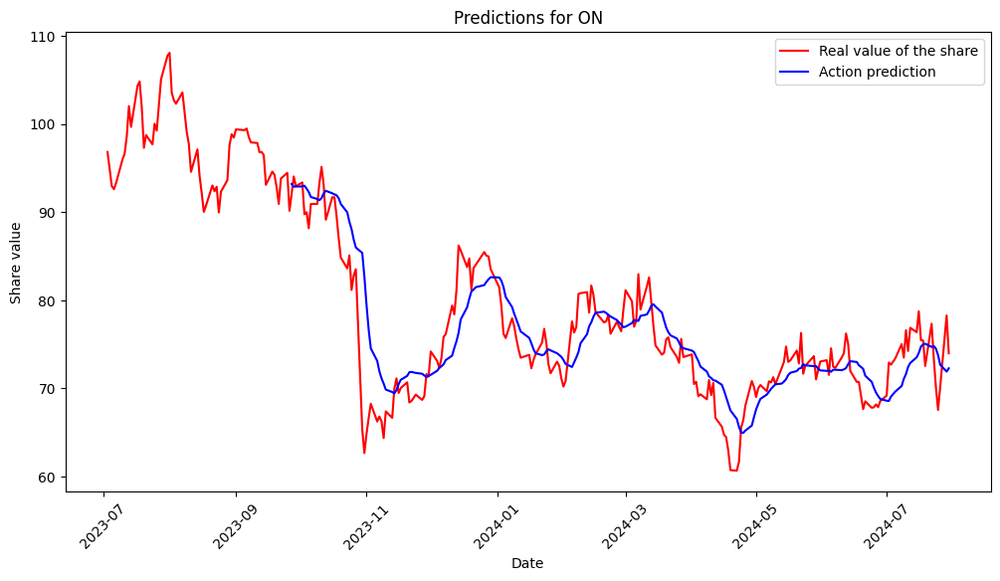

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for ON: 15.133655879003435
Normalized Mean Squared Error (Normalized MSE) for ON: 0.002357505818060748
Mean Absolute Error (MAE) for ON: 2.8230933607831923
R^2 Score for ON: 0.6978730286879318
Processing MPWR...
Model loaded for MPWR.


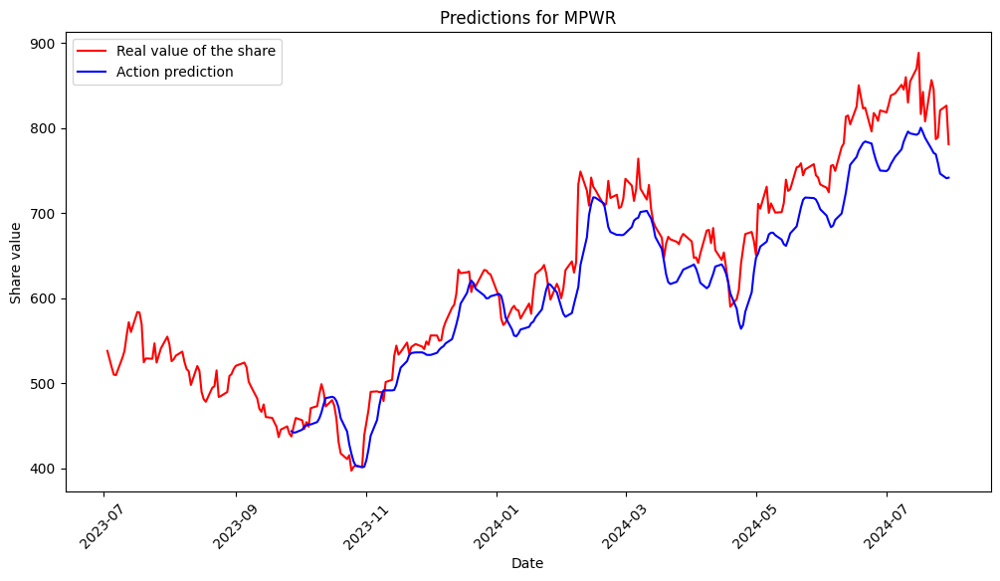

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for MPWR: 1823.3357095695449
Normalized Mean Squared Error (Normalized MSE) for MPWR: 0.004743465704877105
Mean Absolute Error (MAE) for MPWR: 34.97591336215336
R^2 Score for MPWR: 0.8721637105326141
Processing ADI...
Model loaded for ADI.


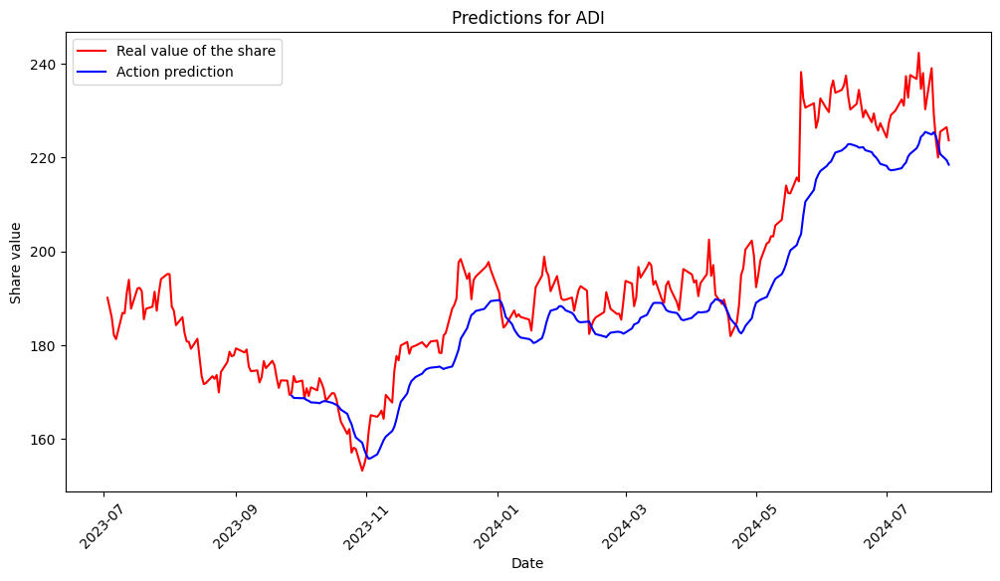

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for ADI: 85.31868080126296
Normalized Mean Squared Error (Normalized MSE) for ADI: 0.0022942688440787144
Mean Absolute Error (MAE) for ADI: 7.640768219715468
R^2 Score for ADI: 0.8244896042131162
Processing KEYS...
Model loaded for KEYS.


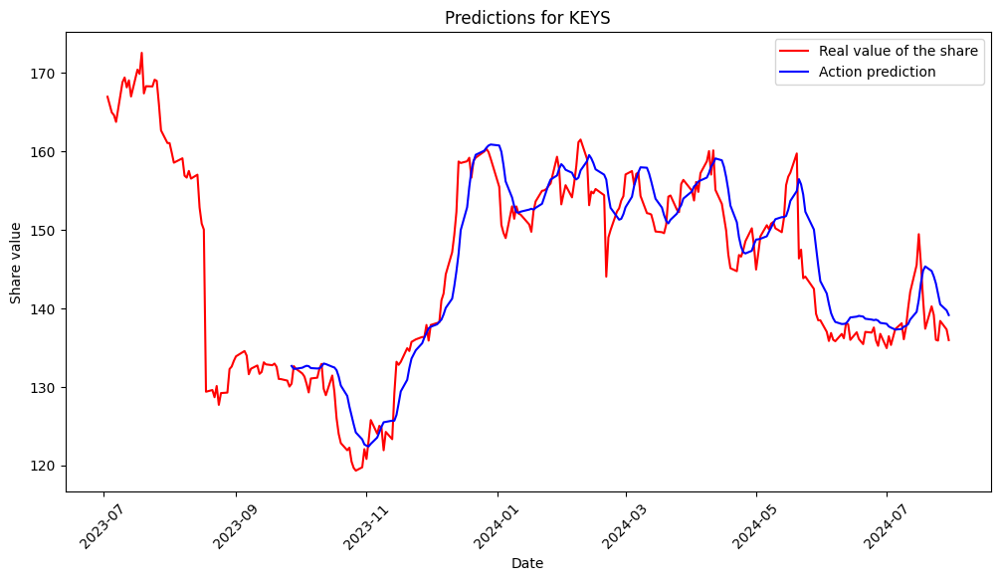

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for KEYS: 15.811577865641631
Normalized Mean Squared Error (Normalized MSE) for KEYS: 0.0007482729165894712
Mean Absolute Error (MAE) for KEYS: 3.0166997859347737
R^2 Score for KEYS: 0.8741860150765666
Processing CDW...
Model loaded for CDW.


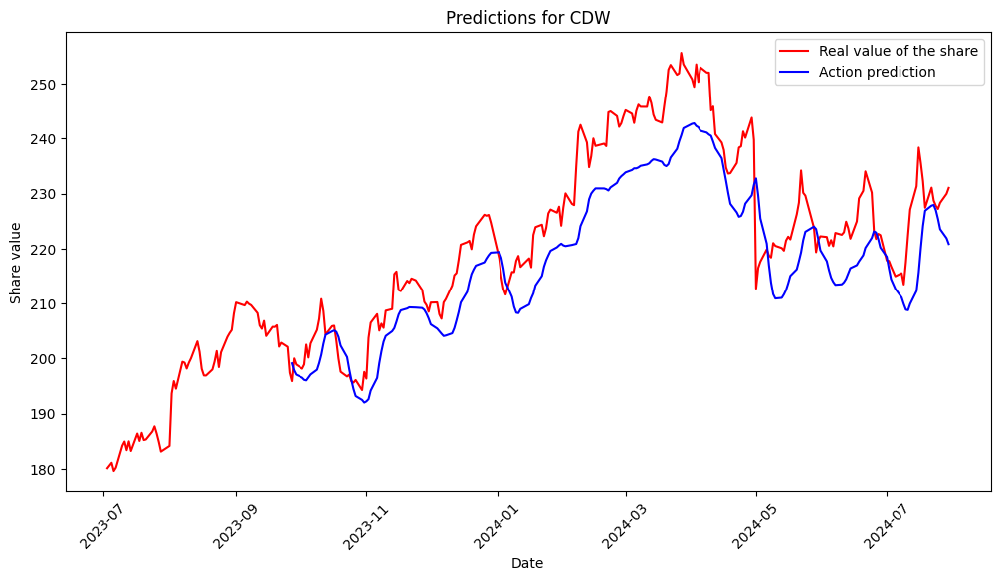

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for CDW: 73.31522022128912
Normalized Mean Squared Error (Normalized MSE) for CDW: 0.0015410146147832493
Mean Absolute Error (MAE) for CDW: 7.332258428238014
R^2 Score for CDW: 0.6794177489970854
Processing ANSS...
Model loaded for ANSS.


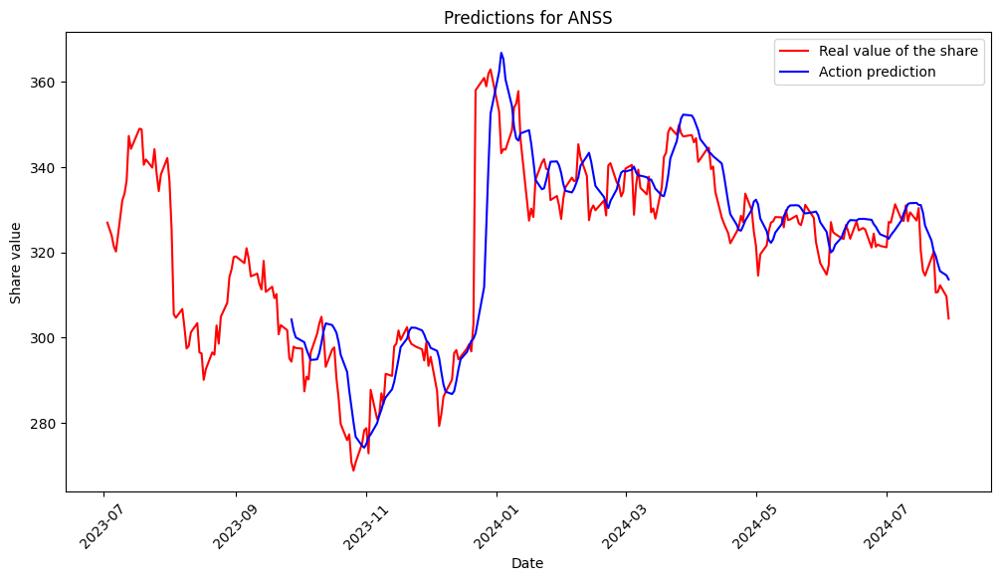

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for ANSS: 82.78417818527647
Normalized Mean Squared Error (Normalized MSE) for ANSS: 0.0008099768266581315
Mean Absolute Error (MAE) for ANSS: 6.111536334721082
R^2 Score for ANSS: 0.8219550967557917
Processing PAYC...
Model loaded for PAYC.


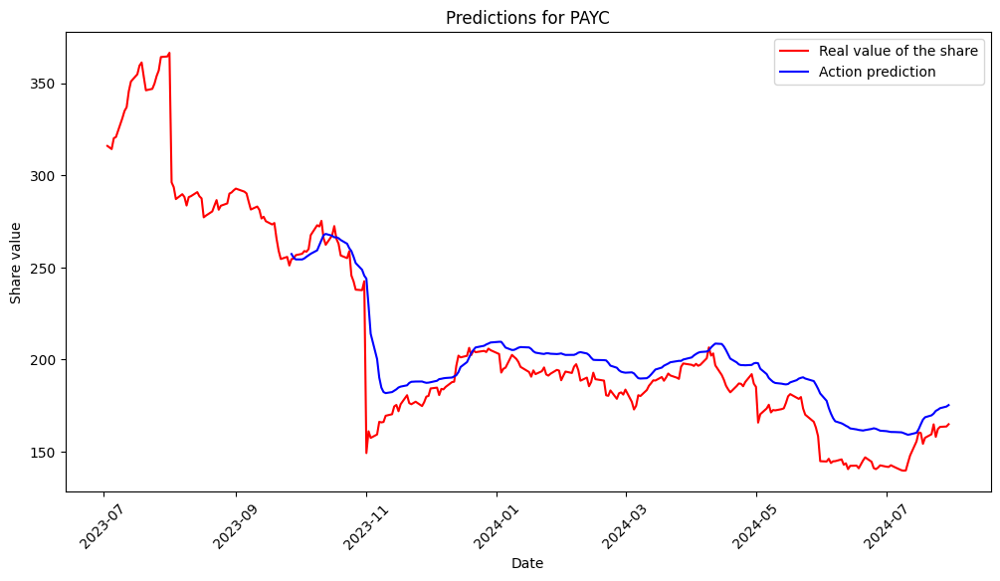

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for PAYC: 257.2224484428291
Normalized Mean Squared Error (Normalized MSE) for PAYC: 0.005671702383712292
Mean Absolute Error (MAE) for PAYC: 12.272539699507464
R^2 Score for PAYC: 0.7481016253169828
Processing GDDY...
Model loaded for GDDY.


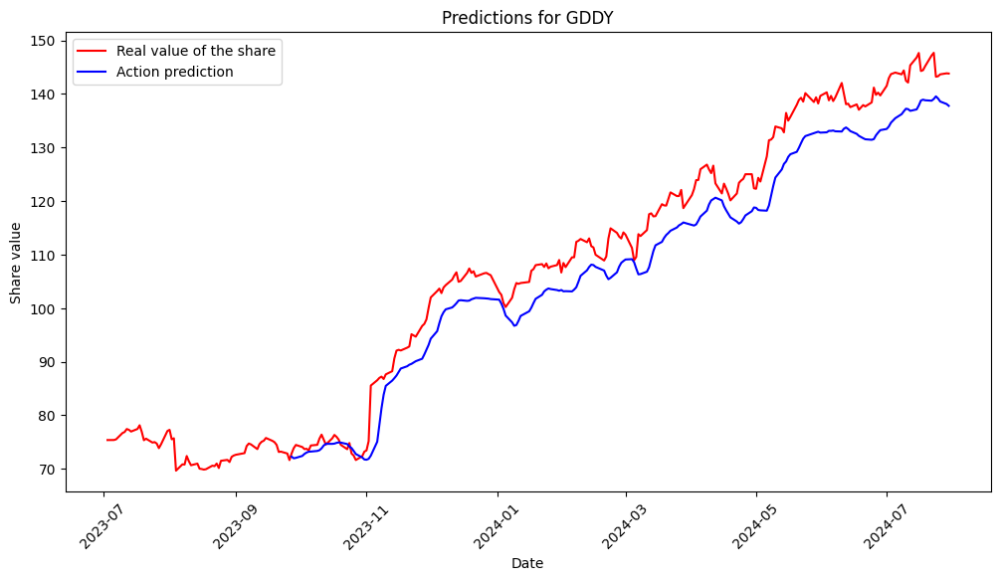

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for GDDY: 35.35641435719435
Normalized Mean Squared Error (Normalized MSE) for GDDY: 0.0032166612218849215
Mean Absolute Error (MAE) for GDDY: 5.348339467907568
R^2 Score for GDDY: 0.9248616115441969
Processing TYL...
Model loaded for TYL.


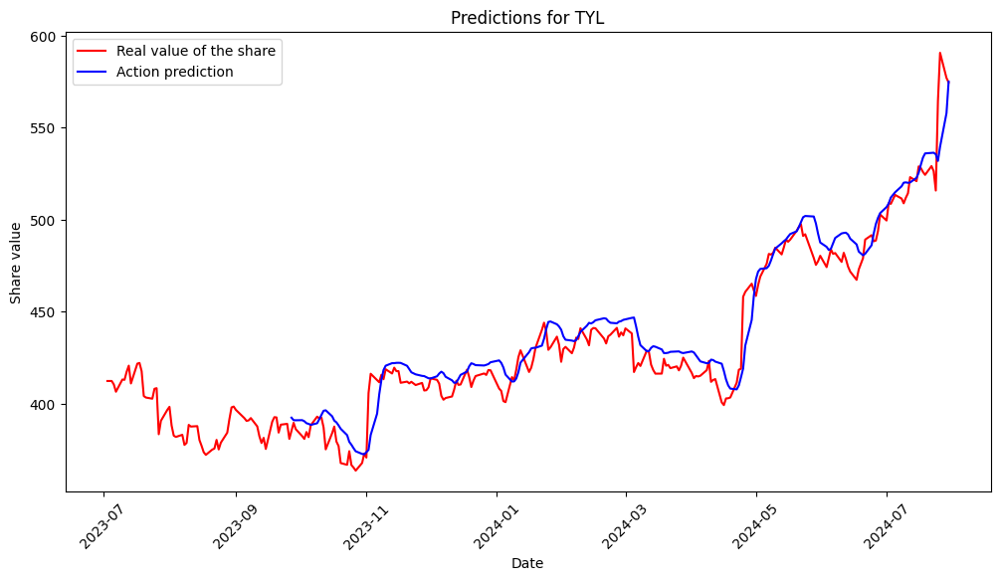

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for TYL: 125.0822493799414
Normalized Mean Squared Error (Normalized MSE) for TYL: 0.0006813625448107134
Mean Absolute Error (MAE) for TYL: 8.465036891550524
R^2 Score for TYL: 0.9368754101496007
Processing SSNC...
Model loaded for SSNC.


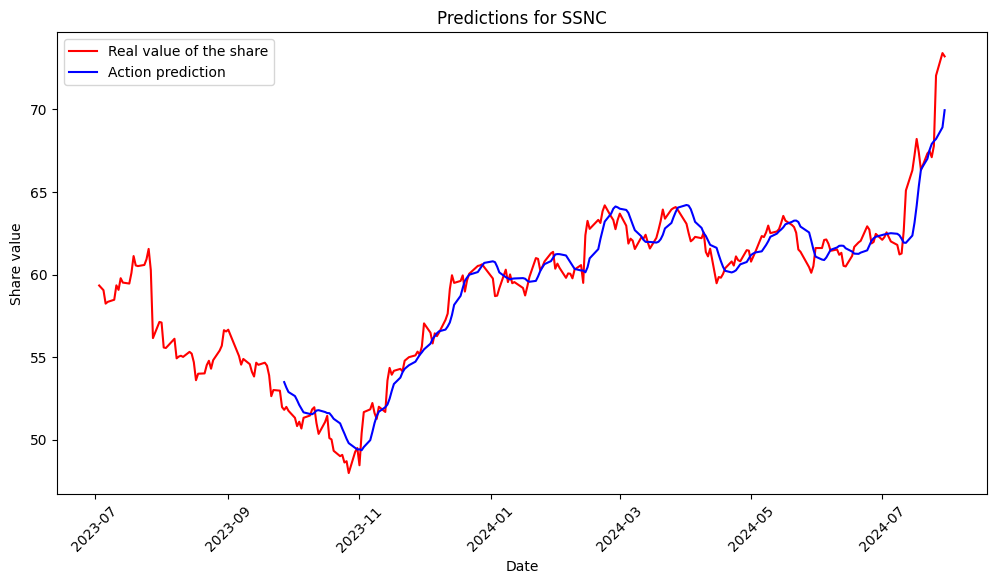

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for SSNC: 1.4447371514215765
Normalized Mean Squared Error (Normalized MSE) for SSNC: 0.0004169321143933945
Mean Absolute Error (MAE) for SSNC: 0.8872991253896677
R^2 Score for SSNC: 0.9390389736336975
Processing JKHY...
Model loaded for JKHY.


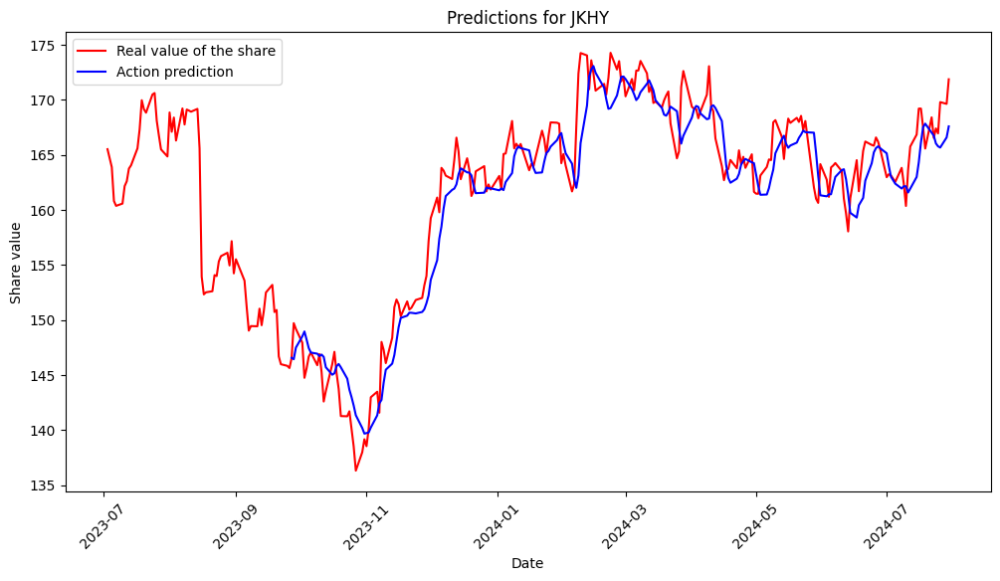

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for JKHY: 6.561115877708093
Normalized Mean Squared Error (Normalized MSE) for JKHY: 0.0002519932770194036
Mean Absolute Error (MAE) for JKHY: 1.977341520875293
R^2 Score for JKHY: 0.9227233962691045
Processing EPAM...
Model loaded for EPAM.


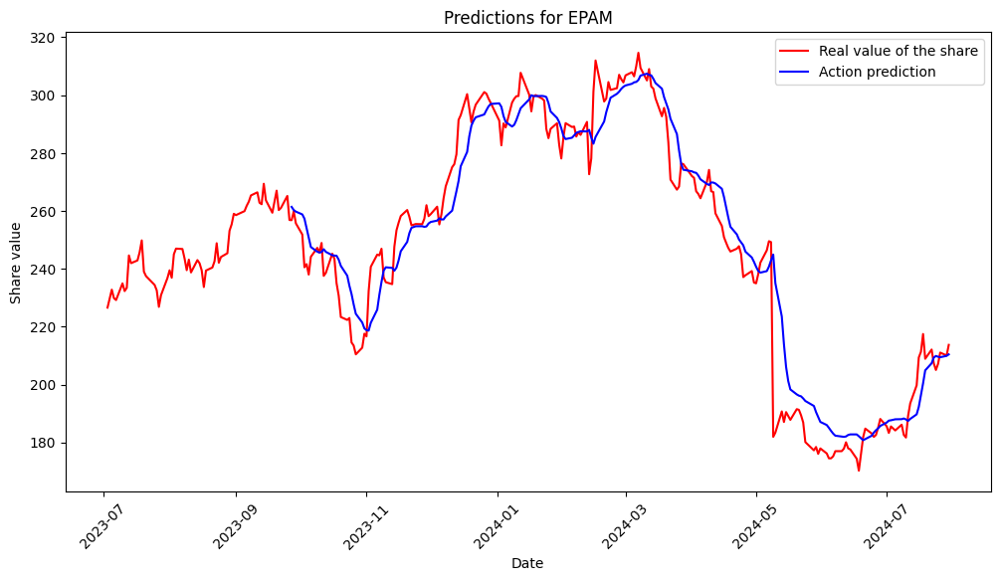

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for EPAM: 114.57163331158921
Normalized Mean Squared Error (Normalized MSE) for EPAM: 0.00186748748871188
Mean Absolute Error (MAE) for EPAM: 7.600815031474236
R^2 Score for EPAM: 0.938399349101485
Processing GLW...
Model loaded for GLW.


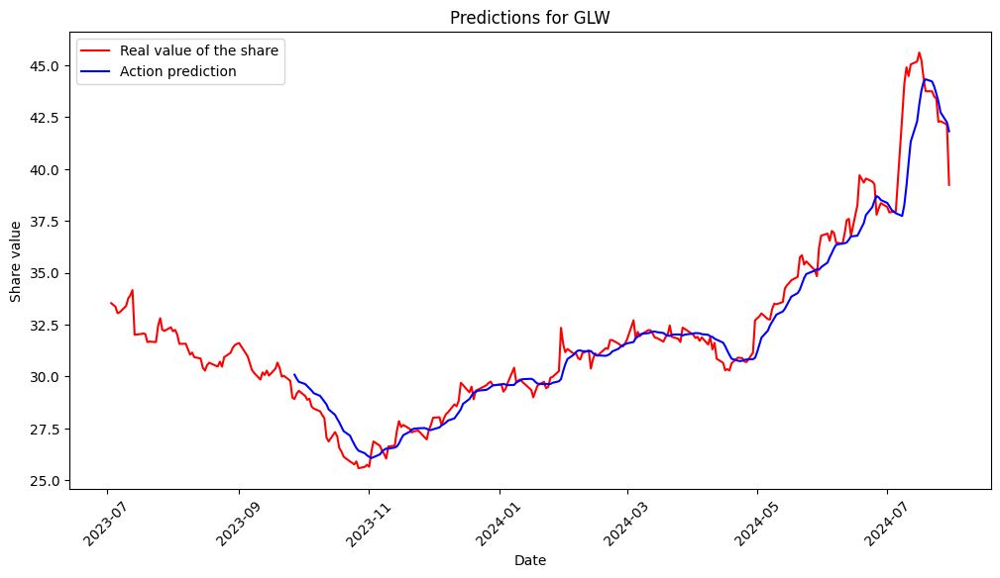

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for GLW: 1.1800204029458399
Normalized Mean Squared Error (Normalized MSE) for GLW: 0.0011552518401756167
Mean Absolute Error (MAE) for GLW: 0.6731946079366886
R^2 Score for GLW: 0.9478526078793076
Processing HPQ...
Model loaded for HPQ.


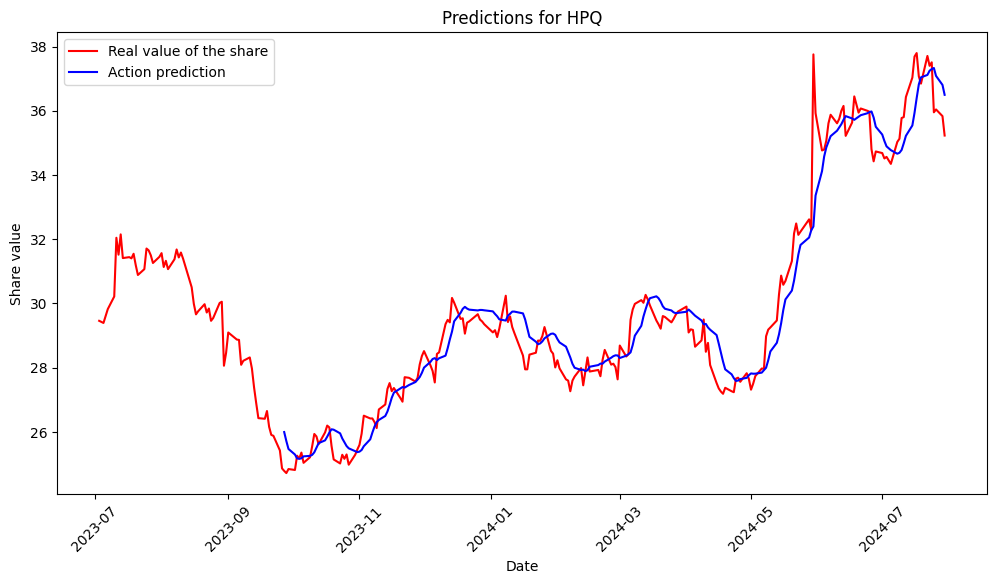

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for HPQ: 0.5953452863672316
Normalized Mean Squared Error (Normalized MSE) for HPQ: 0.0006751642638956647
Mean Absolute Error (MAE) for HPQ: 0.5599155600487903
R^2 Score for HPQ: 0.9504110088487274
Processing DXC...
Model loaded for DXC.


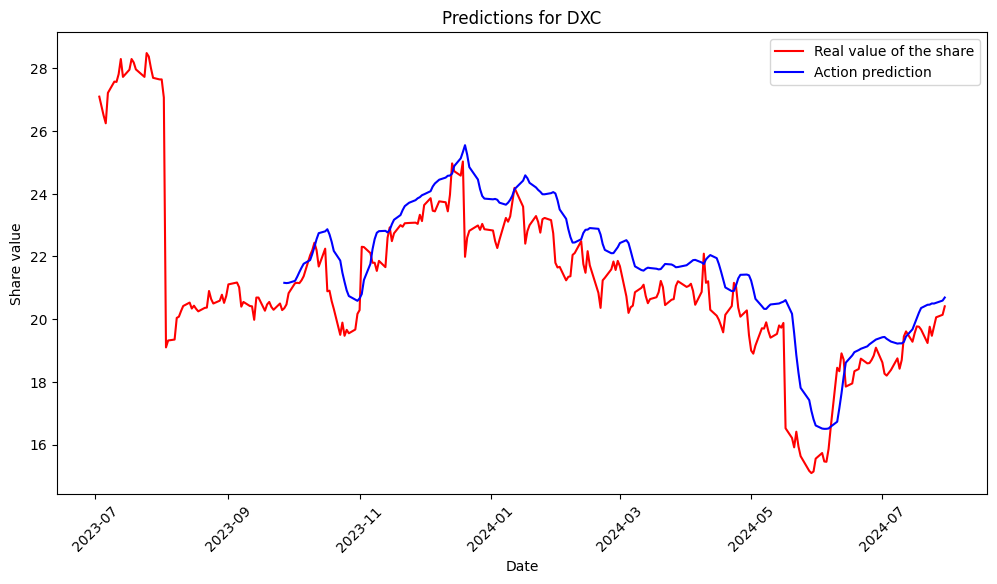

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for DXC: 1.4855492164797026
Normalized Mean Squared Error (Normalized MSE) for DXC: 0.003280846947583733
Mean Absolute Error (MAE) for DXC: 0.9933860832373318
R^2 Score for DXC: 0.6596524404345963
Processing IT...
Model loaded for IT.


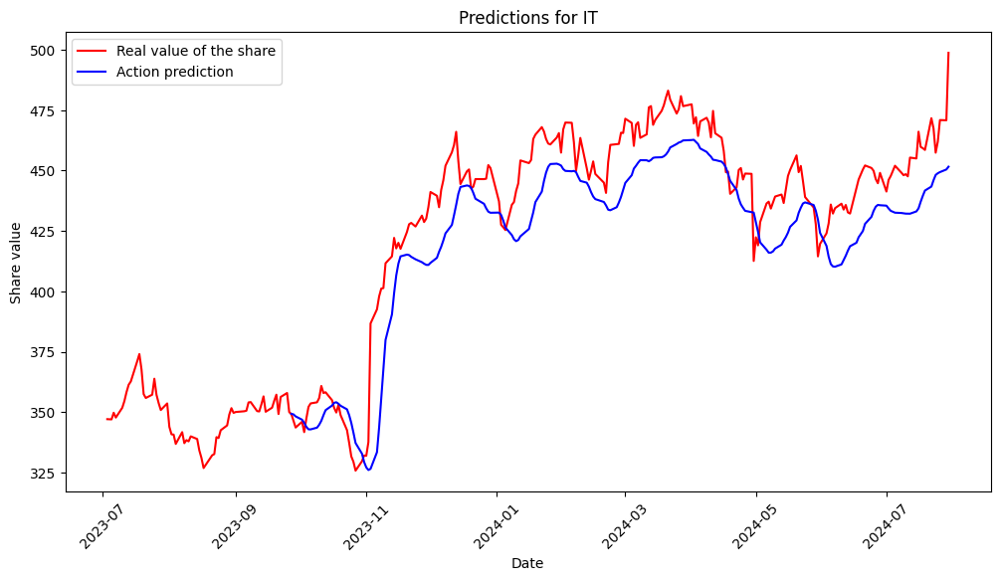

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for IT: 346.14058798531056
Normalized Mean Squared Error (Normalized MSE) for IT: 0.0019950355658768515
Mean Absolute Error (MAE) for IT: 15.661994332084959
R^2 Score for IT: 0.7721510813590405
Processing LDOS...
Model loaded for LDOS.


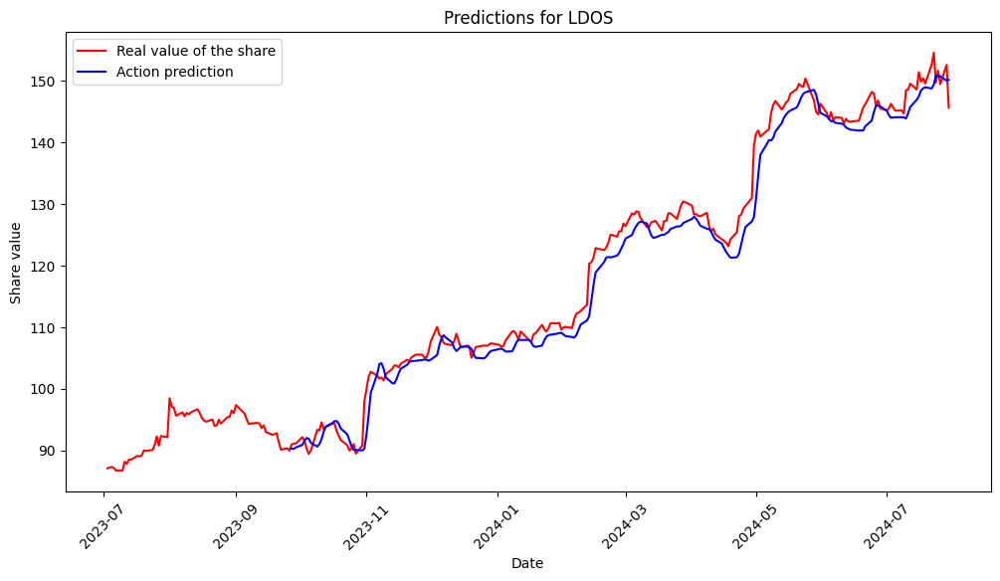

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for LDOS: 7.5125186892375435
Normalized Mean Squared Error (Normalized MSE) for LDOS: 0.0005632151459476121
Mean Absolute Error (MAE) for LDOS: 2.083100305279689
R^2 Score for LDOS: 0.9797092892244192
Processing AKAM...
Model loaded for AKAM.


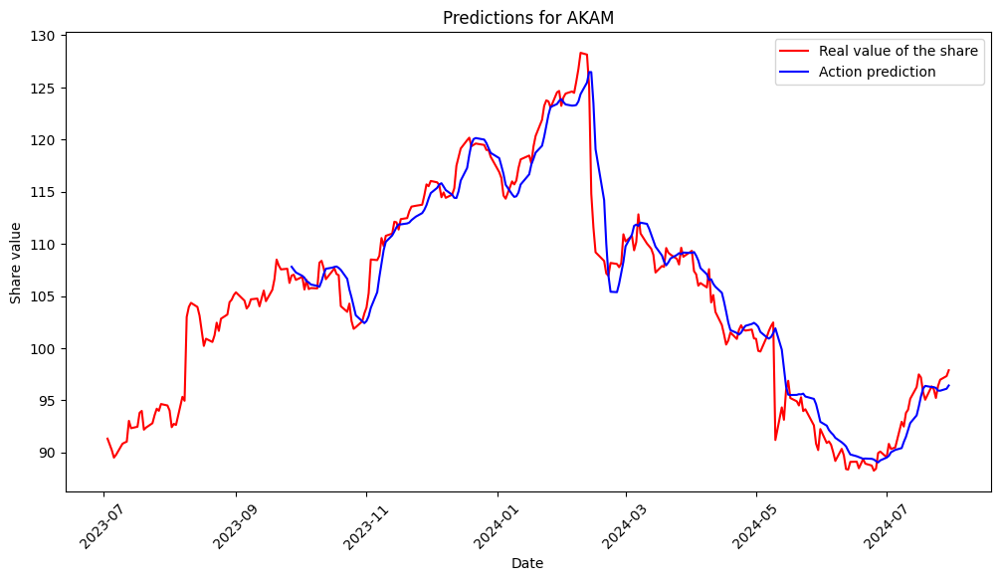

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for AKAM: 5.263120285531957
Normalized Mean Squared Error (Normalized MSE) for AKAM: 0.0004795399351542448
Mean Absolute Error (MAE) for AKAM: 1.5520308367431037
R^2 Score for AKAM: 0.9506098316050177
Processing NTAP...
Model loaded for NTAP.


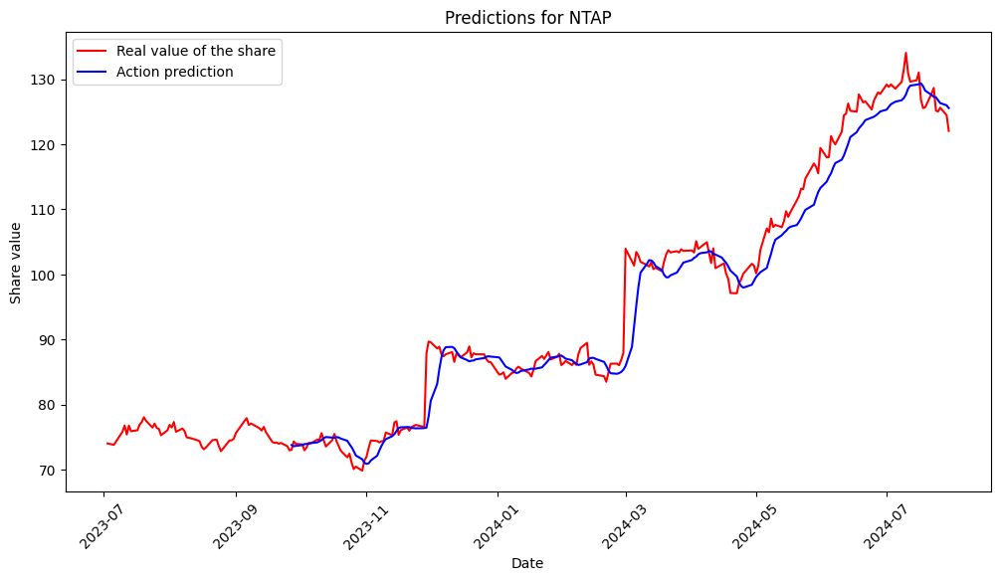

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for NTAP: 10.420923629262246
Normalized Mean Squared Error (Normalized MSE) for NTAP: 0.0012240166748293375
Mean Absolute Error (MAE) for NTAP: 2.2052650079406657
R^2 Score for NTAP: 0.9685506304948336
Processing VRSN...
Model loaded for VRSN.


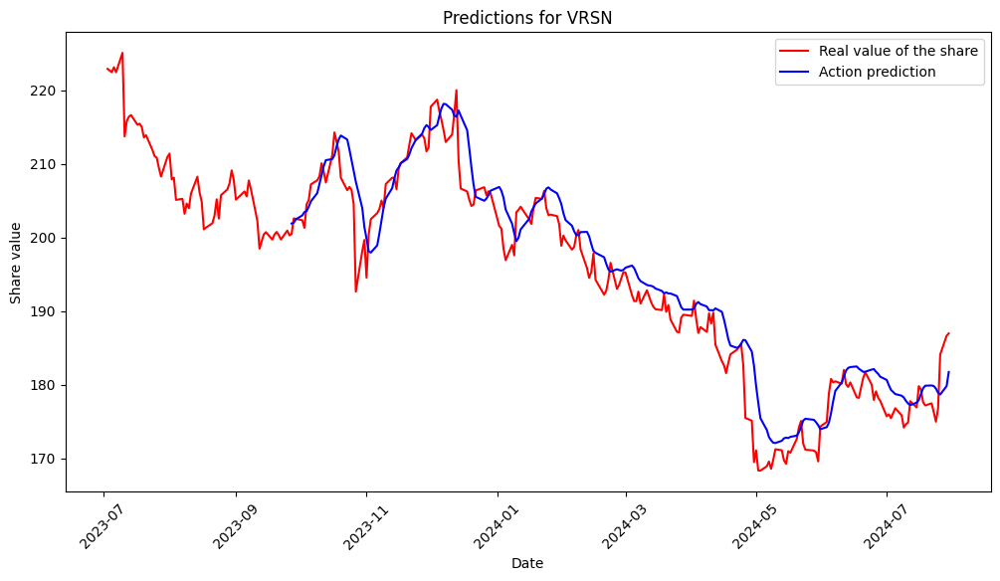

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for VRSN: 14.161375686316603
Normalized Mean Squared Error (Normalized MSE) for VRSN: 0.0003682071659314824
Mean Absolute Error (MAE) for VRSN: 2.9162240269282345
R^2 Score for VRSN: 0.9268649979307708
Processing FFIV...
Model loaded for FFIV.


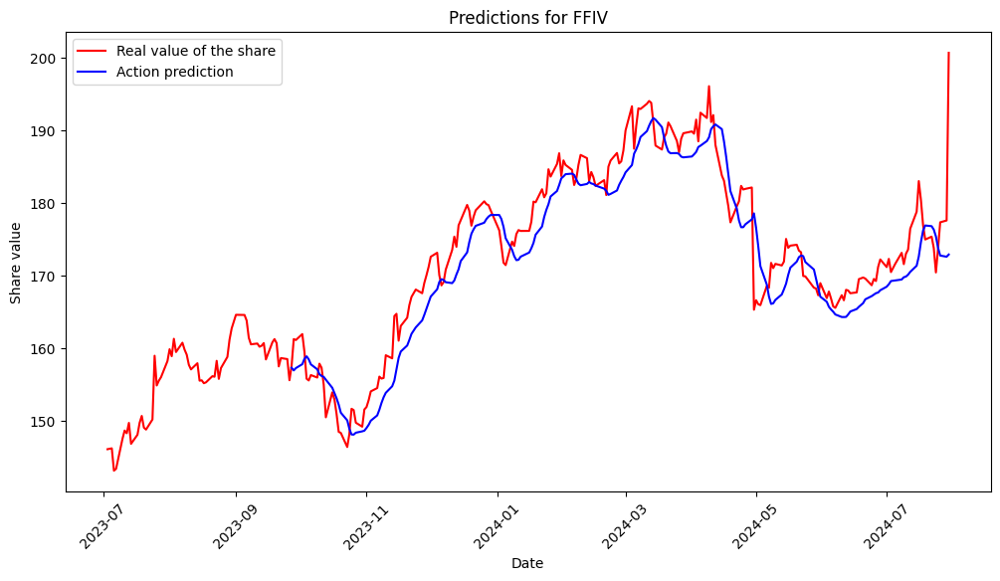

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for FFIV: 18.141754120399014
Normalized Mean Squared Error (Normalized MSE) for FFIV: 0.0006269702101222972
Mean Absolute Error (MAE) for FFIV: 3.3367316046495192
R^2 Score for FFIV: 0.869024422251036
Processing XRX...
Model loaded for XRX.


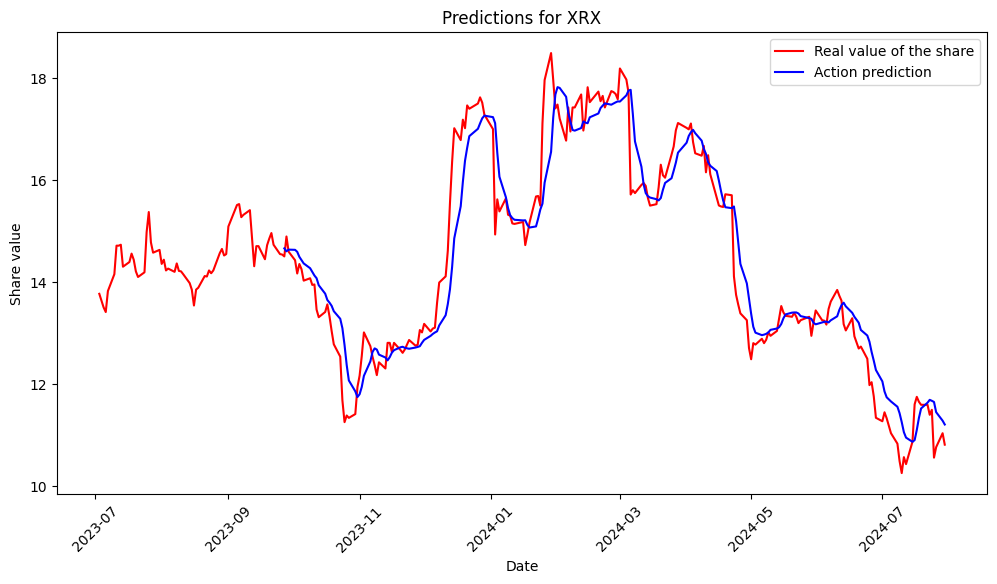

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for XRX: 0.396453892164942
Normalized Mean Squared Error (Normalized MSE) for XRX: 0.0019158689892529572
Mean Absolute Error (MAE) for XRX: 0.44477744798198177
R^2 Score for XRX: 0.9137281192776178
Processing JNPR...
Model loaded for JNPR.


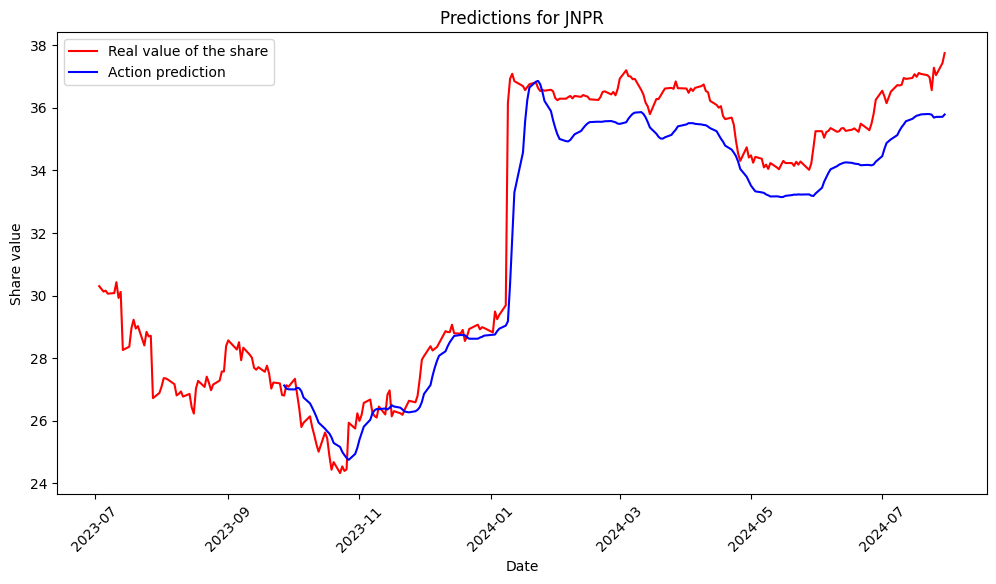

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for JNPR: 1.6129096104839677
Normalized Mean Squared Error (Normalized MSE) for JNPR: 0.0015893183592969391
Mean Absolute Error (MAE) for JNPR: 0.9749060483750123
R^2 Score for JNPR: 0.9160087736788634
Processing CSGP...
Model loaded for CSGP.


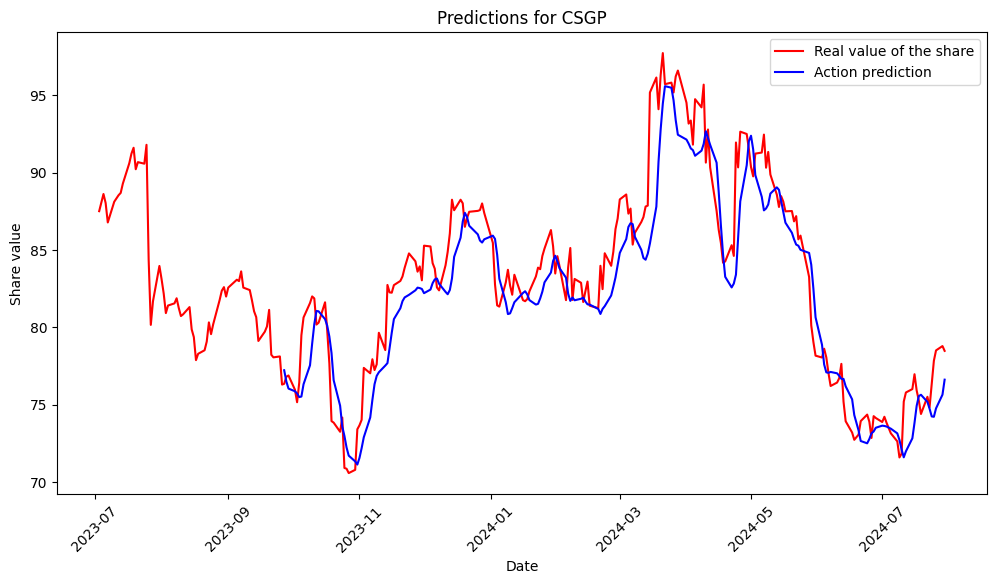

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for CSGP: 5.692180510280855
Normalized Mean Squared Error (Normalized MSE) for CSGP: 0.0008264913900195505
Mean Absolute Error (MAE) for CSGP: 1.871456088926574
R^2 Score for CSGP: 0.8626388120456193
Processing TRMB...
Model loaded for TRMB.


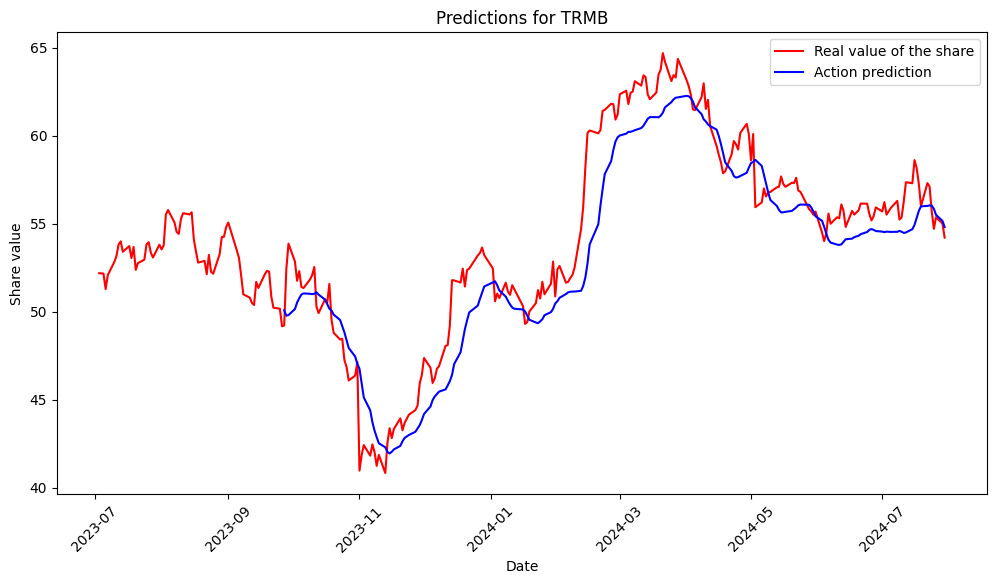

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for TRMB: 4.265440687668813
Normalized Mean Squared Error (Normalized MSE) for TRMB: 0.001462903105541538
Mean Absolute Error (MAE) for TRMB: 1.6433969145331322
R^2 Score for TRMB: 0.8761819301632515
Processing GRMN...
Model loaded for GRMN.


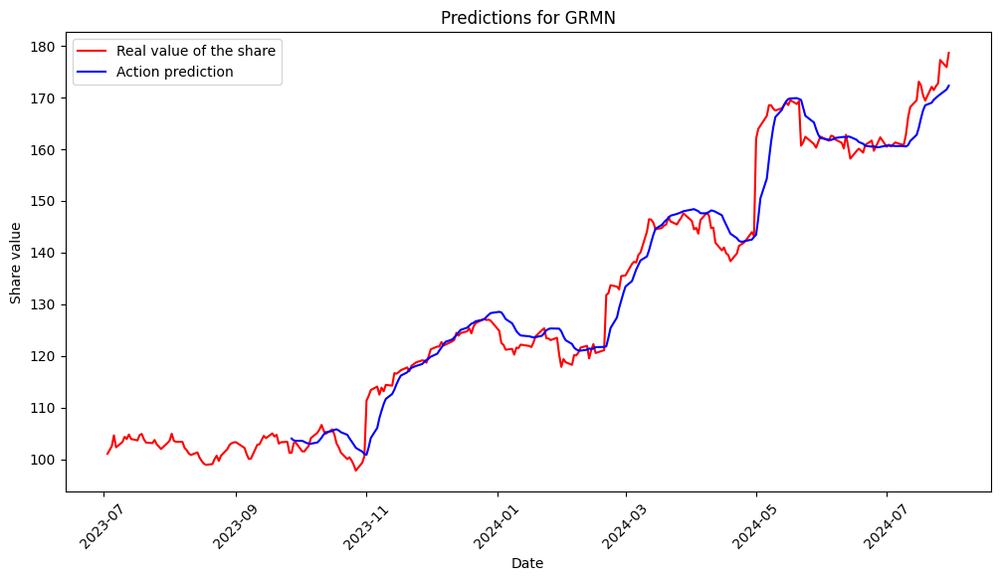

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for GRMN: 16.369563329857904
Normalized Mean Squared Error (Normalized MSE) for GRMN: 0.0009842849003225715
Mean Absolute Error (MAE) for GRMN: 2.725031654873527
R^2 Score for GRMN: 0.9665968596009581
Processing ZBRA...
Model loaded for ZBRA.


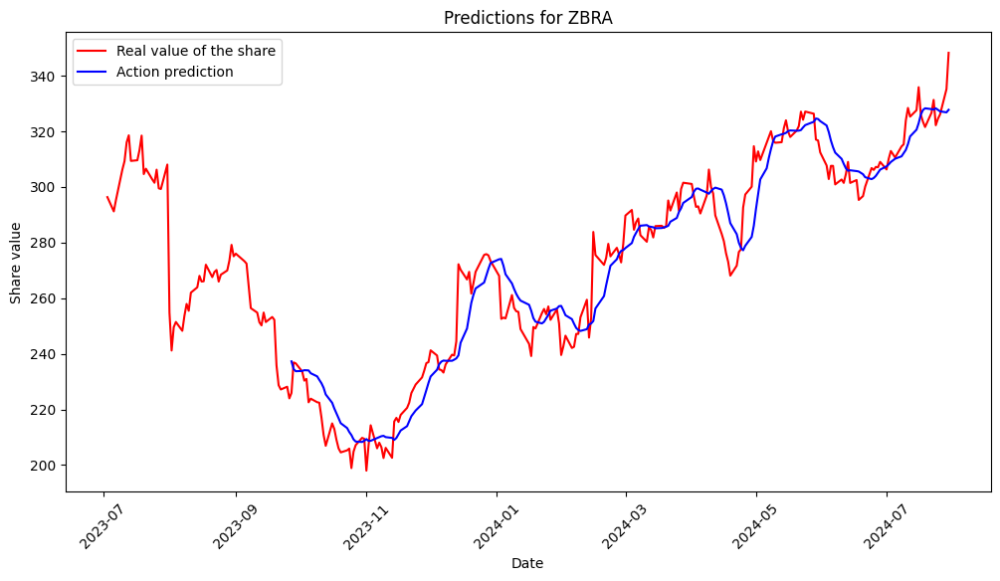

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for ZBRA: 86.39648661855163
Normalized Mean Squared Error (Normalized MSE) for ZBRA: 0.0011661684522667722
Mean Absolute Error (MAE) for ZBRA: 7.145571683161128
R^2 Score for ZBRA: 0.9421404480271512
Processing BR...
Model loaded for BR.


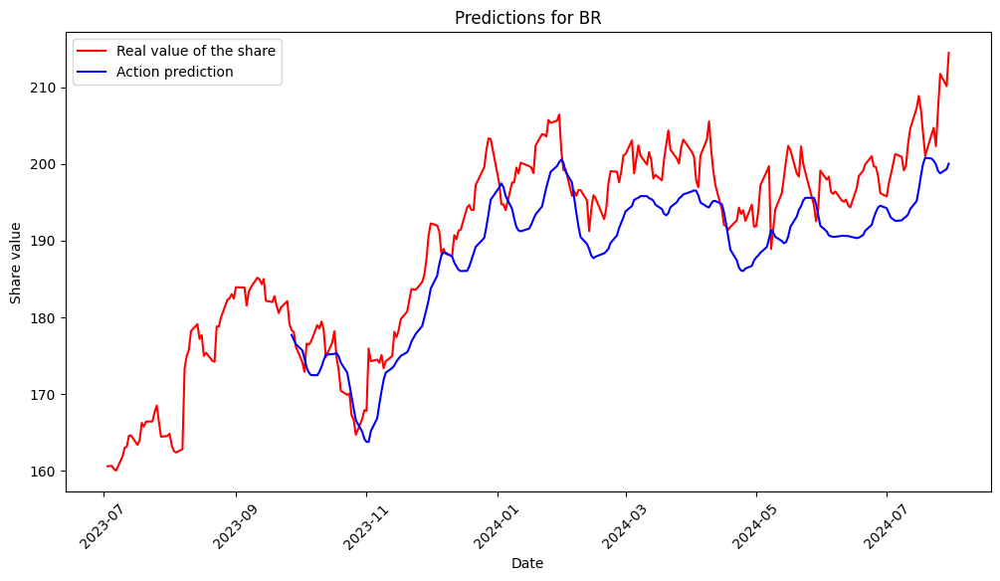

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for BR: 38.30084437653616
Normalized Mean Squared Error (Normalized MSE) for BR: 0.001071809245989467
Mean Absolute Error (MAE) for BR: 5.3852949714039635
R^2 Score for BR: 0.6464802244296445
Processing VRSN...
Model loaded for VRSN.


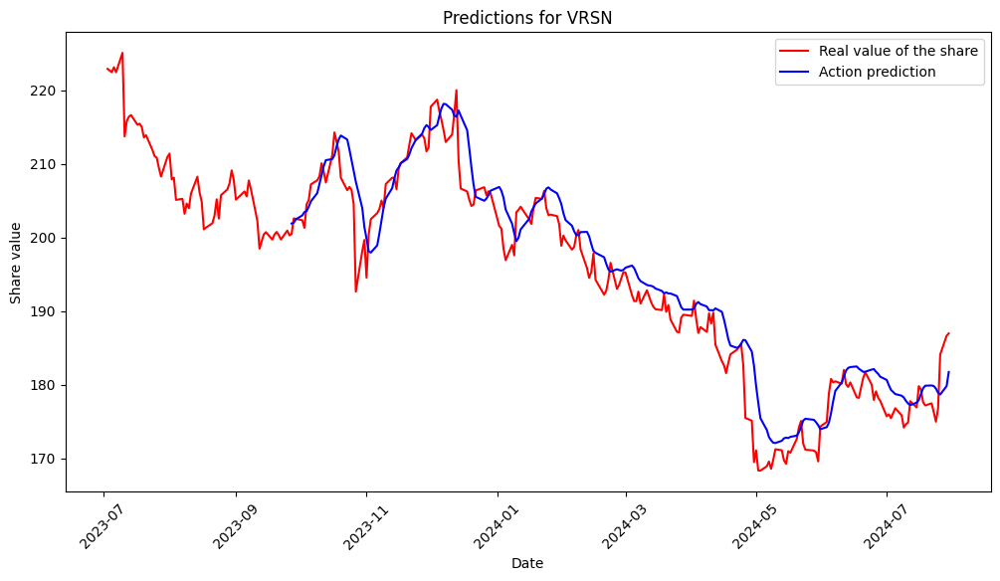

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for VRSN: 14.161375686316603
Normalized Mean Squared Error (Normalized MSE) for VRSN: 0.0003682071659314824
Mean Absolute Error (MAE) for VRSN: 2.9162240269282345
R^2 Score for VRSN: 0.9268649979307708
Processing PTC...
Model loaded for PTC.


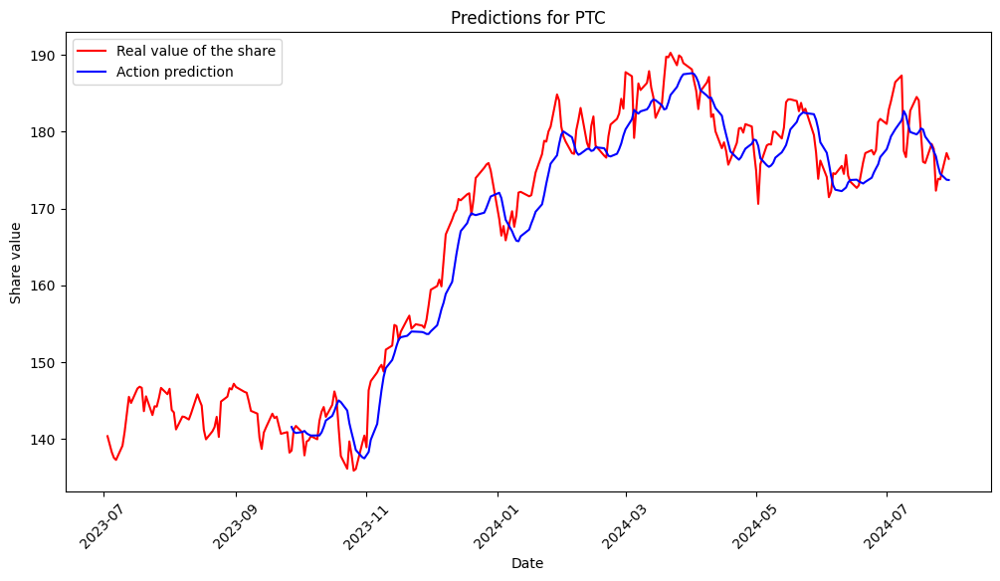

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for PTC: 13.982567827007015
Normalized Mean Squared Error (Normalized MSE) for PTC: 0.000513775614685298
Mean Absolute Error (MAE) for PTC: 3.155801203670451
R^2 Score for PTC: 0.9368457296586514
Processing CTSH...
Model loaded for CTSH.


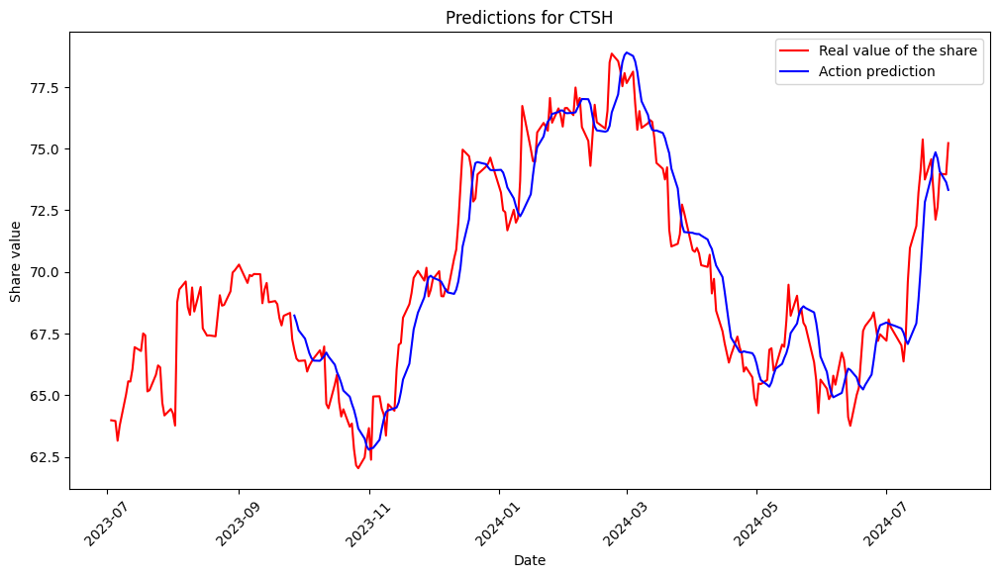

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for CTSH: 2.164958854605272
Normalized Mean Squared Error (Normalized MSE) for CTSH: 0.00044789842488764613
Mean Absolute Error (MAE) for CTSH: 1.1284470062372214
R^2 Score for CTSH: 0.8908269518272717
Processing HPE...
Model loaded for HPE.


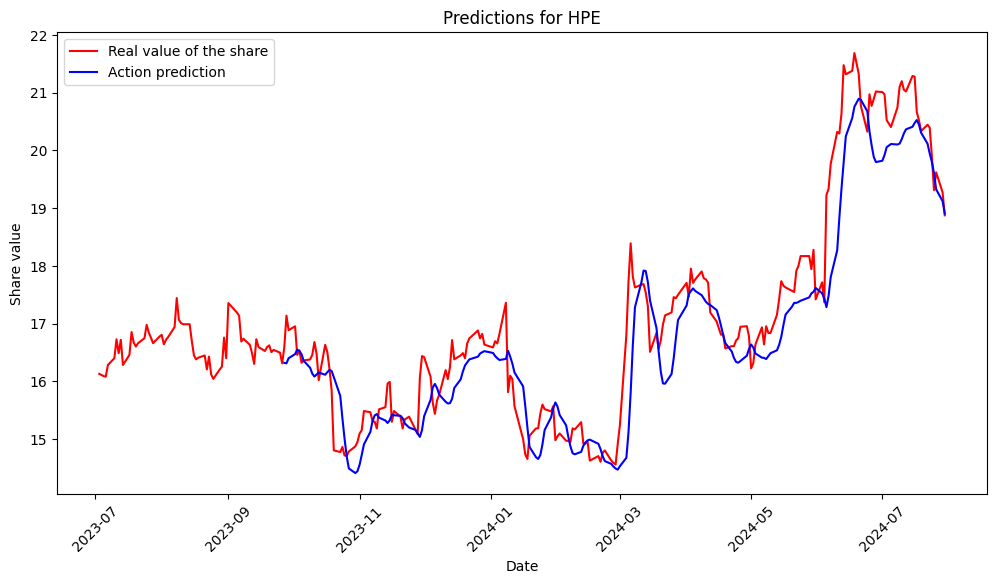

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for HPE: 0.45072242581566235
Normalized Mean Squared Error (Normalized MSE) for HPE: 0.0015671160682465678
Mean Absolute Error (MAE) for HPE: 0.4915904954225956
R^2 Score for HPE: 0.8768609364905842
Processing JNPR...
Model loaded for JNPR.


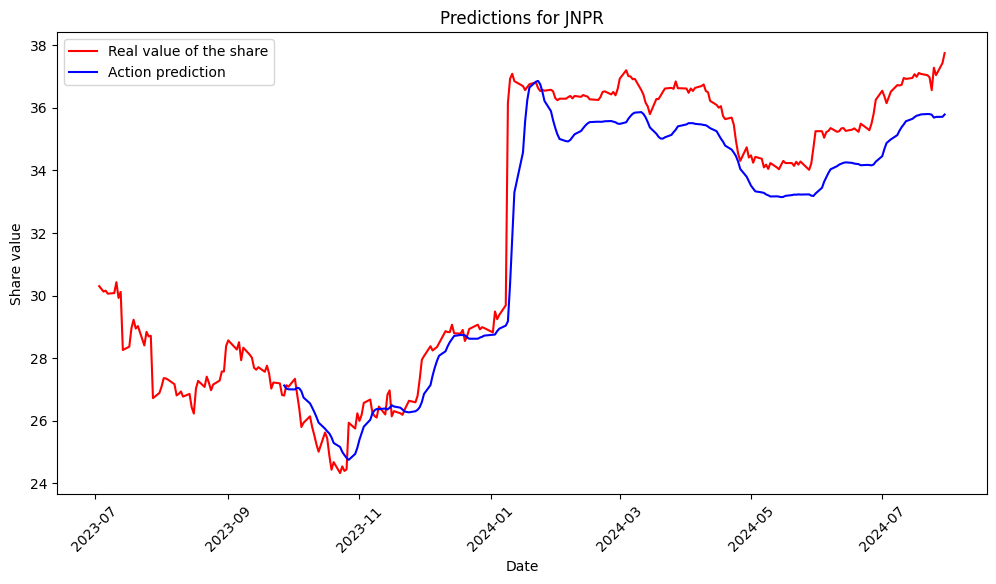

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for JNPR: 1.6129096104839677
Normalized Mean Squared Error (Normalized MSE) for JNPR: 0.0015893183592969391
Mean Absolute Error (MAE) for JNPR: 0.9749060483750123
R^2 Score for JNPR: 0.9160087736788634
Processing MSI...
Model loaded for MSI.


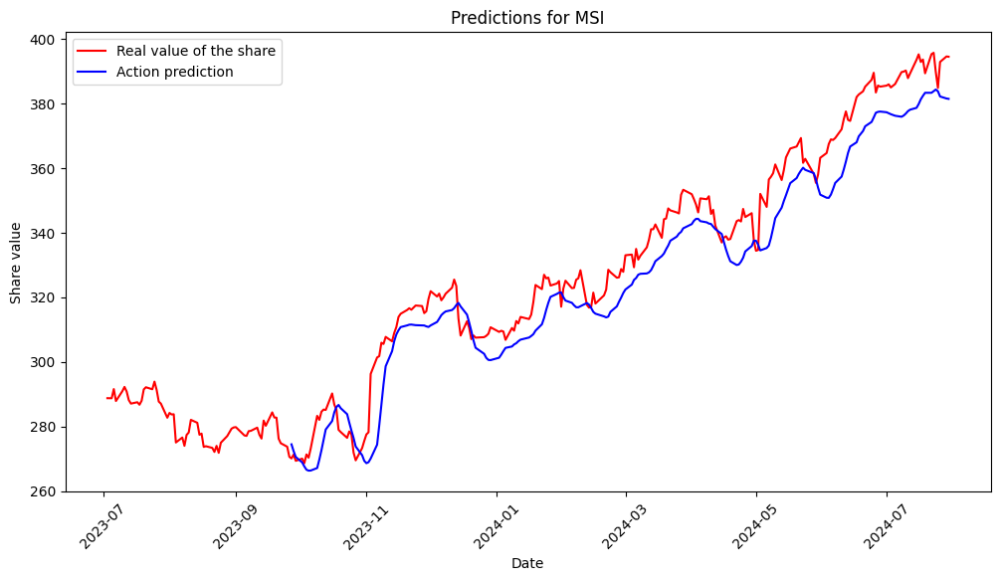

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for MSI: 90.9217964752664
Normalized Mean Squared Error (Normalized MSE) for MSI: 0.0008750611945192255
Mean Absolute Error (MAE) for MSI: 8.206070944444424
R^2 Score for MSI: 0.9204109690635617
Processing TDY...
Model loaded for TDY.


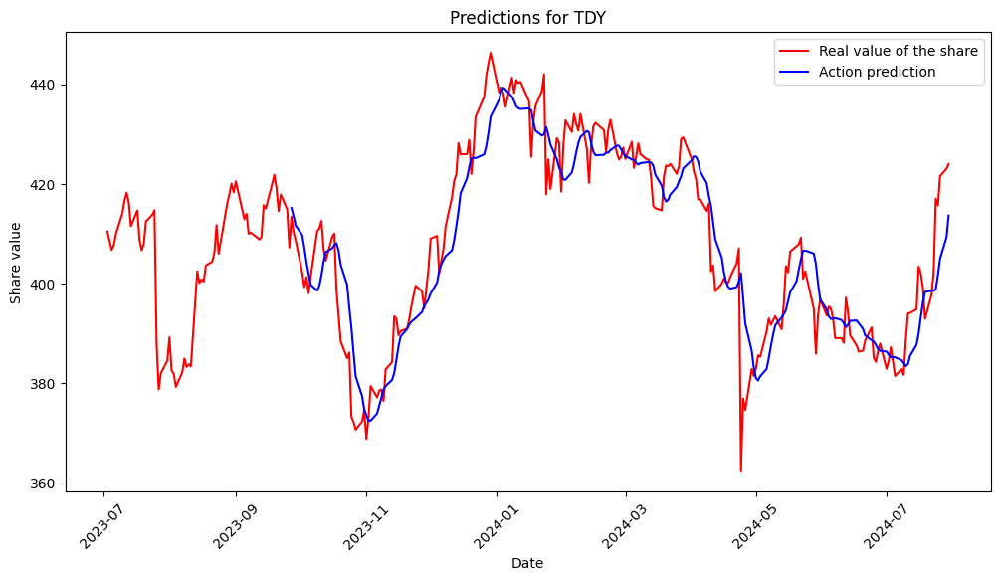

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for TDY: 56.44318154402133
Normalized Mean Squared Error (Normalized MSE) for TDY: 0.0003405328794939485
Mean Absolute Error (MAE) for TDY: 5.692994560067936
R^2 Score for TDY: 0.8505827924459588
Processing WDC...
Model loaded for WDC.


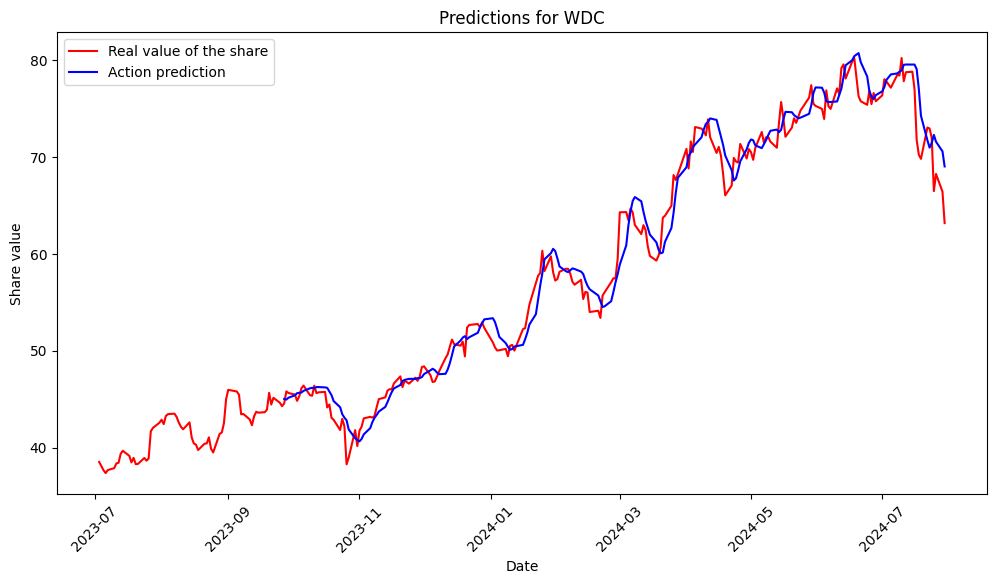

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))
<ipython-input-24-1d7ab4651428>:38: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` fo

Mean Squared Error (MSE) for WDC: 3.61587202111886
Normalized Mean Squared Error (Normalized MSE) for WDC: 0.0011408638916552587
Mean Absolute Error (MAE) for WDC: 1.4375779956505552
R^2 Score for WDC: 0.9756668022115289
Processing STX...
Model loaded for STX.


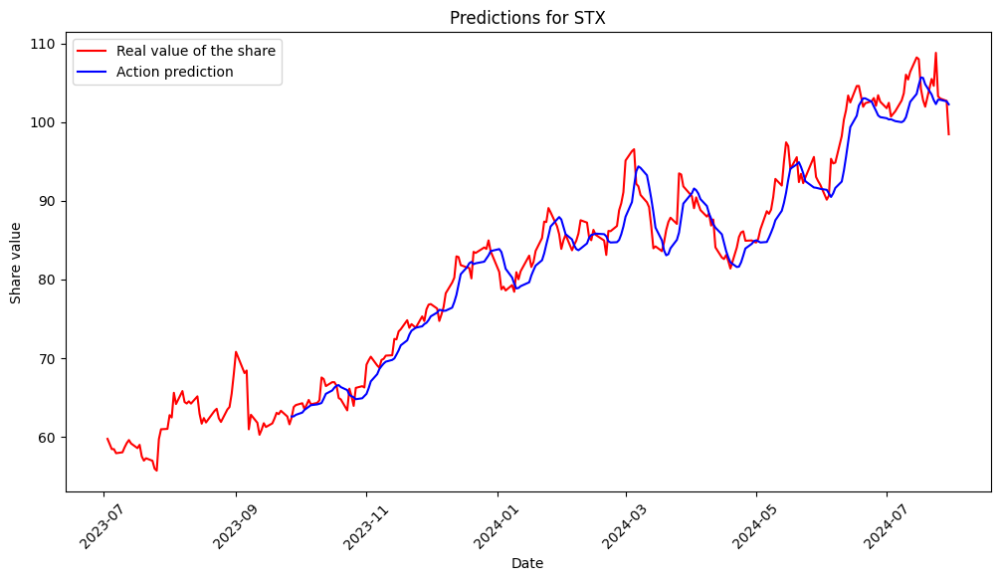

Mean Squared Error (MSE) for STX: 7.124763469271937
Normalized Mean Squared Error (Normalized MSE) for STX: 0.0011097091211939836
Mean Absolute Error (MAE) for STX: 2.110025666648286
R^2 Score for STX: 0.9479757765147799
   ticker         mse  mse_normalizado        mae        r2
0    AAPL   22.656653         0.000652   3.702436  0.917405
1    MSFT   88.460411         0.000610   7.873954  0.935775
2    NVDA  455.809036         0.091816  15.877179  0.454067
3    AVGO  200.431336         0.015419   9.488340  0.687747
4    ORCL   17.276154         0.001269   3.043556  0.882723
..    ...         ...              ...        ...       ...
59   JNPR    1.612910         0.001589   0.974906  0.916009
60    MSI   90.921796         0.000875   8.206071  0.920411
61    TDY   56.443182         0.000341   5.692995  0.850583
62    WDC    3.615872         0.001141   1.437578  0.975667
63    STX    7.124763         0.001110   2.110026  0.947976

[64 rows x 5 columns]
           AAPL        MSFT        N

<ipython-input-24-1d7ab4651428>:82: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  mse_normalizado = float(mse / (precio_promedio_validacion ** 2))


In [24]:
# Función para entrenar modelos y hacer predicciones para cada ticker
def train_and_predict(ticker):
    data = stock_data[ticker]

    # Sets de entrenamiento y validación
    set_entrenamiento = data[:'2023-06-30'].loc[:, ['Adj Close', 'MA_10', 'MA_30', 'MA_60']]
    set_validacion = data['2023-07-01':].loc[:, ['Adj Close', 'MA_10', 'MA_30', 'MA_60']]

    # Normalización del set de entrenamiento y validación
    sc = MinMaxScaler(feature_range=(0, 1))
    set_entrenamiento_escalado = sc.fit_transform(set_entrenamiento)
    set_validacion_escalado = sc.transform(set_validacion)

    # Calcular el precio promedio de la acción en el conjunto de validación
    precio_promedio_validacion = set_validacion['Adj Close'].mean()

    # Preparar datos para PyTorch
    time_step = 60
    X_train = []
    Y_train = []
    m = len(set_entrenamiento_escalado)

    for i in range(time_step, m):
        X_train.append(set_entrenamiento_escalado[i-time_step:i])
        Y_train.append(set_entrenamiento_escalado[i, 0])  # Usar solo la columna 'Adj Close'

    X_train, Y_train = np.array(X_train), np.array(Y_train)
    X_train = torch.tensor(X_train, dtype=torch.float32)
    Y_train = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1)

    train_dataset = TensorDataset(X_train, Y_train)
    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

    model_path = f'{ticker}_model.pth'
    if os.path.exists(model_path):
        # Cargar modelo existente con weights_only=True para evitar el warning
        model = LSTMModel()
        model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
        print(f"Model loaded for {ticker}.")
        final_loss = 'N/A'  # Asignar valor indicativo si el modelo fue cargado y no entrenado
    else:
        # Entrenamiento del modelo
        model = LSTMModel()
        loss_logger = LossLogger()
        trainer = pl.Trainer(max_epochs=20, logger=False, callbacks=[loss_logger])
        trainer.fit(model, train_loader)

        # Guardar el modelo
        torch.save(model.state_dict(), model_path)
        print(f"Model saved for {ticker}.")

        # Graficar la pérdida durante el entrenamiento
        # plot_loss(loss_logger, ticker)

        # Asignar el último valor de pérdida después del entrenamiento
        # final_loss = loss_logger.losses[-1][1] if hasattr(loss_logger, 'losses') and loss_logger.losses else None

    # Preparar datos de validación para la predicción
    X_test = []
    for i in range(time_step, len(set_validacion_escalado)):
        X_test.append(set_validacion_escalado[i-time_step:i])

    X_test = np.array(X_test)
    X_test = torch.tensor(X_test, dtype=torch.float32)

    # Predicción
    model.eval()
    with torch.no_grad():
        prediccion = model(X_test).numpy()

    prediccion = sc.inverse_transform(np.concatenate([prediccion, np.zeros((prediccion.shape[0], 3))], axis=1))[:, 0]

    # Graficar las predicciones
    graficar_predicciones(set_validacion.values[:, 0], prediccion, set_validacion.index, ticker)

    # Calcular métricas de evaluación
    mse = mean_squared_error(set_validacion.values[time_step:, 0], prediccion)
    mae = mean_absolute_error(set_validacion.values[time_step:, 0], prediccion)
    r2 = r2_score(set_validacion.values[time_step:, 0], prediccion)

    # Normalizar el MSE usando el precio promedio del conjunto de validación
    mse_normalizado = float(mse / (precio_promedio_validacion ** 2))

    print(f"Mean Squared Error (MSE) for {ticker}: {mse}")
    print(f"Normalized Mean Squared Error (Normalized MSE) for {ticker}: {mse_normalizado}")
    print(f"Mean Absolute Error (MAE) for {ticker}: {mae}")
    print(f"R^2 Score for {ticker}: {r2}")

    return {
        "ticker": ticker,
        "mse": mse,
        "mse_normalizado": mse_normalizado,
        "mae": mae,
        "r2": r2,
        #"final_loss": final_loss,
        "prediccion": prediccion  # Añadir las predicciones a los resultados
    }

# Almacenar resultados
resultados = []
predicciones = {}

# Hacer predicciones para cada ticker y almacenar métricas
for ticker in tickers:
    print(f"Processing {ticker}...")
    resultado = train_and_predict(ticker)
    resultados.append(resultado)
    predicciones[ticker] = resultado['prediccion']

# Crear DataFrame con resultados
resultados_df = pd.DataFrame(resultados)
#resultados_df = resultados_df[['ticker', 'mse', 'mse_normalizado', 'mae', 'r2', 'final_loss']]
resultados_df = resultados_df[['ticker', 'mse', 'mse_normalizado', 'mae', 'r2']]

# Mostrar la tabla de resultados
print(resultados_df)

# Guardar las predicciones futuras en un DataFrame
future_prices_df = pd.DataFrame(predicciones)
print(future_prices_df)



In [25]:
# Mostrar todo el DataFrame
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    print(resultados_df)



   ticker          mse  mse_normalizado        mae        r2
0    AAPL    22.656653         0.000652   3.702436  0.917405
1    MSFT    88.460411         0.000610   7.873954  0.935775
2    NVDA   455.809036         0.091816  15.877179  0.454067
3    AVGO   200.431336         0.015419   9.488340  0.687747
4    ORCL    17.276154         0.001269   3.043556  0.882723
5     AMD    68.403499         0.003396   6.616344  0.911065
6    CSCO     0.737173         0.000307   0.634252  0.798610
7     ACN    62.826172         0.000608   5.955771  0.917494
8    ADBE   256.212851         0.000876  11.472274  0.904484
9     TXN    21.650349         0.000773   3.730123  0.934549
10    IBM    13.506247         0.000538   2.765826  0.952769
11   QCOM    42.619967         0.001958   5.070498  0.958915
12   INTU   671.834647         0.001992  23.021594  0.729150
13   AMAT   154.265429         0.005031  10.552975  0.868667
14     MU    16.077173         0.001912   2.853172  0.971864
15   LRCX    11.902259  

# **MODELO 2. INCLUSION DE ANALISIS DE SENTIMIENTOS CON VADER**


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AAPL descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para MSFT descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para NVDA descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para AVGO descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CRM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ORCL descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AMD descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para CSCO descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ACN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ADBE descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed


Datos para TXN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para IBM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed


Datos para QCOM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para INTU descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AMAT descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para MU descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para LRCX descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para NOW descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para PANW descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para SNPS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CDNS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ANET descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para FTNT descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para KLAC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para APH descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para TEL descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para MCHP descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para NXPI descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ON descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para MPWR descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para ADI descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para KEYS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CDW descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ANSS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para PAYC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para GDDY descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para TYL descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para SSNC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para JKHY descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para EPAM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed


Datos para GLW descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para HPQ descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para DXC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para IT descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para LDOS descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para AKAM descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para NTAP descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed


Datos para VRSN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para FFIV descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para XRX descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para JNPR descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para CSGP descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para GRMN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para ZBRA descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para BR descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para VRSN descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para PTC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para CTSH descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para HPE descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para JNPR descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


Datos para MSI descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para TDY descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para WDC descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')
Datos para STX descargados. Columnas disponibles: Index(['Adj Close', 'Close', 'High', 'Low', 'Open', 'Volume'], dtype='object')


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AAPL...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AAPL:
MSE: 23.07626262391162
MSE Normalizado: 0.0006569003119699106
MAE: 3.827892105123363
R²: 0.9158750055368624


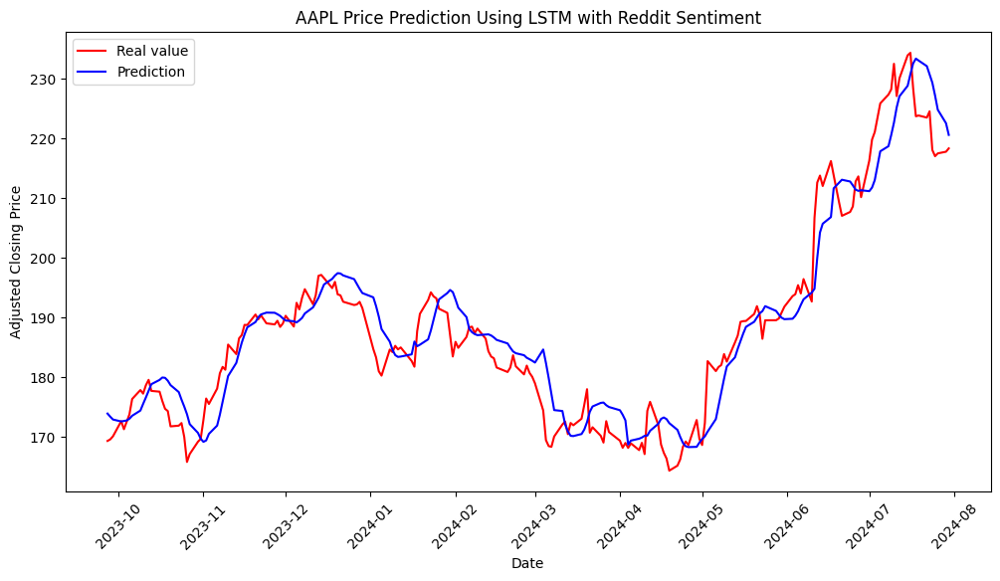

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MSFT...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MSFT:
MSE: 57.3711625317338
MSE Normalizado: 0.0003660943162113153
MAE: 6.074002430605009
R²: 0.9583469436312019


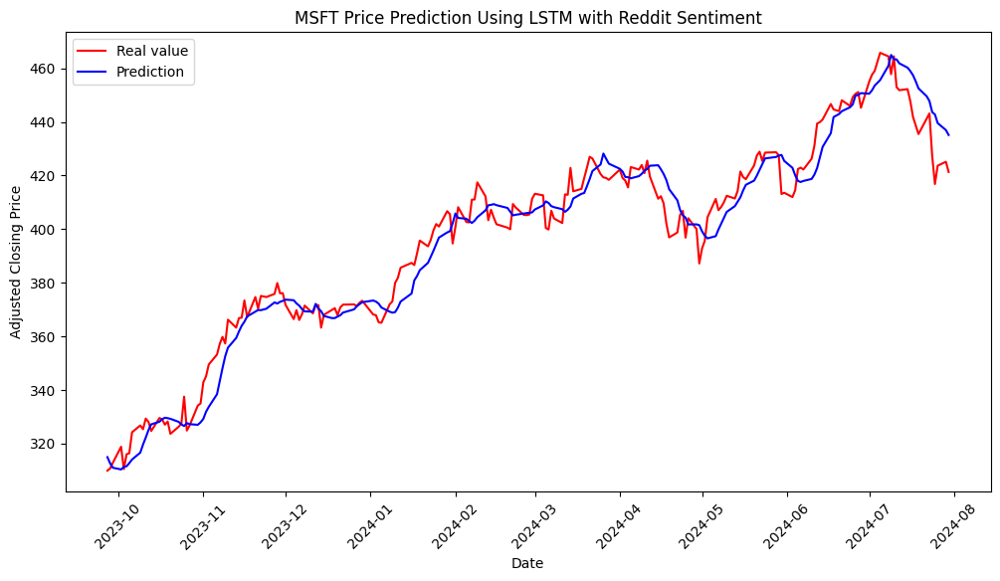

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando NVDA...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para NVDA:
MSE: 266.2575276415319
MSE Normalizado: 0.04406497016594387
MAE: 12.530501755518806
R²: 0.681097234078254


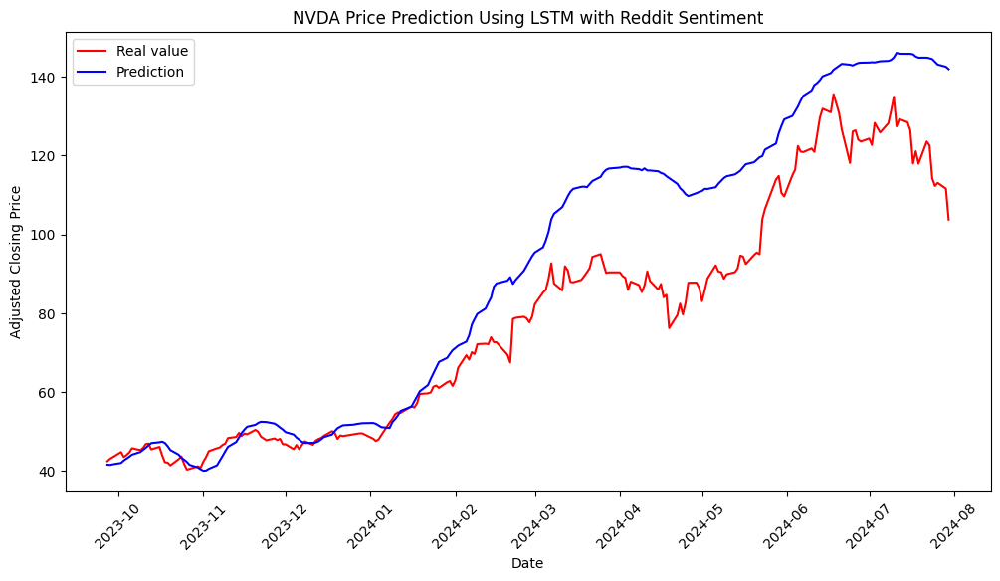

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AVGO...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AVGO:
MSE: 189.9173010579089
MSE Normalizado: 0.012713000940313838
MAE: 9.672816584625183
R²: 0.7041269247476254


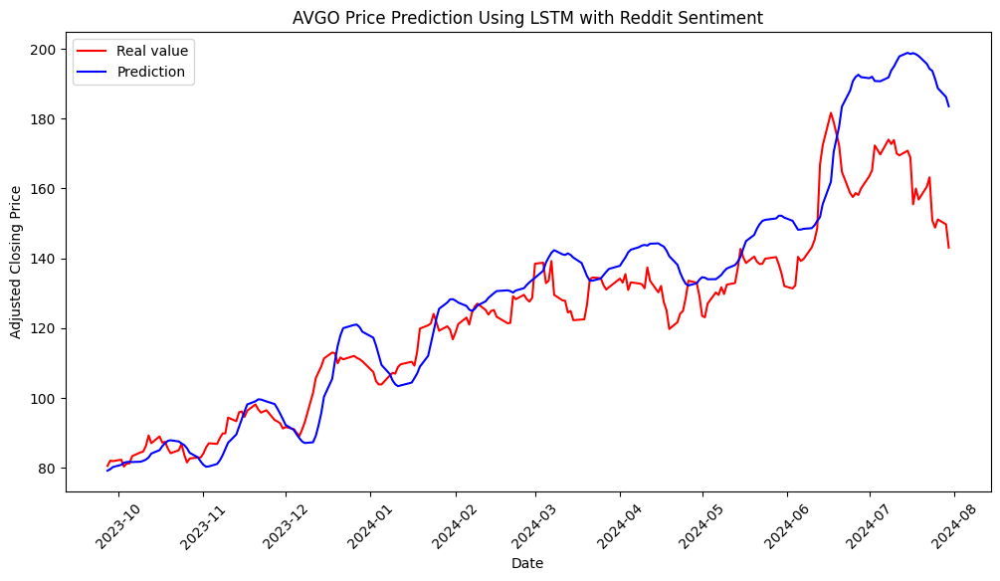

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CRM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CRM:
MSE: 67.23822693522479
MSE Normalizado: 0.0010086416305708156
MAE: 6.228965113610501
R²: 0.9357351292106284


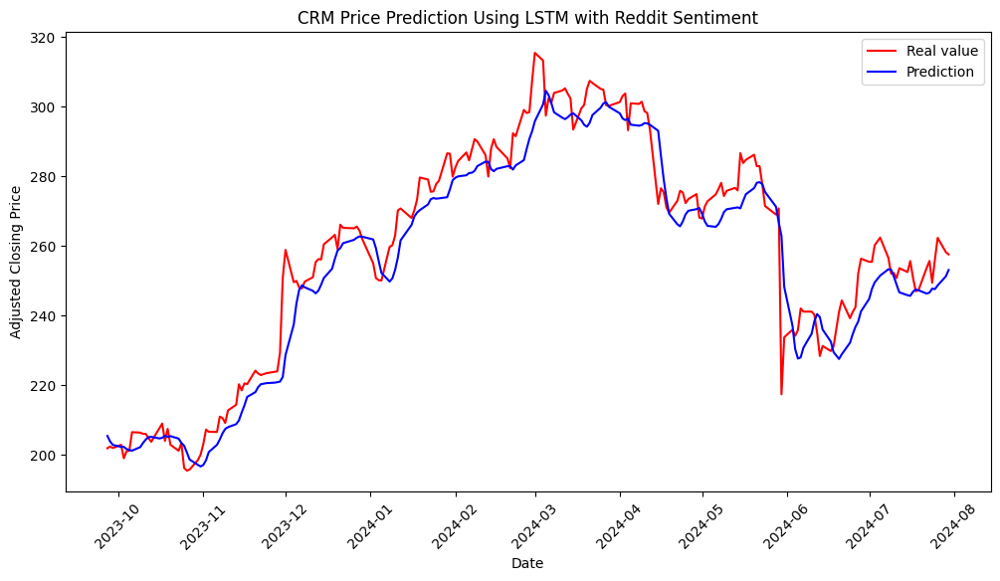

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ORCL...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ORCL:
MSE: 11.802729694314973
MSE Normalizado: 0.0008570757819943397
MAE: 2.439469058074921
R²: 0.9198784236479912


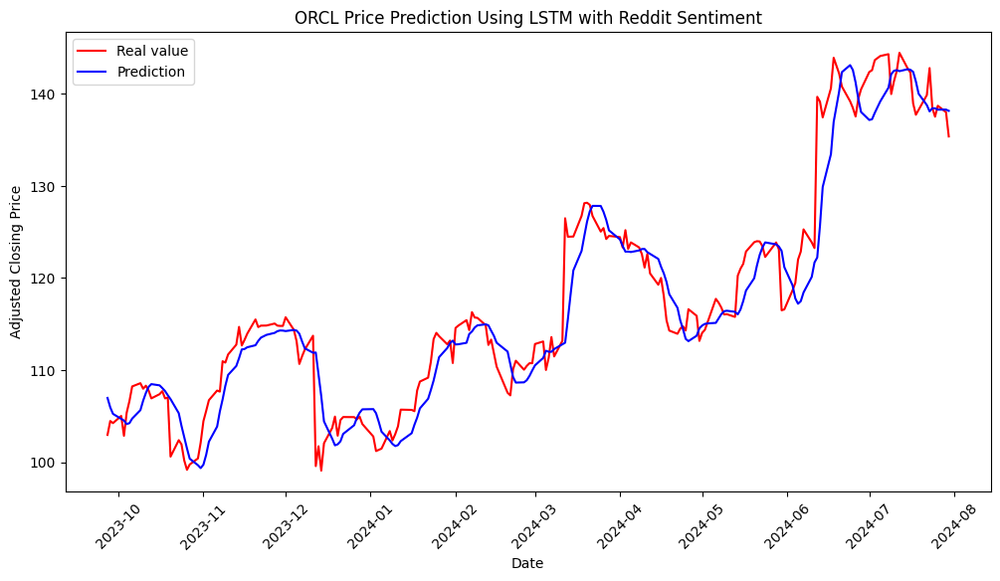

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AMD...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AMD:
MSE: 44.05136411489273
MSE Normalizado: 0.0019244363243919765
MAE: 5.084398425984456
R²: 0.942726295313987


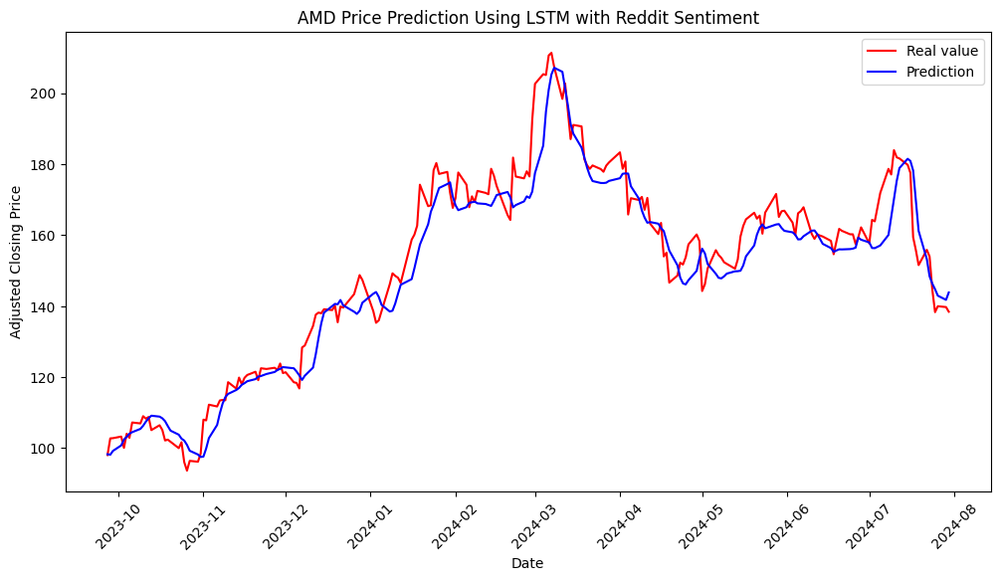

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CSCO...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CSCO:
MSE: 0.7132251453223304
MSE Normalizado: 0.0003072297069968
MAE: 0.6512892685162683
R²: 0.8051520333734853


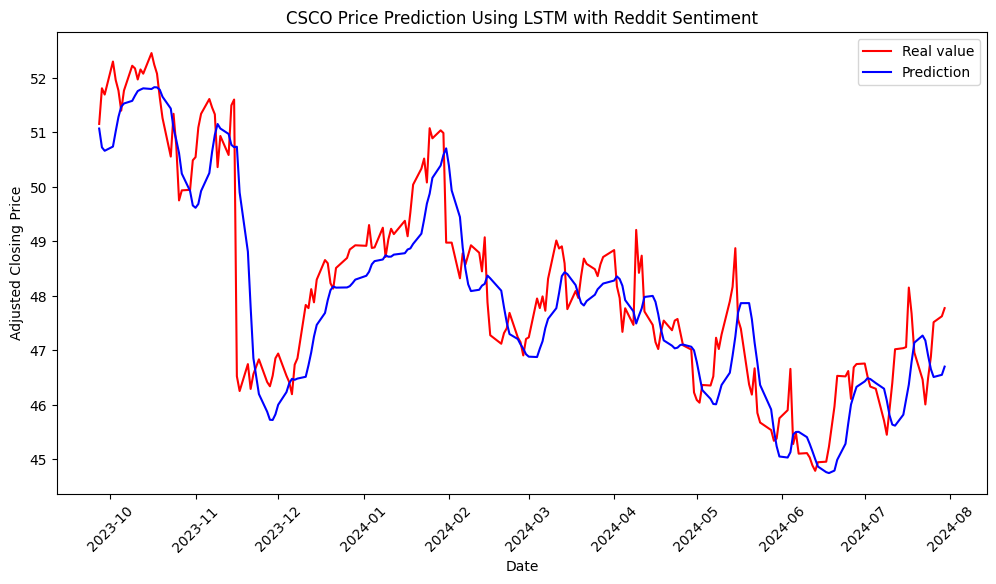

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ACN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ACN:
MSE: 88.06014419890737
MSE Normalizado: 0.0008338743378854986
MAE: 7.59945538532084
R²: 0.8843557508157082


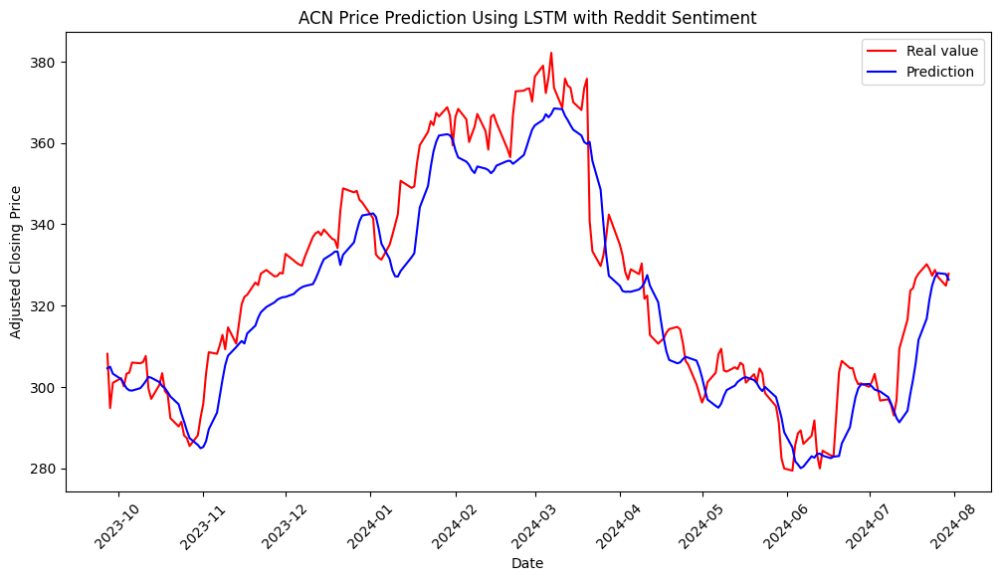

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ADBE...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ADBE:
MSE: 527.0850836599209
MSE Normalizado: 0.001774168015662025
MAE: 19.067077640453057
R²: 0.8035039585732993


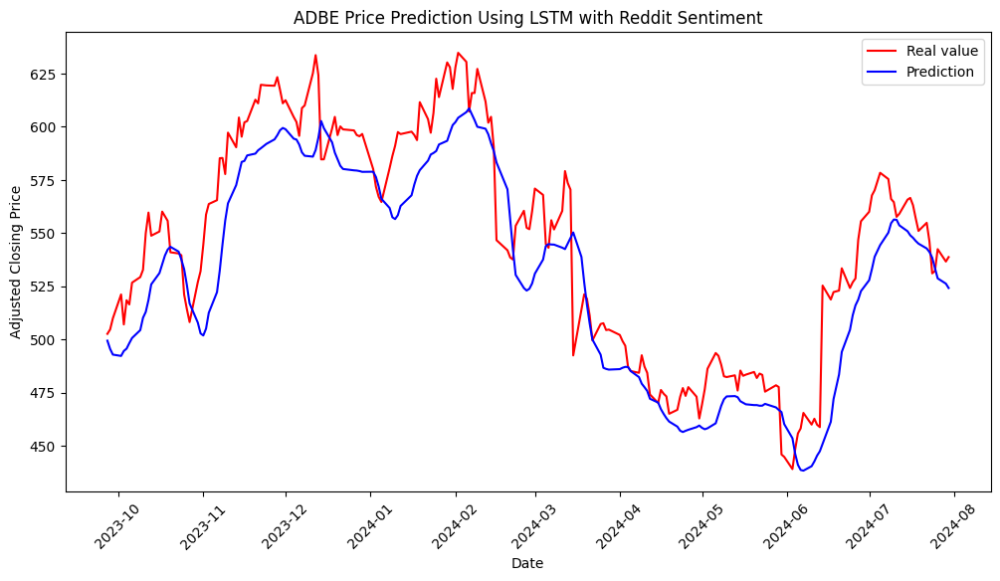

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando TXN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para TXN:
MSE: 17.693845835906878
MSE Normalizado: 0.0006254460385731322
MAE: 3.2787570126372287
R²: 0.9465100930126258


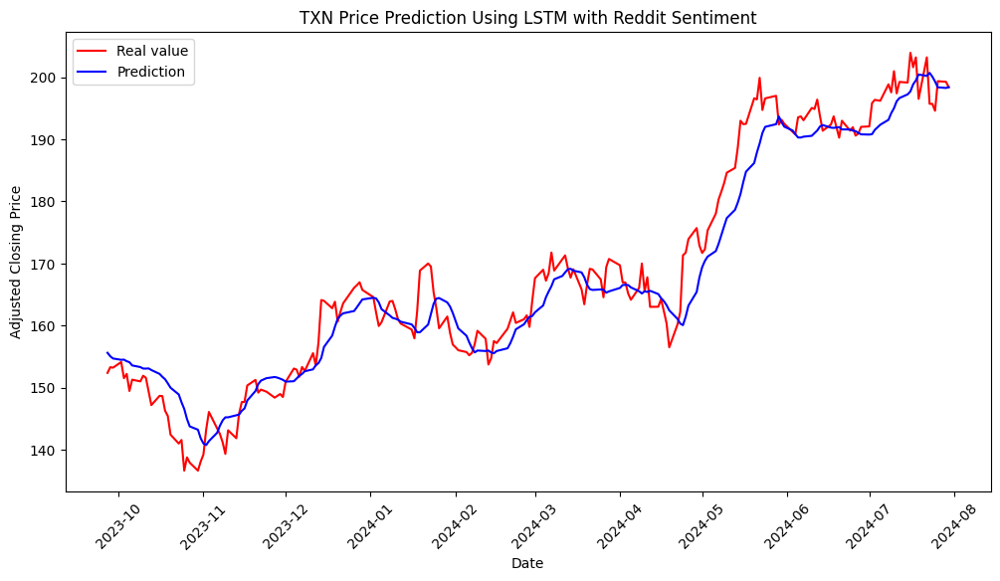

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando IBM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para IBM:
MSE: 13.232251190393175
MSE Normalizado: 0.00048521674163513195
MAE: 2.7124346011737823
R²: 0.9537266828078407


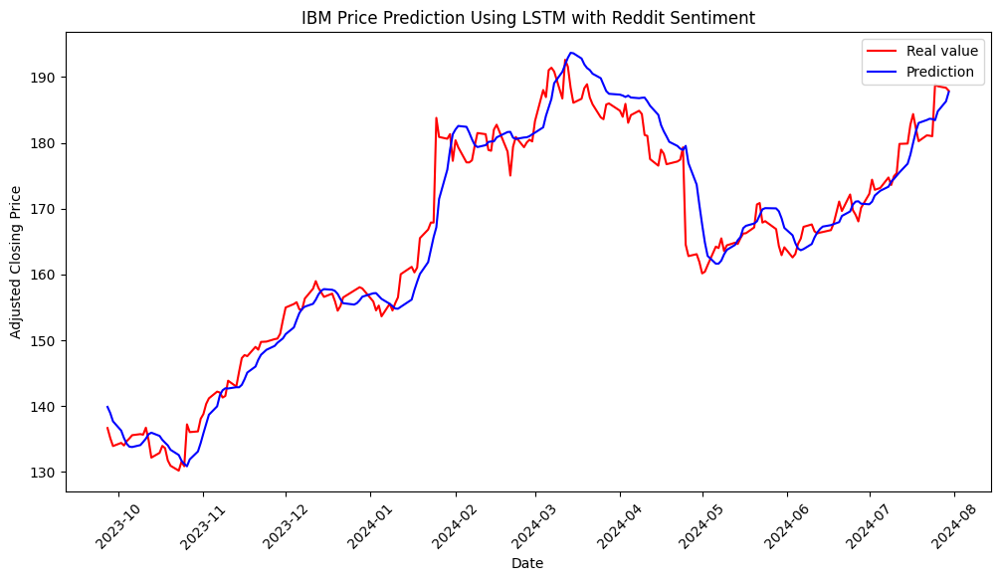

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando QCOM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para QCOM:
MSE: 40.90068588472694
MSE Normalizado: 0.001654155497587429
MAE: 5.062520889887846
R²: 0.960572773392605


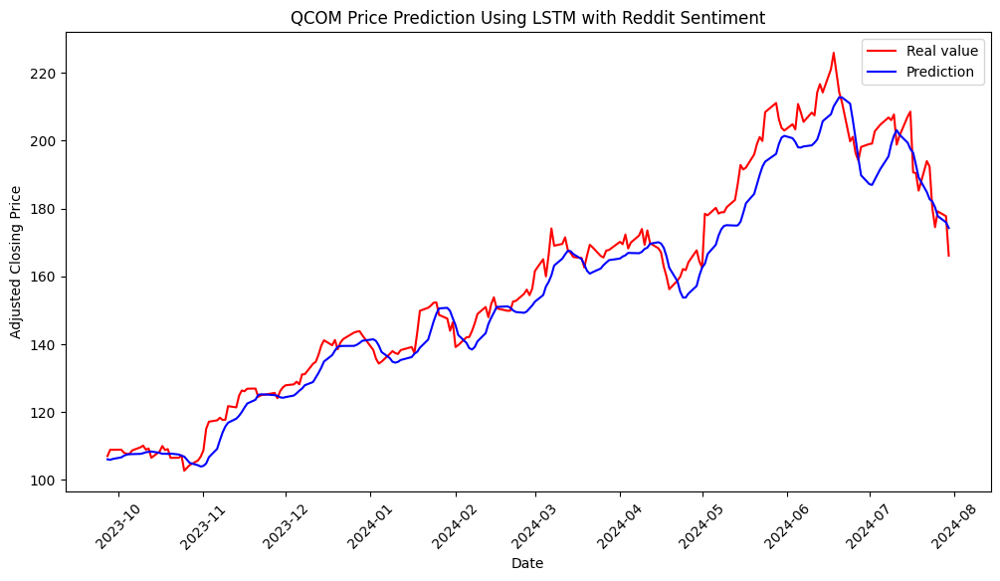

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando INTU...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para INTU:
MSE: 388.2975418893662
MSE Normalizado: 0.0010669960711676037
MAE: 16.357558807062986
R²: 0.8434581623970339


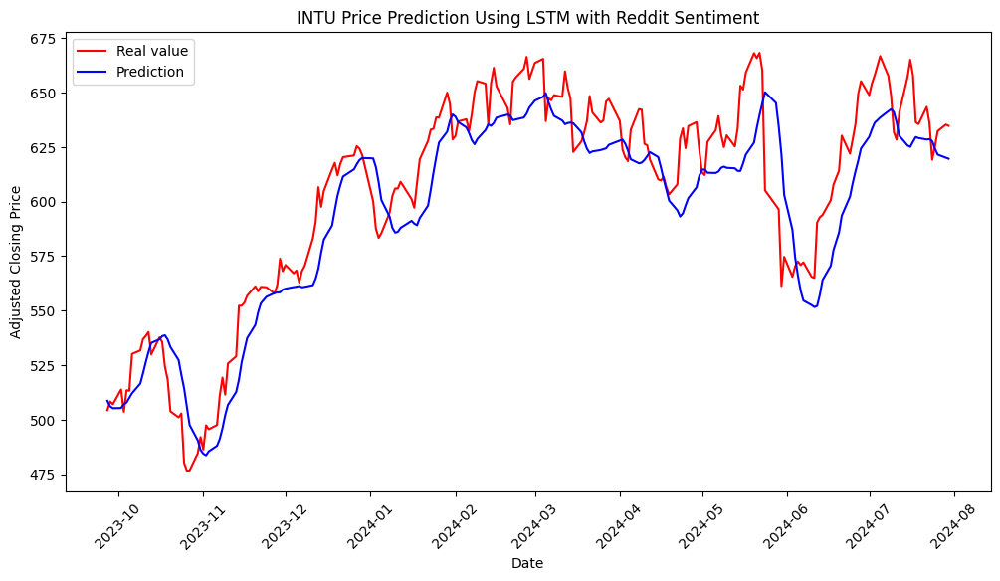

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AMAT...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AMAT:
MSE: 198.17846300408334
MSE Normalizado: 0.005821997666654601
MAE: 11.793928093937328
R²: 0.831281344594708


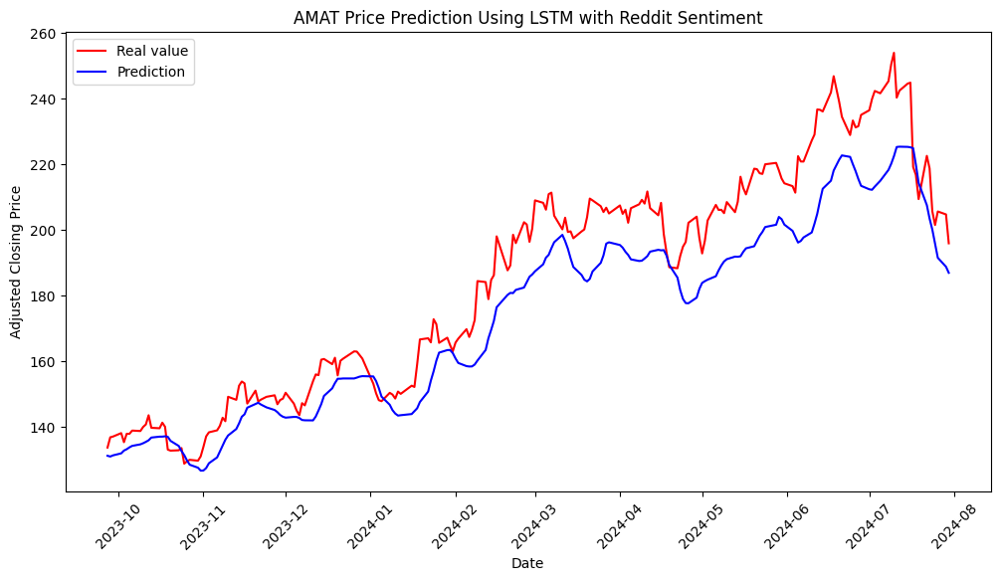

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MU...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MU:
MSE: 28.258245073468302
MSE Normalizado: 0.0028923827029350884
MAE: 3.9131257065327056
R²: 0.9505470708377985


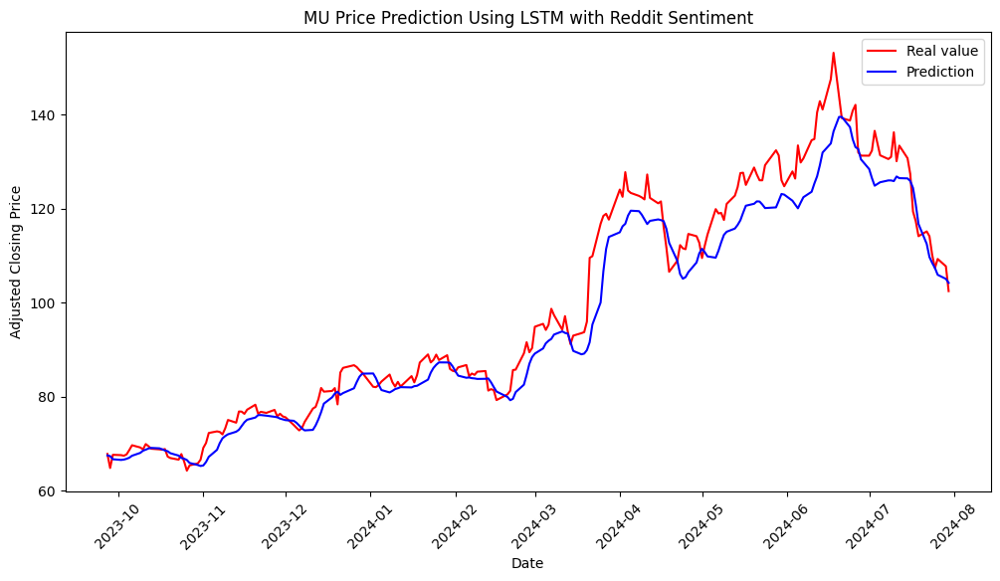

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando LRCX...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para LRCX:
MSE: 57.04408715273308
MSE Normalizado: 0.00793391715598789
MAE: 5.845248322884816
R²: 0.7187404728266071


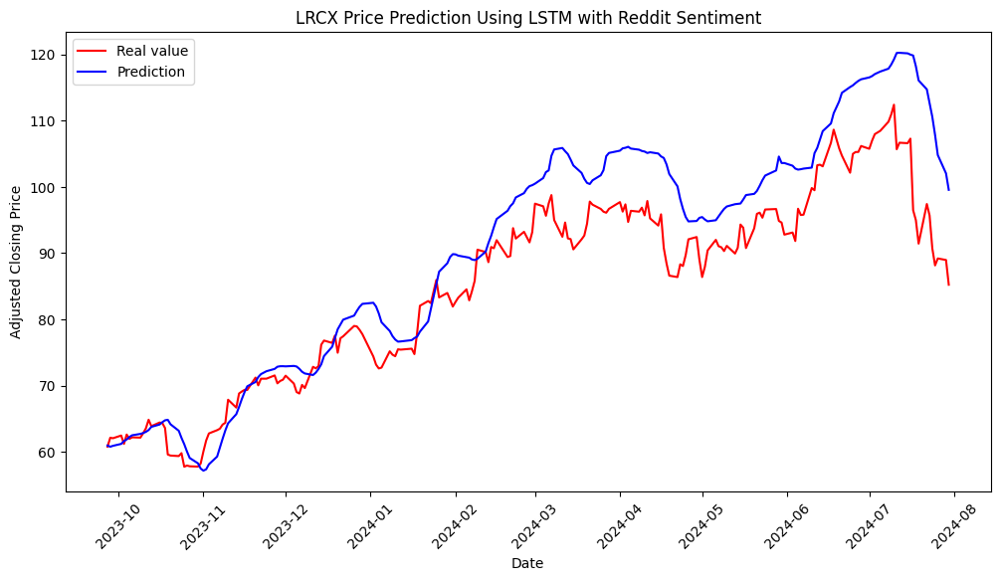

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando NOW...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para NOW:
MSE: 486.34862285740405
MSE Normalizado: 0.0009624392855939284
MAE: 16.79372646421042
R²: 0.9075644032872917


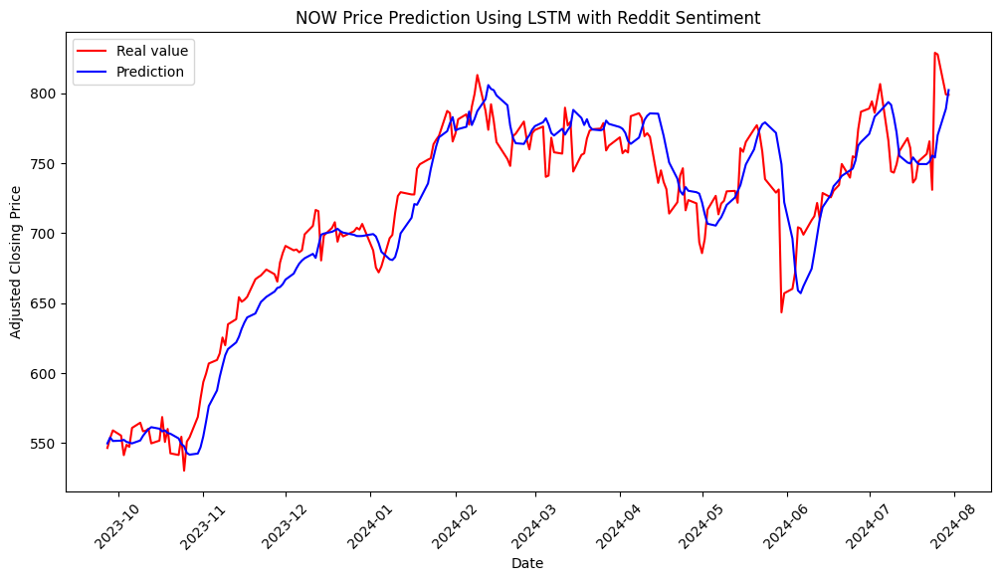

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando PANW...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para PANW:
MSE: 784.200518511604
MSE Normalizado: 0.00890128837112903
MAE: 21.8027705201961
R²: 0.3098670775235266


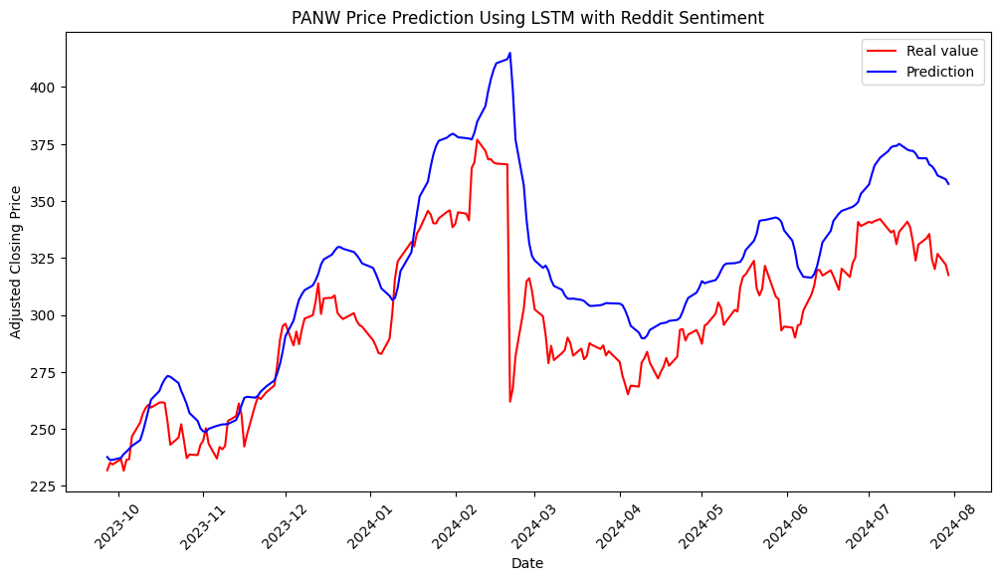

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando SNPS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para SNPS:
MSE: 322.2795343554395
MSE Normalizado: 0.0010831519839139263
MAE: 14.771226879406598
R²: 0.8083654526071061


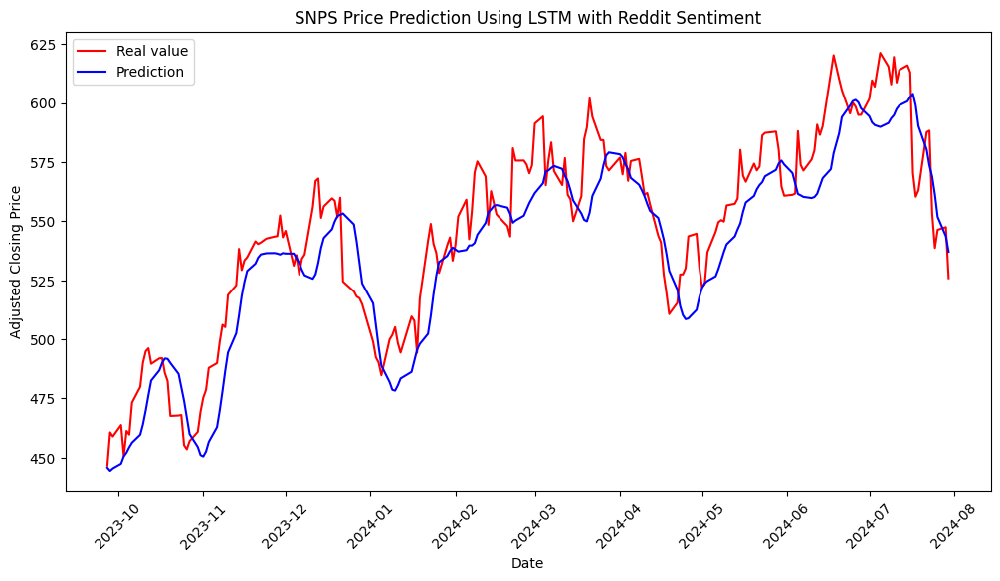

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CDNS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CDNS:
MSE: 87.11149637932449
MSE Normalizado: 0.0010840537402248254
MAE: 7.461465216190007
R²: 0.855096802600716


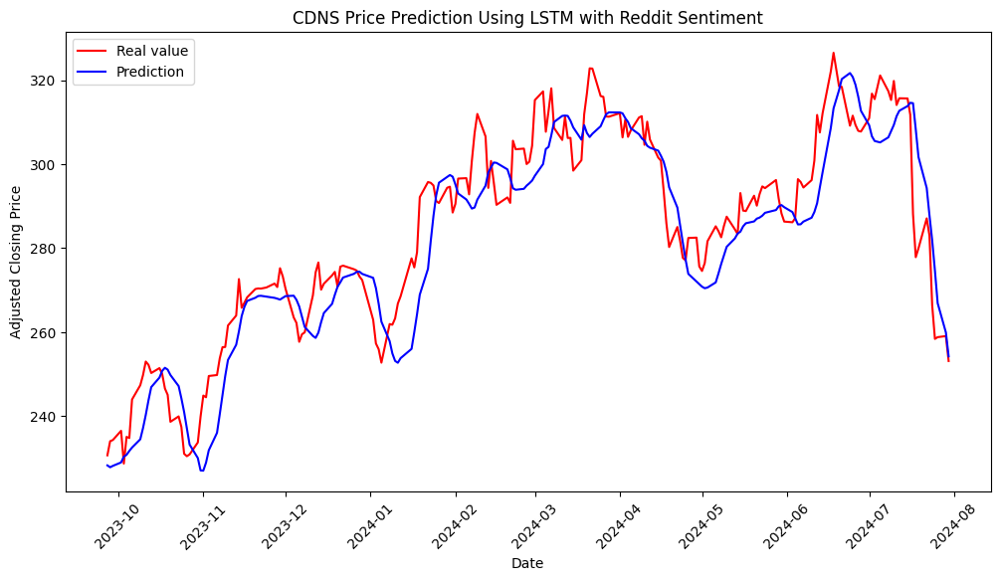

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ANET...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ANET:
MSE: 275.3107207138908
MSE Normalizado: 0.0038744425472955722
MAE: 13.016503312615633
R²: 0.8860564601710936


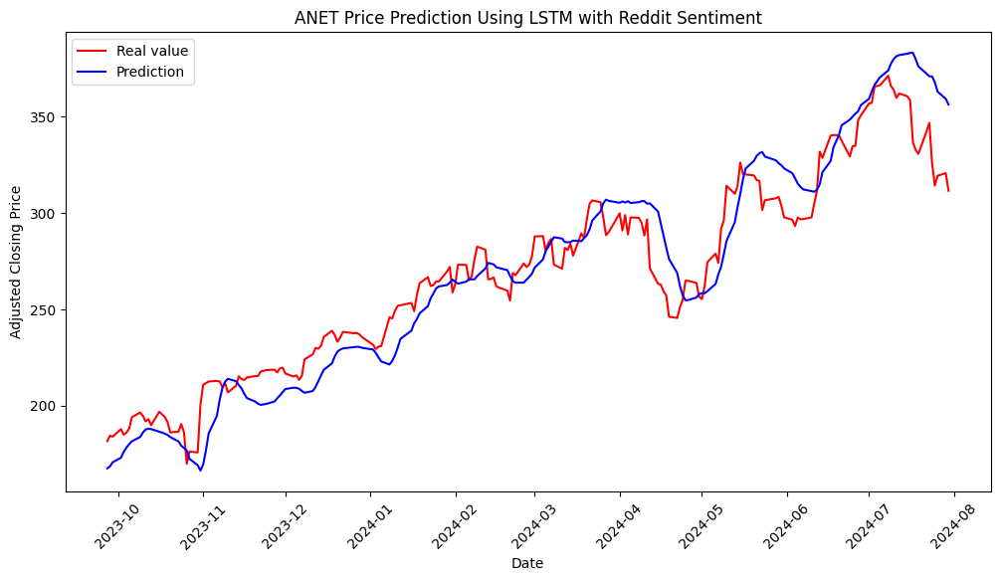

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando FTNT...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para FTNT:
MSE: 5.816440611490979
MSE Normalizado: 0.0015624082500751704
MAE: 1.8573106985080126
R²: 0.812638070576668


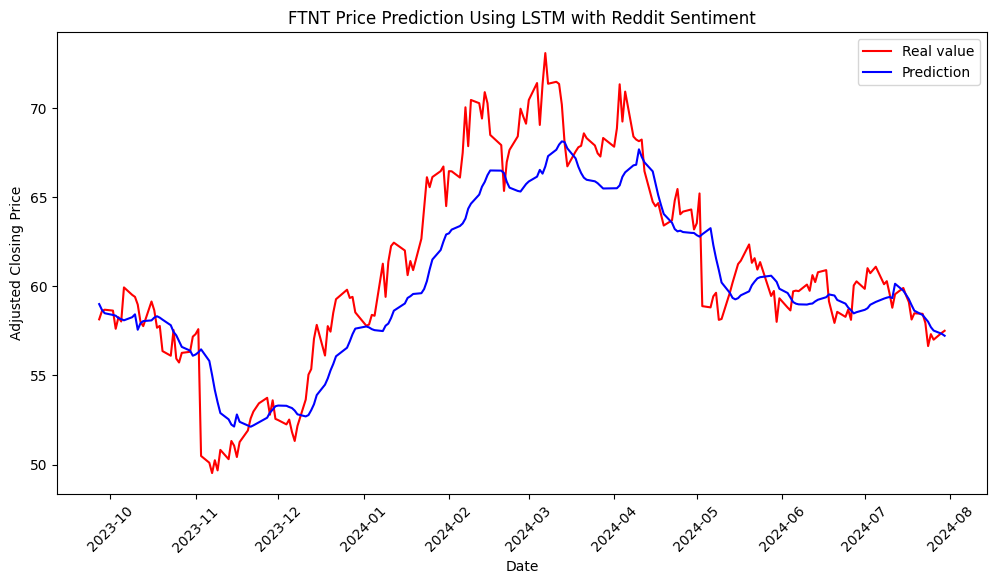

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando KLAC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para KLAC:
MSE: 1604.6306398519898
MSE Normalizado: 0.0038553208906724045
MAE: 29.116018024765207
R²: 0.8822773944664875


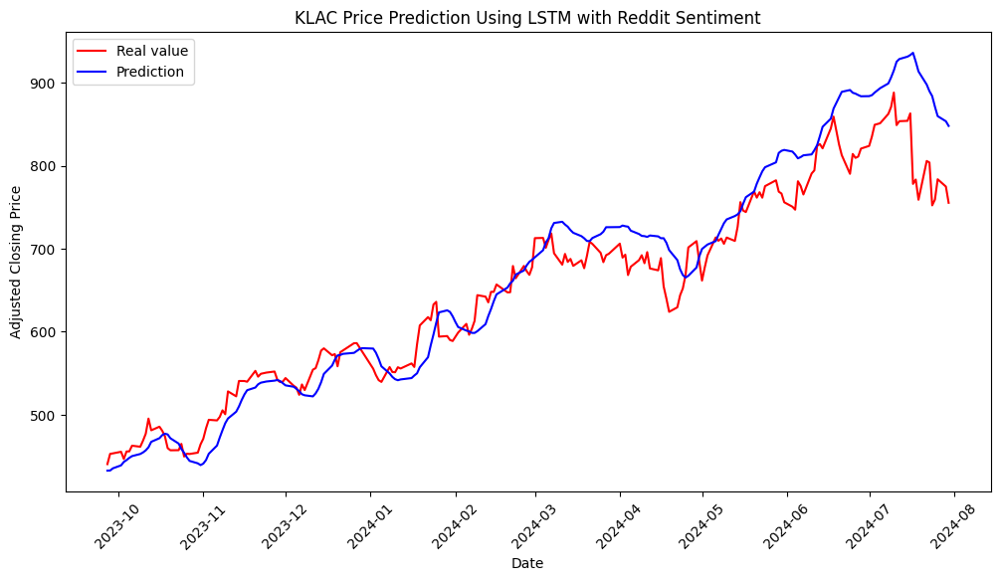

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando APH...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para APH:
MSE: 16.872320628065797
MSE Normalizado: 0.005765211012521165
MAE: 3.40412146089336
R²: 0.8031365659731133


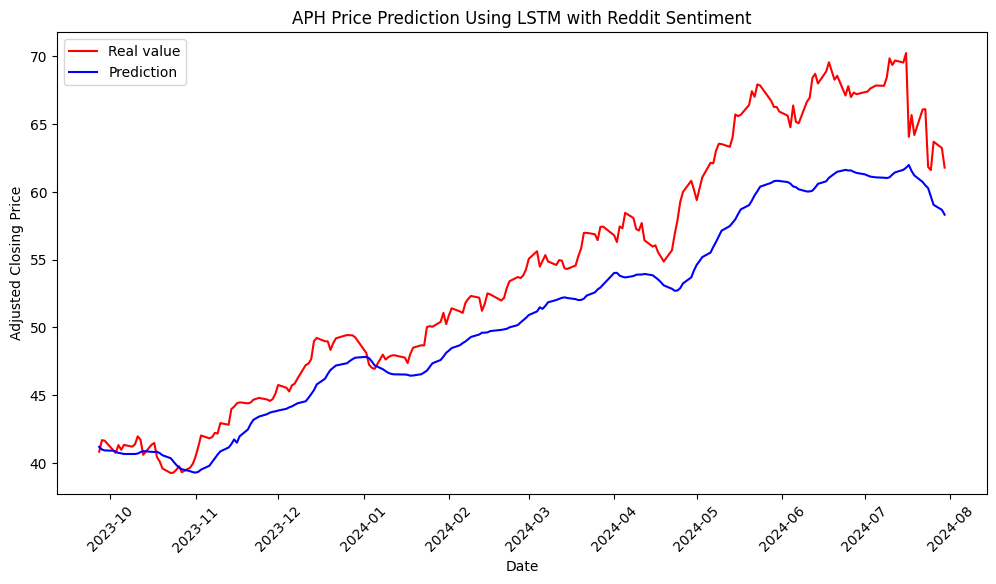

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando TEL...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para TEL:
MSE: 10.068498964524894
MSE Normalizado: 0.0005262731516265766
MAE: 2.390915825847364
R²: 0.9097176156602284


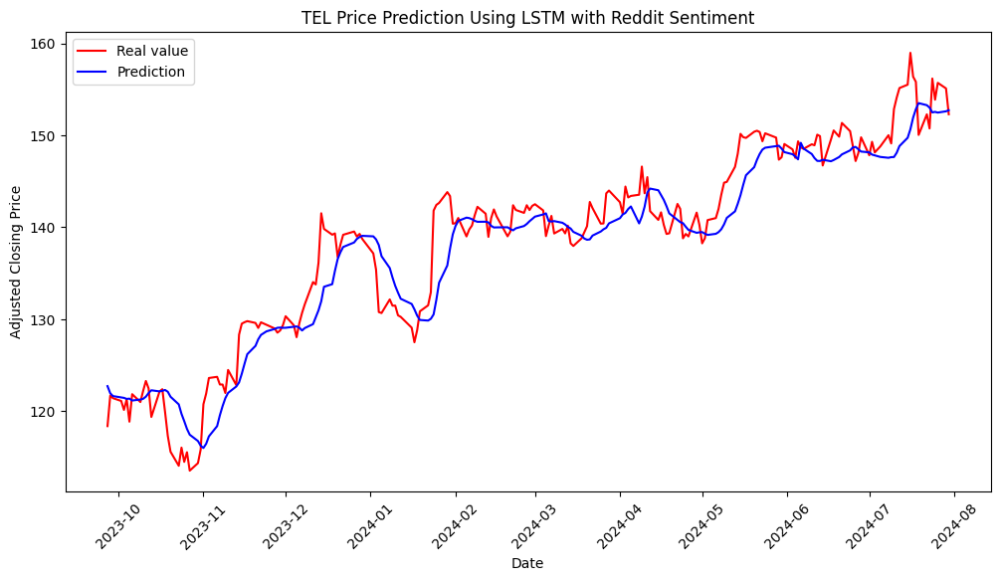

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MCHP...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MCHP:
MSE: 9.26064016644709
MSE Normalizado: 0.0012799940493904965
MAE: 2.4088063246044453
R²: 0.7711431635929233


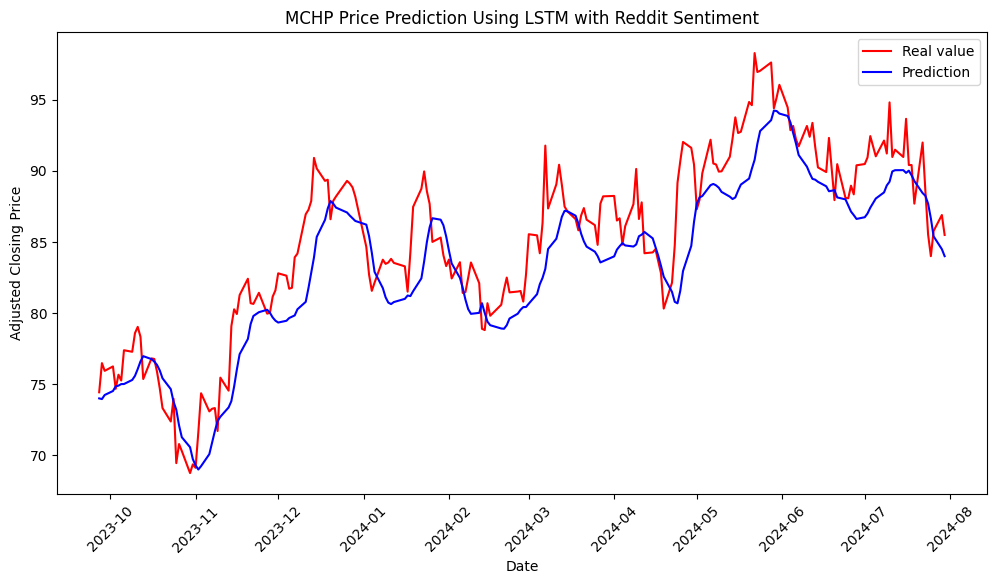

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando NXPI...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para NXPI:
MSE: 51.31508488285632
MSE Normalizado: 0.0009602708790351432
MAE: 5.757495625299012
R²: 0.9453946387326331


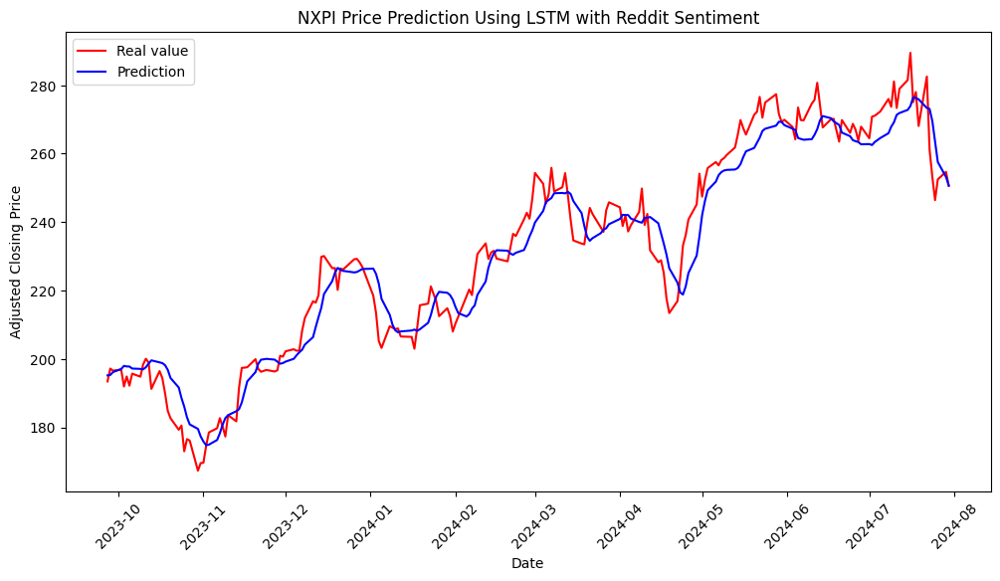

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ON...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ON:
MSE: 17.031966811194913
MSE Normalizado: 0.003010003152823172
MAE: 3.038677498880575
R²: 0.6599753166521162


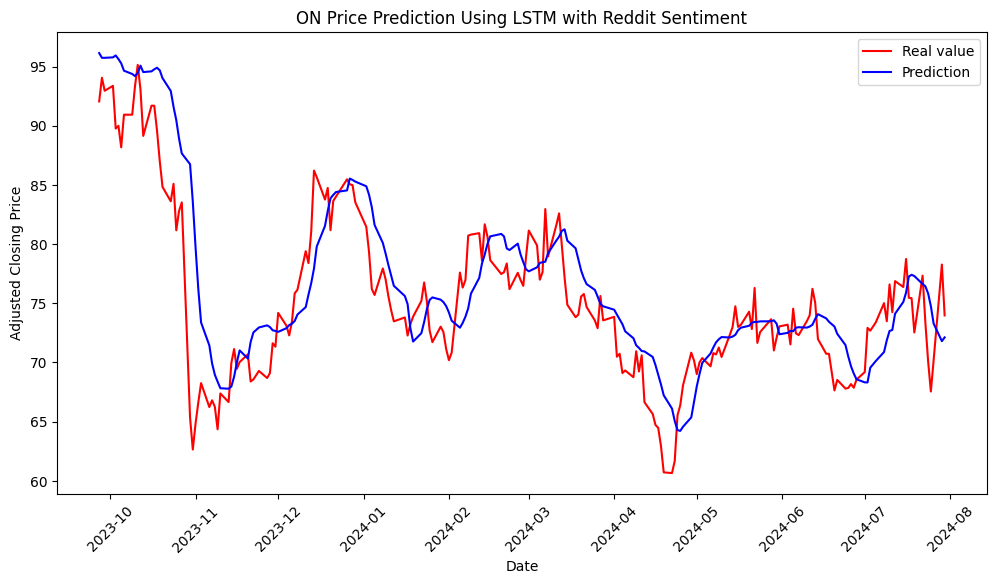

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MPWR...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MPWR:
MSE: 1936.8897738203118
MSE Normalizado: 0.004566880504539246
MAE: 36.595944898834354
R²: 0.8642022966516858


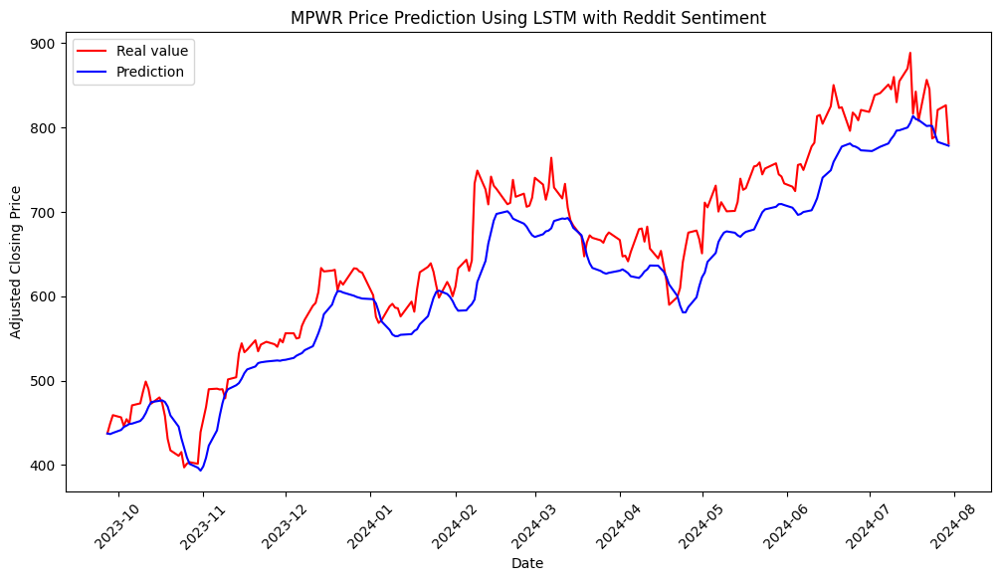

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ADI...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ADI:
MSE: 58.190567594545605
MSE Normalizado: 0.0015119053026039367
MAE: 5.681510232393423
R²: 0.8802952711684341


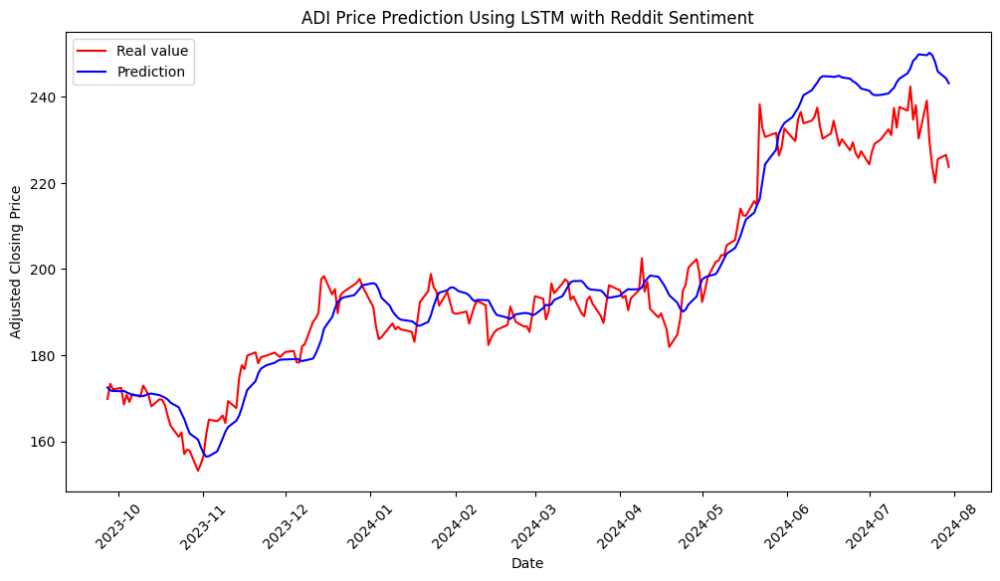

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando KEYS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para KEYS:
MSE: 14.474009881664493
MSE Normalizado: 0.0006946004191879234
MAE: 2.9624206104964026
R²: 0.8848291501007977


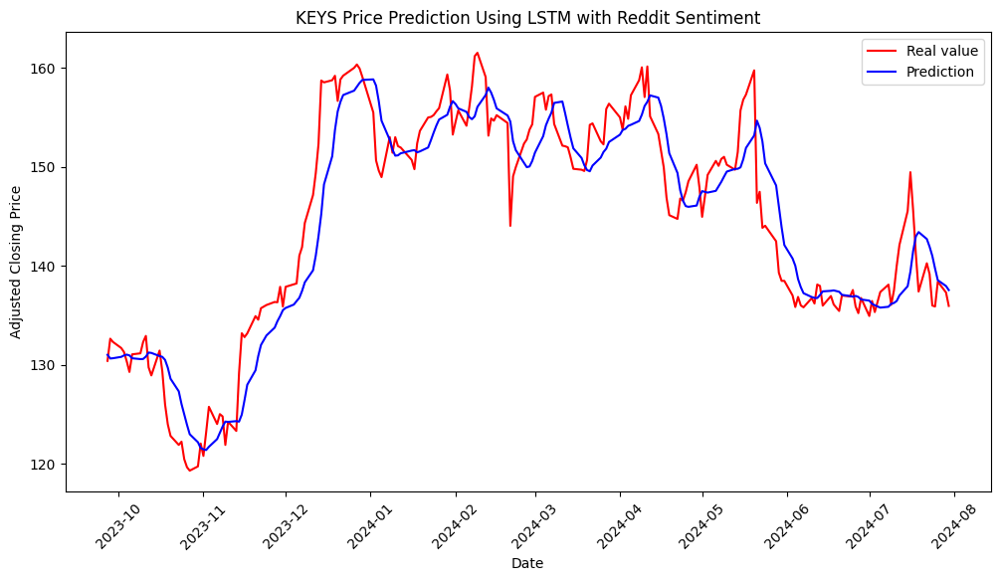

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CDW...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CDW:
MSE: 126.86909635303655
MSE Normalizado: 0.0025199483813700347
MAE: 9.902660139388964
R²: 0.4452450614101563


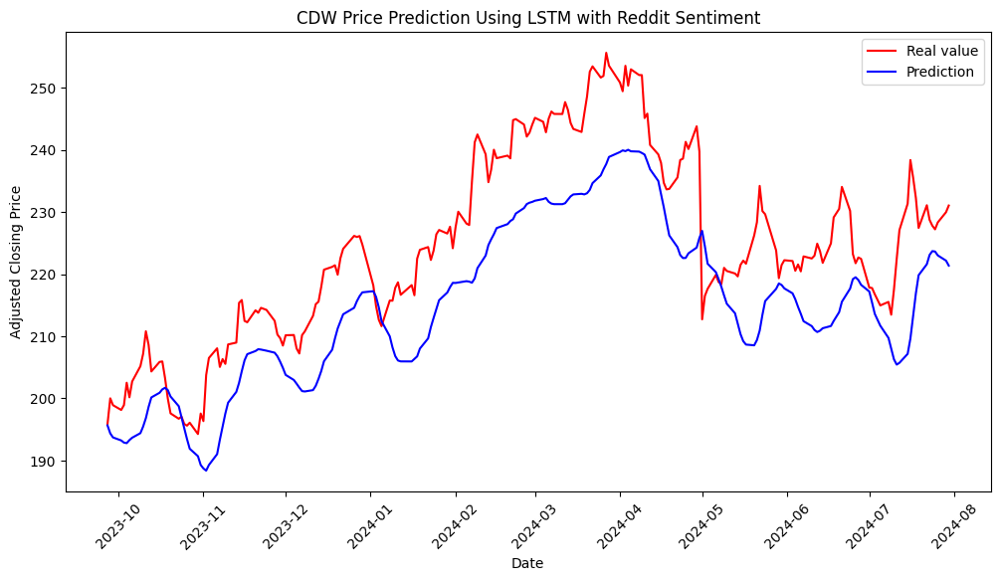

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ANSS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ANSS:
MSE: 74.82270727743035
MSE Normalizado: 0.000729321082995347
MAE: 5.563690971725177
R²: 0.8390779256409995


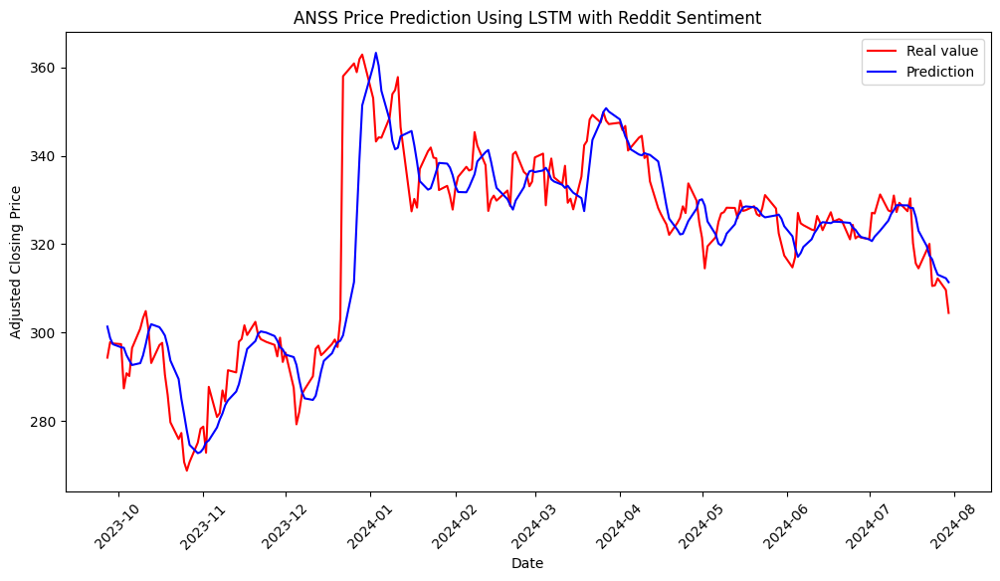

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando PAYC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para PAYC:
MSE: 385.84902549852336
MSE Normalizado: 0.011017936265186011
MAE: 16.33294436615888
R²: 0.6221374029191433


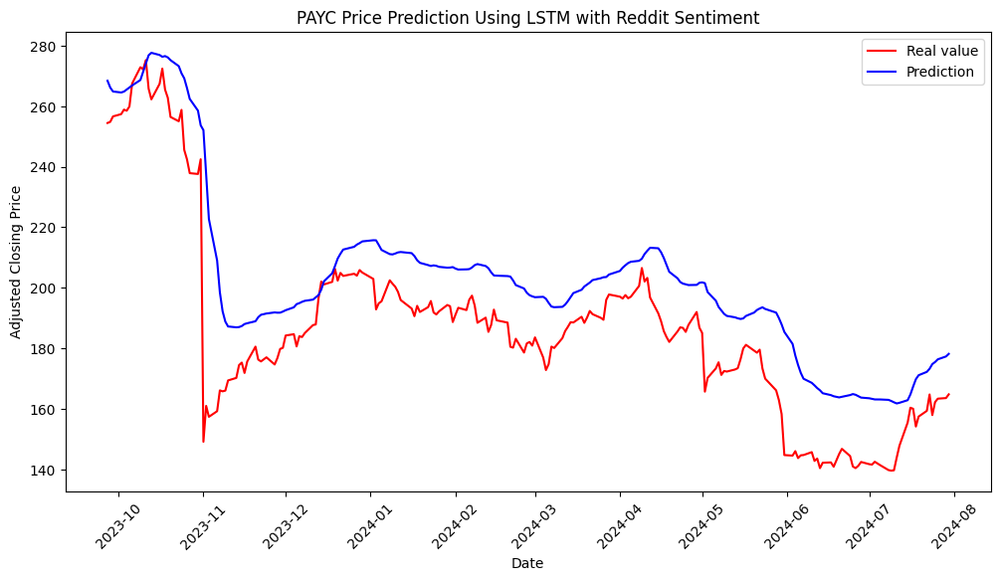

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando GDDY...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para GDDY:
MSE: 15.187121518429615
MSE Normalizado: 0.001175341823418928
MAE: 3.2424539528976717
R²: 0.9677247860982529


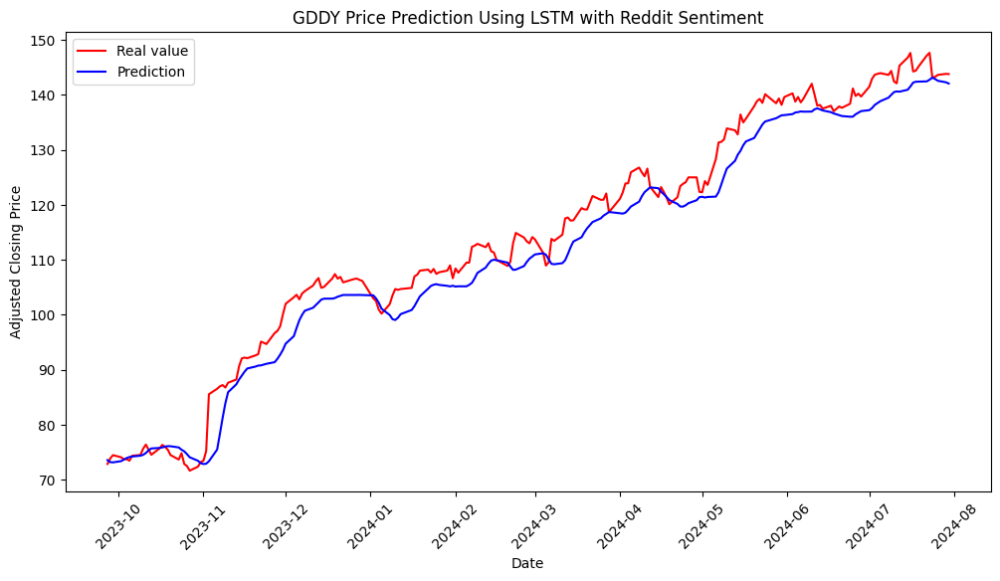

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando TYL...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para TYL:
MSE: 130.51378103881933
MSE Normalizado: 0.0006785714954148022
MAE: 7.591742664720672
R²: 0.9341343081153332


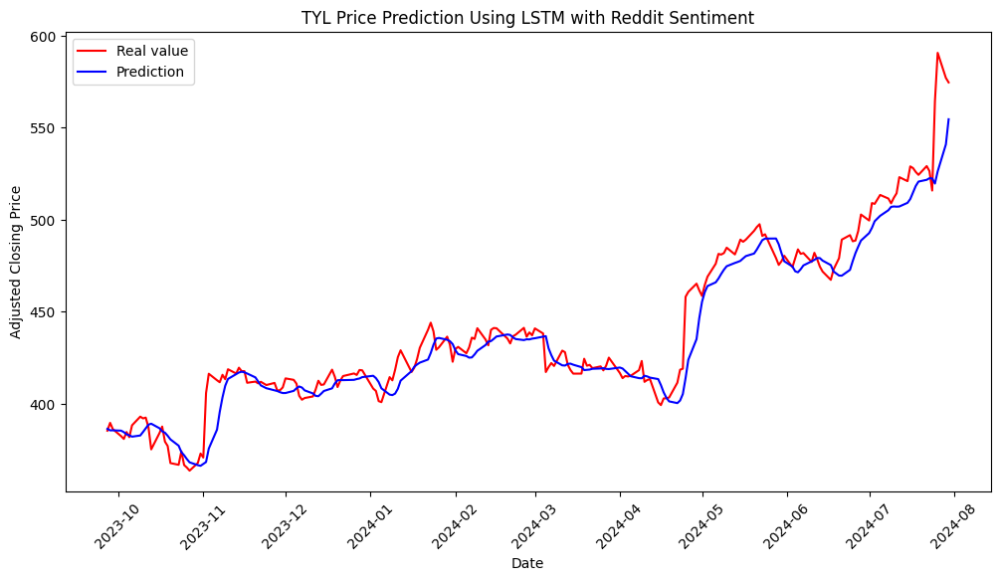

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando SSNC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para SSNC:
MSE: 2.246443589836734
MSE Normalizado: 0.0006327922486224388
MAE: 1.1371708256065192
R²: 0.9052107805383849


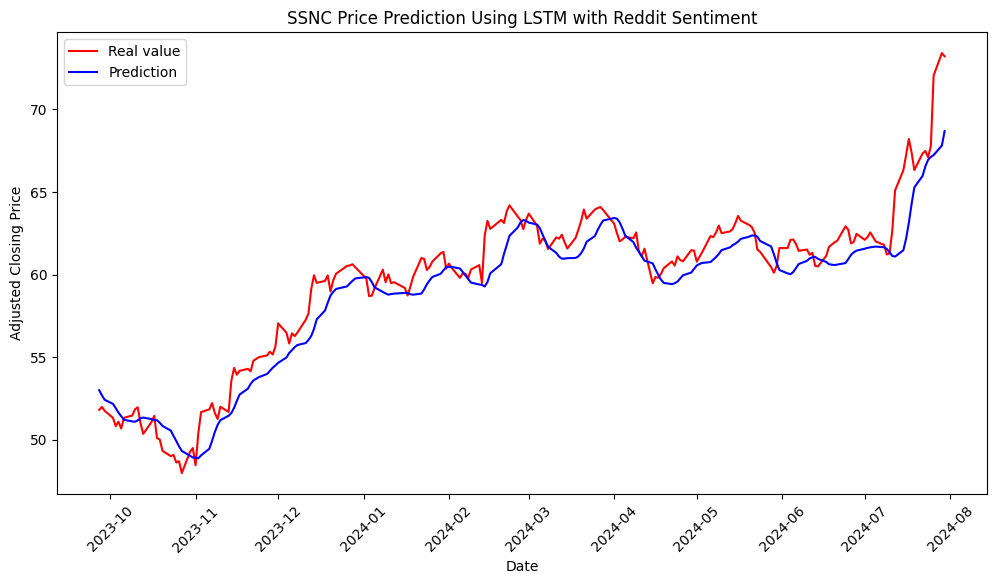

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando JKHY...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para JKHY:
MSE: 8.087797676988751
MSE Normalizado: 0.0003085012655440407
MAE: 2.2329983273784286
R²: 0.9047421890133361


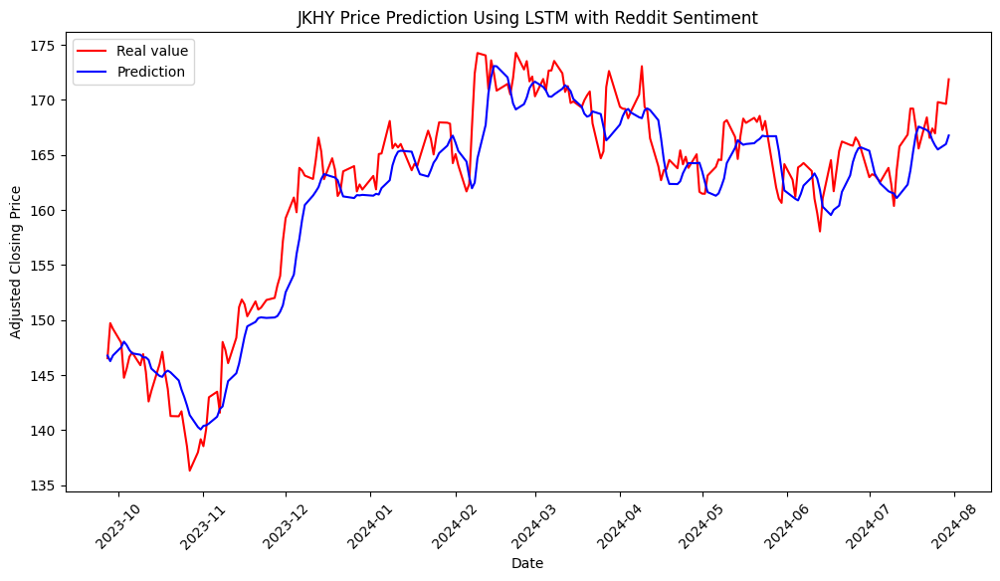

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando EPAM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para EPAM:
MSE: 169.78402745612433
MSE Normalizado: 0.0027600953823451995
MAE: 9.729738678483926
R²: 0.9087138212036762


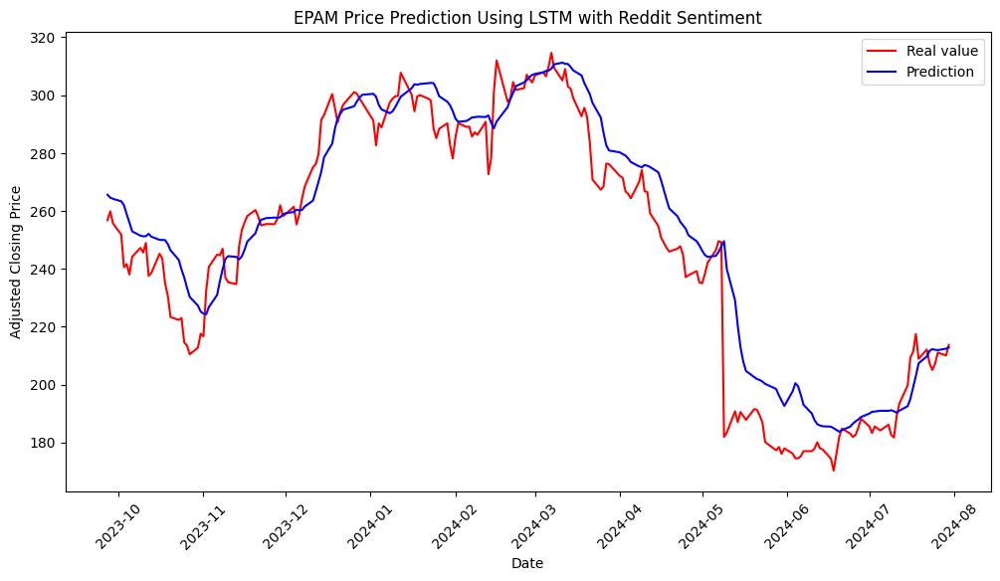

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando GLW...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para GLW:
MSE: 1.4493681886654823
MSE Normalizado: 0.001404779402960101
MAE: 0.7773069683708752
R²: 0.9359496064026398


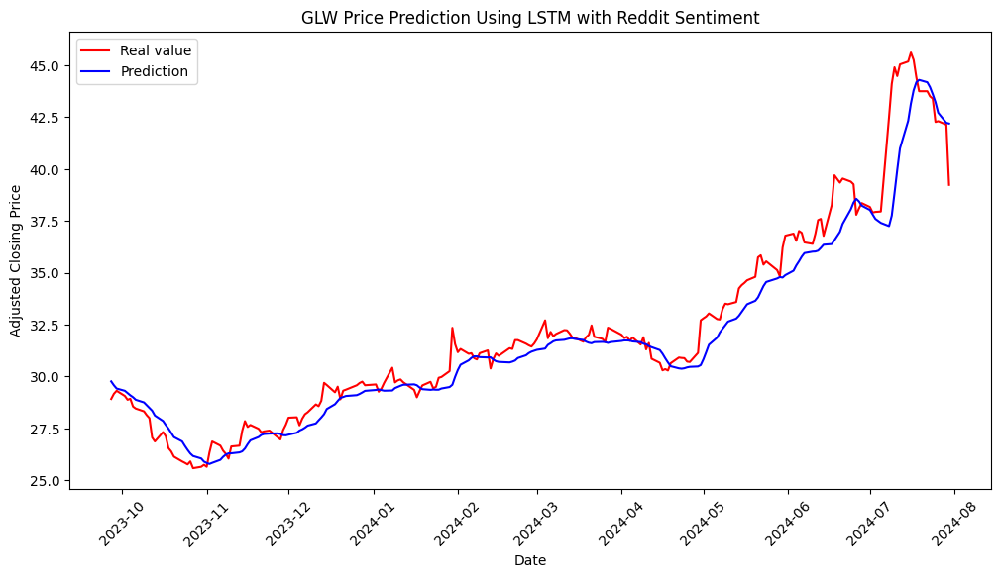

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando HPQ...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para HPQ:
MSE: 0.5975193029319562
MSE Normalizado: 0.0006773419712240198
MAE: 0.5515930637894447
R²: 0.9502299252143064


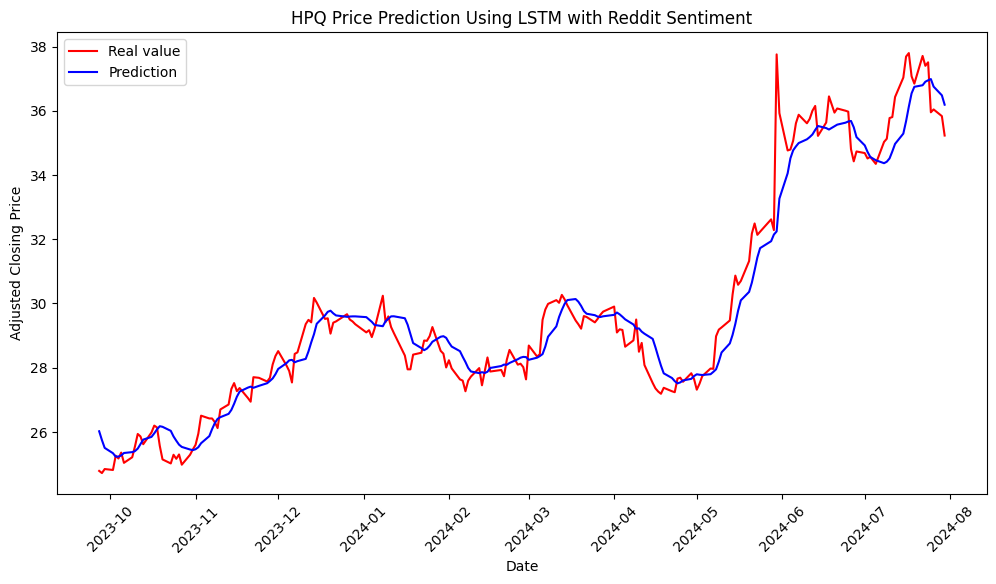

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando DXC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para DXC:
MSE: 0.690849531523288
MSE Normalizado: 0.0016014465771353242
MAE: 0.5847574030823253
R²: 0.8417225431022493


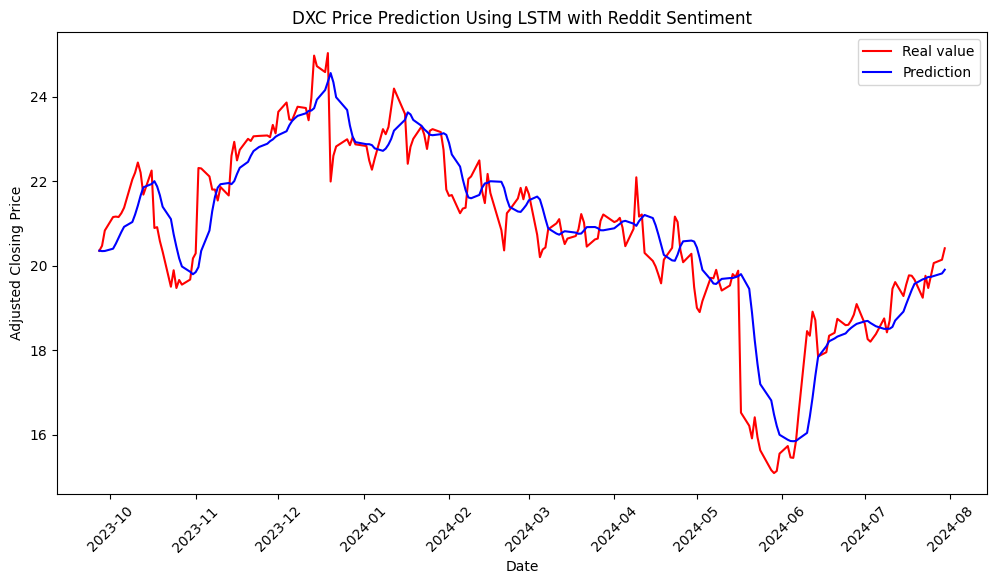

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando IT...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para IT:
MSE: 1289.74169361095
MSE Normalizado: 0.006792343376386971
MAE: 33.41327302248324
R²: 0.1510205378518461


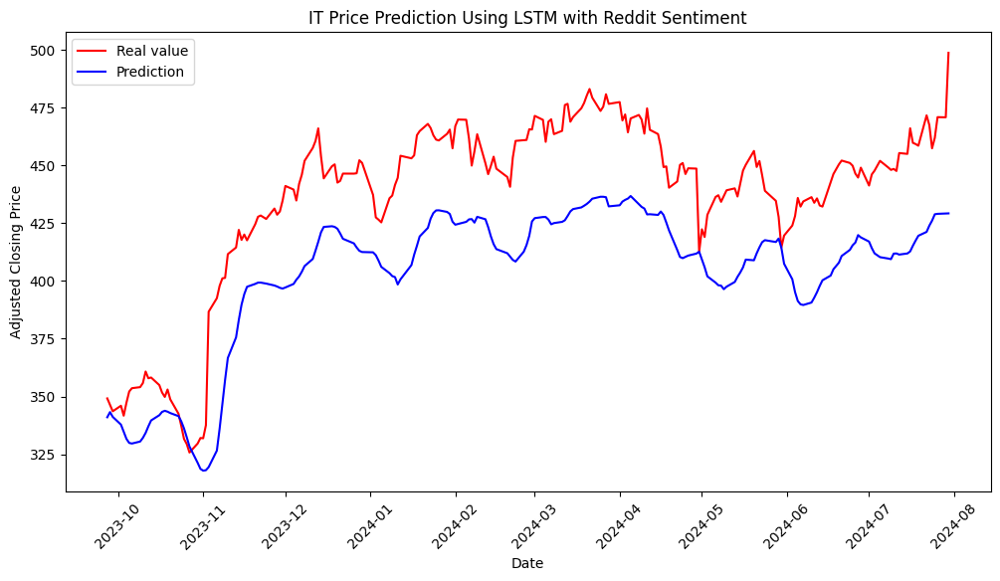

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando LDOS...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para LDOS:
MSE: 36.62037993157264
MSE Normalizado: 0.0024629435391505805
MAE: 5.161814882630575
R²: 0.9010912892971671


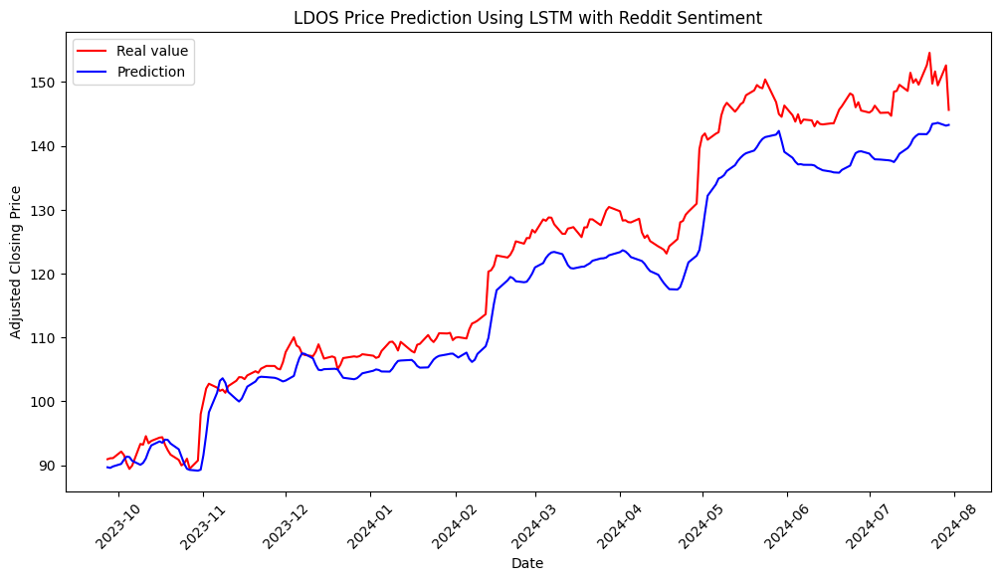

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando AKAM...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para AKAM:
MSE: 5.802209546747429
MSE Normalizado: 0.0005130835552591733
MAE: 1.633941563615791
R²: 0.9455509106708806


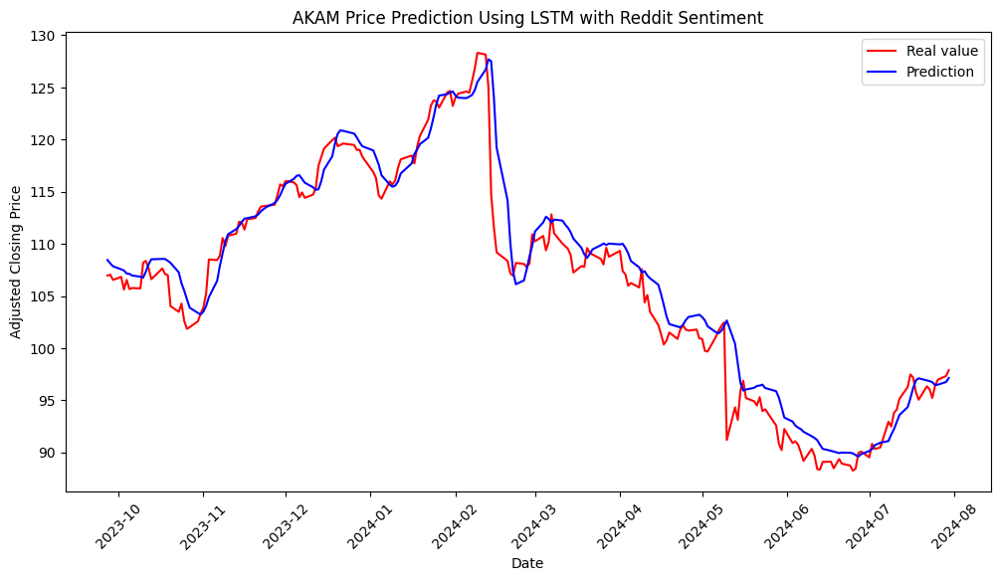

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando NTAP...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para NTAP:
MSE: 9.419073118839403
MSE Normalizado: 0.0009997396333097255
MAE: 2.1227075410629497
R²: 0.9715741213112093


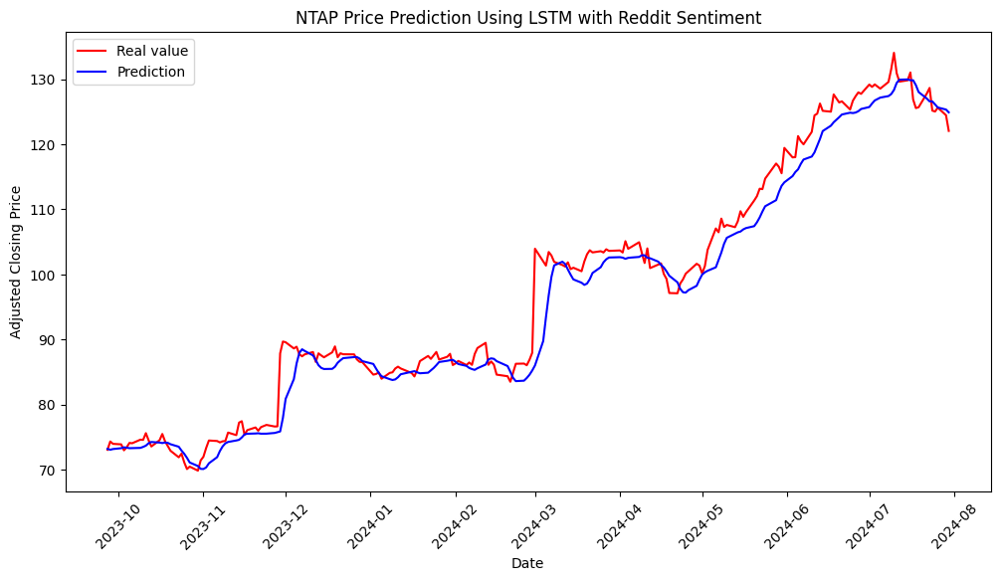

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando VRSN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para VRSN:
MSE: 11.714574756319594
MSE Normalizado: 0.00031529729299764814
MAE: 2.677429965447371
R²: 0.9395012555262268


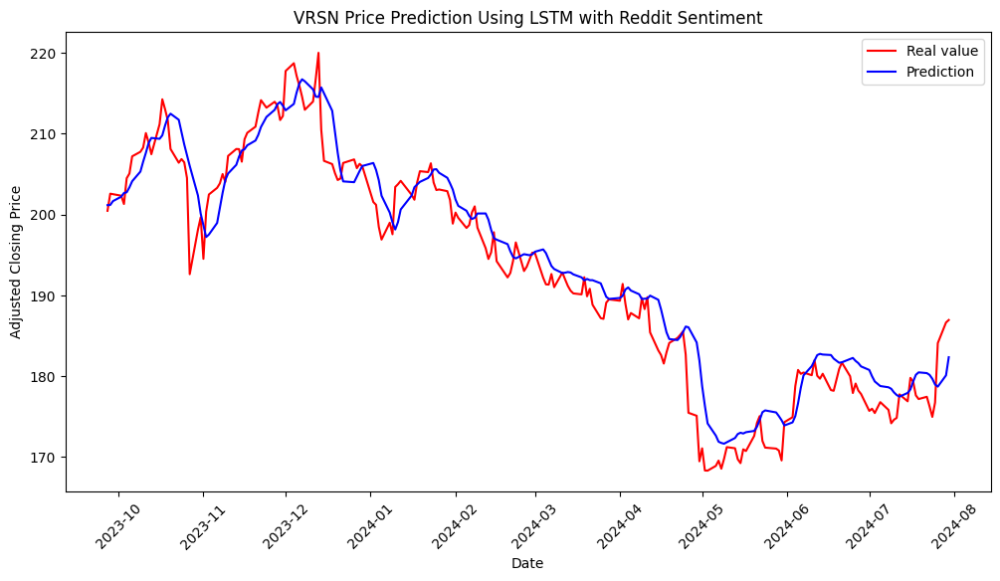

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando FFIV...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para FFIV:
MSE: 16.267892223011557
MSE Normalizado: 0.0005369824019163076
MAE: 2.767881301073115
R²: 0.882552890501861


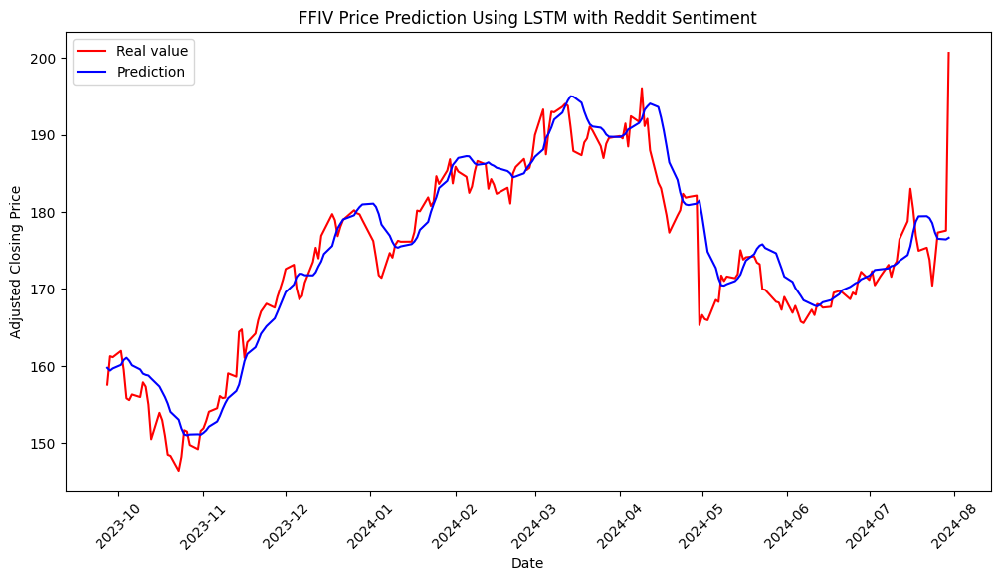

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando XRX...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para XRX:
MSE: 0.4177304875884792
MSE Normalizado: 0.0020249622396502076
MAE: 0.46078934516946146
R²: 0.9090981435381082


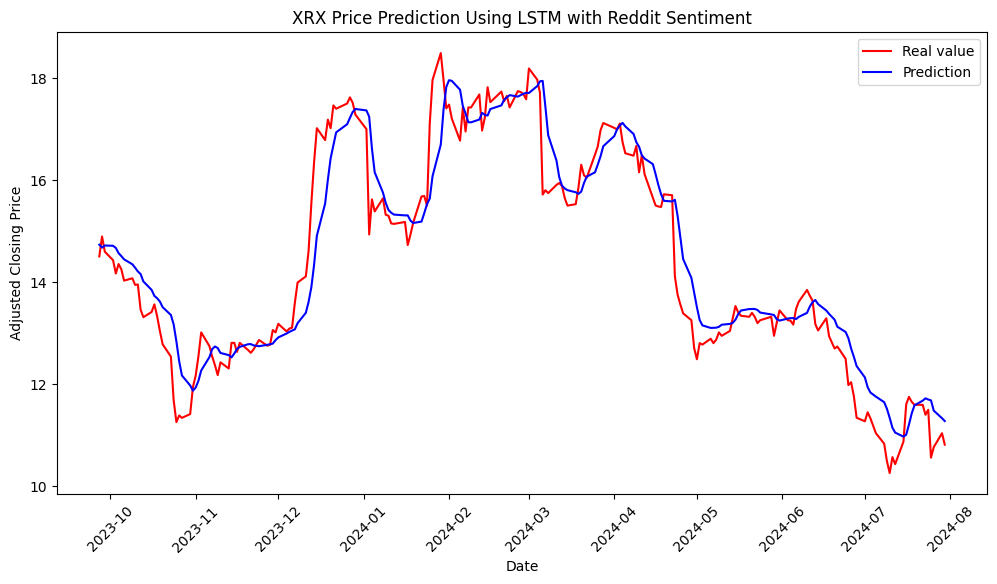

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando JNPR...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para JNPR:
MSE: 2.0158062549224445
MSE Normalizado: 0.001855347816095715
MAE: 1.1253704833421139
R²: 0.8950281911173245


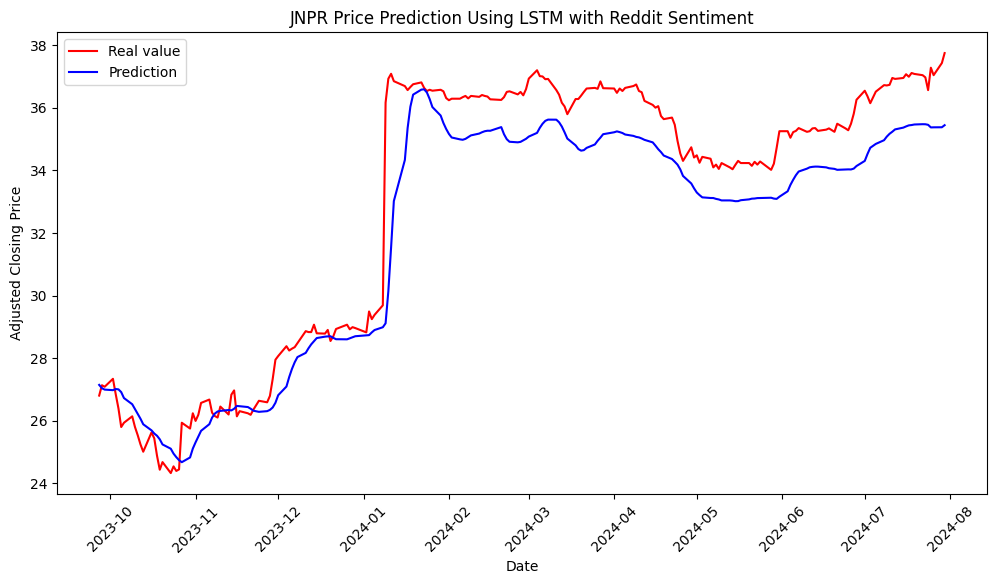

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CSGP...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CSGP:
MSE: 4.533218110044914
MSE Normalizado: 0.0006589617245497375
MAE: 1.6513729020544288
R²: 0.8906063812053358


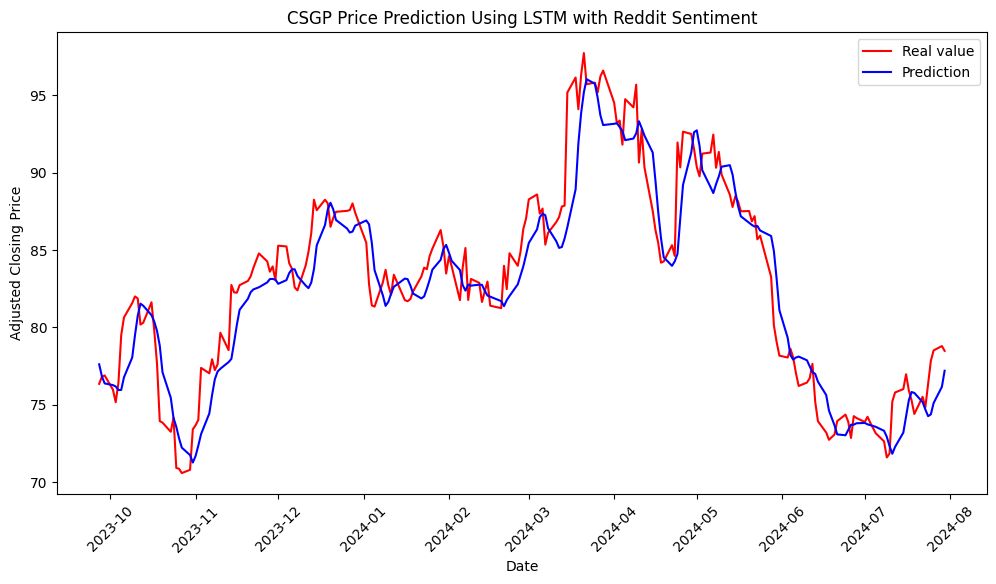

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando GRMN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para GRMN:
MSE: 40.70560318301156
MSE Normalizado: 0.002185547045926611
MAE: 4.9536310678596704
R²: 0.9169376145990557


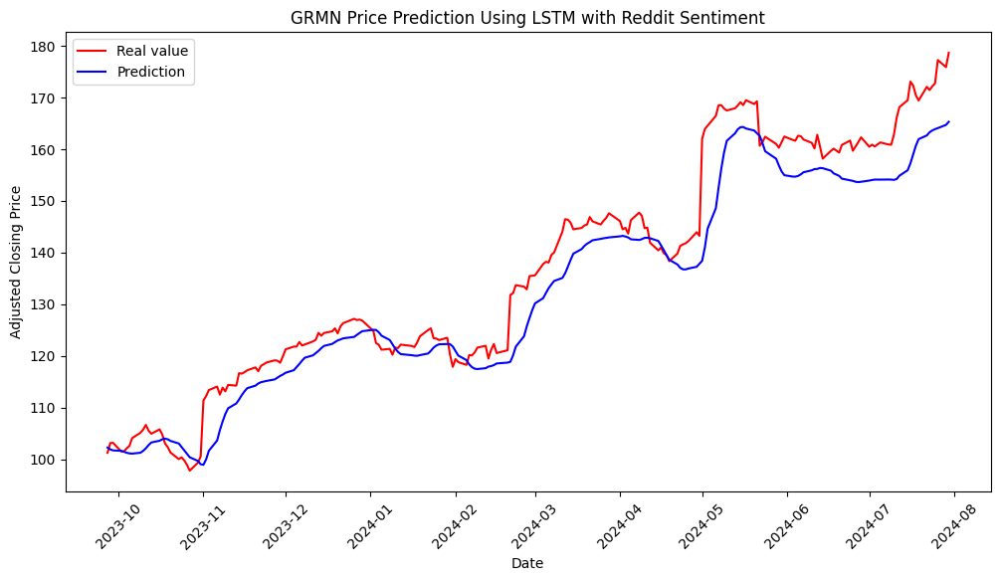

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando ZBRA...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para ZBRA:
MSE: 95.96541219453671
MSE Normalizado: 0.0012986925017251431
MAE: 7.578273617227922
R²: 0.9357321579640094


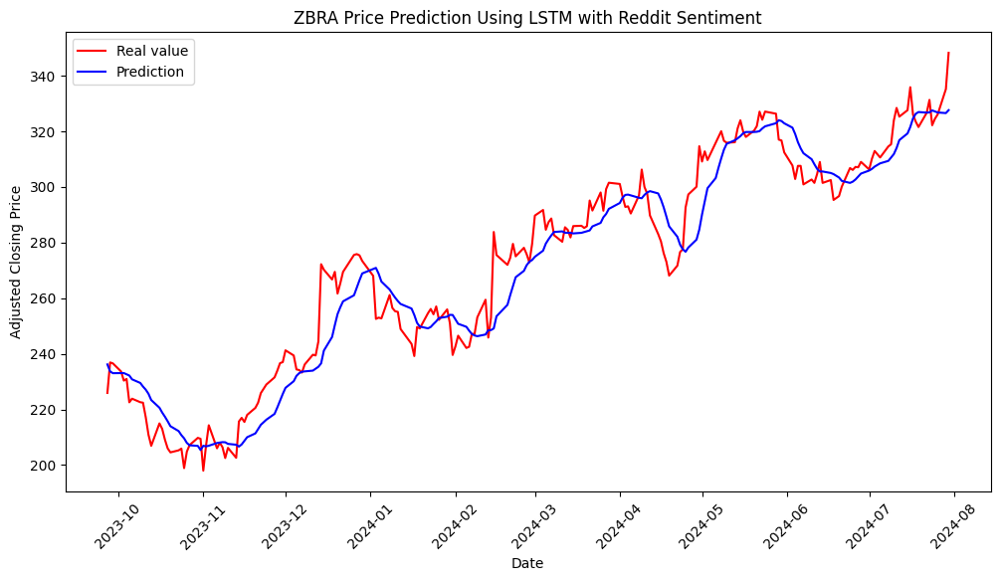

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando BR...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para BR:
MSE: 85.02785535136397
MSE Normalizado: 0.002271604742366142
MAE: 8.393106141870934
R²: 0.21518627512406507


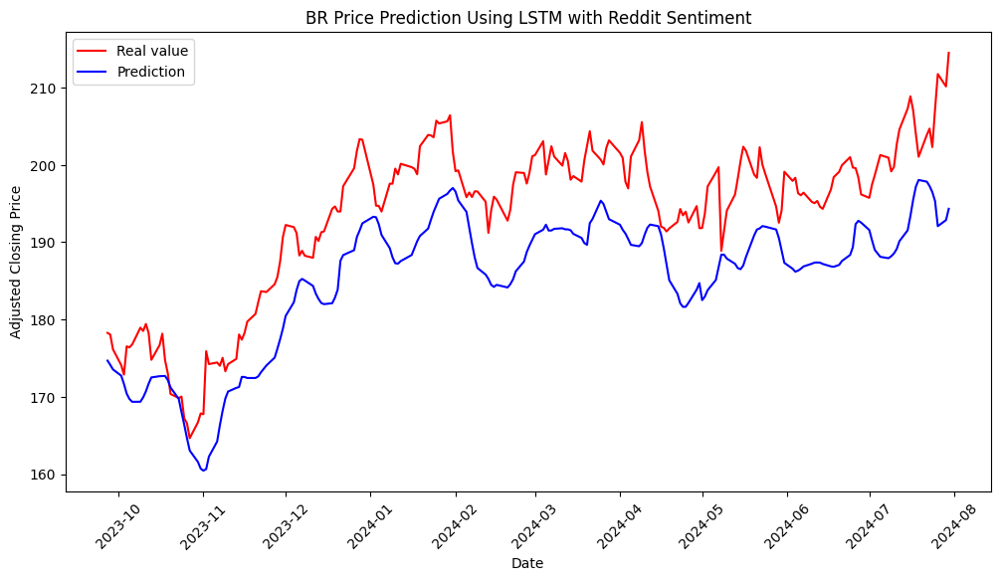

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando VRSN...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para VRSN:
MSE: 12.640601197809291
MSE Normalizado: 0.0003402212562075322
MAE: 2.755076375870367
R²: 0.9347188849984857


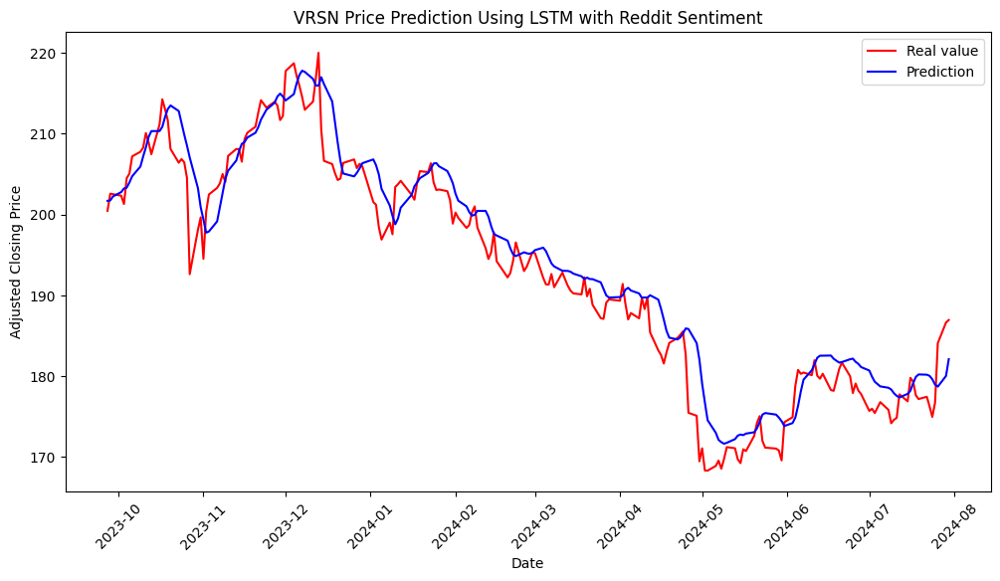

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando PTC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para PTC:
MSE: 53.659266403833065
MSE Normalizado: 0.0018312659873125719
MAE: 6.594649228495929
R²: 0.7576402375648984


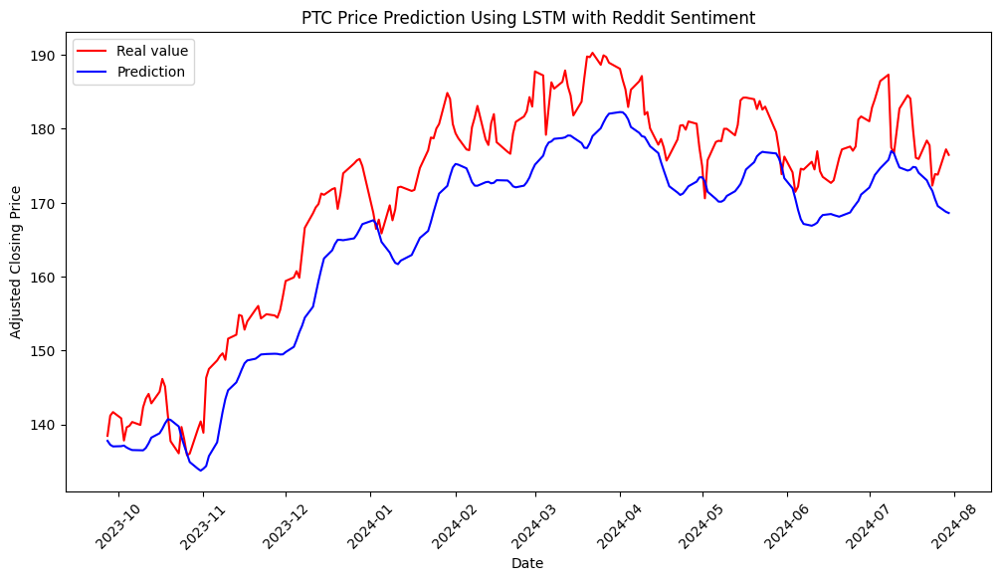

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando CTSH...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para CTSH:
MSE: 1.7868472054530444
MSE Normalizado: 0.00036371047892704727
MAE: 1.0208257719612295
R²: 0.9098941046277771


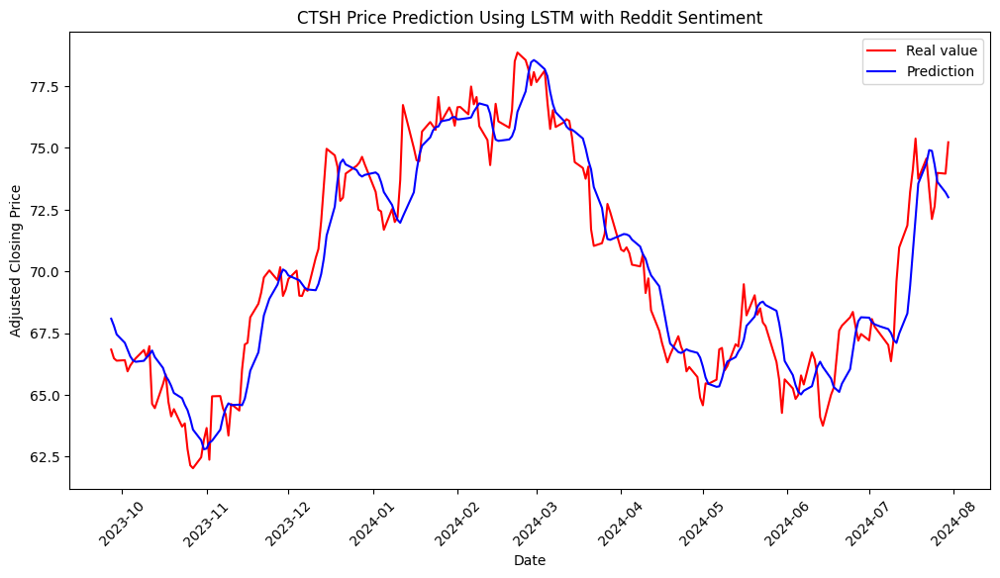

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando HPE...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para HPE:
MSE: 0.5119372909138683
MSE Normalizado: 0.0017595507441629436
MAE: 0.5157811682160249
R²: 0.8601368048980479


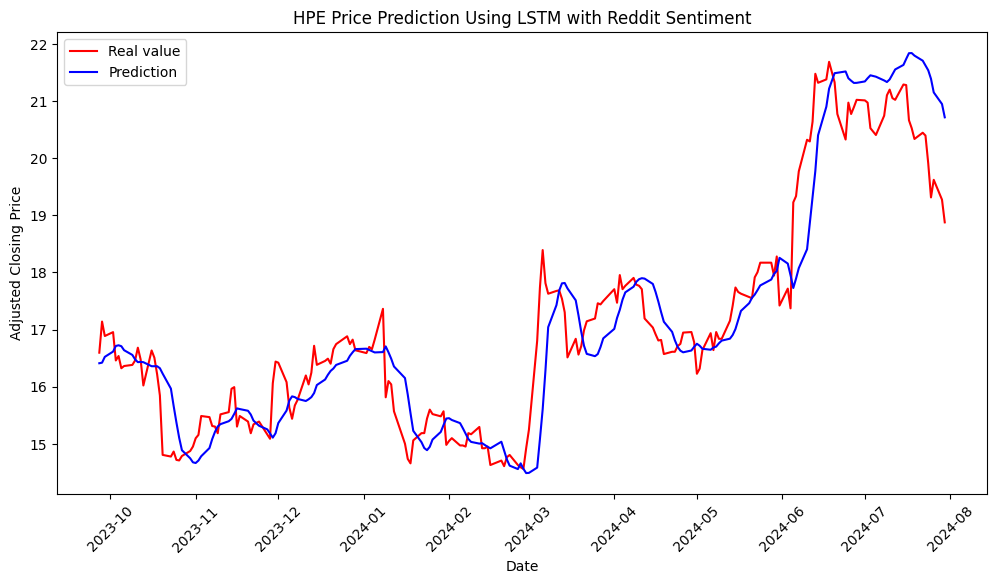

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando JNPR...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para JNPR:
MSE: 1.1926631183985328
MSE Normalizado: 0.0010977269797904053
MAE: 0.7817181019097779
R²: 0.9378928383517873


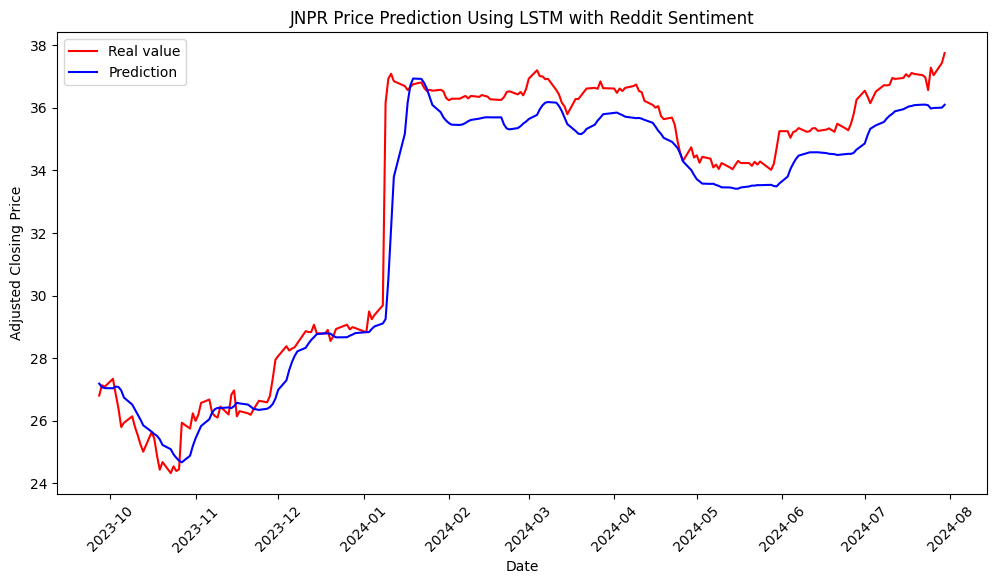

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando MSI...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para MSI:
MSE: 48.451963506722024
MSE Normalizado: 0.00043452575118381606
MAE: 5.158181244233212
R²: 0.957587234613026


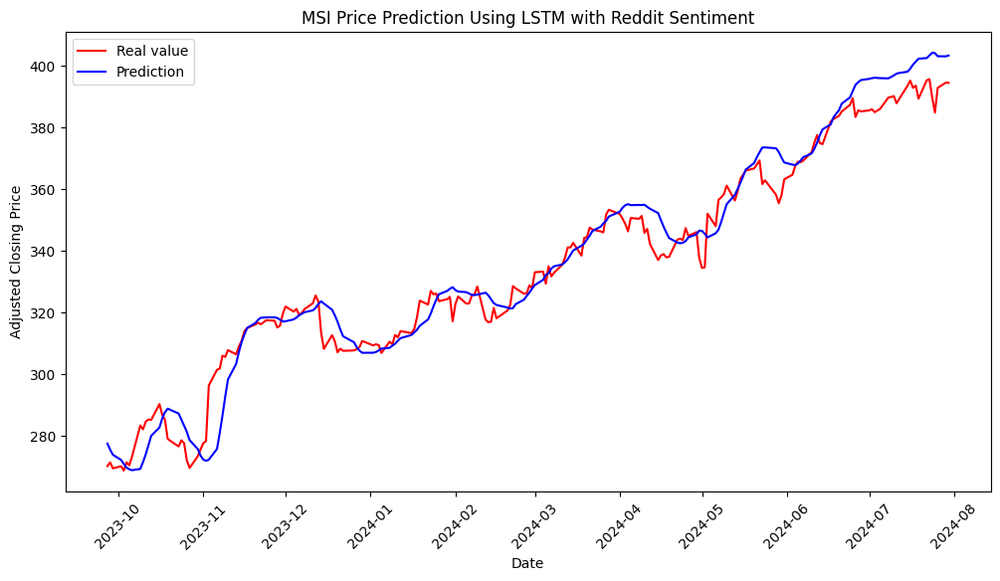

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando TDY...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para TDY:
MSE: 54.54450537219831
MSE Normalizado: 0.0003283548666162376
MAE: 5.434968650279652
R²: 0.85560899550331


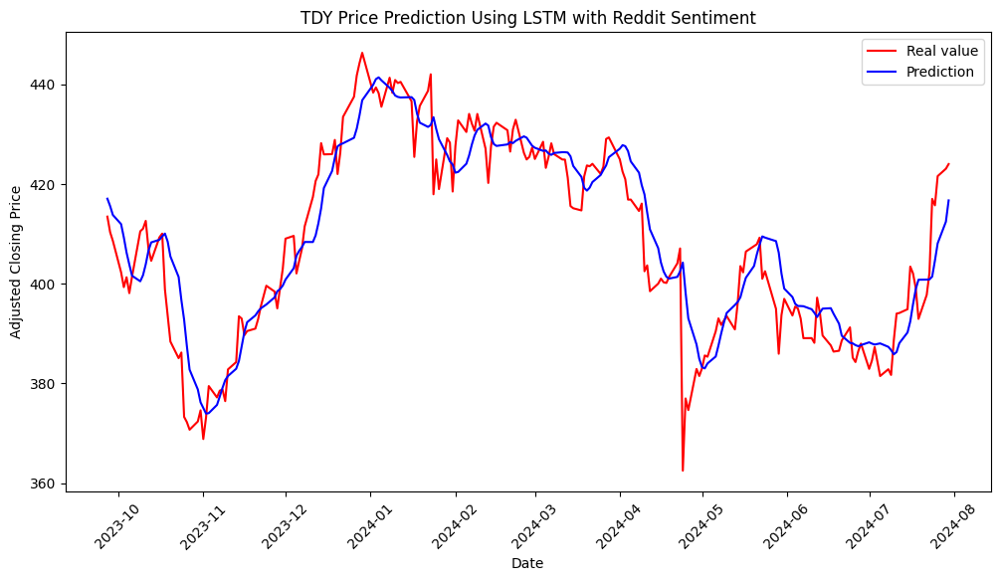

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando WDC...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para WDC:
MSE: 4.735296256346358
MSE Normalizado: 0.0012941382253593885
MAE: 1.7513427560894101
R²: 0.9681335789210183


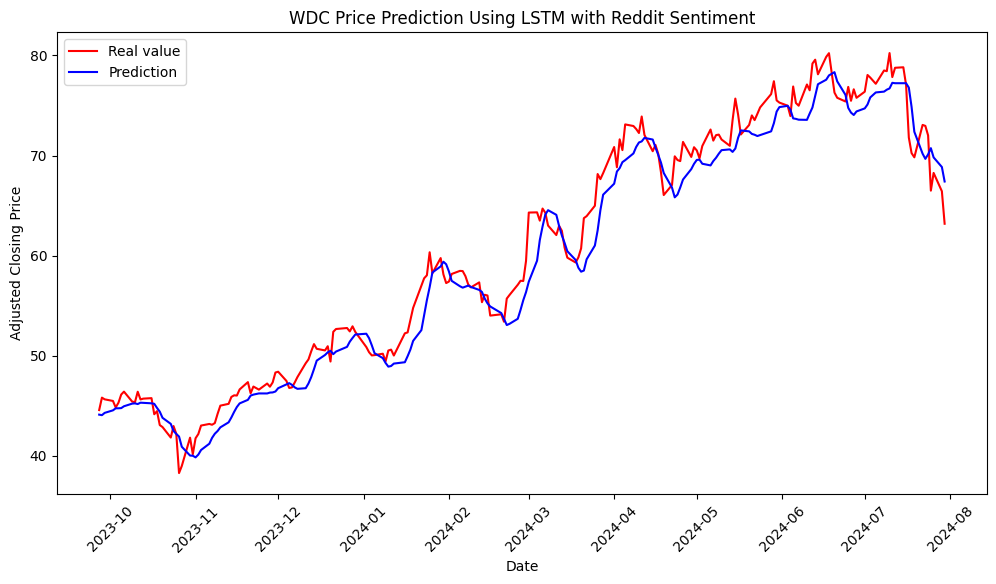

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 42.8 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
42.9 K    Trainable params
0         Non-trainable params
42.9 K    Total params
0.172     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Procesando STX...


Sanity Checking: |          | 0/? [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas de evaluación para STX:
MSE: 5.11048949106106
MSE Normalizado: 0.0007017624162080162
MAE: 1.802276437665394
R²: 0.9626837791109158


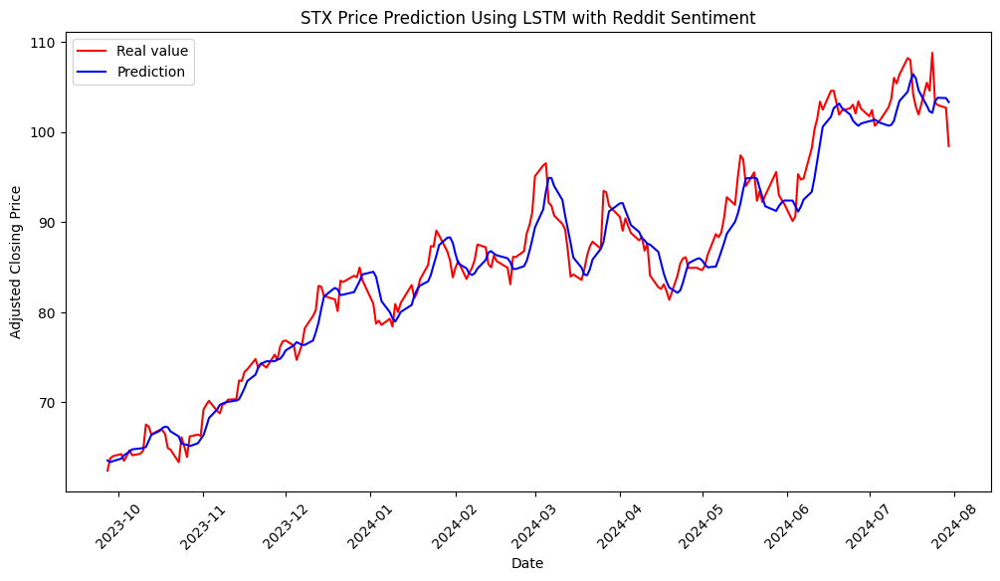


Resultados Finales:
             MSE  MSE_Normalizado        MAE        R2
AAPL   23.076263         0.000657   3.827892  0.915875
MSFT   57.371163         0.000366   6.074002  0.958347
NVDA  266.257528         0.044065  12.530502  0.681097
AVGO  189.917301         0.012713   9.672817  0.704127
CRM    67.238227         0.001009   6.228965  0.935735
...          ...              ...        ...       ...
HPE     0.511937         0.001760   0.515781  0.860137
MSI    48.451964         0.000435   5.158181  0.957587
TDY    54.544505         0.000328   5.434969  0.855609
WDC     4.735296         0.001294   1.751343  0.968134
STX     5.110489         0.000702   1.802276  0.962684

[62 rows x 4 columns]


In [9]:
# **MODELO 2. INCLUSION DE ANALISIS DE SENTIMIENTOS CON VADER**
import yfinance as yf
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import pytorch_lightning as pl
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nest_asyncio
import asyncio
import asyncpraw
import datetime

# Configuración de credenciales de Reddit
cliente_id = "H3cf4dEtELCFz7w3z6eIKw"
cliente_secret = "lxNt3eDn3Y1XA57EIq3_Q92AQ_Ntyw"
usuario = "RoutineStrain7301"
contraseña = "Tavinr1717*"
user_agent = "proyectogustav"

nltk.download('vader_lexicon')
nest_asyncio.apply()

# Definir el dispositivo (CPU o GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Lista de tickers
tickers = [
    'AAPL', 'MSFT', 'NVDA', 'AVGO', 'CRM', 'ORCL', 'AMD', 'CSCO', 'ACN', 'ADBE',
    'TXN', 'IBM', 'QCOM', 'INTU', 'AMAT', 'MU', 'LRCX', 'NOW', 'PANW', 'SNPS',
    'CDNS', 'ANET', 'FTNT', 'KLAC', 'APH', 'TEL', 'MCHP', 'NXPI', 'ON', 'MPWR',
    'ADI', 'KEYS', 'CDW', 'ANSS', 'PAYC', 'GDDY', 'TYL', 'SSNC','JKHY', 'EPAM',
    'GLW', 'HPQ', 'DXC', 'IT', 'LDOS', 'AKAM', 'NTAP', 'VRSN', 'FFIV', 'XRX',
    'JNPR', 'CSGP', 'GRMN', 'ZBRA', 'BR','VRSN', 'PTC', 'CTSH', 'HPE',
    'JNPR', 'MSI', 'TDY', 'WDC', 'STX'
]
stock_data = {}

# 1. Descargar datos financieros de Yahoo Finance y aplanar el MultiIndex
for ticker in tickers:
    data = yf.download(ticker, start='2019-06-01', end='2024-07-31')
    # Aplanar el MultiIndex y remover el nombre del índice
    data.columns = data.columns.get_level_values(0)
    data.columns.name = None  # Eliminar el nombre del índice de columnas
    stock_data[ticker] = data
    print(f"Datos para {ticker} descargados. Columnas disponibles: {data.columns}")

# 2. Generar medias móviles y preparar datos financieros
def preparar_datos_financieros(stock_data):
    for ticker, data in stock_data.items():
        # Generar medias móviles y eliminar filas con NaN
        data['MA_10'] = data['Adj Close'].rolling(window=10).mean()
        data['MA_30'] = data['Adj Close'].rolling(window=30).mean()
        data['MA_60'] = data['Adj Close'].rolling(window=60).mean()
        data.dropna(inplace=True)
        stock_data[ticker] = data
    return stock_data

# Aplicar la preparación de datos financieros
stock_data = preparar_datos_financieros(stock_data)

# 3. Obtener y agregar sentimientos de Reddit
async def obtener_reddit_async(ticker, subreddit_nombre='WallStreetBets', limite=100):
    async with asyncpraw.Reddit(client_id=cliente_id,
                                client_secret=cliente_secret,
                                user_agent=user_agent,
                                username=usuario,
                                password=contraseña) as reddit:
        subreddit = await reddit.subreddit(subreddit_nombre)
        publicaciones = subreddit.search(ticker, limit=limite)
        datos = []
        async for post in publicaciones:
            datos.append({
                'titulo': post.title,
                'cuerpo': post.selftext,
                'fecha': post.created_utc
            })
        return datos

def agregar_sentimiento_reddit(stock_data):
    sia = SentimentIntensityAnalyzer()

    async def process_tickers():
        for ticker in tickers:
            data = stock_data[ticker]
            publicaciones = await obtener_reddit_async(ticker, subreddit_nombre='WallStreetBets', limite=100)

            # Calcular sentimiento por fecha
            sentimiento_por_fecha = {}
            for post in publicaciones:
                fecha = datetime.datetime.utcfromtimestamp(post['fecha']).strftime('%Y-%m-%d')
                full_text = post['titulo'] + ' ' + (post['cuerpo'] or '')
                sentimiento = sia.polarity_scores(full_text)['compound']
                if fecha in sentimiento_por_fecha:
                    sentimiento_por_fecha[fecha].append(sentimiento)
                else:
                    sentimiento_por_fecha[fecha] = [sentimiento]

            for fecha in sentimiento_por_fecha:
                sentimiento_por_fecha[fecha] = np.mean(sentimiento_por_fecha[fecha])

            # Crear la columna de sentimiento alineada con el mercado
            sentimientos = []
            for date in data.index.strftime('%Y-%m-%d'):
                sentimientos.append(sentimiento_por_fecha.get(date, 0))
            data['sentimiento_reddit'] = sentimientos
            stock_data[ticker] = data

    asyncio.run(process_tickers())
    return stock_data

# Aplicar la función para agregar sentimientos de Reddit
stock_data = agregar_sentimiento_reddit(stock_data)

# 4. Validación de columnas y procesamiento de datos para LSTM
features = ['Adj Close', 'MA_10', 'MA_30', 'MA_60', 'sentimiento_reddit']

def verificar_columnas(stock_data, features):
    for ticker, data in stock_data.items():
        missing_columns = [col for col in features if col not in data.columns]
        for col in missing_columns:
            data[col] = 0
        stock_data[ticker] = data
    return stock_data

# Verificar y preparar las columnas para todos los tickers
stock_data = verificar_columnas(stock_data, features)

# Función para preparar datos para el modelo LSTM
def preparar_datos_lstm(stock_data, ticker, features, time_step=60):
    data = stock_data[ticker]

    # Eliminar filas con valores NaN
    data = data.dropna(subset=features)

    # Dividir datos en entrenamiento y validación
    train_data = data.loc[:'2023-06-30', features]
    val_data = data.loc['2023-07-01':, features]

    # Escalado de los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_scaled = scaler.fit_transform(train_data)
    val_scaled = scaler.transform(val_data)

    # Crear secuencias para LSTM
    X_train, Y_train = [], []
    for i in range(time_step, len(train_scaled)):
        X_train.append(train_scaled[i-time_step:i])
        Y_train.append(train_scaled[i, 0])  # Precio de cierre ajustado

    X_train = np.array(X_train)
    Y_train = np.array(Y_train)

    # Preparar datos de validación
    X_val, Y_val = [], []
    for i in range(time_step, len(val_scaled)):
        X_val.append(val_scaled[i-time_step:i])
        Y_val.append(val_scaled[i, 0])

    X_val = np.array(X_val)
    Y_val = np.array(Y_val)

    return X_train, Y_train, X_val, Y_val, scaler, val_data.index[time_step:]

# Definir el modelo LSTM
class LSTMModel(pl.LightningModule):
    def __init__(self, input_size=5, hidden_layer_size=100, output_size=1, lr=0.001):
        super(LSTMModel, self).__init__()
        self.hidden_layer_size = hidden_layer_size
        self.lstm = nn.LSTM(input_size, hidden_layer_size, batch_first=True)
        self.linear = nn.Linear(hidden_layer_size, output_size)
        self.lr = lr
        self.criterion = nn.MSELoss()

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        predictions = self.linear(lstm_out[:, -1])
        return predictions

    def training_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.criterion(y_hat, y)
        self.log('train_loss', loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x, y = batch
        y_hat = self(x)
        loss = self.criterion(y_hat, y)
        self.log('val_loss', loss, prog_bar=True)
        return loss

    def configure_optimizers(self):
        return torch.optim.Adam(self.parameters(), lr=self.lr)

# 5. Entrenamiento y evaluación para cada ticker
results = {}

# Crear un DataFrame para almacenar las predicciones futuras
future_prices_df = pd.DataFrame()

for ticker in tickers:
    print(f"\nProcesando {ticker}...")

    # Preparar los datos para el modelo LSTM
    X_train, Y_train, X_val, Y_val, scaler, dates = preparar_datos_lstm(stock_data, ticker, features)
    batch_size = 32
    X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
    Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1)
    X_val_tensor = torch.tensor(X_val, dtype=torch.float32)
    Y_val_tensor = torch.tensor(Y_val, dtype=torch.float32).unsqueeze(1)
    train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
    val_dataset = TensorDataset(X_val_tensor, Y_val_tensor)
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

    # Instanciar y entrenar el modelo
    model = LSTMModel(input_size=5)
    trainer = pl.Trainer(max_epochs=20, logger=False, enable_checkpointing=False)
    trainer.fit(model, train_loader, val_loader)

    # Realizar predicciones
    model.eval()
    with torch.no_grad():
        predictions = model(X_val_tensor).cpu().numpy()
    predictions_extended = np.concatenate([predictions, np.zeros((predictions.shape[0], len(features)-1))], axis=1)
    predictions_descaled = scaler.inverse_transform(predictions_extended)[:, 0]

    Y_val_extended = np.concatenate([Y_val.reshape(-1, 1), np.zeros((Y_val.shape[0], len(features)-1))], axis=1)
    Y_val_descaled = scaler.inverse_transform(Y_val_extended)[:, 0]

    # Guardar resultados en el DataFrame
    df_ticker = pd.DataFrame({
        'Date': dates,
        'Ticker': ticker,
        'Real Value': Y_val_descaled,
        'Predicted Value': predictions_descaled
    })
    future_prices_df = pd.concat([future_prices_df, df_ticker], ignore_index=True)


    # Calcular métricas de evaluación
    mse = mean_squared_error(Y_val_descaled, predictions_descaled)
    mae = mean_absolute_error(Y_val_descaled, predictions_descaled)
    r2 = r2_score(Y_val_descaled, predictions_descaled)

    # Calcular MSE normalizado usando el precio promedio de validación
    precio_promedio_validacion = np.mean(Y_val_descaled)
    mse_normalizado = mse / (precio_promedio_validacion ** 2)

    print(f"Métricas de evaluación para {ticker}:")
    print(f"MSE: {mse}")
    print(f"MSE Normalizado: {mse_normalizado}")
    print(f"MAE: {mae}")
    print(f"R²: {r2}")

    # Graficar resultados
    plt.figure(figsize=(12, 6))
    plt.plot(dates, Y_val_descaled, color='red', label='Real value')
    plt.plot(dates, predictions_descaled, color='blue', label='Prediction')
    plt.title(f"{ticker} Price Prediction Using LSTM with Reddit Sentiment")
    plt.xlabel('Date')
    plt.ylabel('Adjusted Closing Price')
    plt.legend()
    plt.xticks(rotation=45)
    plt.show()

    # Guardar resultados
    results[ticker] = {
        'MSE': mse,
        'MSE_Normalizado': mse_normalizado,
        'MAE': mae,
        'R2': r2
    }

# Mostrar todos los resultados
results_df = pd.DataFrame(results).T
print("\nResultados Finales:")
print(results_df)



# Modelo 3: Análisis de Sentimientos con Transformadores (FinBERT)

Este modelo utiliza el análisis de sentimientos avanzado mediante el modelo **FinBERT** y técnicas de series temporales (LSTM) para predecir los precios de las acciones.

## Datos de Entrada
1. **Históricos Financieros**:
   - Precios ajustados diarios.
   - Indicadores técnicos: Medias móviles de 10, 30 y 60 días.
2. **Sentimientos de Noticias**:
   - **API de Yahoo Finance**:
     - Extraemos titulares de noticias relacionadas con las empresas seleccionadas para el análisis.
   - **API de Reddit**:
     - Obtenemos publicaciones y comentarios relevantes sobre las empresas para capturar el sentimiento de las redes sociales.
   - Ambos conjuntos de datos son procesados con el modelo **FinBERT** para determinar su impacto en el mercado.

## Proceso de Preparación de Datos
1. **Extracción de Noticias y Comentarios**:
   - **Yahoo Finance**:
     - Se obtienen titulares de noticias utilizando solicitudes a su API, especificando el ticker y el rango de fechas.
   - **Reddit**:
     - Se conecta a la API de Reddit utilizando `praw` para extraer publicaciones relacionadas con las acciones.
     - Las publicaciones y comentarios son organizados por fecha y texto relevante.
2. **Análisis de Sentimientos**:
   - Cada titular o publicación se procesa usando el modelo FinBERT:
     - Se generan probabilidades para los sentimientos: positivo, neutral y negativo.
     - El sentimiento neto se calcula como: \( \text{positivo} - \text{negativo} \).
   - Los puntajes promedio diarios de sentimiento para Yahoo Finance y Reddit se alinean con las fechas del mercado.
3. **Enriquecimiento del Conjunto de Datos**:
   - Se agregan dos columnas al conjunto de datos:
     - `sentimiento_noticias`: Promedio diario de sentimientos derivados de Yahoo Finance.
     - `sentimiento_reddit`: Promedio diario de sentimientos derivados de Reddit.

## Arquitectura del Modelo
- **Capa de Entrada**:
  - Combina las siguientes características:
    - Precios ajustados (`Adj Close`).
    - Medias móviles (`MA_10`, `MA_30`, `MA_60`).
    - Sentimientos derivados de:
      - Noticias (`sentimiento_noticias`).
      - Redes sociales (`sentimiento_reddit`).
- **Capa LSTM**:
  - Captura patrones temporales en las características combinadas.
- **Capa fully connected**:
  - Genera predicciones finales de precios.

## Entrenamiento
1. **División de Datos**:
   - Los datos se dividen en dos períodos:
     - **Entrenamiento**: un perido de 4 años, Hasta el 30 de junio de 2023.
     - **Validación**: el periodo de 1 año desde el 1 de julio de 2023.
2. **Escalado**:
   - Los datos se normalizan usando un escalador Min-Max para garantizar que todas las características estén en el mismo rango.
3. **Parámetros del Entrenamiento**:
   - Épocas: 20.
   - Tamaño del lote: 32.
   - Optimizador: Adam.
   - Función de pérdida: MSE.

## Métricas de Evaluación
- **MSE (Mean Squared Error)**.
- **MSE Normalizado*.
- **MAE (Mean Absolute Error)**.
- **R² (Coeficiente de Determinación)**.

## Visualización de Resultados
El modelo genera gráficos que comparan los precios reales y las predicciones para cada acción. Esto permite:
- Visualizar la precisión del modelo.
- Evaluar si las predicciones siguen las tendencias reales del mercado.

## Resultados
Al finalizar, se recopilan las métricas clave para cada acción y se almacenan en un DataFrame para análisis comparativo.

### **Extracción de Noticias de Yahoo Finance**

In [10]:
# **Modelo 3. Analisis de sentimientos con TRANSFORMERS**
import requests
from bs4 import BeautifulSoup
import time

def obtener_noticias_yahoo(ticker, start_date, end_date):
    noticias_por_fecha = {}
    base_url = f"https://finance.yahoo.com/quote/{ticker}/news?p={ticker}"

    # Convertir fechas a objetos datetime
    start_date = datetime.datetime.strptime(start_date, '%Y-%m-%d')
    end_date = datetime.datetime.strptime(end_date, '%Y-%m-%d')

    # Realizar solicitud a la página de noticias
    response = requests.get(base_url)
    soup = BeautifulSoup(response.content, 'lxml')

    # Encontrar todas las noticias
    articles = soup.find_all('li', {'class': 'js-stream-content'})

    for article in articles:
        # Obtener título y enlace
        title_tag = article.find('h3')
        if title_tag:
            title = title_tag.get_text()
            link = 'https://finance.yahoo.com' + title_tag.find('a')['href']

            # Obtener fecha de la noticia
            time_tag = article.find('span', {'class': 'C(#959595) Fz(11px) D(ib) Mb(6px)'})
            if time_tag:
                time_text = time_tag.get_text()
                # Parsear fecha (puede ser "hace X horas" o fecha exacta)
                noticia_fecha = parse_fecha_noticia(time_text)

                if noticia_fecha and start_date <= noticia_fecha <= end_date:
                    # Obtener contenido de la noticia
                    contenido = obtener_contenido_noticia(link)
                    if contenido:
                        fecha_str = noticia_fecha.strftime('%Y-%m-%d')
                        if fecha_str in noticias_por_fecha:
                            noticias_por_fecha[fecha_str].append(contenido)
                        else:
                            noticias_por_fecha[fecha_str] = [contenido]

    return noticias_por_fecha

def parse_fecha_noticia(time_text):
    # Función para convertir el texto de fecha en un objeto datetime
    try:
        if 'ago' in time_text:
            # Noticias recientes (e.g., "2 hours ago")
            now = datetime.datetime.now()
            if 'hour' in time_text:
                hours = int(time_text.split(' ')[0])
                noticia_fecha = now - datetime.timedelta(hours=hours)
            elif 'minute' in time_text:
                minutes = int(time_text.split(' ')[0])
                noticia_fecha = now - datetime.timedelta(minutes=minutes)
            else:
                # Otros casos
                noticia_fecha = now
        else:
            # Fecha en formato específico (e.g., "August 24, 2023")
            noticia_fecha = datetime.datetime.strptime(time_text, '%B %d, %Y')
        return noticia_fecha
    except Exception as e:
        return None

def obtener_contenido_noticia(link):
    # Función para obtener el contenido de la noticia dado el enlace
    try:
        response = requests.get(link)
        soup = BeautifulSoup(response.content, 'lxml')
        content_tags = soup.find_all('p')
        content = ' '.join([tag.get_text() for tag in content_tags])
        return content
    except Exception as e:
        return None


### **Análisis de Sentimiento con Transformers**

In [11]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification

# Cargar el modelo y el tokenizador de FinBERT
tokenizer = AutoTokenizer.from_pretrained("yiyanghkust/finbert-tone")
model = AutoModelForSequenceClassification.from_pretrained("yiyanghkust/finbert-tone")

def analizar_sentimiento_finbert(texto):
    inputs = tokenizer(texto, return_tensors="pt", truncation=True, max_length=512)
    with torch.no_grad():
        outputs = model(**inputs)
    logits = outputs.logits
    # Obtener las probabilidades
    probabilities = torch.nn.functional.softmax(logits, dim=-1)
    # Mapear etiquetas
    labels = {0: 'negative', 1: 'neutral', 2: 'positive'}
    # Obtener la etiqueta con mayor probabilidad
    sentiment = labels[int(torch.argmax(probabilities))]
    # Retornar la probabilidad de sentimiento positivo
    positive_score = probabilities[0][2].item()
    negative_score = probabilities[0][0].item()
    neutral_score = probabilities[0][1].item()
    # Puedes definir el sentimiento como positivo menos negativo, o como prefieras
    sentiment_score = positive_score - negative_score
    return sentiment_score


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/533 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/226k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/439M [00:00<?, ?B/s]

### **Integrar Datos de Sentimiento al Conjunto de Datos Financiero**

In [12]:
def agregar_sentimiento_noticias(stock_data):
    for ticker in tickers:
        data = stock_data[ticker]
        start_date = data.index.min().strftime('%Y-%m-%d')
        end_date = data.index.max().strftime('%Y-%m-%d')
        print(f"Obteniendo noticias de Yahoo Finance para {ticker} desde {start_date} hasta {end_date}...")

        noticias_por_fecha = obtener_noticias_yahoo(ticker, start_date, end_date)

        sentimiento_por_fecha = {}
        for fecha, noticias in noticias_por_fecha.items():
            sentimiento_diario = []
            for noticia in noticias:
                sentimiento = analizar_sentimiento_finbert(noticia)
                sentimiento_diario.append(sentimiento)
            # Promediar el sentimiento diario
            sentimiento_por_fecha[fecha] = np.mean(sentimiento_diario)

        # Crear una columna de sentimiento alineada con las fechas del mercado
        sentimientos = []
        for date in data.index.strftime('%Y-%m-%d'):
            if date in sentimiento_por_fecha:
                sentimientos.append(sentimiento_por_fecha[date])
            else:
                sentimientos.append(0)
        data['sentimiento_noticias'] = sentimientos
        stock_data[ticker] = data
        print(f"Sentimiento de noticias agregado para {ticker}.")
    return stock_data


### **Actualizar el Modelo para Incluir el Sentimiento de Noticias**

In [13]:
def preparar_datos_lstm(stock_data, ticker, features, time_step=60):
    data = stock_data[ticker]

    # Eliminar filas con valores NaN
    data = data.dropna(subset=features)

    # Dividir datos en entrenamiento y validación
    train_data = data.loc[:'2023-06-30', features]
    val_data = data.loc['2023-07-01':, features]

    # Escalado de los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_scaled = scaler.fit_transform(train_data)
    val_scaled = scaler.transform(val_data)

    # Crear secuencias para LSTM
    X_train, Y_train = [], []
    for i in range(time_step, len(train_scaled)):
        X_train.append(train_scaled[i-time_step:i])
        Y_train.append(train_scaled[i, 0])  # Precio de cierre ajustado

    X_train = np.array(X_train)
    Y_train = np.array(Y_train)

    # Preparar datos de validación
    X_val, Y_val = [], []
    for i in range(time_step, len(val_scaled)):
        X_val.append(val_scaled[i-time_step:i])
        Y_val.append(val_scaled[i, 0])

    X_val = np.array(X_val)
    Y_val = np.array(Y_val)

    return X_train, Y_train, X_val, Y_val, scaler, val_data.index[time_step:]


### **Entrenar y Evaluar el Modelo**

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para PTC:
MSE: 37.00553144606645
MSE Normalizado: 0.0012629127384933179
MAE: 5.339249978081692
R²: 0.8328592168488408


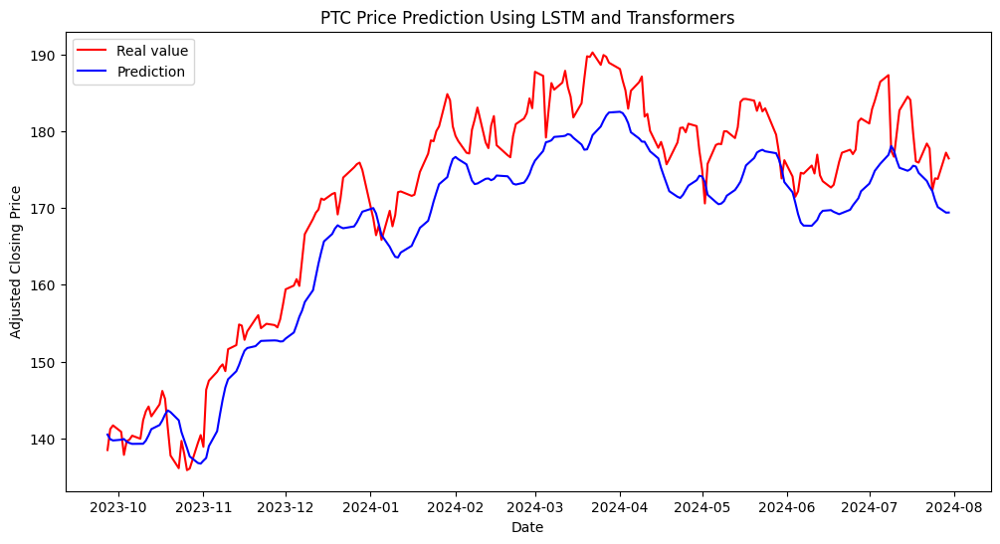

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CTSH...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para CTSH:
MSE: 2.1552150632020046
MSE Normalizado: 0.0004386912884525238
MAE: 1.1619684262712595
R²: 0.8913183050028718


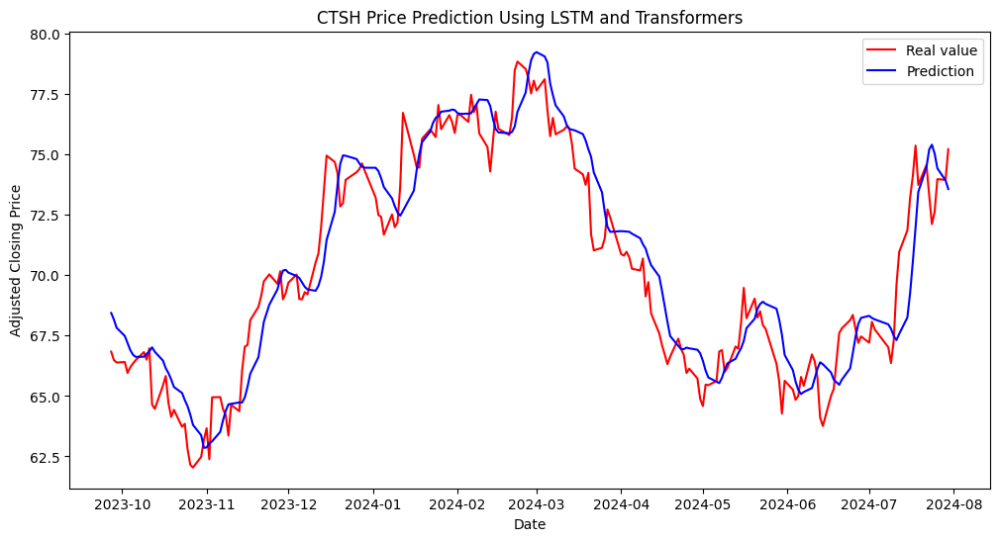

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para HPE...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para HPE:
MSE: 0.6401941866155946
MSE Normalizado: 0.002200375275372901
MAE: 0.5987622357438076
R²: 0.8250965381601452


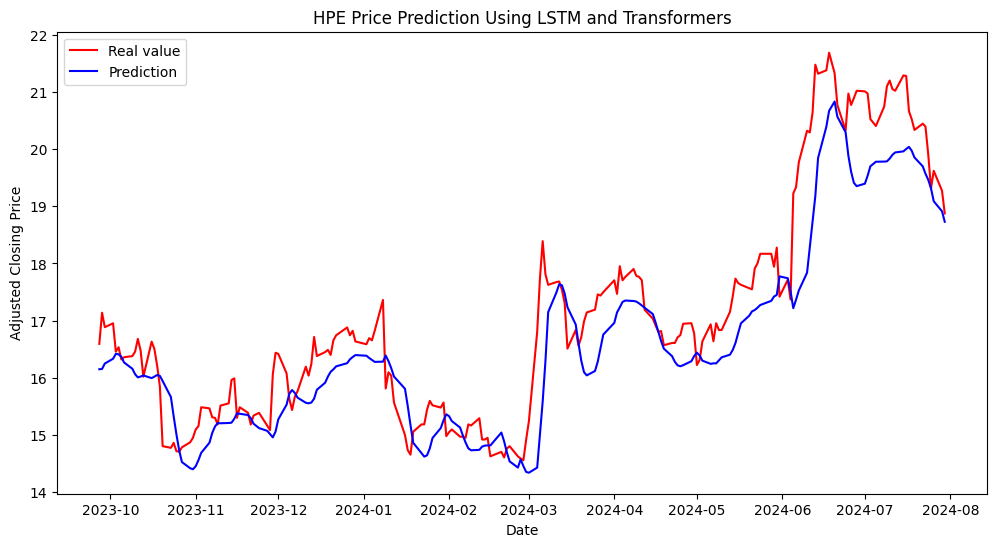

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para JNPR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para JNPR:
MSE: 0.8484902090340545
MSE Normalizado: 0.0007809502785626074
MAE: 0.5433945903421289
R²: 0.9558154203341477


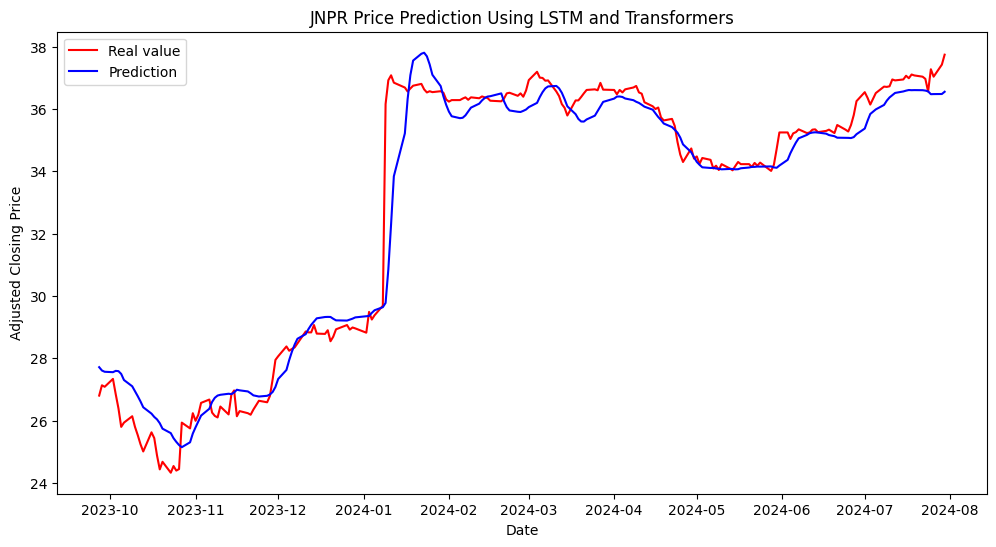

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MSI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para MSI:
MSE: 59.30782797313984
MSE Normalizado: 0.0005318830576914349
MAE: 6.036441318687474
R²: 0.9480844776685506


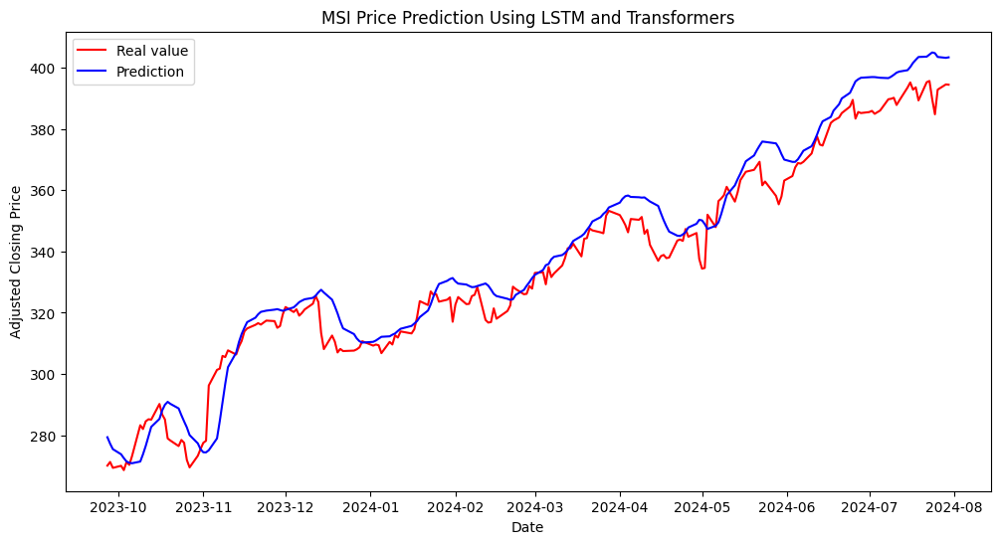

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TDY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para TDY:
MSE: 60.54890311610398
MSE Normalizado: 0.00036450100465264387
MAE: 5.818938226856098
R²: 0.8397140668441512


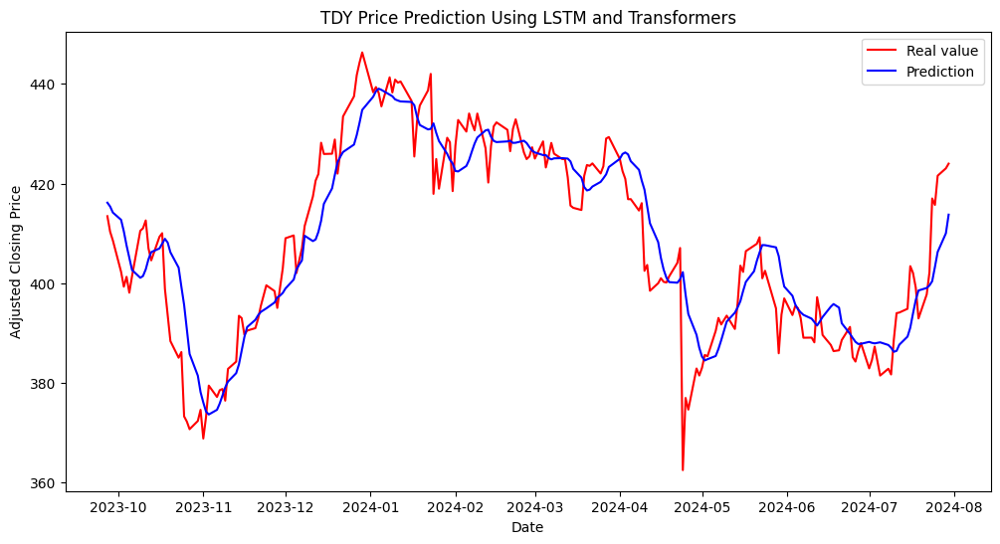

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para WDC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para WDC:
MSE: 3.3564182656391495
MSE Normalizado: 0.0009172961822687641
MAE: 1.3921198336140228
R²: 0.9774128096786561


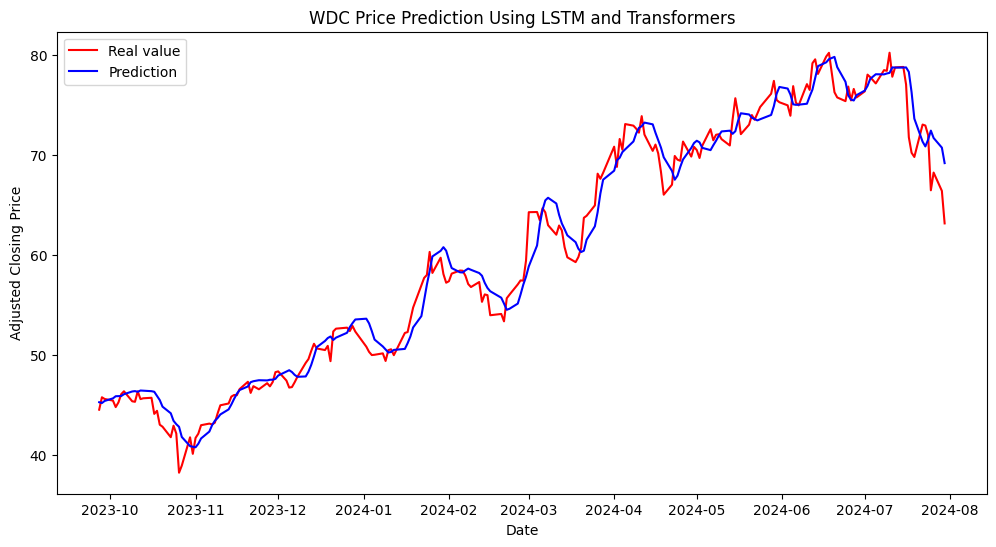

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para STX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para STX:
MSE: 7.202679482230996
MSE Normalizado: 0.0009890578515939531
MAE: 2.1290448022212503
R²: 0.94740684252999


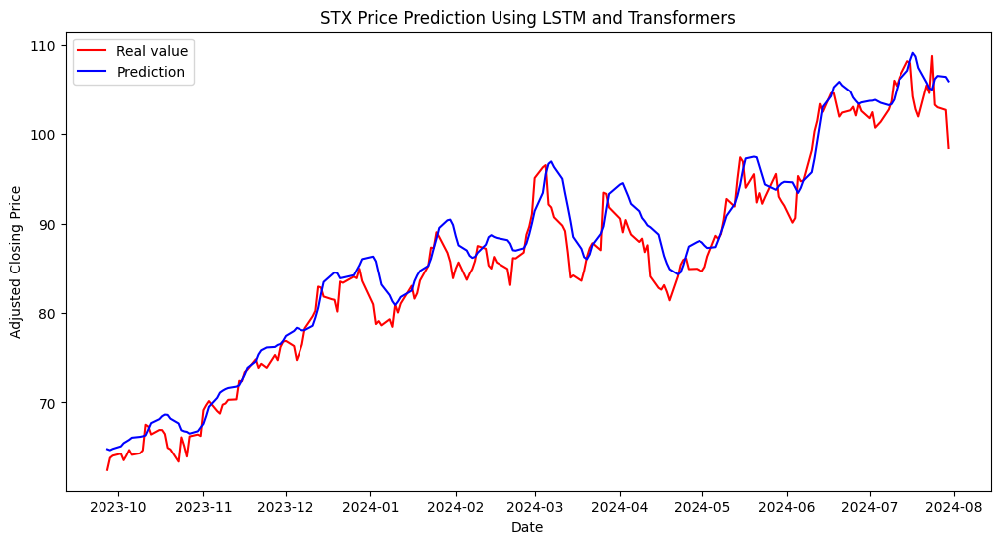


Métricas de Rendimiento:
   ticker         mse  mse_normalizado        mae        r2
0    AAPL   26.857629         0.000765   4.193617  0.902090
1    MSFT   54.385554         0.000347   5.936300  0.960515
2    NVDA  111.932733         0.018525   8.009993  0.865936
3    AVGO  321.565958         0.021526  14.125999  0.499031
4     CRM   67.478627         0.001012   6.233261  0.935505
..    ...         ...              ...        ...       ...
59   JNPR    0.848490         0.000781   0.543395  0.955815
60    MSI   59.307828         0.000532   6.036441  0.948084
61    TDY   60.548903         0.000365   5.818938  0.839714
62    WDC    3.356418         0.000917   1.392120  0.977413
63    STX    7.202679         0.000989   2.129045  0.947407

[64 rows x 5 columns]
Obteniendo noticias de Yahoo Finance para AAPL desde 2019-08-26 hasta 2024-07-30...
Sentimiento de noticias agregado para AAPL.
Obteniendo noticias de Yahoo Finance para MSFT desde 2019-08-26 hasta 2024-07-30...
Sentimiento de noti

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para AAPL:
MSE: 30.830612633218177
MSE Normalizado: 0.0008776394768535311
MAE: 4.306885928217994
R²: 0.8876063615961319


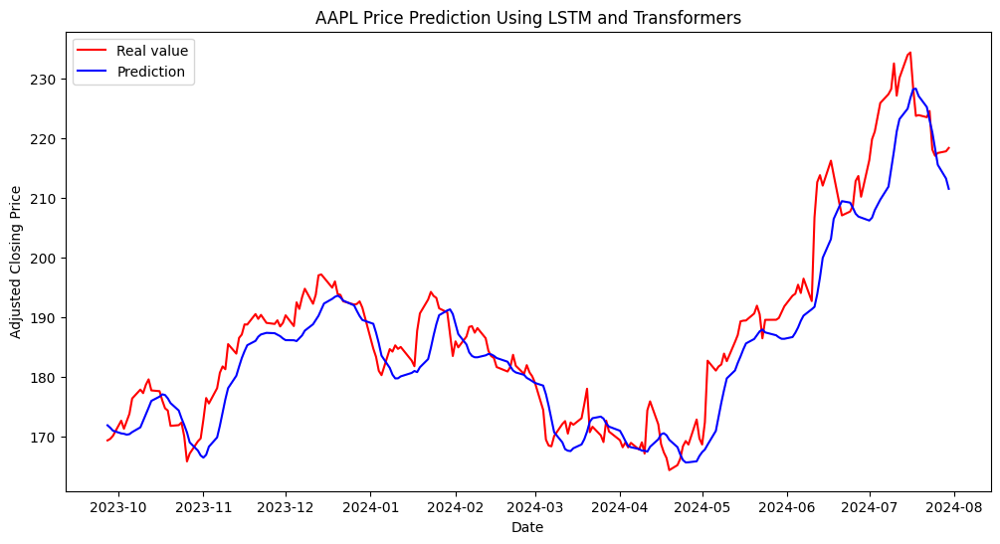

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MSFT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para MSFT:
MSE: 100.79225201145421
MSE Normalizado: 0.0006431710453683353
MAE: 8.12346761492935
R²: 0.9268220274907453


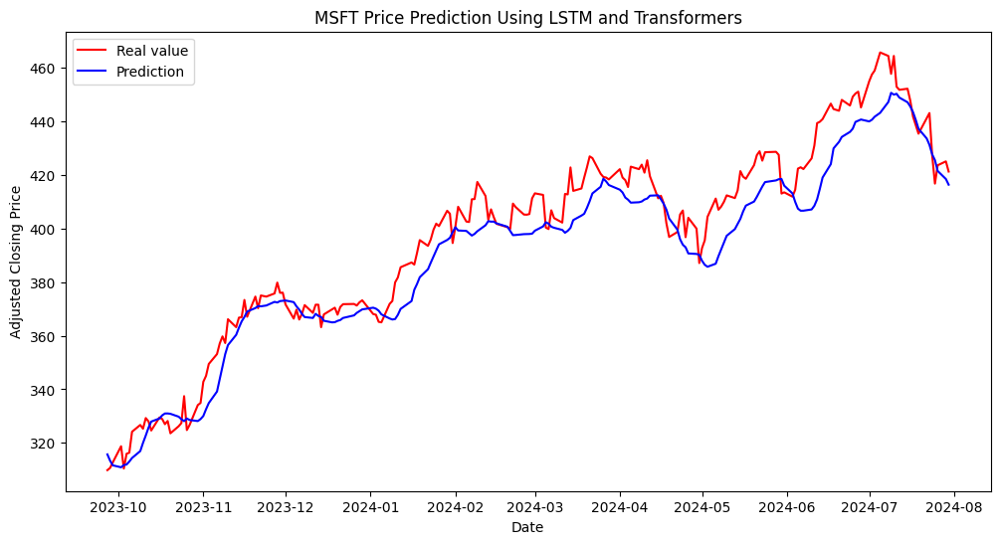

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para NVDA...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para NVDA:
MSE: 528.9803740864438
MSE Normalizado: 0.08754495923161673
MAE: 17.557075694822046
R²: 0.36642803713853245


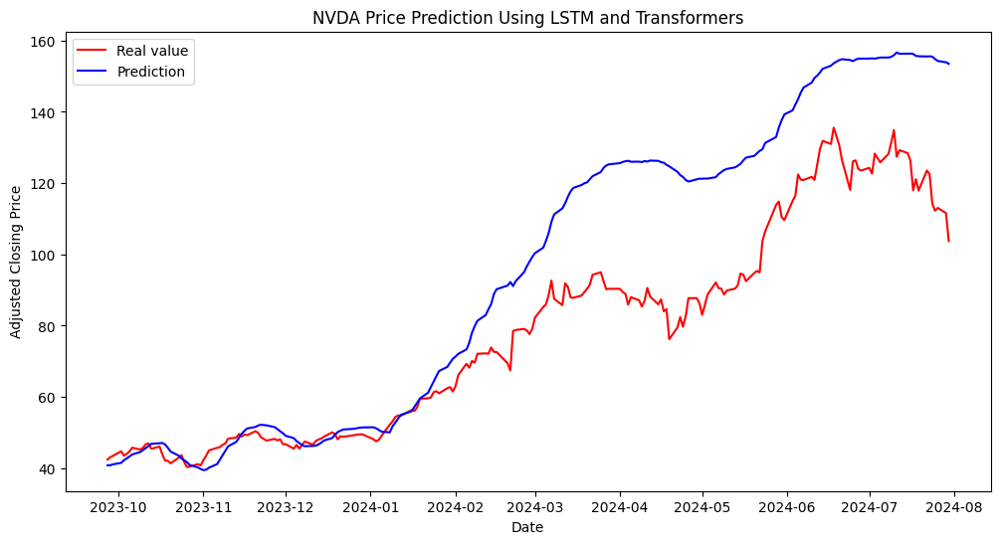

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para AVGO...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para AVGO:
MSE: 81.65701300272416
MSE Normalizado: 0.005466093280097299
MAE: 6.380782143803389
R²: 0.8727861473469849


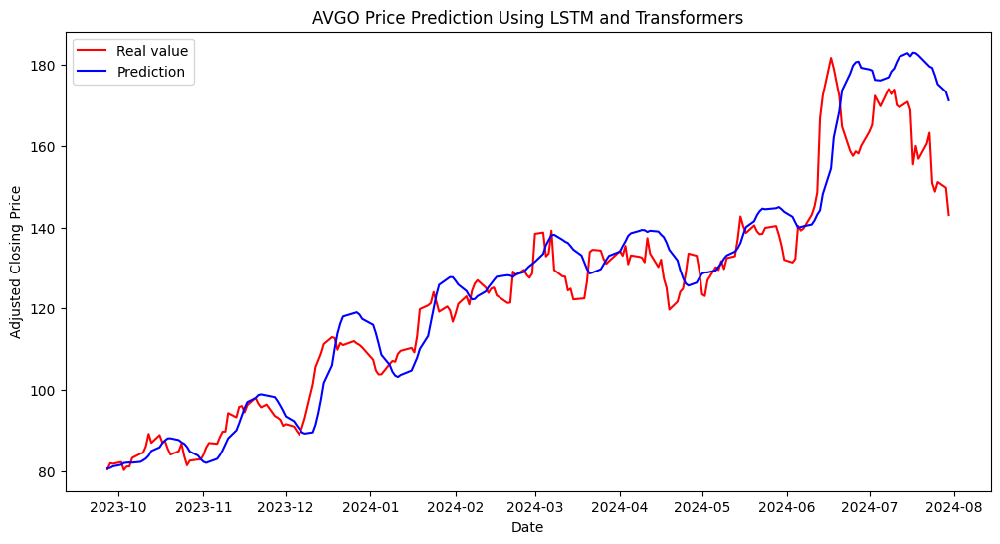

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CRM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para CRM:
MSE: 49.86279267335353
MSE Normalizado: 0.0007479924858119354
MAE: 4.720978619779661
R²: 0.95234220064373


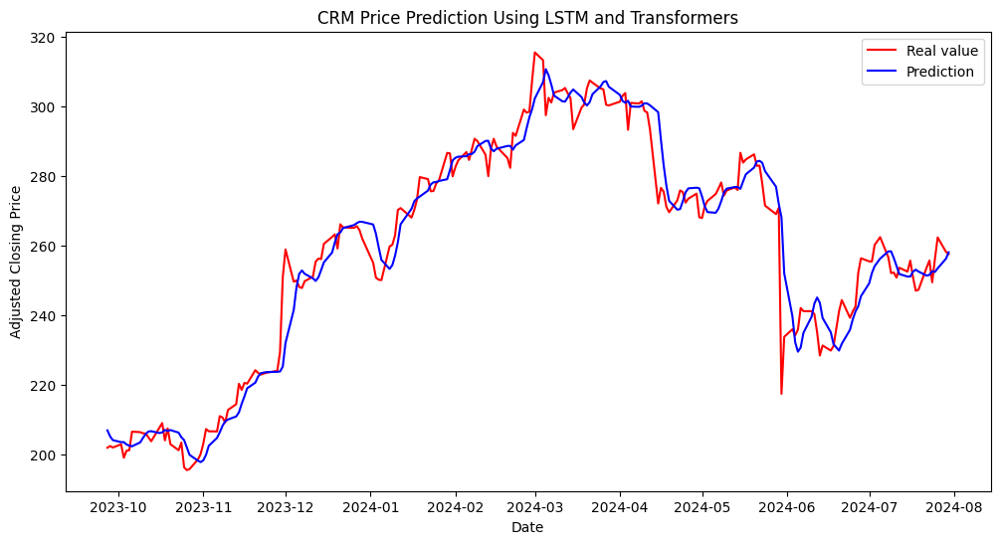

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ORCL...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para ORCL:
MSE: 103.05259759595218
MSE Normalizado: 0.007483343934720605
MAE: 9.00243050855675
R²: 0.3004383917617003


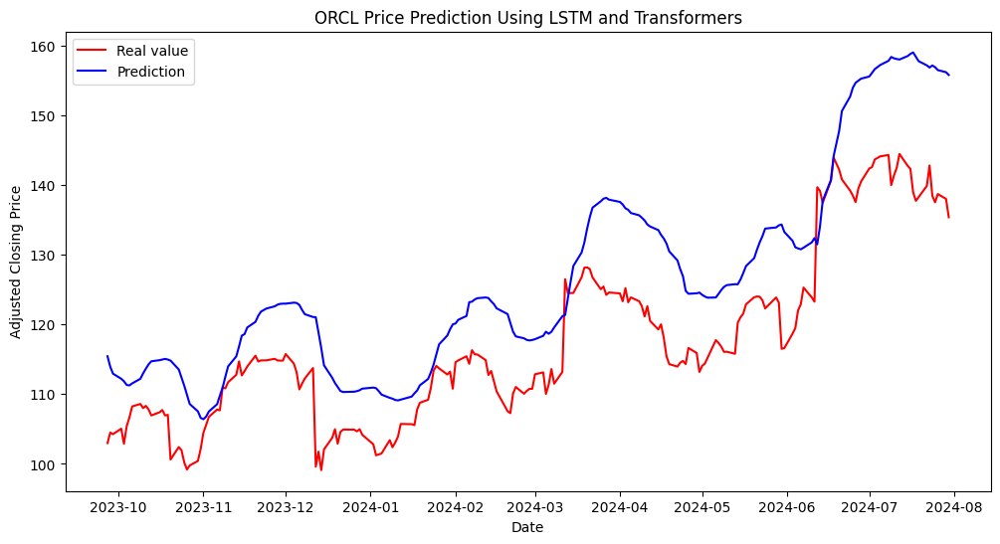

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para AMD...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para AMD:
MSE: 56.79143131486598
MSE Normalizado: 0.00248100133860761
MAE: 5.79799475369604
R²: 0.9261622033465252


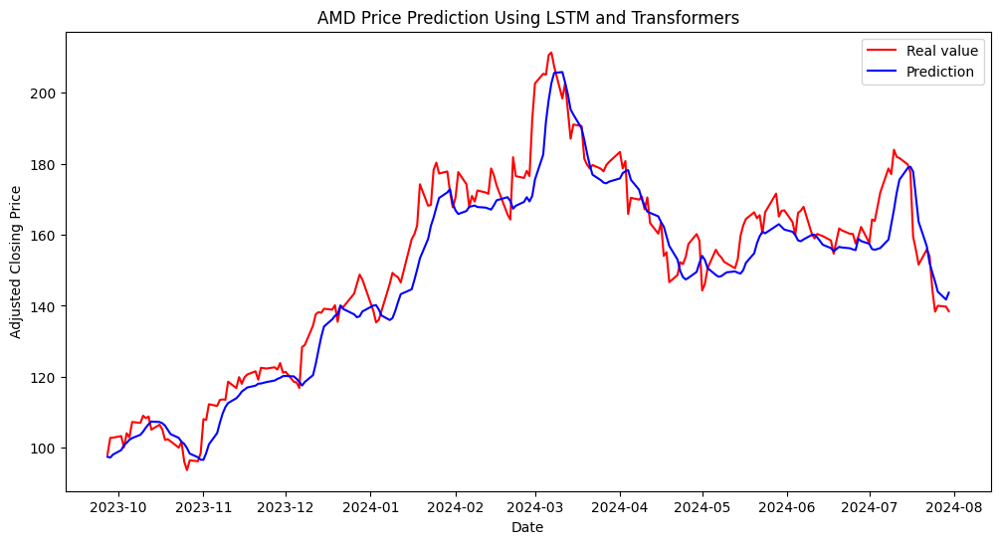

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CSCO...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para CSCO:
MSE: 0.801488136189397
MSE Normalizado: 0.0003452499773148003
MAE: 0.649997503067001
R²: 0.7810392207341464


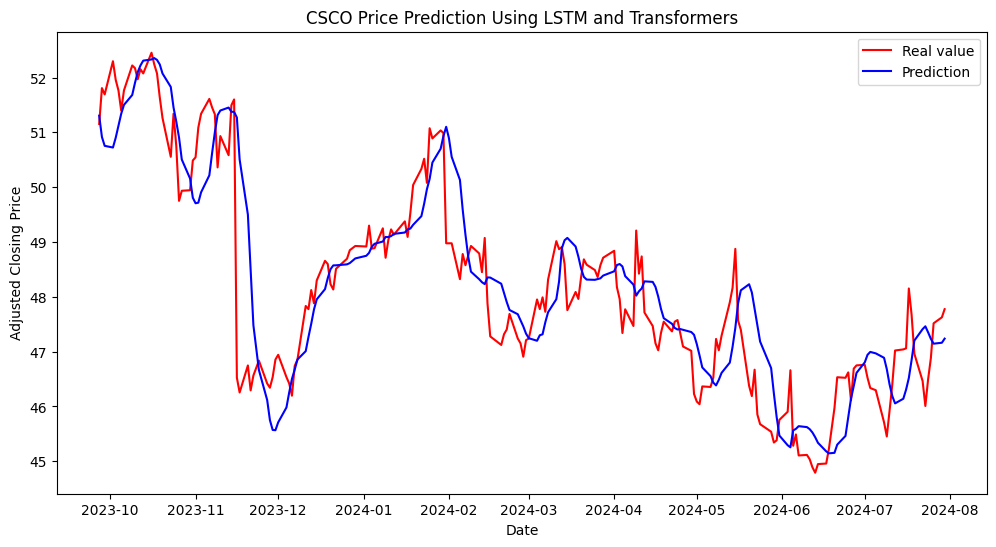

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ACN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para ACN:
MSE: 61.46703724694938
MSE Normalizado: 0.0005820542931466057
MAE: 5.901314416601595
R²: 0.9192789265033413


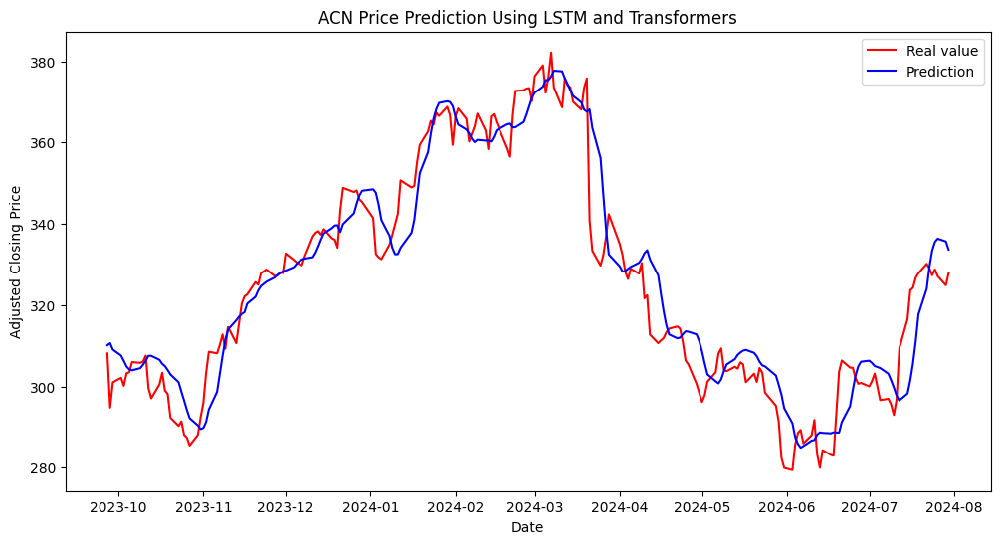

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ADBE...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para ADBE:
MSE: 343.2405145737363
MSE Normalizado: 0.0011553473272429154
MAE: 14.685242582890695
R²: 0.8720407682519067


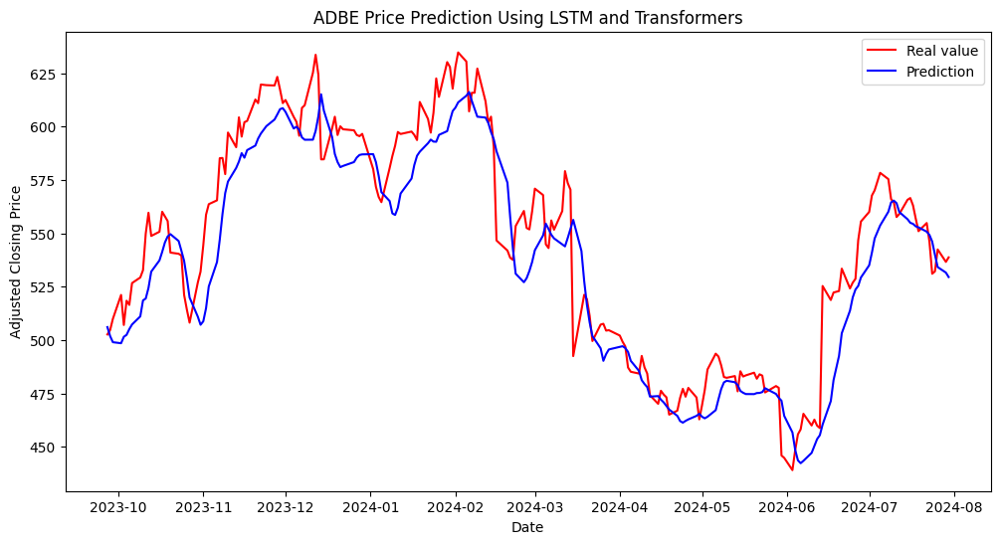

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TXN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para TXN:
MSE: 21.131712765519495
MSE Normalizado: 0.0007469685313205424
MAE: 3.710318326633679
R²: 0.9361171471259395


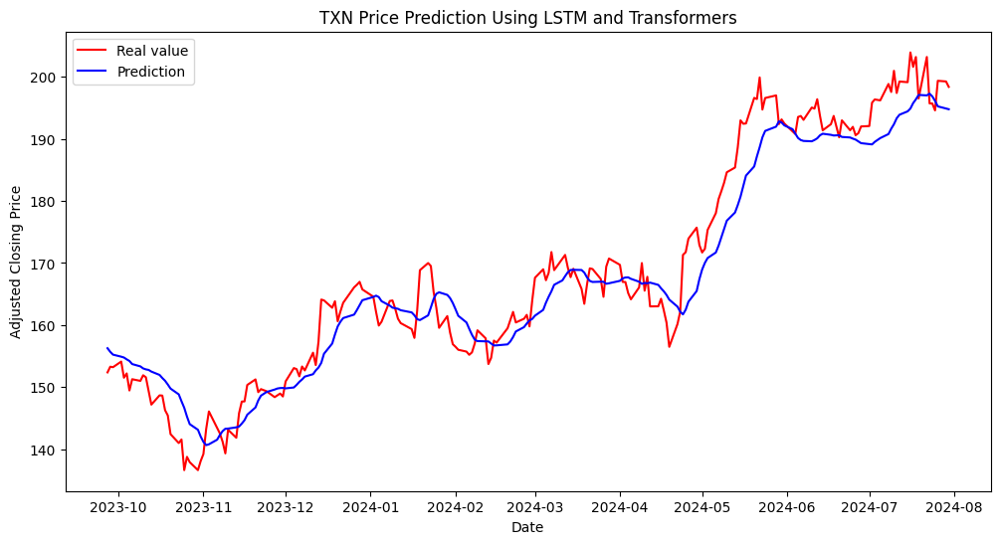

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para IBM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para IBM:
MSE: 17.08761721472891
MSE Normalizado: 0.0006265901264978019
MAE: 3.0587053043321366
R²: 0.9402444285512496


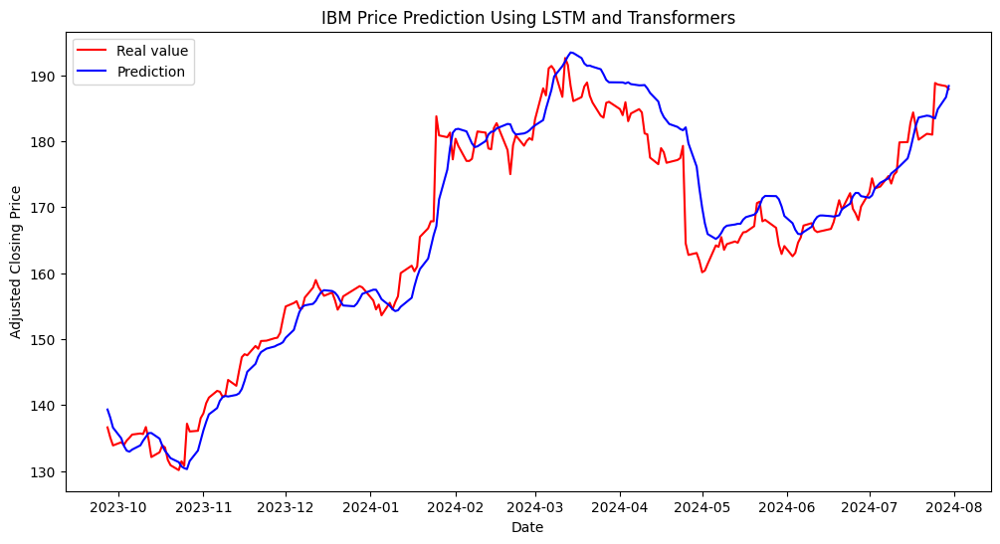

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para QCOM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para QCOM:
MSE: 73.18952435403811
MSE Normalizado: 0.0029600201428712407
MAE: 7.0211202543191895
R²: 0.9294471498564364


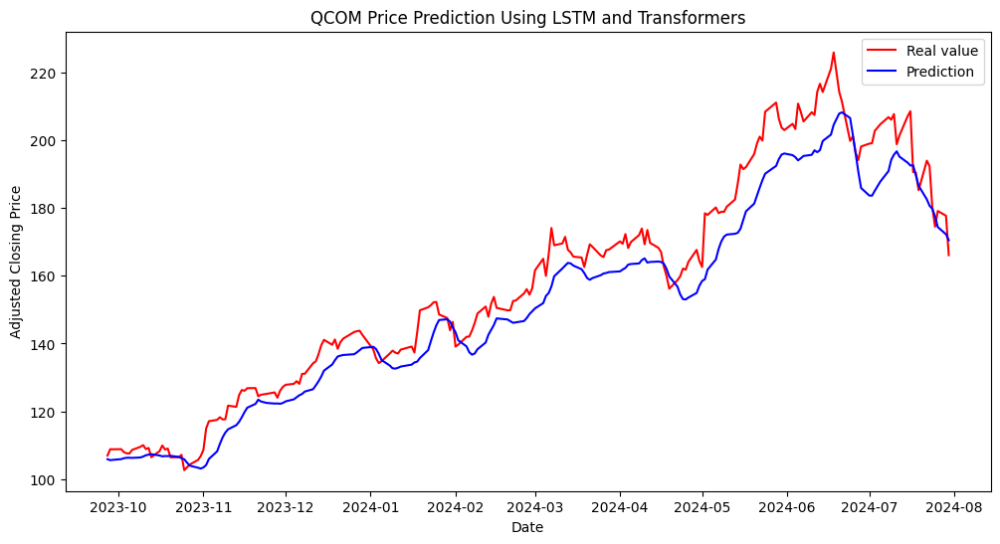

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para INTU...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para INTU:
MSE: 383.69471783539564
MSE Normalizado: 0.001054348050894373
MAE: 16.517313796212854
R²: 0.845313787163716


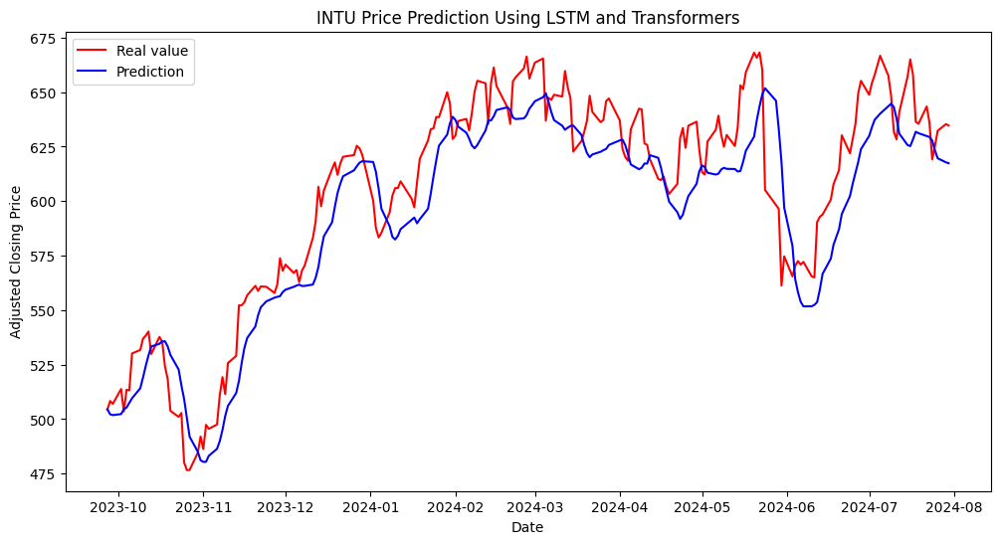

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para AMAT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para AMAT:
MSE: 62.82530978960987
MSE Normalizado: 0.001845653667192003
MAE: 6.222456575285048
R²: 0.9465138560848284


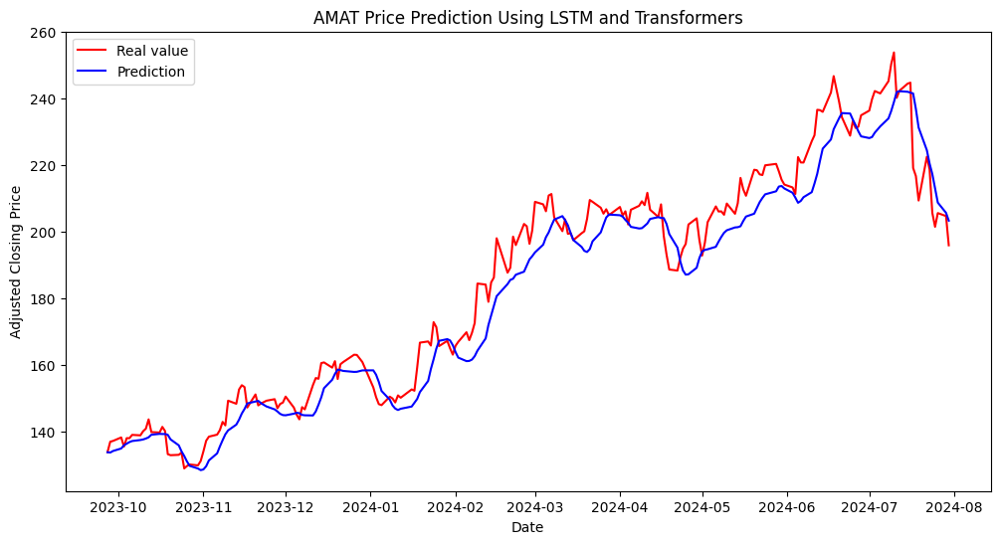

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MU...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para MU:
MSE: 21.968491397875244
MSE Normalizado: 0.0022485927333276484
MAE: 3.3329901677152227
R²: 0.9615543624144026


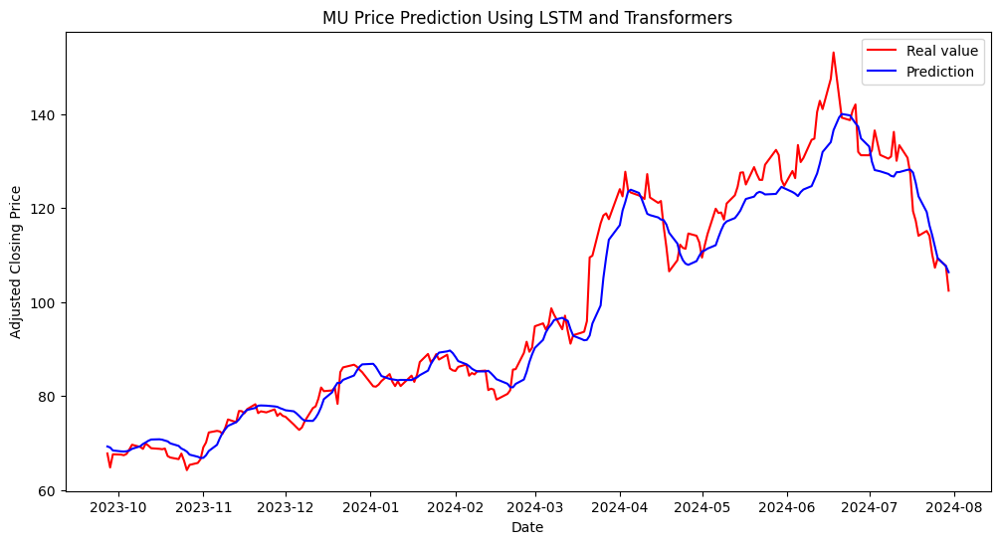

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para LRCX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para LRCX:
MSE: 28.898771579621727
MSE Normalizado: 0.004019355398021315
MAE: 4.672567360564719
R²: 0.8575127548519836


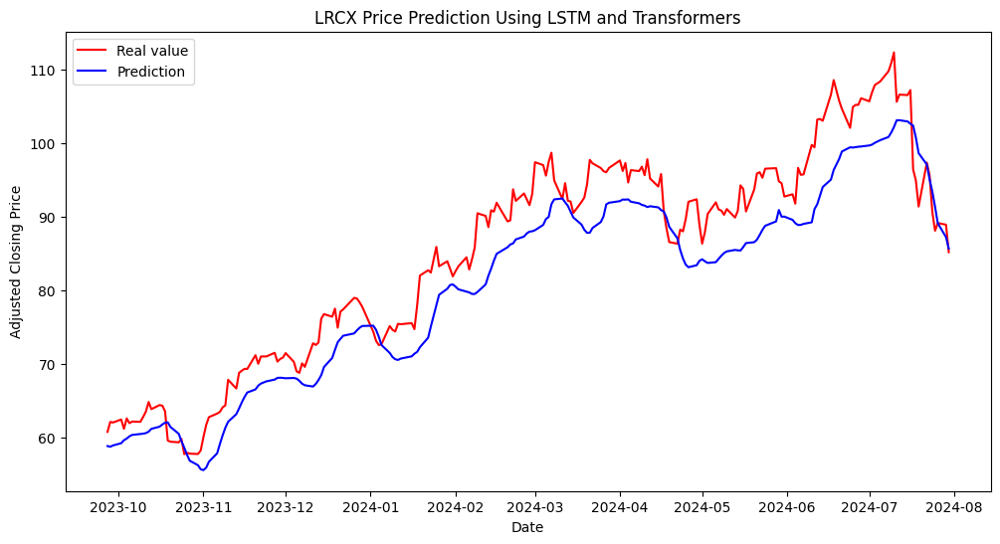

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para NOW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para NOW:
MSE: 614.3941292138671
MSE Normalizado: 0.0012158295901396443
MAE: 20.070149381802505
R²: 0.8832280276296376


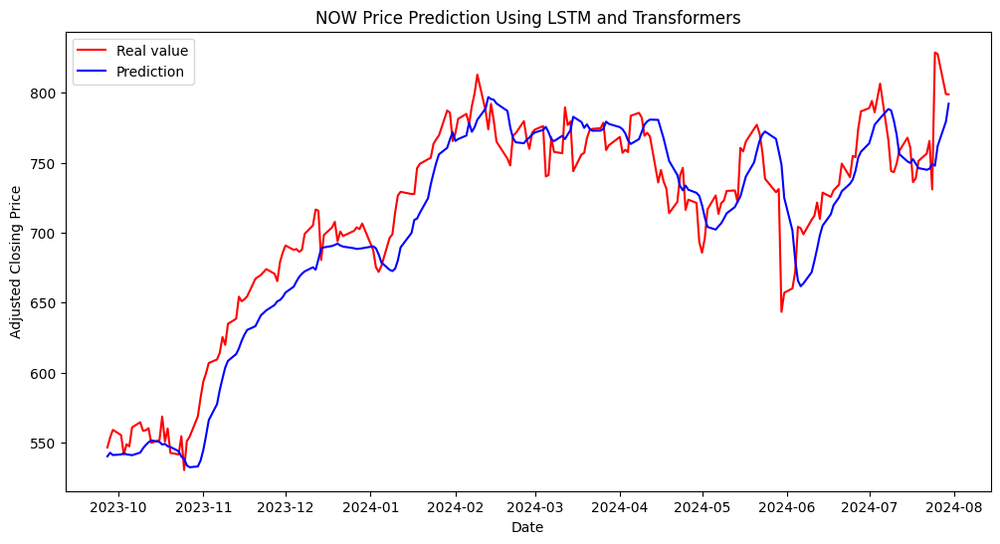

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para PANW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para PANW:
MSE: 318.01569320893026
MSE Normalizado: 0.003609726498485223
MAE: 13.349818698993698
R²: 0.7201314018967804


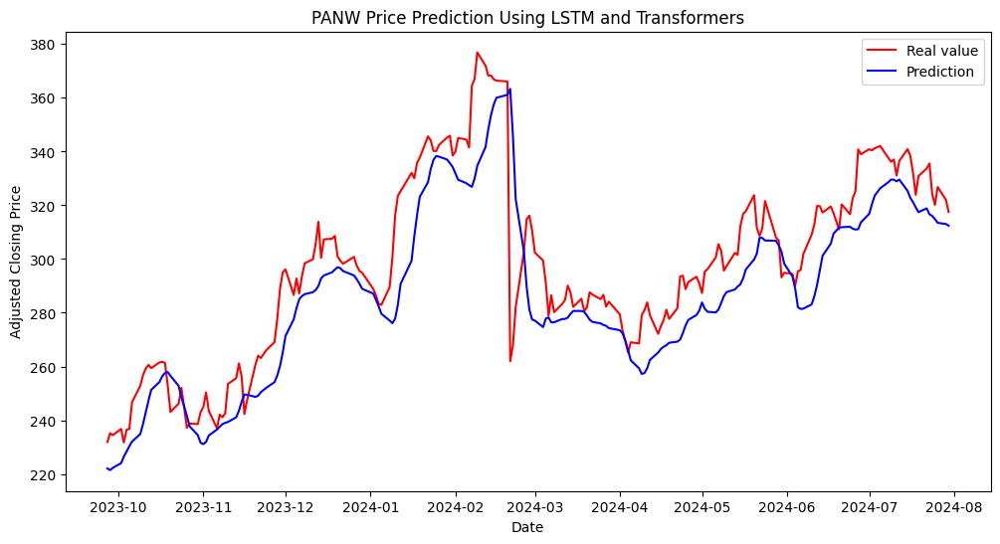

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para SNPS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para SNPS:
MSE: 610.6242216583
MSE Normalizado: 0.0020522520563953446
MAE: 19.918640855770803
R²: 0.6369093166940918


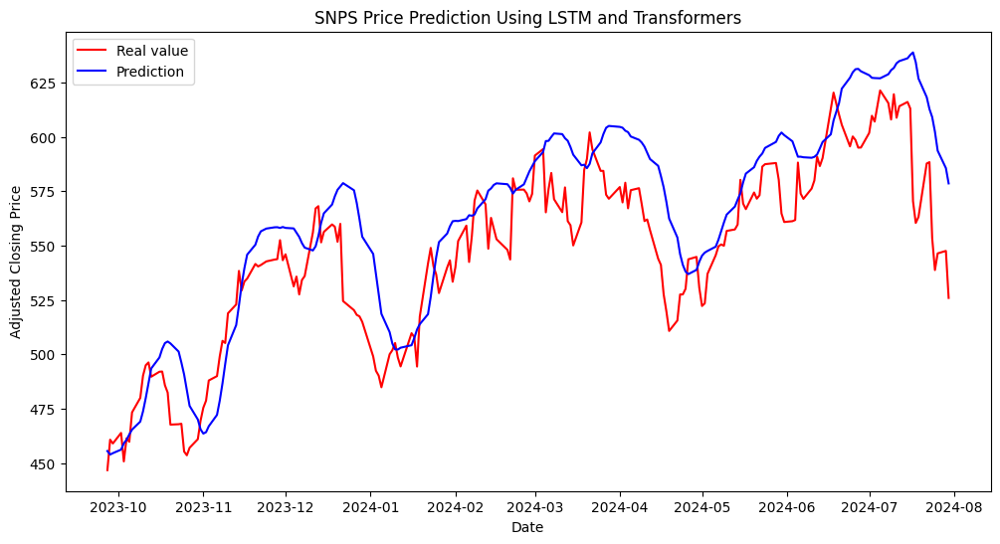

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CDNS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para CDNS:
MSE: 137.1833452572823
MSE Normalizado: 0.0017071698306632126
MAE: 8.81844827083019
R²: 0.7718061773253142


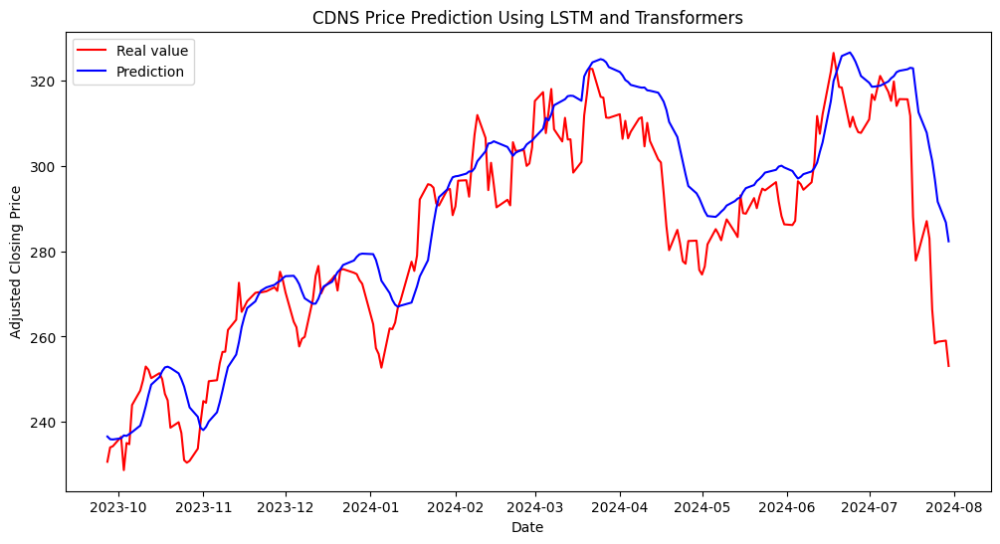

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ANET...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para ANET:
MSE: 419.5005391594944
MSE Normalizado: 0.005903623125603083
MAE: 16.511256634802585
R²: 0.8263802576666031


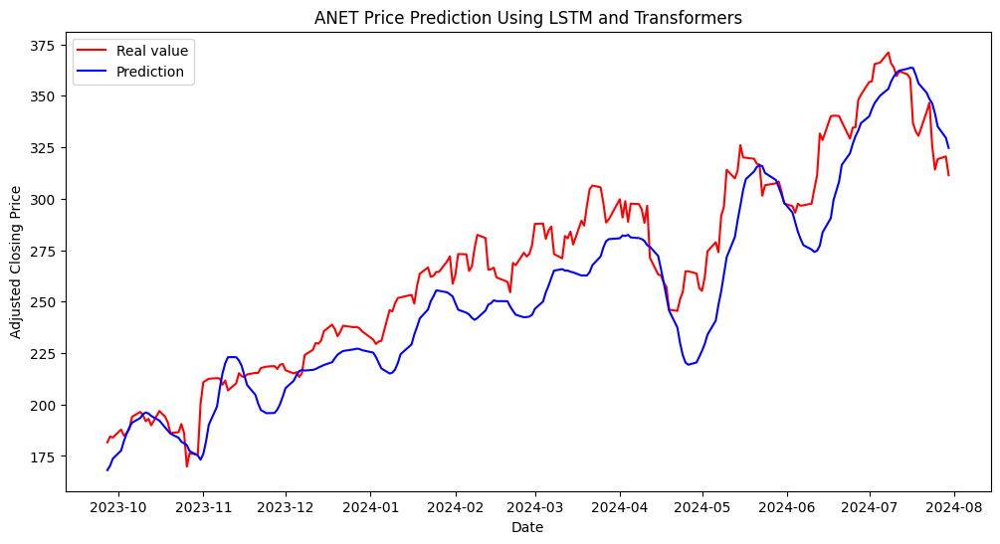

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para FTNT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para FTNT:
MSE: 4.133740423161816
MSE Normalizado: 0.0011104024904952413
MAE: 1.5601004482007774
R²: 0.8668420030131997


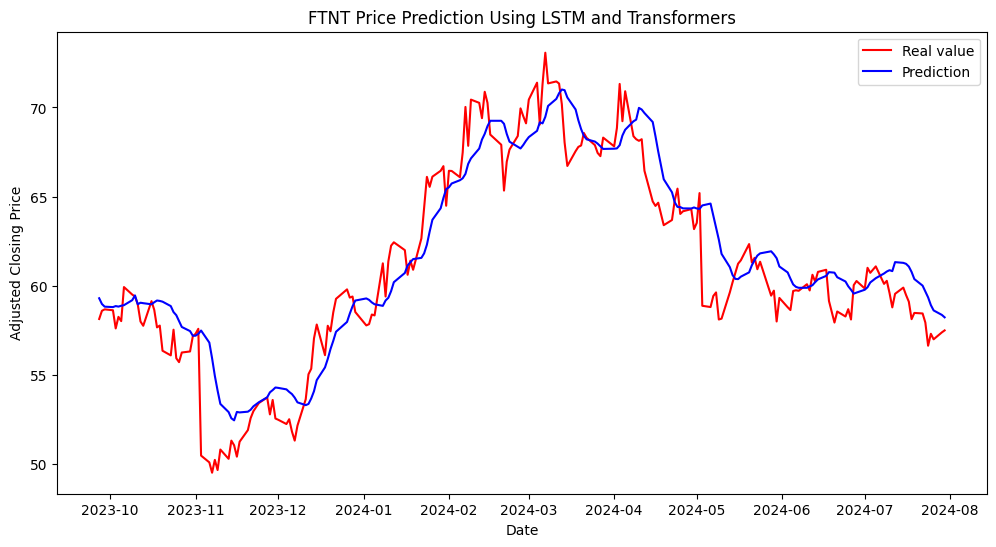

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para KLAC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para KLAC:
MSE: 9464.48900450039
MSE Normalizado: 0.02273958958053756
MAE: 77.42823946647646
R²: 0.3056443782253604


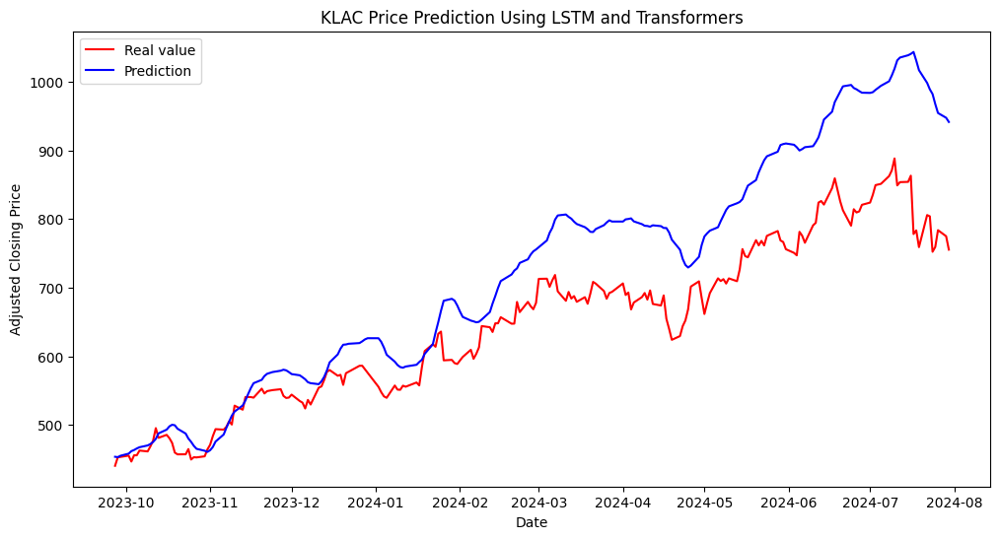

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para APH...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para APH:
MSE: 5.454562535760867
MSE Normalizado: 0.0018638043155334997
MAE: 2.019382843602251
R²: 0.9363570705195053


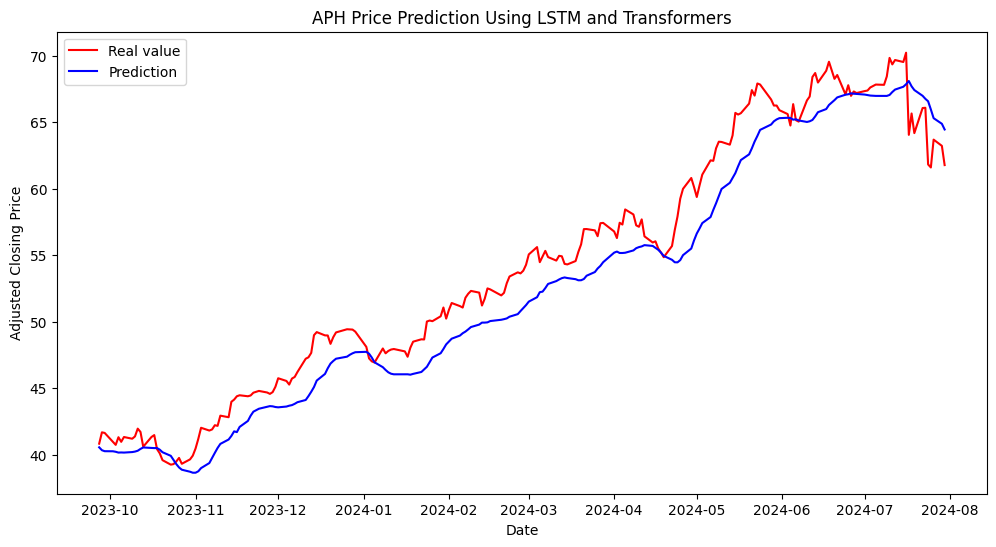

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TEL...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para TEL:
MSE: 13.31116837971741
MSE Normalizado: 0.0006957651343768573
MAE: 2.8558016999046765
R²: 0.8806411934983229


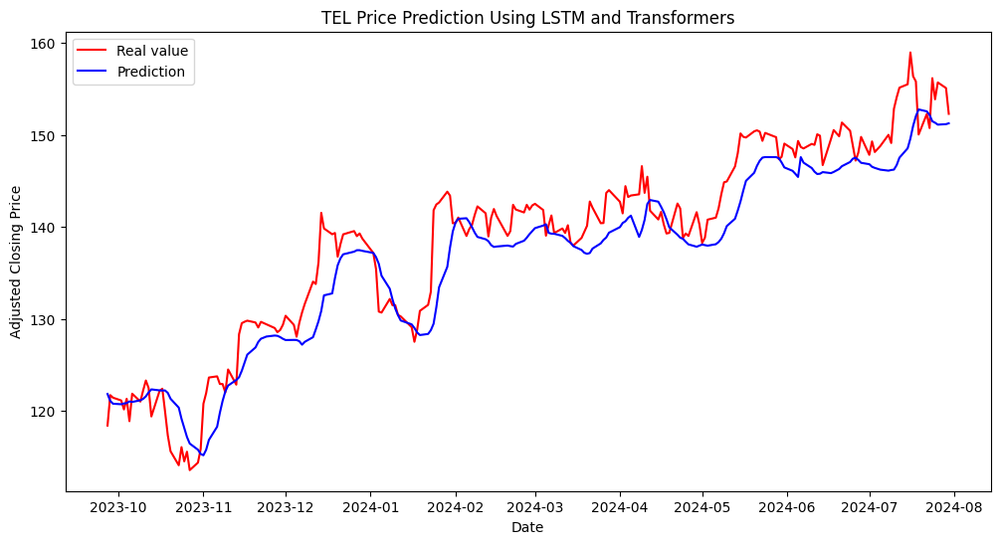

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MCHP...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para MCHP:
MSE: 5.326938388236128
MSE Normalizado: 0.0007362827316319312
MAE: 1.8134945738962736
R²: 0.8683561562315998


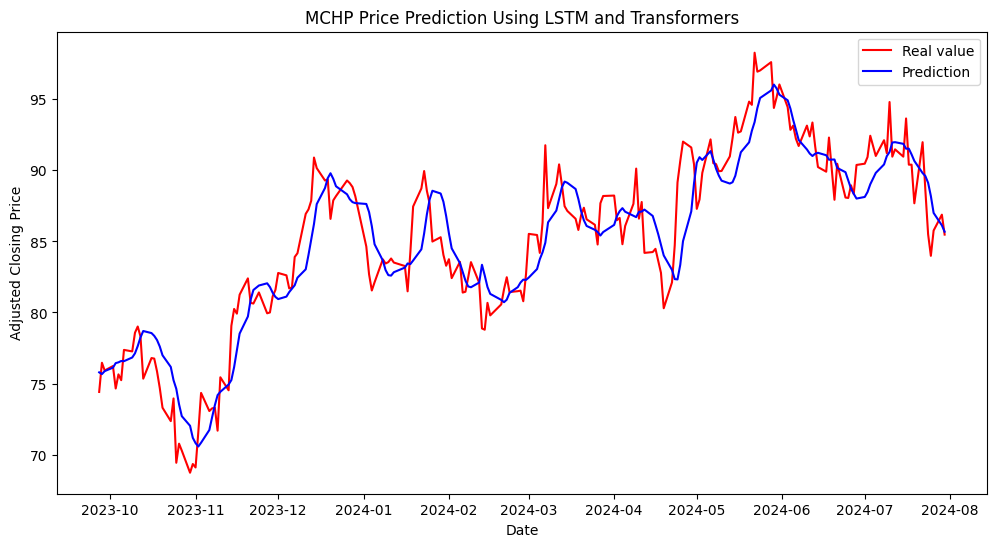

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para NXPI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para NXPI:
MSE: 59.606017772156264
MSE Normalizado: 0.0011154209958439587
MAE: 6.267838111846151
R²: 0.9365720987973056


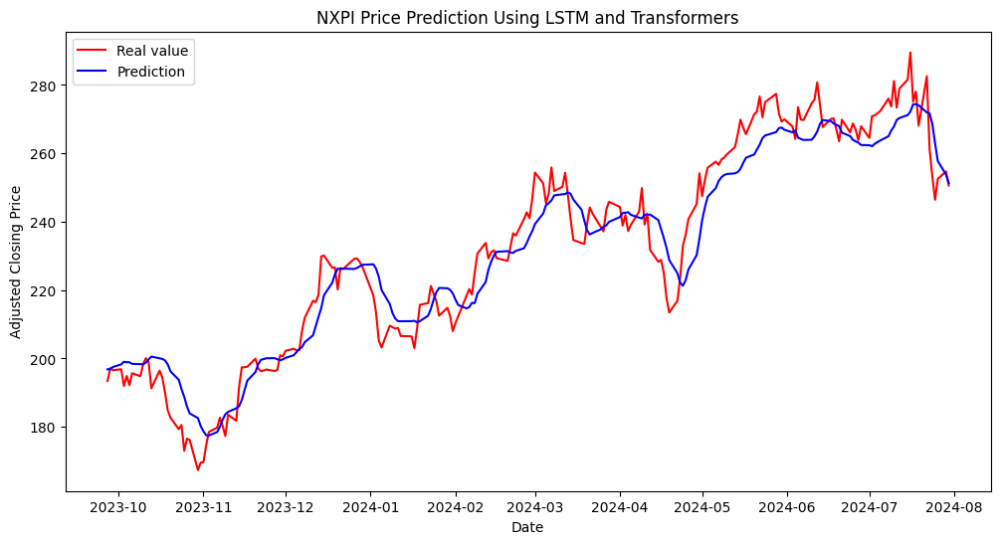

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ON...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para ON:
MSE: 12.281230853302832
MSE Normalizado: 0.002170421302411948
MAE: 2.574757266619031
R²: 0.7548185903420284


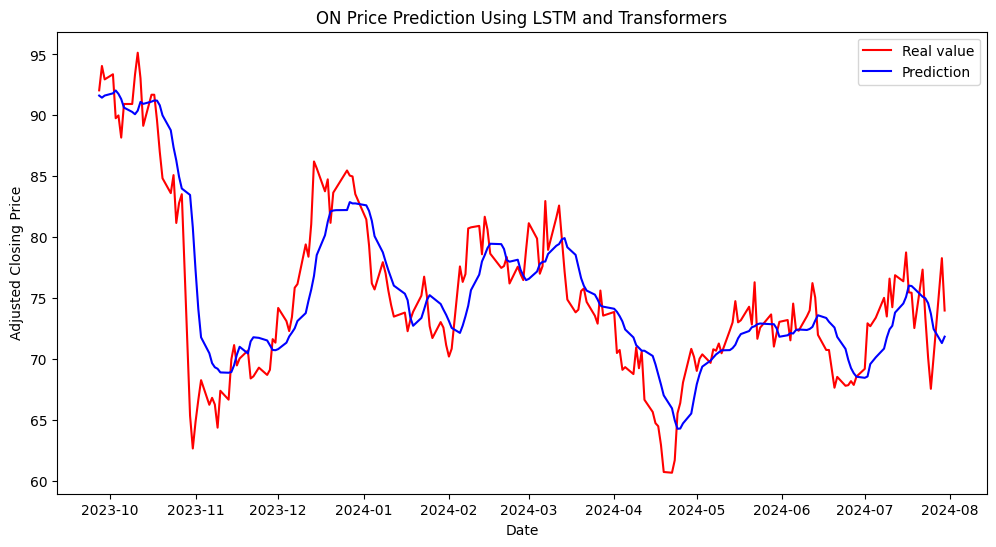

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MPWR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para MPWR:
MSE: 1720.3306069545588
MSE Normalizado: 0.00405626815550104
MAE: 33.24032214406954
R²: 0.8793855238527819


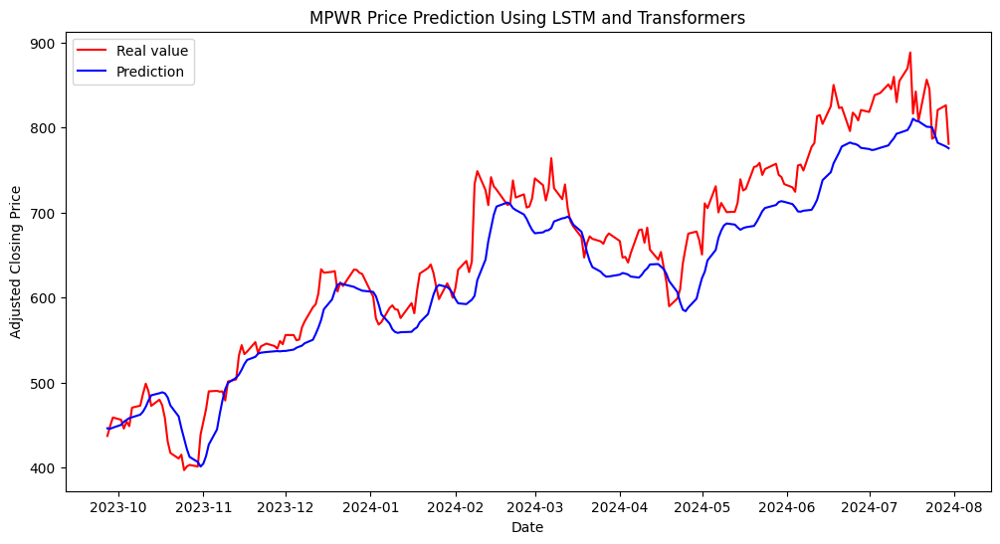

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ADI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para ADI:
MSE: 30.6141298128873
MSE Normalizado: 0.000795415255634112
MAE: 4.194969669428628
R²: 0.9370231936350878


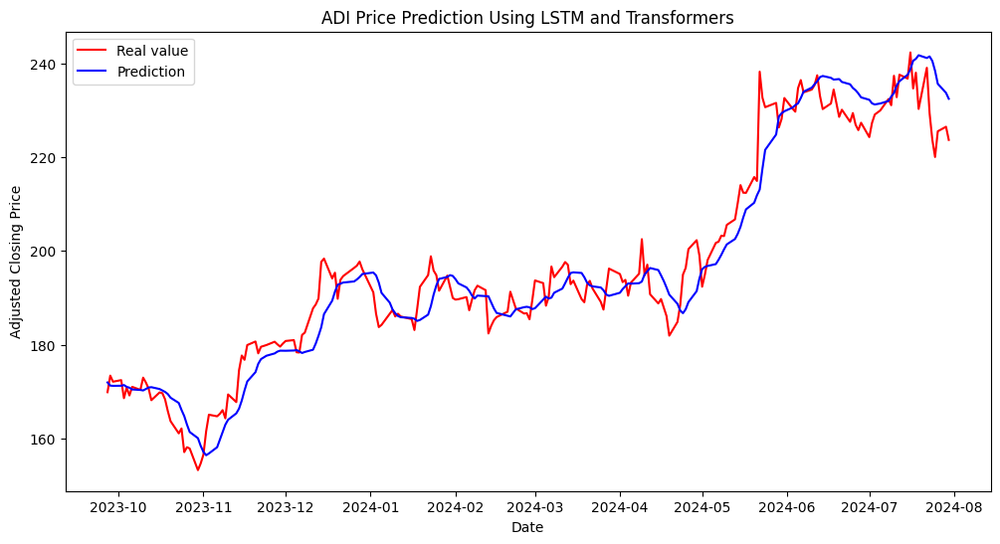

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para KEYS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para KEYS:
MSE: 15.677034164418897
MSE Normalizado: 0.0007523329465197595
MAE: 3.01982524400229
R²: 0.8752565900274678


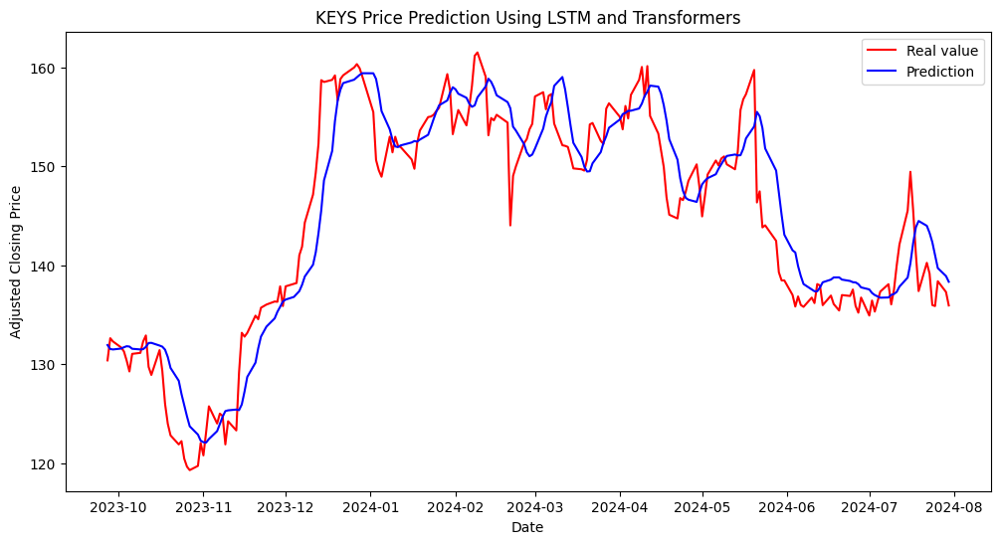

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CDW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para CDW:
MSE: 200.8264240153766
MSE Normalizado: 0.003988932188226845
MAE: 13.198050772678585
R²: 0.12185509533503014


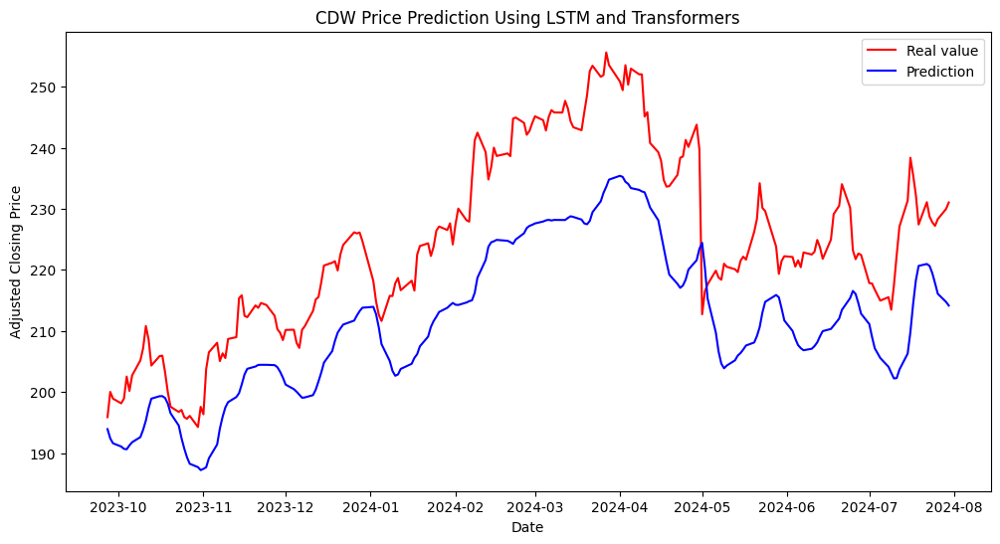

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ANSS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para ANSS:
MSE: 95.51650591528211
MSE Normalizado: 0.0009310302189383362
MAE: 6.702159675243805
R²: 0.7945715301316371


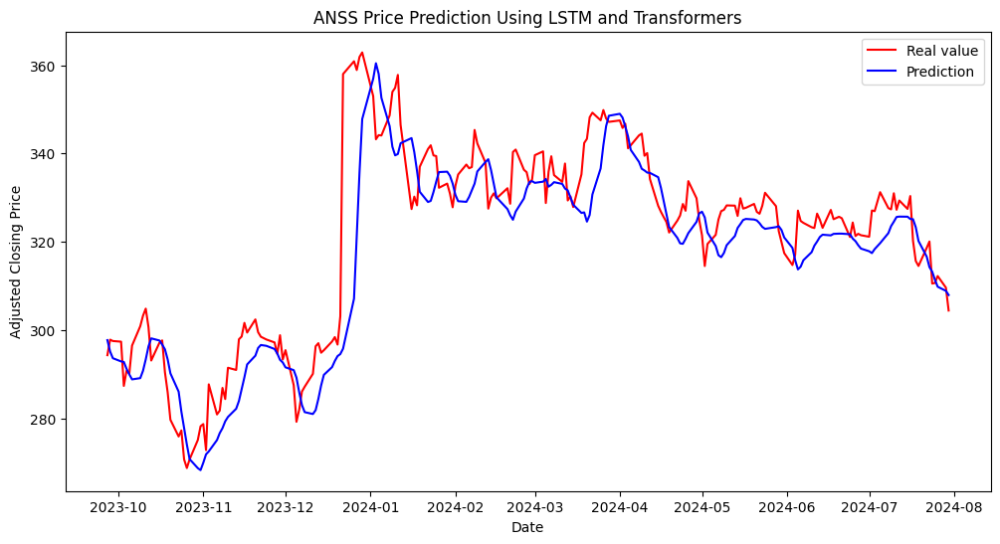

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para PAYC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para PAYC:
MSE: 315.5810413236172
MSE Normalizado: 0.009011430818860404
MAE: 14.467928709992732
R²: 0.6909509575410876


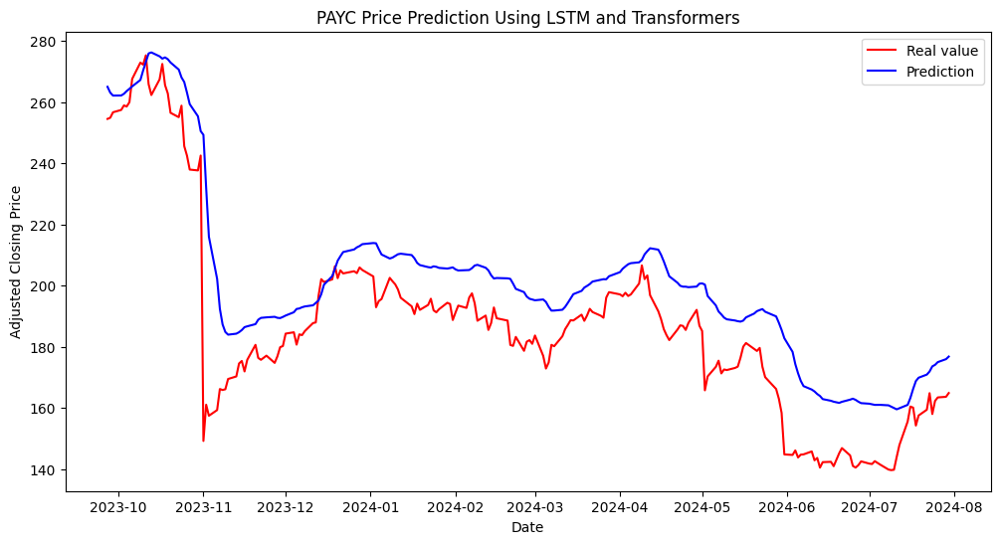

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para GDDY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para GDDY:
MSE: 29.721219075602132
MSE Normalizado: 0.0023001456714599167
MAE: 4.757969532634761
R²: 0.9368373590794224


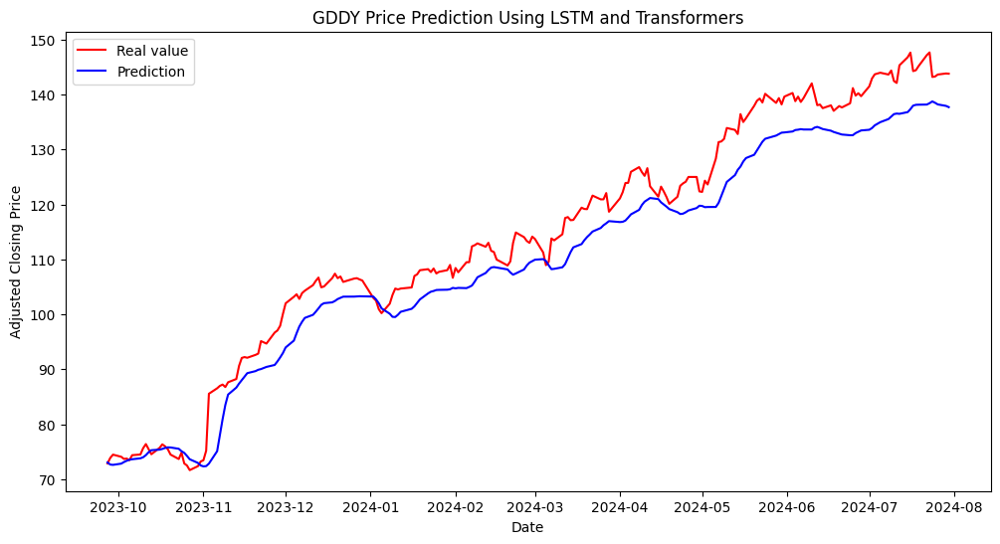

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TYL...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para TYL:
MSE: 104.54944620995364
MSE Normalizado: 0.0005435768812672462
MAE: 6.600268573604784
R²: 0.9472375901152603


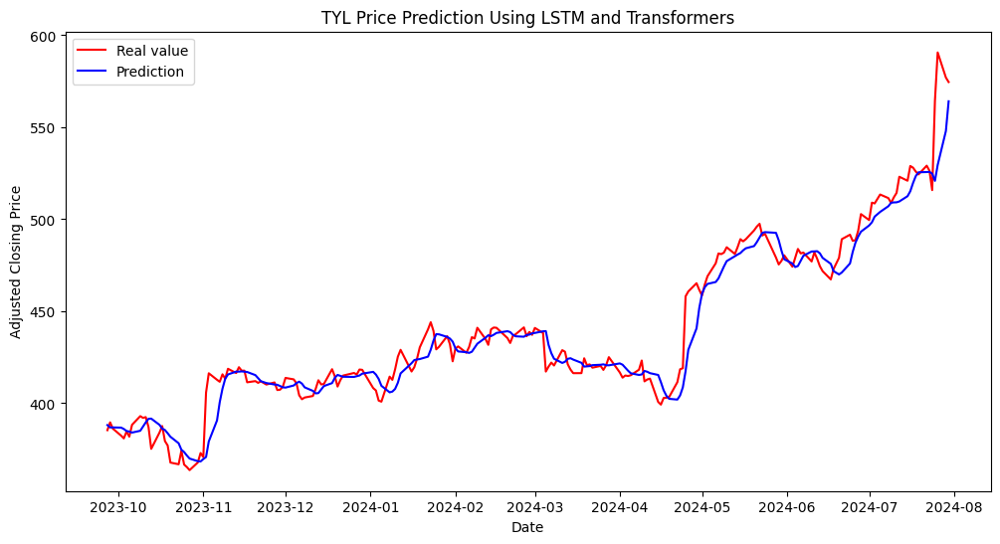

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para SSNC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para SSNC:
MSE: 1.4293940252241566
MSE Normalizado: 0.00040264062871697156
MAE: 0.8854216465856424
R²: 0.9396863804784249


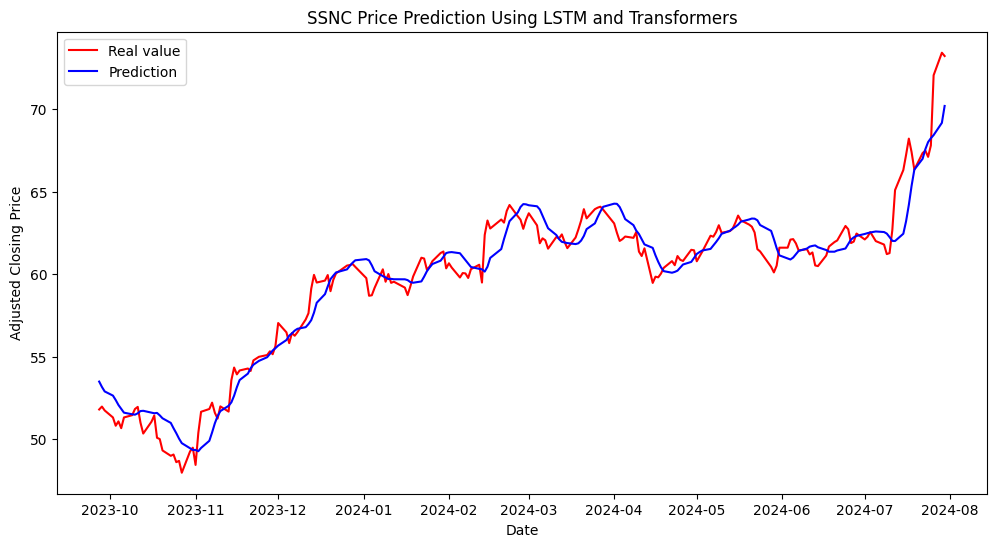

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para JKHY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para JKHY:
MSE: 6.541772532634717
MSE Normalizado: 0.00024952962299749936
MAE: 1.9951368130552707
R²: 0.9229512215415012


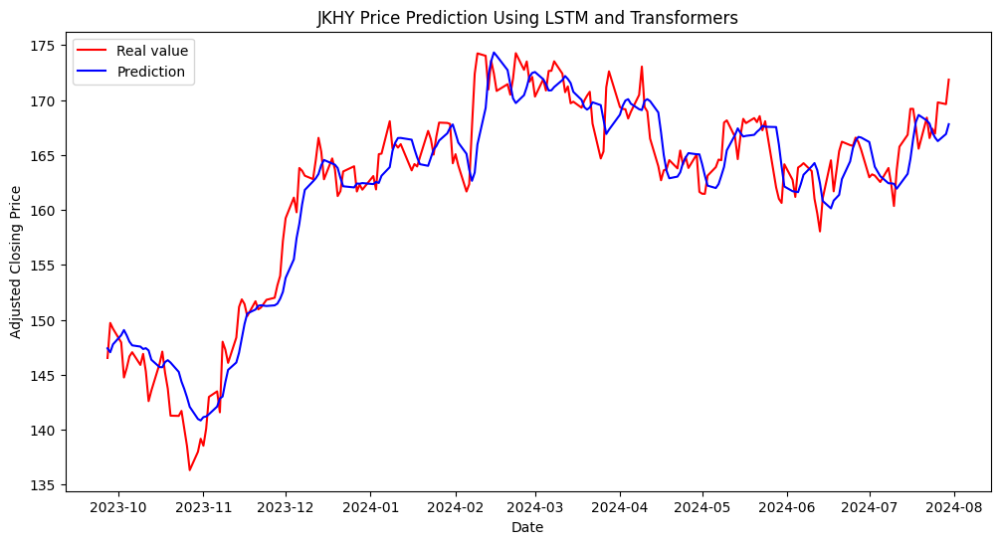

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para EPAM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para EPAM:
MSE: 132.10344061373044
MSE Normalizado: 0.0021475406249512807
MAE: 8.284488970074129
R²: 0.9289731874066252


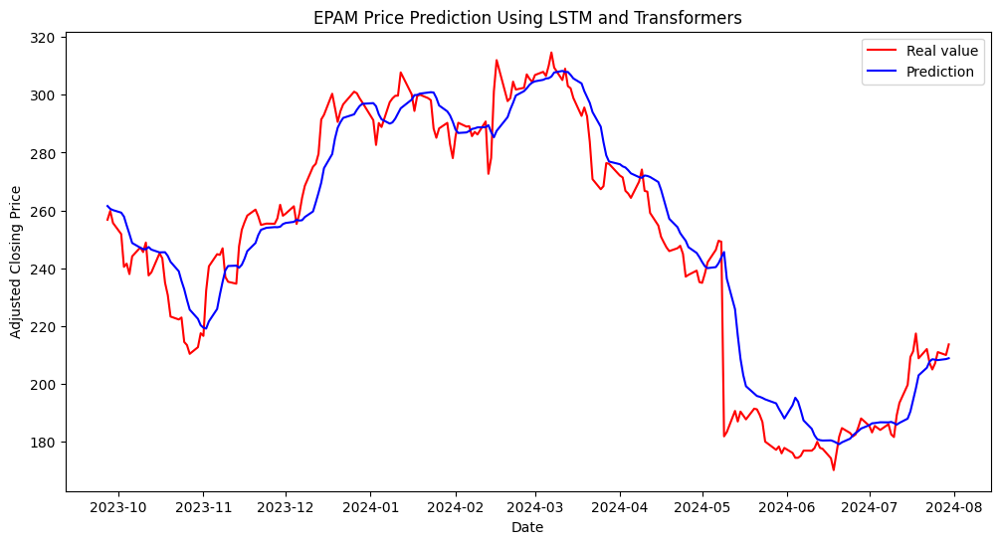

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para GLW...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para GLW:
MSE: 1.0341533187469185
MSE Normalizado: 0.001002338324408887
MAE: 0.622698413116812
R²: 0.954298757469801


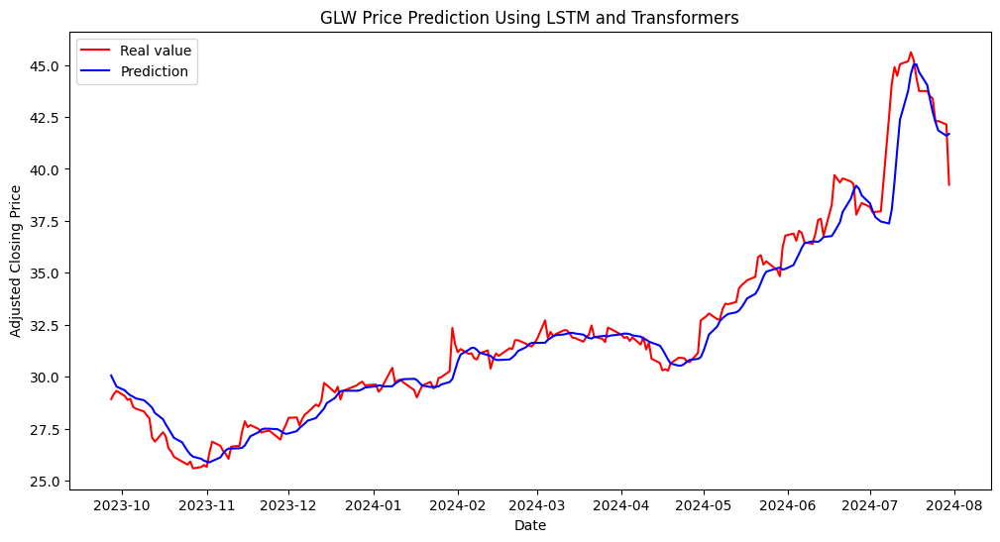

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para HPQ...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para HPQ:
MSE: 0.6253663727395966
MSE Normalizado: 0.0007089091340985353
MAE: 0.5805340646667214
R²: 0.947910417308724


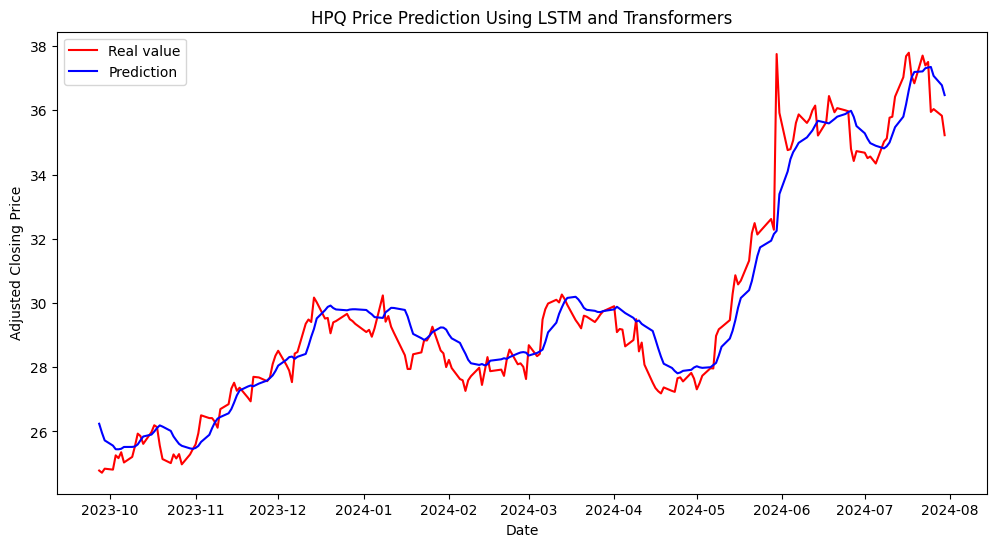

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para DXC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para DXC:
MSE: 0.6710145872318126
MSE Normalizado: 0.0015554675293197836
MAE: 0.604563511996969
R²: 0.8462668387801243


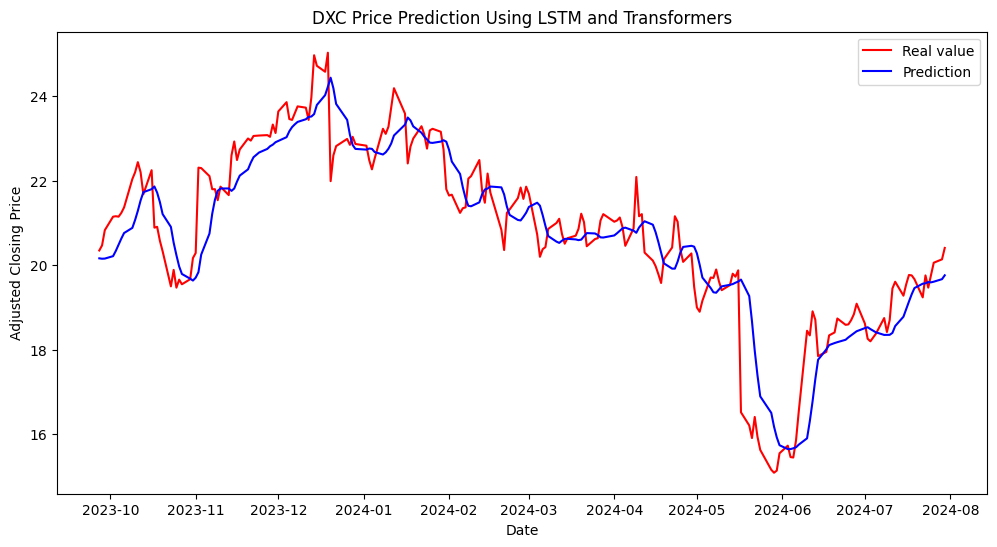

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para IT...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para IT:
MSE: 948.772778072945
MSE Normalizado: 0.004996652063559621
MAE: 28.340670153579453
R²: 0.37546517506616806


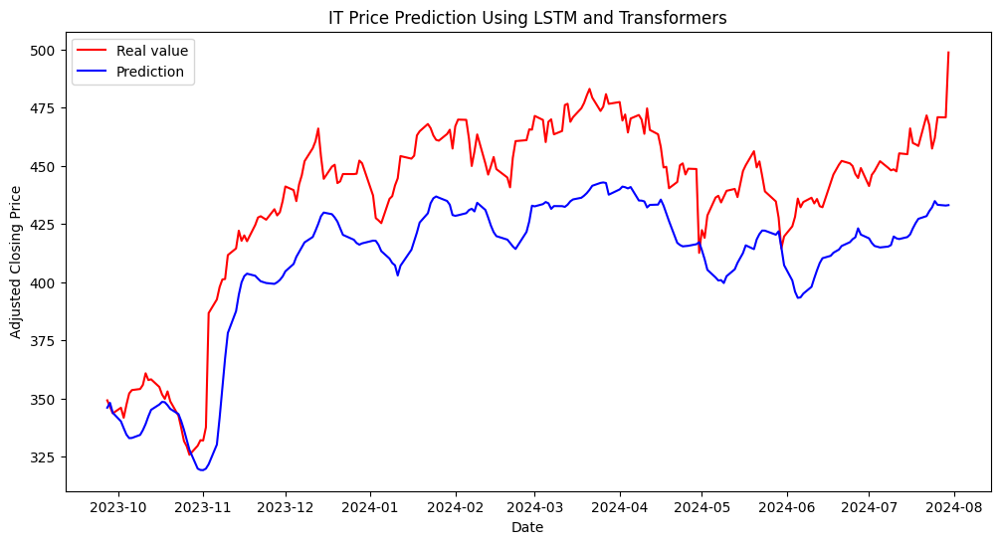

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para LDOS...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para LDOS:
MSE: 81.43496134338575
MSE Normalizado: 0.005476997023964405
MAE: 7.672929800728259
R²: 0.7800506972439971


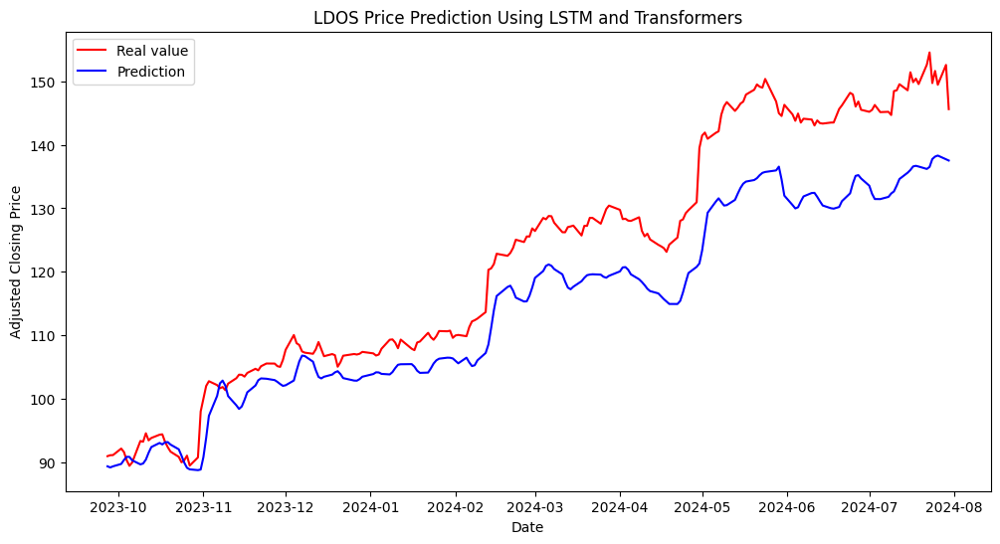

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para AKAM...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para AKAM:
MSE: 6.3109693541026965
MSE Normalizado: 0.000558072673392134
MAE: 1.9317724032815629
R²: 0.9407766073689117


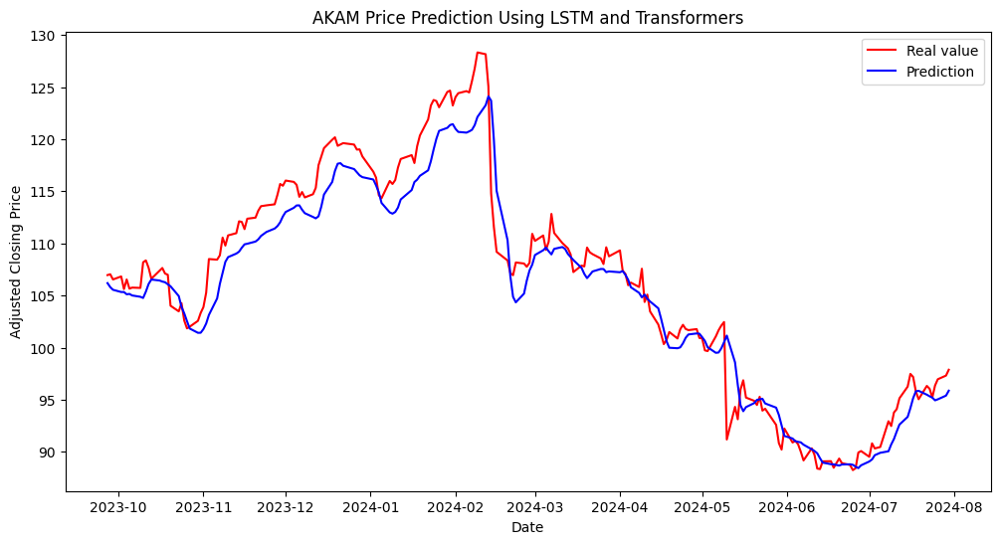

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para NTAP...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para NTAP:
MSE: 28.301536479120806
MSE Normalizado: 0.003003922715616884
MAE: 4.296018665759589
R²: 0.9145886190167936


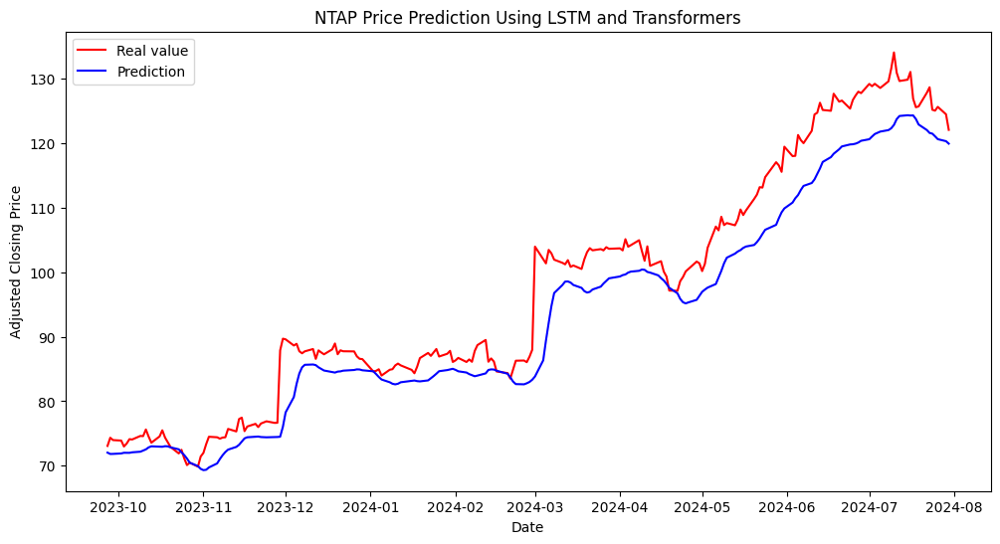

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para VRSN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para VRSN:
MSE: 14.090324409377196
MSE Normalizado: 0.0003792404962321547
MAE: 2.8960497556177667
R²: 0.9272319351126582


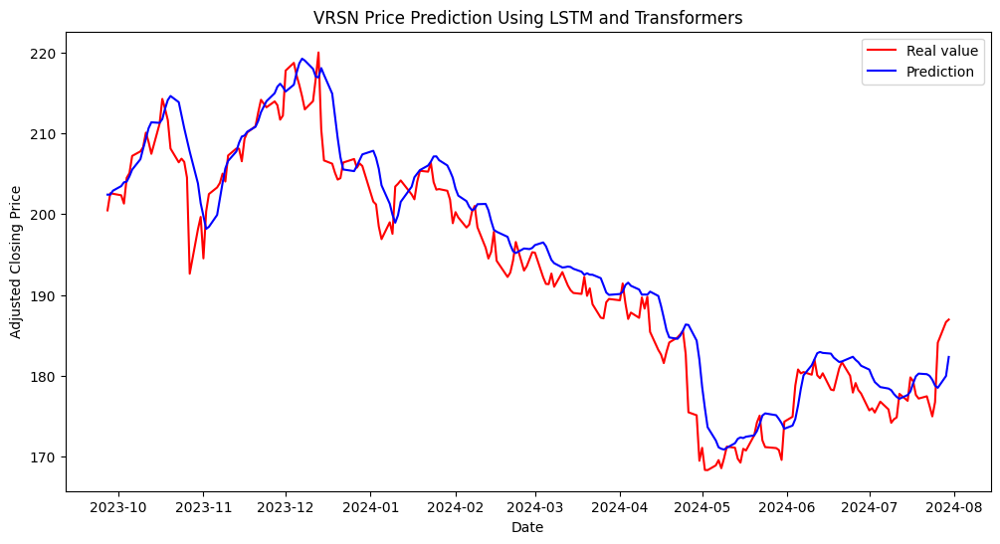

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para FFIV...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para FFIV:
MSE: 17.247082255993206
MSE Normalizado: 0.0005693042177136375
MAE: 2.8880230631064143
R²: 0.8754835641597302


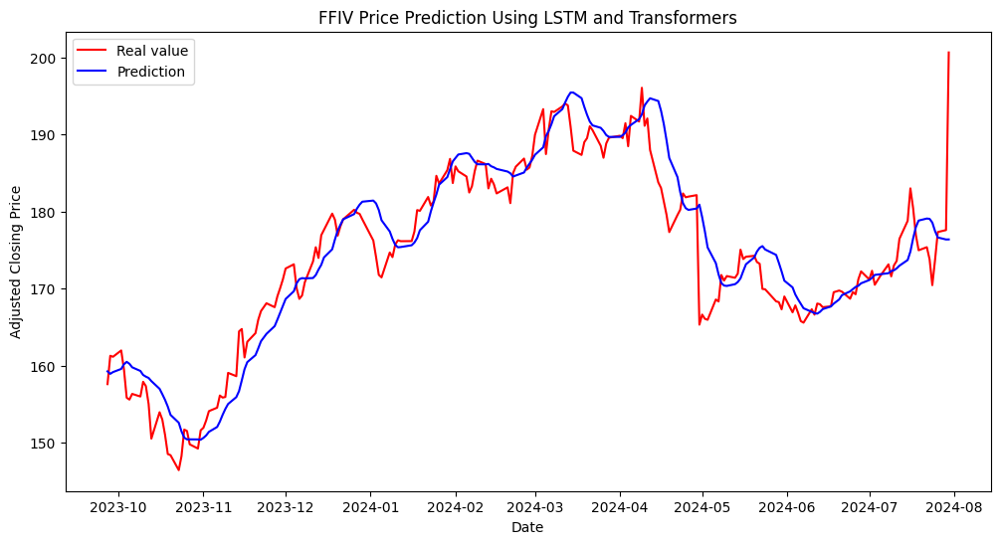

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para XRX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para XRX:
MSE: 0.46743240279517917
MSE Normalizado: 0.0022658939037786163
MAE: 0.5001783865156466
R²: 0.8982825662789943


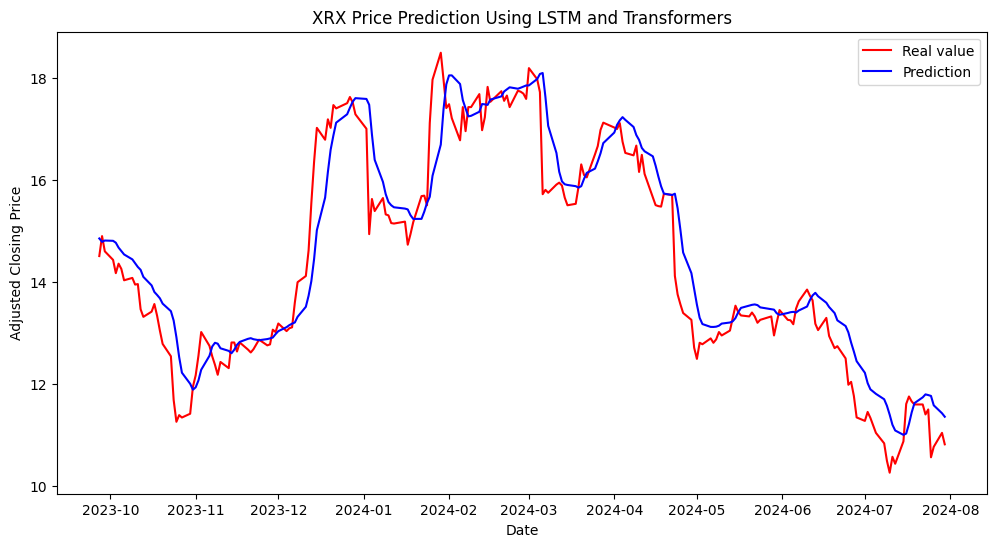

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para JNPR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para JNPR:
MSE: 1.0011943168573383
MSE Normalizado: 0.0009214991196364608
MAE: 0.6656186637352465
R²: 0.947863452538194


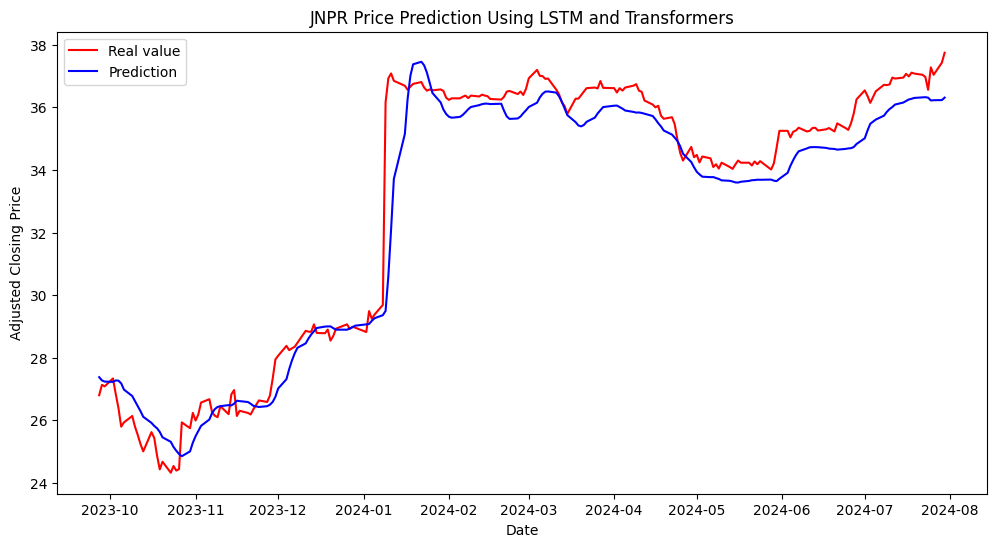

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CSGP...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para CSGP:
MSE: 4.255461007460396
MSE Normalizado: 0.0006185861470059474
MAE: 1.5845578828982603
R²: 0.8973090930228662


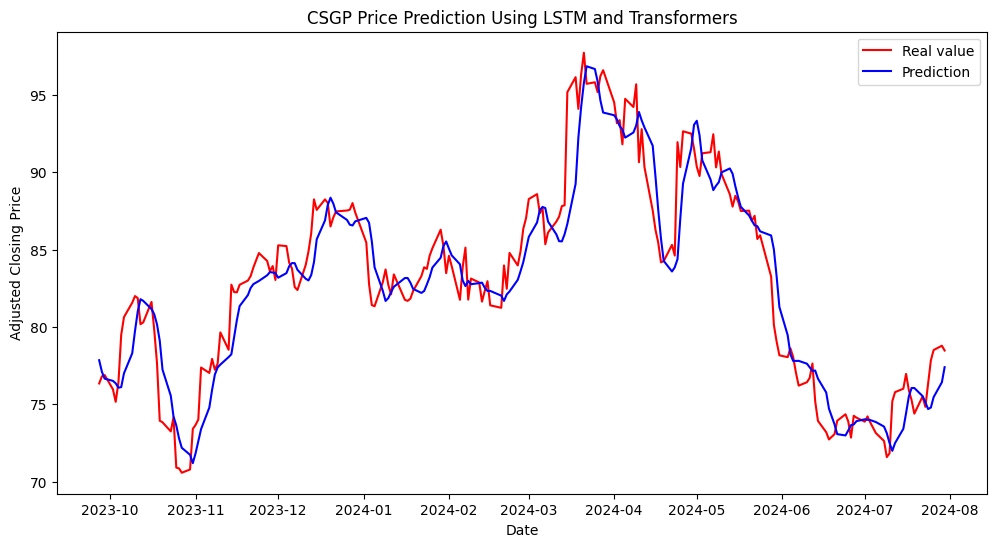

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para GRMN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para GRMN:
MSE: 15.759841942453061
MSE Normalizado: 0.0008461703870776616
MAE: 2.6031207004265906
R²: 0.9678410350684022


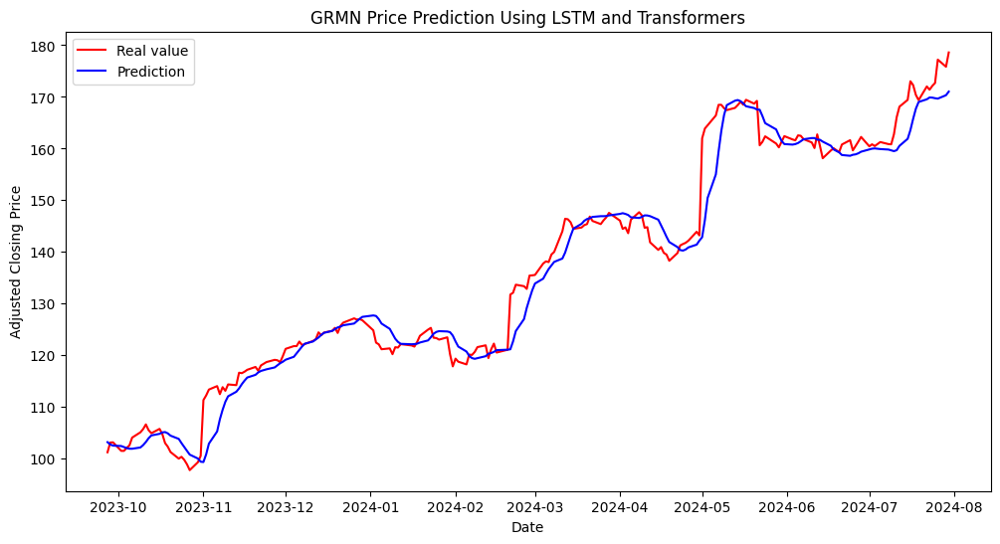

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para ZBRA...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para ZBRA:
MSE: 91.54346441721081
MSE Normalizado: 0.0012388506244267695
MAE: 7.433487954808941
R²: 0.9386935274277125


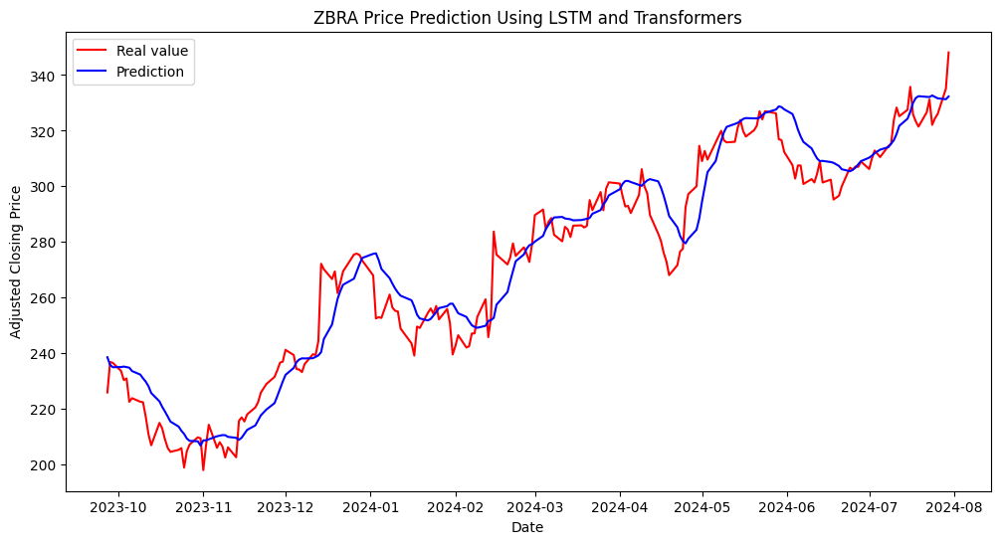

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para BR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para BR:
MSE: 17.885267441396856
MSE Normalizado: 0.00047782292250550247
MAE: 3.312817559755683
R²: 0.8349175890291372


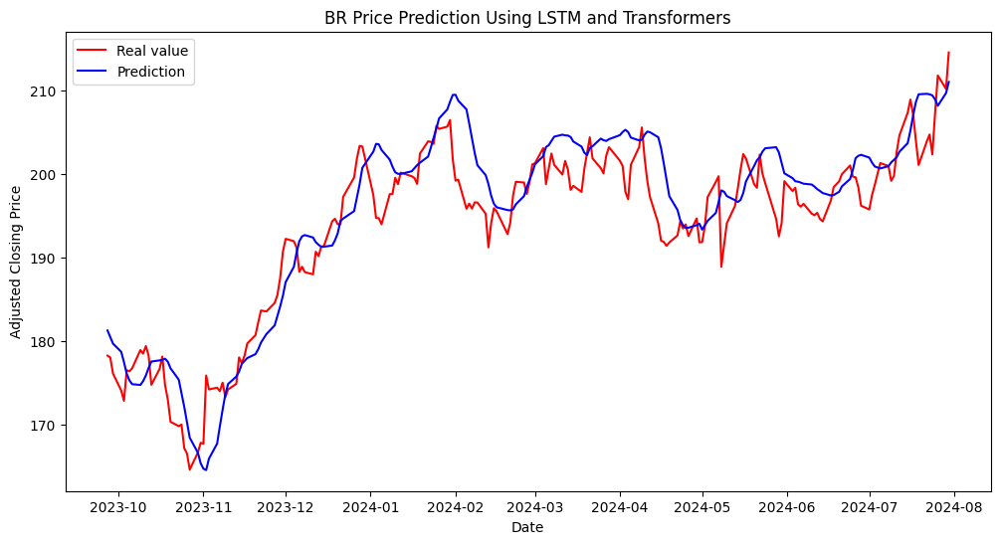

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para VRSN...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para VRSN:
MSE: 10.653243663016955
MSE Normalizado: 0.0002867316107041417
MAE: 2.5481550711067795
R²: 0.9449823933354459


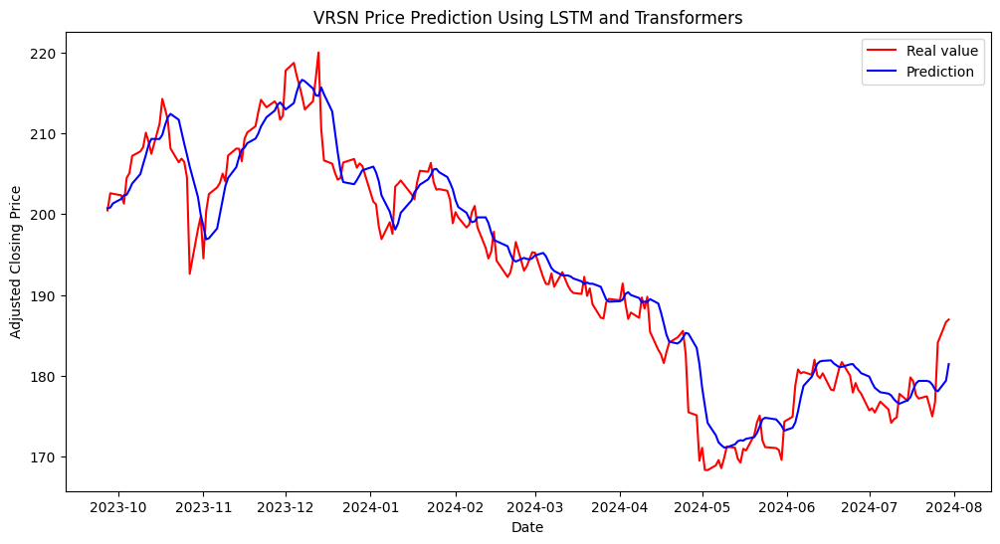

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para PTC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para PTC:
MSE: 12.472171677659679
MSE Normalizado: 0.0004256462175485466
MAE: 2.978827209495432
R²: 0.9436676502041877


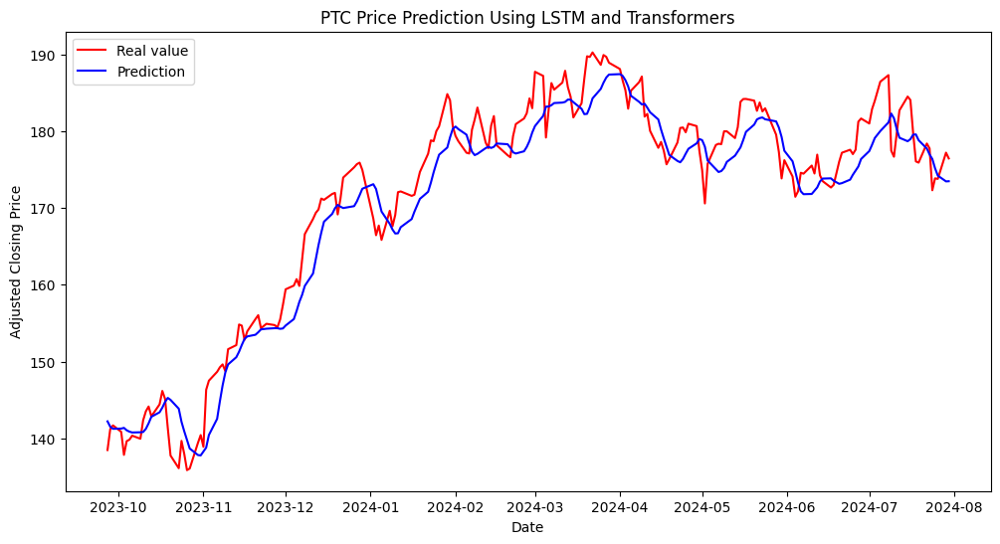

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para CTSH...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para CTSH:
MSE: 2.6656259813552983
MSE Normalizado: 0.0005425847824930845
MAE: 1.3803690471612597
R²: 0.8655796561426856


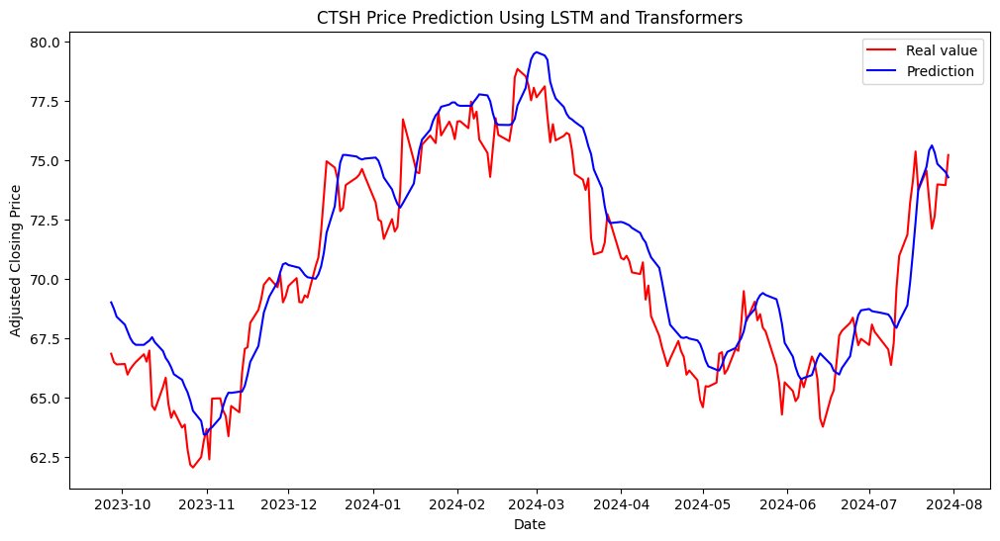

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para HPE...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para HPE:
MSE: 0.47910628722130333
MSE Normalizado: 0.0016467091559368805
MAE: 0.5063111466287274
R²: 0.8691063587015013


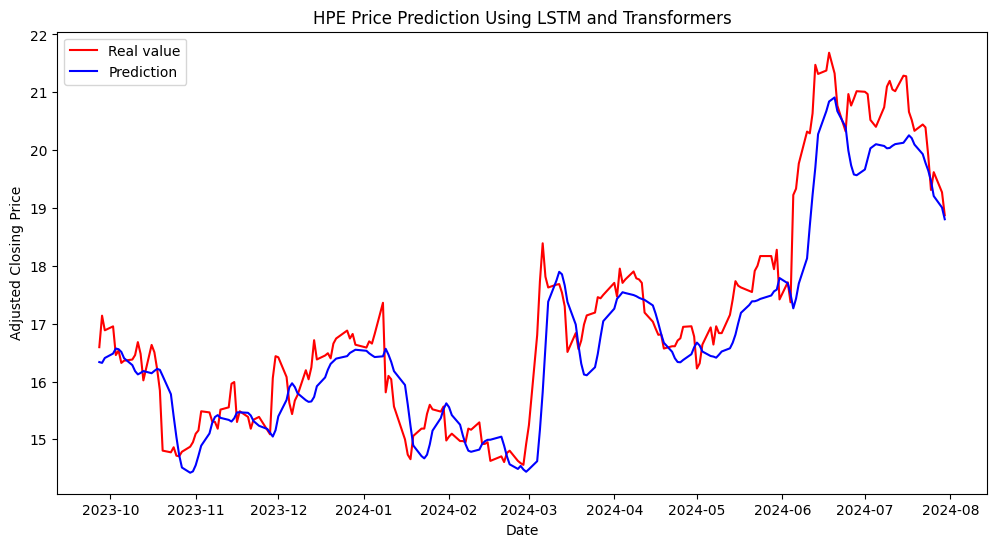

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para JNPR...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para JNPR:
MSE: 1.101600898939188
MSE Normalizado: 0.001013913324787522
MAE: 0.759491433694642
R²: 0.9426348446205823


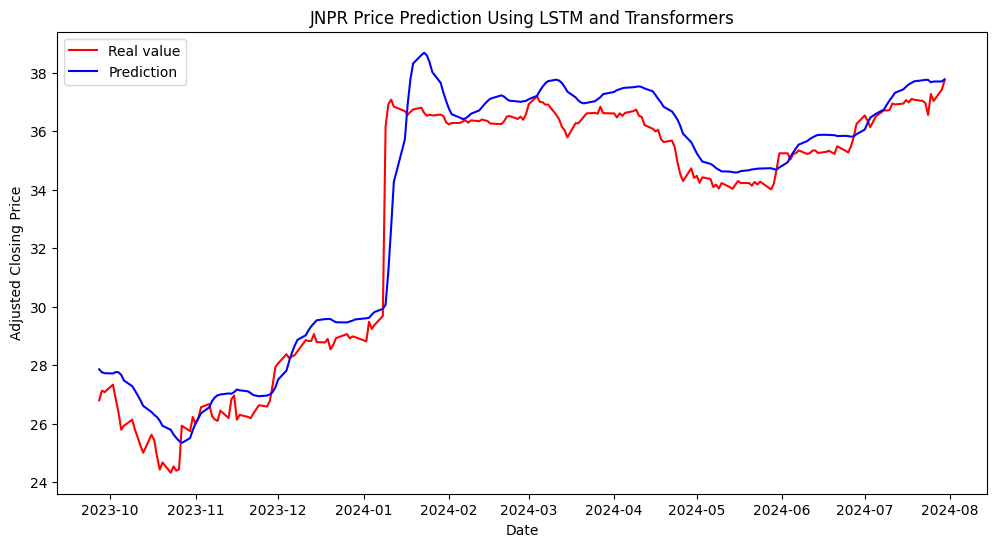

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para MSI...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para MSI:
MSE: 170.18875962895626
MSE Normalizado: 0.0015262828019457749
MAE: 10.651967209753751
R²: 0.8510240780512099


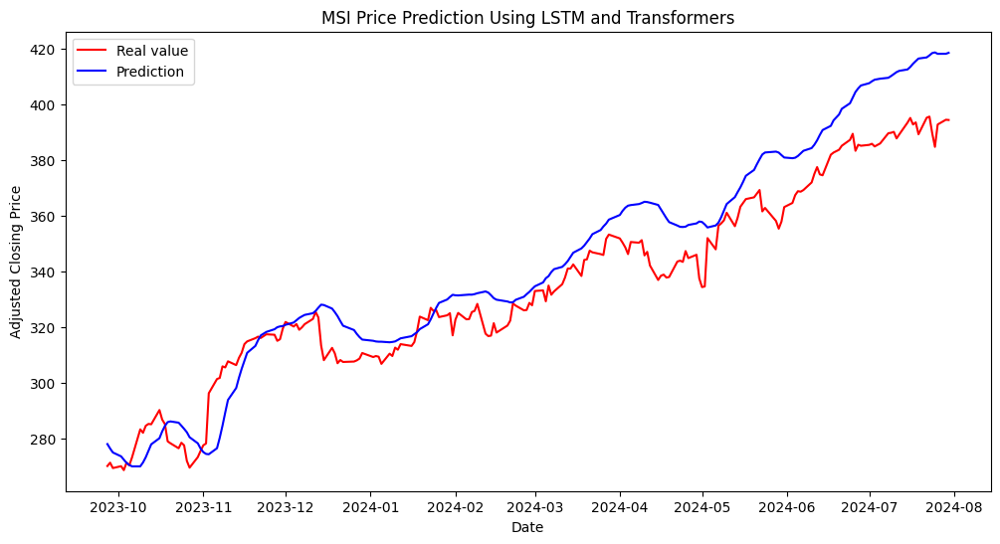

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para TDY...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para TDY:
MSE: 81.2567721112878
MSE Normalizado: 0.0004891612158952206
MAE: 6.757710765508992
R²: 0.7848958961632142


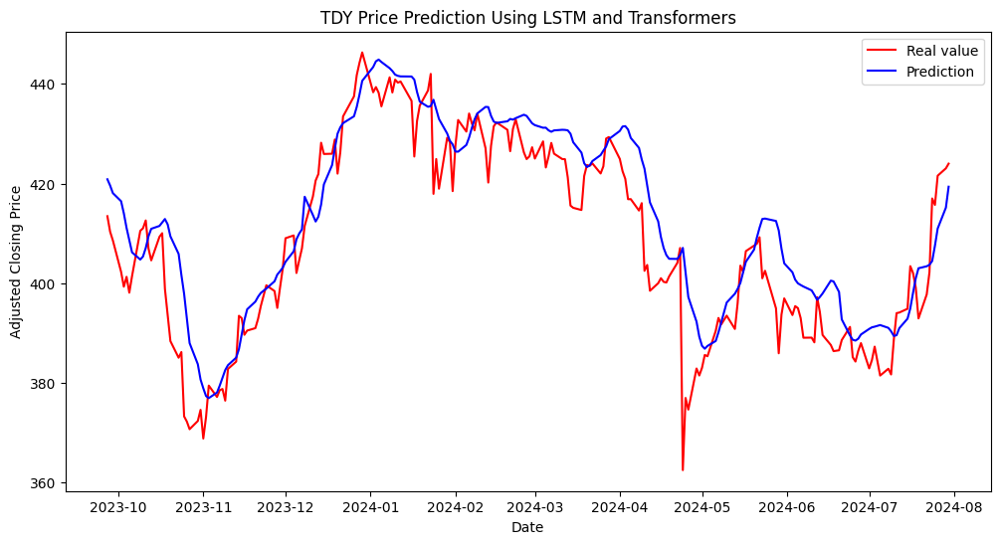

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para WDC...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para WDC:
MSE: 4.461013434739598
MSE Normalizado: 0.0012191777868176578
MAE: 1.6782306841081085
R²: 0.9699793793556454


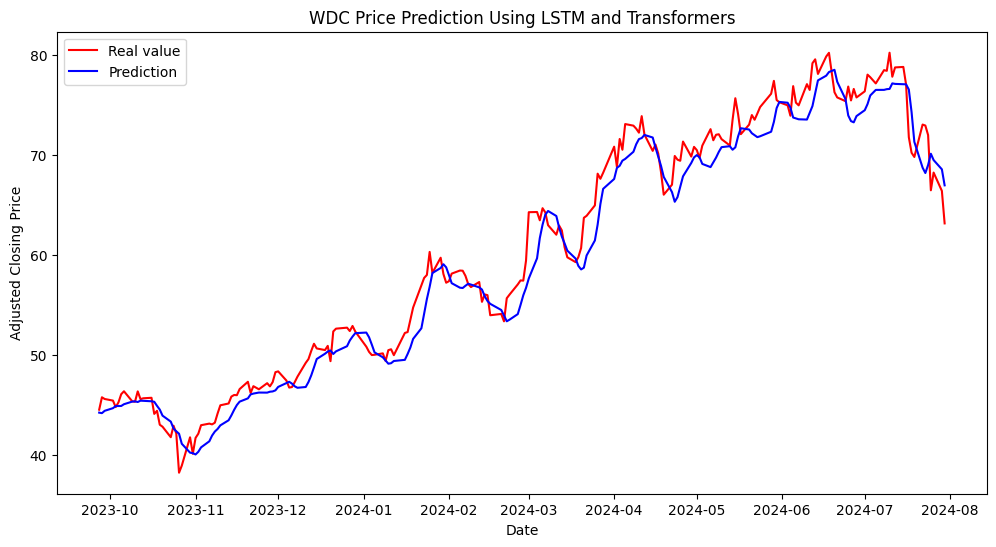

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
/usr/local/lib/python3.10/dist-packages/pytorch_lightning/trainer/configuration_validator.py:70: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
INFO:pytorch_lightning.callbacks.model_summary:
  | Name      | Type    | Params | Mode 
----------------------------------------------
0 | lstm      | LSTM    | 43.2 K | train
1 | linear    | Linear  | 101    | train
2 | criterion | MSELoss | 0      | train
----------------------------------------------
43.3 K    Trainable params
0         Non-trainable params
43.3 K    Total params
0.173     Total estimated model params size (MB)
3         Modules in train mode
0         Modules in eval mode



Entrenando modelo para STX...


Training: |          | 0/? [00:00<?, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.


Métricas para STX:
MSE: 5.389004991785045
MSE Normalizado: 0.000740007619741126
MAE: 1.8557222814029093
R²: 0.9606500901728544


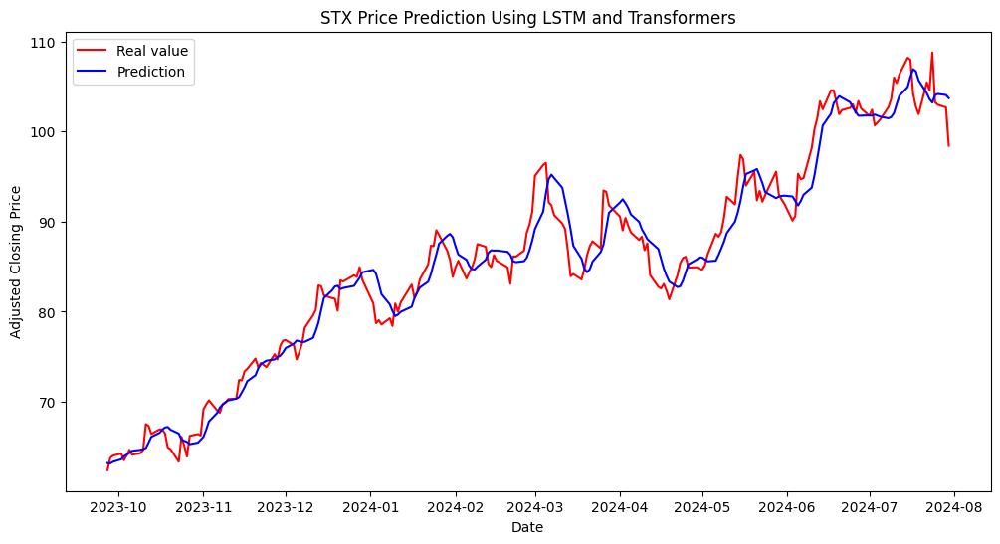


Métricas de Rendimiento:
   ticker         mse  mse_normalizado        mae        r2
0    AAPL   30.830613         0.000878   4.306886  0.887606
1    MSFT  100.792252         0.000643   8.123468  0.926822
2    NVDA  528.980374         0.087545  17.557076  0.366428
3    AVGO   81.657013         0.005466   6.380782  0.872786
4     CRM   49.862793         0.000748   4.720979  0.952342
..    ...         ...              ...        ...       ...
59   JNPR    1.101601         0.001014   0.759491  0.942635
60    MSI  170.188760         0.001526  10.651967  0.851024
61    TDY   81.256772         0.000489   6.757711  0.784896
62    WDC    4.461013         0.001219   1.678231  0.969979
63    STX    5.389005         0.000740   1.855722  0.960650

[64 rows x 5 columns]


In [15]:
def train_and_evaluate_model(ticker):
    print(f"\nEntrenando modelo para {ticker}...")
    features = ['Adj Close', 'MA_10', 'MA_30', 'MA_60', 'sentimiento_reddit', 'sentimiento_noticias']

    # Preparar los datos
    X_train, Y_train, X_val, Y_val, scaler, dates = preparar_datos_lstm(stock_data, ticker, features)

    # Convertir a tensores y mover al dispositivo
    X_train_tensor = torch.tensor(X_train, dtype=torch.float32).to(device)
    Y_train_tensor = torch.tensor(Y_train, dtype=torch.float32).unsqueeze(1).to(device)
    X_val_tensor = torch.tensor(X_val, dtype=torch.float32).to(device)
    Y_val_tensor = torch.tensor(Y_val, dtype=torch.float32).unsqueeze(1).to(device)

    # Crear DataLoader
    train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

    # Instanciar el modelo
    model = LSTMModel(input_size=len(features)).to(device)

    # Entrenar el modelo
    trainer = pl.Trainer(max_epochs=20, logger=False, enable_checkpointing=False)
    trainer.fit(model, train_loader)

    # Realizar predicciones
    model.eval()
    with torch.no_grad():
        predictions = model(X_val_tensor).cpu().numpy()

    # Desescalar las predicciones y los valores reales
    predictions_extended = np.concatenate([predictions, np.zeros((predictions.shape[0], len(features)-1))], axis=1)
    predictions_descaled = scaler.inverse_transform(predictions_extended)[:, 0]

    Y_val_extended = np.concatenate([Y_val.reshape(-1, 1), np.zeros((Y_val.shape[0], len(features)-1))], axis=1)
    Y_val_descaled = scaler.inverse_transform(Y_val_extended)[:, 0]

    # Calcular métricas
    mse = mean_squared_error(Y_val_descaled, predictions_descaled)
    mae = mean_absolute_error(Y_val_descaled, predictions_descaled)
    r2 = r2_score(Y_val_descaled, predictions_descaled)

    # Calcular MSE normalizado
    precio_promedio_validacion = np.mean(Y_val_descaled)
    mse_normalizado = mse / (precio_promedio_validacion ** 2)

    print(f"Métricas para {ticker}:")
    print(f"MSE: {mse}")
    print(f"MSE Normalizado: {mse_normalizado}")
    print(f"MAE: {mae}")
    print(f"R²: {r2}")

    # Graficar resultados
    plt.figure(figsize=(12, 6))
    plt.plot(dates, Y_val_descaled, color='red', label='Real value')
    plt.plot(dates, predictions_descaled, color='blue', label='Prediction')
    plt.title(f"{ticker} Price Prediction Using LSTM and Transformers")
    plt.xlabel('Date')
    plt.ylabel('Adjusted Closing Price')
    plt.legend()
    plt.show()

    # Retornar métricas
    return {
        'ticker': ticker,
        'mse': mse,
        'mse_normalizado': mse_normalizado,
        'mae': mae,
        'r2': r2
    }

# Agregar sentimiento de noticias al conjunto de datos
stock_data = agregar_sentimiento_noticias(stock_data)

# Lista para almacenar los resultados
results = []

for ticker in tickers:
    result = train_and_evaluate_model(ticker)
    results.append(result)

# Crear un DataFrame con las métricas
metrics_df = pd.DataFrame(results)

print("\nMétricas de Rendimiento:")
print(metrics_df)


# Optimización y Comparación del Portafolio

En esta sección, se optimiza un portafolio utilizando las predicciones de los modelos entrenados y se compara su desempeño con los índices **XLK** (sector tecnológico) y **S&P 500**.

## Proceso de Optimización del Portafolio
1. **Predicciones del Modelo**:
   - Se utilizan las predicciones generadas por los modelos para calcular los retornos esperados de las acciones seleccionadas.
2. **Cálculo del Ratio de Sharpe**:
   - El Ratio de Sharpe es la métrica principal para la optimización:

$\text{Sharpe Ratio} = \frac{\mathbb{E}[R_p] - R_f}{\sigma_p}$

Donde:
- $\mathbb{E}[R_p]$: Retorno esperado del portafolio.
- $R_f$: Tasa libre de riesgo.
- $\sigma_p$: Volatilidad del portafolio (desviación estándar de los retornos).


- **Retornos esperados**: Se calculan utilizando las predicciones de los modelos.
- **Volatilidad**: Basada en la matriz de covarianza de los retornos históricos.
- **Restricciones**: La suma de las ponderaciones debe ser igual a 1.
- Las ponderaciones individuales no pueden ser negativas (long-only portfolio).

Rendimientos esperados diarios:
AAPL    0.001129
MSFT    0.001492
NVDA    0.006003
AVGO    0.004162
ORCL    0.001355
AMD     0.001688
ACN     0.000357
ADBE    0.000269
TXN     0.001089
IBM     0.001400
QCOM    0.002430
INTU    0.000932
AMAT    0.001880
MU      0.002319
LRCX    0.001919
NOW     0.001733
PANW    0.002238
SNPS    0.001346
CDNS    0.000624
ANET    0.003892
KLAC    0.003661
APH     0.001938
TEL     0.001058
MCHP    0.000587
NXPI    0.001579
MPWR    0.002557
ADI     0.001230
KEYS    0.000250
CDW     0.000514
ANSS    0.000179
GDDY    0.003103
TYL     0.001851
SSNC    0.001291
JKHY    0.000654
GLW     0.001587
HPQ     0.001634
IT      0.001251
LDOS    0.002455
NTAP    0.002563
FFIV    0.000463
JNPR    0.001347
CSGP    0.000013
TRMB    0.000450
GRMN    0.002426
ZBRA    0.001563
BR      0.000575
PTC     0.000989
CTSH    0.000360
HPE     0.000766
MSI     0.001583
WDC     0.002107
STX     0.002379
dtype: float64

Matriz de covarianza diaria:
              AAPL          MSFT      N

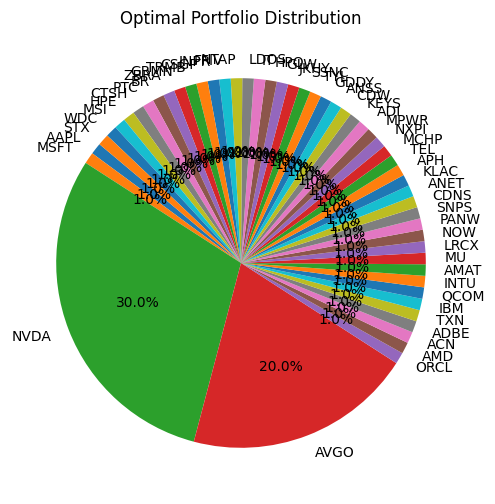

In [26]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import minimize

# Cálculo de rendimientos diarios esperados y matriz de covarianza
expected_returns_daily = future_prices_df.pct_change().mean()
cov_matrix_daily = future_prices_df.pct_change().cov()

# Excluir acciones con rendimientos esperados negativos
positive_return_tickers = expected_returns_daily[expected_returns_daily > 0].index
expected_returns_daily = expected_returns_daily[positive_return_tickers]
cov_matrix_daily = cov_matrix_daily.loc[positive_return_tickers, positive_return_tickers]

top_tickers = positive_return_tickers
expected_returns_daily_top = expected_returns_daily[top_tickers]
cov_matrix_daily_top = cov_matrix_daily.loc[top_tickers, top_tickers]

# Mostrar los rendimientos esperados diarios y matriz de covarianza
print("Rendimientos esperados diarios:")
print(expected_returns_daily_top)
print("\nMatriz de covarianza diaria:")
print(cov_matrix_daily_top)

# Función para calcular el rendimiento y la volatilidad del portafolio
def portfolio_performance(weights, expected_returns, cov_matrix):
    portfolio_return = np.dot(weights, expected_returns)
    portfolio_std = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights)))
    return portfolio_return, portfolio_std

# Función objetivo para la optimización (maximización del Sharpe ratio)
def negative_sharpe_ratio(weights, expected_returns, cov_matrix, risk_free_rate=0.0045):
    p_returns, p_std = portfolio_performance(weights, expected_returns, cov_matrix)
    return -(p_returns - risk_free_rate) / p_std

# Restricciones y límites para la optimización
num_assets = len(expected_returns_daily_top)
constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})  # La suma de los pesos debe ser 1
bounds = tuple((0.01, 0.3) for _ in range(num_assets))  # Limitar el peso de cada acción entre 1% y 33%

# Inicializar pesos aleatorios
initial_weights = num_assets * [1. / num_assets]

# Optimización para maximizar el Sharpe ratio
opt_results = minimize(negative_sharpe_ratio, initial_weights, args=(expected_returns_daily_top, cov_matrix_daily_top),
                       method='SLSQP', bounds=bounds, constraints=constraints)

# Pesos óptimos del portafolio
optimal_weights = opt_results.x

# Mostrar los pesos óptimos para cada acción
print("Pesos óptimos del portafolio:")
for ticker, weight in zip(top_tickers, optimal_weights):
    print(f"{ticker}: {weight:.4f}")

# Evaluar el rendimiento y la volatilidad del portafolio optimizado
p_returns, p_std = portfolio_performance(optimal_weights, expected_returns_daily_top, cov_matrix_daily_top)
sharpe_ratio = (p_returns - 0.01) / p_std  # Suponiendo una tasa libre de riesgo del 0.5%

print(f"\nExpected return of the portfolio: {p_returns:.4f}")
print(f"Portfolio volatility: {p_std:.4f}")
print(f"Portfolio Sharpe Ratio: {sharpe_ratio:.4f}")

# Visualización de la distribución del portafolio optimizado
plt.figure(figsize=(10, 6))
plt.pie(optimal_weights, labels=top_tickers, autopct='%1.1f%%', startangle=140)
plt.title('Optimal Portfolio Distribution')
plt.show()


## Comparación con Índices de Referencia
El desempeño del portafolio optimizado se compara con los índices **XLK** y **S&P 500** para evaluar su rendimiento relativo.

### Métricas de Evaluación:
1. **Retorno acumulado**:

2. **Volatilidad**:

3. **Ratio de Sharpe**:


In [30]:
# Rendimientos diarios históricos de las acciones seleccionadas
daily_returns = future_prices_df[positive_return_tickers].pct_change()

# Calcular los retornos diarios del portafolio optimizado
portfolio_daily_returns = daily_returns.dot(optimal_weights)

# Mostrar los primeros días de retornos diarios
print("Retornos diarios del portafolio optimizado:")
print(portfolio_daily_returns.head())


Retornos diarios del portafolio optimizado:
0         NaN
1   -0.002177
2    0.001512
3    0.003839
4    0.006686
dtype: float64


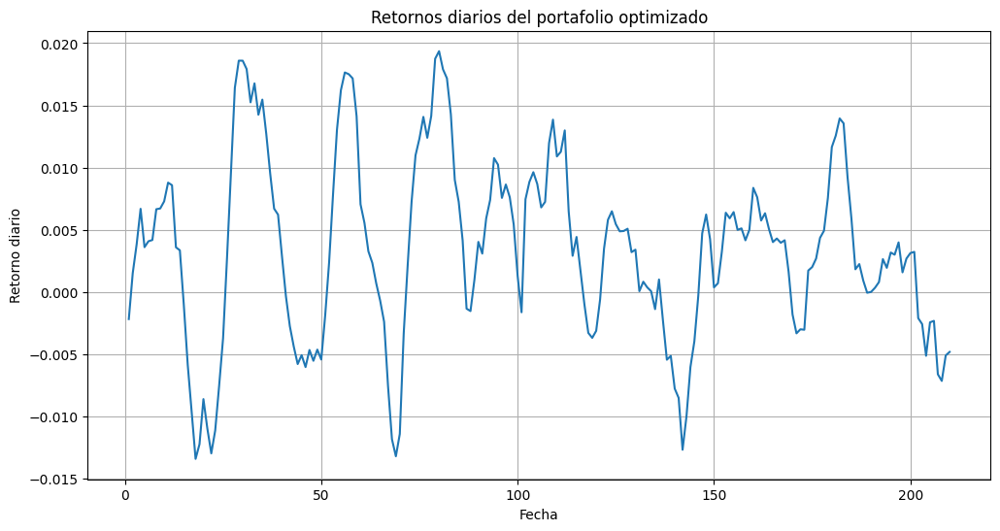

In [31]:
plt.figure(figsize=(12, 6))
portfolio_daily_returns.plot()
plt.title("Retornos diarios del portafolio optimizado")
plt.xlabel("Fecha")
plt.ylabel("Retorno diario")
plt.grid(True)
plt.show()


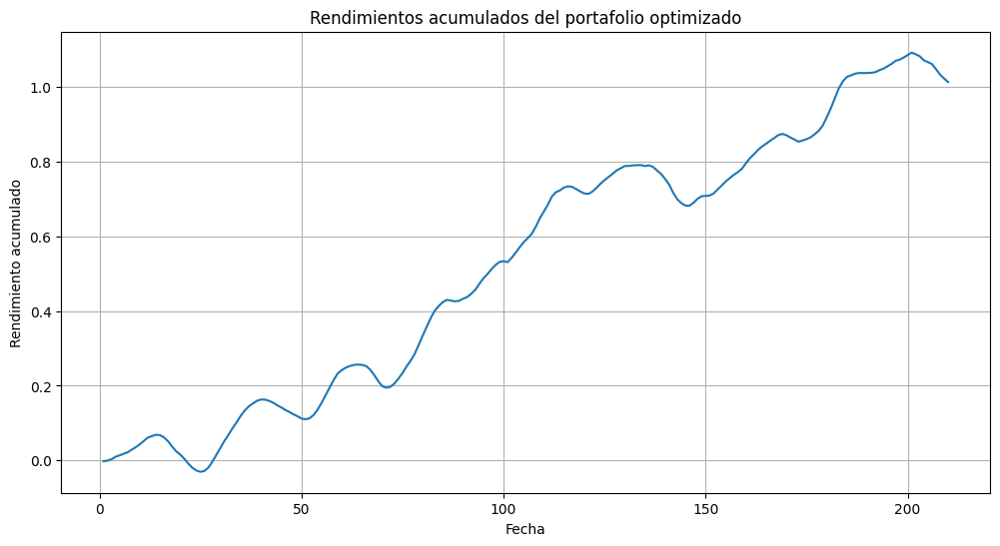

In [32]:
portfolio_cumulative_returns = (1 + portfolio_daily_returns).cumprod() - 1

plt.figure(figsize=(12, 6))
portfolio_cumulative_returns.plot()
plt.title("Rendimientos acumulados del portafolio optimizado")
plt.xlabel("Fecha")
plt.ylabel("Rendimiento acumulado")
plt.grid(True)
plt.show()

In [33]:
import yfinance as yf

# Descargar datos históricos de XLK
ticker = "XLK"
start_date = "2023-11-01"
end_date = "2024-07-31"

xlk_data = yf.download(ticker, start=start_date, end=end_date)
xlk_daily_returns = xlk_data['Adj Close'].pct_change()

# Mostrar los primeros datos
print("Retornos diarios de XLK:")
print(xlk_daily_returns.head())


[*********************100%***********************]  1 of 1 completed

Retornos diarios de XLK:
Ticker                          XLK
Date                               
2023-11-01 00:00:00+00:00       NaN
2023-11-02 00:00:00+00:00  0.016928
2023-11-03 00:00:00+00:00  0.010294
2023-11-06 00:00:00+00:00  0.006579
2023-11-07 00:00:00+00:00  0.010932


In [34]:
print("Tipo de índice del portafolio:", portfolio_daily_returns.index)

Tipo de índice del portafolio: RangeIndex(start=0, stop=211, step=1)


In [35]:
# Crear un índice de fechas
start_date_portfolio = "2023-11-01"
portfolio_daily_returns.index = pd.date_range(start=start_date_portfolio, periods=len(portfolio_daily_returns), freq="B")  # Días hábiles


In [36]:
# Convertir el índice de XLK a naive (sin zona horaria)
xlk_daily_returns.index = xlk_daily_returns.index.tz_localize(None)

# Convertir el índice del portafolio a datetime naive
portfolio_daily_returns.index = pd.to_datetime(portfolio_daily_returns.index)  # Asegurarse de que sea datetime

In [37]:
# Filtrar el portafolio al rango de fechas
portfolio_daily_returns_period = portfolio_daily_returns.loc["2023-11-01":"2024-07-31"]

# Filtrar XLK al rango de fechas (por si acaso)
xlk_daily_returns_period = xlk_daily_returns.loc["2023-11-01":"2024-07-31"]

In [38]:
# Combinar retornos del portafolio y XLK
comparison_df = pd.concat([portfolio_daily_returns_period, xlk_daily_returns_period], axis=1)
comparison_df.columns = ["Portfolio Returns", "XLK Returns"]
comparison_df = comparison_df.dropna()  # Eliminar filas con valores nulos

# Verificar los datos alineados
print(comparison_df.head())

            Portfolio Returns  XLK Returns
2023-11-02          -0.002177     0.016928
2023-11-03           0.001512     0.010294
2023-11-06           0.003839     0.006579
2023-11-07           0.006686     0.010932
2023-11-08           0.003603     0.005664


In [39]:
# Verificar índices después de la normalización
print(f"Índice del portafolio: {portfolio_daily_returns.index}")
print(f"Índice de XLK: {xlk_daily_returns.index}")

# Verificar dimensiones después de filtrar
print(f"Dimensiones del portafolio filtrado: {portfolio_daily_returns_period.shape}")
print(f"Dimensiones de XLK filtrado: {xlk_daily_returns_period.shape}")


Índice del portafolio: DatetimeIndex(['2023-11-01', '2023-11-02', '2023-11-03', '2023-11-06',
               '2023-11-07', '2023-11-08', '2023-11-09', '2023-11-10',
               '2023-11-13', '2023-11-14',
               ...
               '2024-08-08', '2024-08-09', '2024-08-12', '2024-08-13',
               '2024-08-14', '2024-08-15', '2024-08-16', '2024-08-19',
               '2024-08-20', '2024-08-21'],
              dtype='datetime64[ns]', length=211, freq='B')
Índice de XLK: DatetimeIndex(['2023-11-01', '2023-11-02', '2023-11-03', '2023-11-06',
               '2023-11-07', '2023-11-08', '2023-11-09', '2023-11-10',
               '2023-11-13', '2023-11-14',
               ...
               '2024-07-17', '2024-07-18', '2024-07-19', '2024-07-22',
               '2024-07-23', '2024-07-24', '2024-07-25', '2024-07-26',
               '2024-07-29', '2024-07-30'],
              dtype='datetime64[ns]', name='Date', length=186, freq=None)
Dimensiones del portafolio filtrado: (196,)
Dime

In [40]:
# Reindexar el portafolio para que coincida con XLK
portfolio_daily_returns_aligned = portfolio_daily_returns_period.reindex(xlk_daily_returns.index)

# Combinar los datos
comparison_df = pd.concat([portfolio_daily_returns_aligned, xlk_daily_returns], axis=1)
comparison_df.columns = ["Portfolio Returns", "XLK Returns"]

# Eliminar filas con valores nulos
comparison_df = comparison_df.dropna()

# Verificar los datos alineados
print(comparison_df.head())

            Portfolio Returns  XLK Returns
Date                                      
2023-11-02          -0.002177     0.016928
2023-11-03           0.001512     0.010294
2023-11-06           0.003839     0.006579
2023-11-07           0.006686     0.010932
2023-11-08           0.003603     0.005664


In [41]:
print(f"Dimensiones finales: {comparison_df.shape}")

Dimensiones finales: (185, 2)


## Visualización de Resultados
Se grafican las siguientes series para analizar el desempeño:
- **Rendimiento acumulado**:
  - Línea del portafolio optimizado.
  - Líneas de los índices **XLK** y **S&P 500** para comparación.
- **Comparación de métricas**:
  - Tablas que resumen el retorno, volatilidad y Ratio de Sharpe de cada opción.

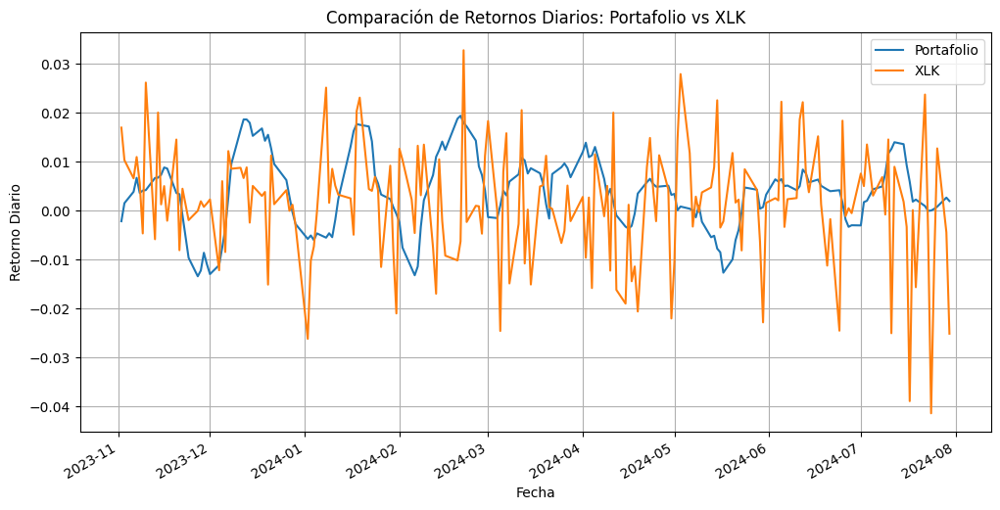

In [42]:
import matplotlib.pyplot as plt

# Graficar los retornos diarios
comparison_df.plot(figsize=(12, 6))
plt.title("Comparación de Retornos Diarios: Portafolio vs XLK")
plt.xlabel("Fecha")
plt.ylabel("Retorno Diario")
plt.legend(["Portafolio", "XLK"])
plt.grid(True)
plt.show()

In [43]:
print(comparison_df.head())
print(comparison_df.columns)

            Portfolio Returns  XLK Returns
Date                                      
2023-11-02          -0.002177     0.016928
2023-11-03           0.001512     0.010294
2023-11-06           0.003839     0.006579
2023-11-07           0.006686     0.010932
2023-11-08           0.003603     0.005664
Index(['Portfolio Returns', 'XLK Returns'], dtype='object')


In [44]:
# Calcular métricas clave para el portafolio y XLK
risk_free_rate = 0.0045 / 252  # Tasa libre de riesgo anualizada dividida por días hábiles

# Portafolio
portfolio_mean = comparison_df["Portfolio Returns"].mean()
portfolio_std = comparison_df["Portfolio Returns"].std()
portfolio_cumulative = (1 + comparison_df["Portfolio Returns"]).cumprod().iloc[-1] - 1
portfolio_drawdown = (comparison_df["Portfolio Returns"].cumsum() - comparison_df["Portfolio Returns"].cumsum().cummax()).min()
portfolio_sharpe = (portfolio_mean - risk_free_rate) / portfolio_std

# XLK
xlk_mean = comparison_df["XLK Returns"].mean()
xlk_std = comparison_df["XLK Returns"].std()
xlk_cumulative = (1 + comparison_df["XLK Returns"]).cumprod().iloc[-1] - 1
xlk_drawdown = (comparison_df["XLK Returns"].cumsum() - comparison_df["XLK Returns"].cumsum().cummax()).min()
xlk_sharpe = (xlk_mean - risk_free_rate) / xlk_std


In [45]:
# Crear un DataFrame con las métricas
comparison_metrics = pd.DataFrame({
    "Métrica": ["Rendimiento Promedio Diario", "Volatilidad Diaria", "Rendimiento Acumulado",
                "Máximo Drawdown", "Sharpe Ratio"],
    "Portafolio": [portfolio_mean, portfolio_std, portfolio_cumulative, portfolio_drawdown, portfolio_sharpe],
    "XLK": [xlk_mean, xlk_std, xlk_cumulative, xlk_drawdown, xlk_sharpe]
})

# Mejorar el formato para visualización
comparison_metrics["Portafolio"] = comparison_metrics["Portafolio"].map("{:.4f}".format)
comparison_metrics["XLK"] = comparison_metrics["XLK"].map("{:.4f}".format)

In [46]:
# Guardar la tabla en el directorio actual
comparison_metrics.to_csv('Tabla_Comparativa_Portafolio_XLK.csv', index=False)

# Mostrar mensaje de éxito
print("La tabla comparativa ha sido guardada como 'Tabla_Comparativa_Portafolio_XLK.csv'.")

# Descargar el archivo en Google Colab
from google.colab import files
files.download('Tabla_Comparativa_Portafolio_XLK.csv')

La tabla comparativa ha sido guardada como 'Tabla_Comparativa_Portafolio_XLK.csv'.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## **Comparacion con SP \&500**

[*********************100%***********************]  1 of 1 completed


            Portfolio Returns  SP500 Returns
2023-11-02          -0.002177       0.018859
2023-11-03           0.001512       0.009394
2023-11-06           0.003839       0.001753
2023-11-07           0.006686       0.002840
2023-11-08           0.003603       0.001005
Index(['Portfolio Returns', 'SP500 Returns'], dtype='object')


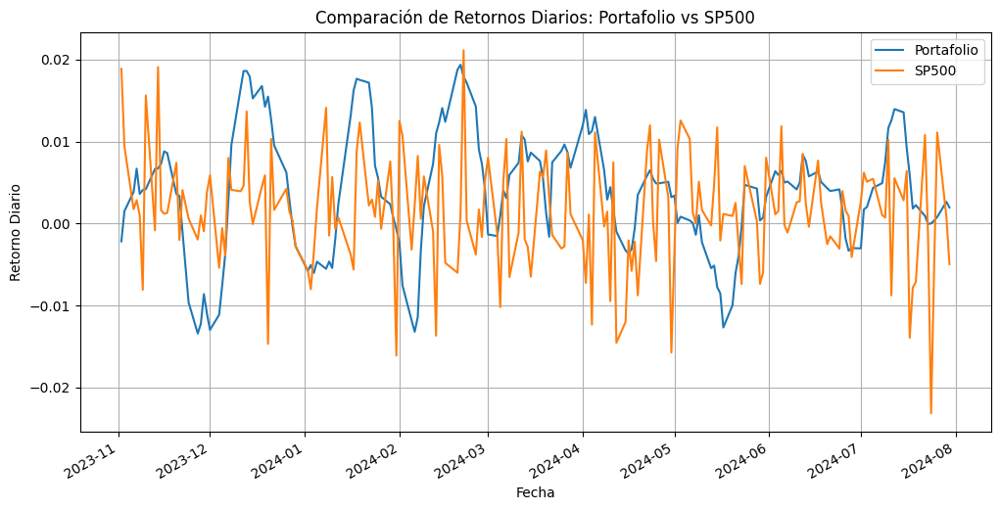

La tabla comparativa ha sido guardada como 'Tabla_Comparativa_Portafolio_XLK_SP500.csv'.


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [48]:
import yfinance as yf
import pandas as pd
from google.colab import files
import matplotlib.pyplot as plt

# Descargar datos históricos del S&P 500
ticker_sp500 = "^GSPC"
sp500_data = yf.download(ticker_sp500, start="2023-11-01", end="2024-07-31")
sp500_daily_returns = sp500_data['Adj Close'].pct_change()

# Convertir el índice de SP500 a naive (sin zona horaria)
sp500_daily_returns.index = sp500_daily_returns.index.tz_localize(None)

# Alinear fechas del portafolio y SP500 al mismo rango
portfolio_daily_returns.index = pd.date_range(start="2023-11-01", periods=len(portfolio_daily_returns), freq="B")
portfolio_daily_returns_period = portfolio_daily_returns.loc["2023-11-01":"2024-07-31"]

sp500_daily_returns_period = sp500_daily_returns.loc["2023-11-01":"2024-07-31"]

# Combinar datos para comparación
comparison_df = pd.concat([portfolio_daily_returns_period, sp500_daily_returns_period], axis=1)
comparison_df.columns = ["Portfolio Returns", "SP500 Returns"]
comparison_df = comparison_df.dropna()

# Verificar los datos alineados
print(comparison_df.head())
print(comparison_df.columns)

# Graficar los retornos diarios
comparison_df.plot(figsize=(12, 6))
plt.title("Comparación de Retornos Diarios: Portafolio vs SP500")
plt.xlabel("Fecha")
plt.ylabel("Retorno Diario")
plt.legend(["Portafolio", "SP500"])
plt.grid(True)
plt.show()

# Calcular métricas clave para el portafolio y SP500
risk_free_rate = 0.0045 / 252  # Tasa libre de riesgo anualizada dividida por días hábiles

# Portafolio
portfolio_mean = comparison_df["Portfolio Returns"].mean()
portfolio_std = comparison_df["Portfolio Returns"].std()
portfolio_cumulative = (1 + comparison_df["Portfolio Returns"]).cumprod().iloc[-1] - 1
portfolio_drawdown = (comparison_df["Portfolio Returns"].cumsum() - comparison_df["Portfolio Returns"].cumsum().cummax()).min()
portfolio_sharpe = (portfolio_mean - risk_free_rate) / portfolio_std

# SP500
sp500_mean = comparison_df["SP500 Returns"].mean()
sp500_std = comparison_df["SP500 Returns"].std()
sp500_cumulative = (1 + comparison_df["SP500 Returns"]).cumprod().iloc[-1] - 1
sp500_drawdown = (comparison_df["SP500 Returns"].cumsum() - comparison_df["SP500 Returns"].cumsum().cummax()).min()
sp500_sharpe = (sp500_mean - risk_free_rate) / sp500_std

# Actualizar la tabla comparativa
comparison_metrics["SP500"] = [
    f"{sp500_mean:.4f}",
    f"{sp500_std:.4f}",
    f"{sp500_cumulative:.4f}",
    f"{sp500_drawdown:.4f}",
    f"{sp500_sharpe:.4f}"
]

# Guardar la tabla actualizada
comparison_metrics.to_csv('Tabla_Comparativa_Portafolio_XLK_SP500.csv', index=False)

# Descargar el archivo actualizado
print("La tabla comparativa ha sido guardada como 'Tabla_Comparativa_Portafolio_XLK_SP500.csv'.")
files.download('Tabla_Comparativa_Portafolio_XLK_SP500.csv')
